# Documentation for Hydra Multi-Asset Verification Test
ACTION_LIST = [['test_add', 'test_q_for_r', 'test_r_for_r','test_r_for_q', 'test_remove']]



## Model Description

The methodology for the tests is to create two universes - one for Hydra and one for Uniswap - to subsequently be able to represent sequences of actions on each side. As the Hydra system is unique in its design and has no counterpart yet for approprate comparisons the role of the benchmark will be fulfilled by assembling several Uniswaps together in a way that everything that can be done in Hydra can be accordingly reproduced. This allows next to compare the implications on both systems and ultimately assess the quantitative and qualitative differences of results and impacts on the Hydra system and its agents. 

This approach necessitates the definition and specification of two models:
   - 1 Hydra Omnipool model with one instance that is defined in line with the [Hydra Mathematical Specification](https://hackmd.io/M7OeWimITKGVxBDHGQa6gQ?view)
   - 1 Uniswap model with several instances that each are responsible for a particular mechanism
        - which of 1 instance is used for liquidity provision in asset $R_i$: this is modeled as a Uniswap of $R_i$ and $Q$
        - which of 1 instance is used for liquidity provision in asset $R_j$: this is modeled as a Uniswap of $R_j$ and $Q$
        - which of 1 instance is used for swaps between assets $R_i$ and $R_j$: this is modeled as a Uniswap of $R_i$ and $R_j$
        
![](https://i.imgur.com/yb6Zh3T.png)
        
## Test cases

A variety of testcases can be explored with this model resulting from a combination of the following parameters
   
   - Event: Add Liquidity, Remove Liquidity, Swap Asset, Swap Asset for Base
   - Asset: $R_i$, $R_j$, $R_k$, $Q$
   - Multiple Action Type: Alternating, $i$ only, $j$ only
   - Composite Action Type: Alternating, Trade Bias
   - Enable Symmetric Liquidity: True, False
    
In addition to these settings also a fee structure can be imposed:

   - Fixed Fee

## Test agents

The model specifies a number of eight agents that each have their local balances, can interact with the system and are modeled to be responsible for **one action only**. This allows to track for each testcase how the balances will develop and to show independently which events will trigger changes to local and global states. Most importantly directly and indirectly affected variables can be easily identified.

Two dataframes of agents are initialized identically for both the Uniswap and the Hydra world and then work their way through on each side according to the testcase. Afterwards the effects on both sides can be compared.

![](https://i.imgur.com/r9IAJMr.png)



## Composite Action Tests

Besides being able to test all mechanisms individually also compositions of actions can be performed. This means selecting and combining two from the above testcases and letting the respective agents take the actions repeadetly. A composition action test therefore is defined as two actions which each can be a combination of *event* and *asset* selected from the list of testcases above, for example:
- Add liquidity in $R_i$ and Add liquidity in $R_j$
- Add liquidity in $R_i$ and Swap $R_i$ for $Q$
- Remove liquidity in $R_j$ and Swap $R_i$ for $Q$
- ...

In total there would be 28 composit pairs which can be derived from this decision tree:
selecting any one of the four primitive mechanisms of: **trade in/out** or **add/remove liquidity** of some given asset and then the subsequent action could be the three remaining mechanisms of the same asset or doing anyone of the four mechanisms in another asset.  

These basic combinations can be explored before further proceeding with
- trade sizes,
- trade frequencies,
- randomization,...



## Introduction to Uniswap
>Uniswap is an automated market maker for exchanging ERC20 tokens. Anyone can become a liquidity provider, and invest in the liquidity pool of an ERC20 token. This allows other users to trade that token for other tokens at an exchange rate based on their relative availibility. When a token trade is executed, a small fee is paid to the liquidity providers that enabled the transaction.
https://uniswap.io/

There are basically eight ways (_mechanisms_) in which an agent can interact with an instance of Uniswap (https://github.com/Uniswap/uniswap-v1/blob/master/contracts/uniswap_exchange.vy):
1. `addLiquidity`: deposit ETH and tokens in the liquidity pool; mint UNI tokens - "shares" of that Uniswap instance - in exchange;
1. `removeLiquidity`: burn UNI tokens; withdraw a proportional amount of ETH and tokens in exchange;
1. `ethToTokenInput`: user specifies an exact amount of ETH they send; receives corresponding amount of tokens
1. `ethToTokenOutput`: user sends some ETH and specifies an exact amount of tokens they want to buy; Uniswap refunds ETH sent in excess
1. `tokenToEthInput`: user specifies an exact amount of tokens they send; receives corresponding amount of ETH
1. `tokenToEthOutput`: user specifies an exact amount of ETH they want to buy; Uniswap takes the corresponding amount of tokens from the user account
1. `tokenToTokenInput`: user specifies an exact amount of "token A" they send; receives corresponding amount of "token B" (effectively a `tokenToEthInput` in instance A combined with a `ethToTokenInput` in instance B)
1. `tokenToTokenOutput`: user specifies an exact amount of "token B˜ they want to buy; Uniswap takes the corresponding amount of "token A" from the user account (effectively a `ethToTokenOutput` in instance B combined with a `tokenToEthOutput` in instance A)

## Limitations and simplifications of this model
* When triggering mechanisms, Uniswap users may include conditions they would like to apply to the transaction. For example, they could define a minimum amount of UNI tokens they wish to receive as a result of adding liquidity to the pool; or the maximum number of tokens they are willing to pay for the amount of ETH requested in a `tokenToEthOutput` operation; or a deadline after which the transaction should not be processed. **This simplified model does not account for this kind conditioning.**

* The `ethToTokenOutput`, `tokenToEthOutput` mechanisms are not implemented. **All swaps are treated as of the "input defined" type.**

* The `tokenToToken` mechanism are not implemented, as they are merely a `tokenToEth` in the context of a single Uniswap instance.

* **User _behavior_ has not been modeled**. User _actions_ are derived from the history of events of the Uniswap instance being analyzed.

## Introduction to Hydra
>Hydra is an automated market maker that generalizes the concept of Uniswap and Balancer to a) an arbitrary number of dimensions and b) a variant weight distaribution of assets in the pool that changes in accordance with action sequences in the pool. Anyone can become a liquidity provider, and invest in the 'Omnipool'. This allows other users to trade that token for other tokens at an exchange rate based on their relative availibility. When a token trade is executed, a small fee is paid to the liquidity providers that enabled the transaction.
https://hydradx.io/

There is a predefined set of (_mechanisms_) in which an agent can interact with an the Hydra Protocol :
1. `addLiquidity`: deposit a risk asset in the omnipool; mint HDX tokens - "shares" of this risk asset - in exchange;
1. `removeLiquidity`: burn HDX tokens; withdraw a proportional amount of the risk asset in exchange;
1. `tokenToTokenInput`: user specifies an exact amount of "token A" they send; receives corresponding amount of "token B" 
1. `tokenToTokenOutput`: user specifies an exact amount of "token B˜ they want to buy; Hydra takes the corresponding amount of "token A" from the user account 



## Model File structure

The folder **model** contains:

 - a file config.py: 

    This file configures the simulation experiments by setting the number of monte carlo runs, the number of timesteps for the simulation and the simulation parameters. It also aggregates the partial states and the initial state variables.
    
    The purpose of this file is to *configure and initialize* the experiment.
    
    
 - a file partial_state_update_block.py

    This file defines each partial state update block individually. This feature allows cadCAD to divide each simulation timestep into several 'blocks' where different state variables are mutated conditioned upon the policy input.
    
    In the current setting 
    - the first block maps the user action to the appropriate mechanism in the uniswap world
    - the second block maps the user action to the appropriate mechanism in the hydra world
    - the third block resolves the quantities of HDX and weights in the hydra world
    - the forth block calculates the metrics: the swap prices in the uniswap world and the pool prices in the hydra world

    This file corresponds to the system specification diagram, where each column is one partial state update block 
    
    The purpose of this file is to *define* the sequence and details of state updates for each simulation timestep. The relevant mechanisms are imported from the files in the **parts** folder
    
    
 - a file plot_utils.py

    This file defines all plot functions that can be called in the jupyter notebook to visualize the results. In general there are three types of plots:
    - plots related to the uniswap world (do not contain the word 'hydra')
    - plots related to the hydra world (contain the word 'hydra')
    - general plots applicable to both worlds (f.e Impermanent Loss)

    It also can be distinguished between plots related to global system variables and local agent variables:
    - global variables (do not contain the word 'agent')
    - local variables (contain the word 'agent')

    The purpose of this file is to *define* the way how particular properties can be plotted over time.
    

 - a file run.py

    This file *defines* the run and postprocessing methods and is used to execute the simulation run:
    - run() is used to execute the simulation and create a dataframe
    - postprocessing is used to extract relevant metrics from the simulation output in the dataframe

     The purpose of this file is to *execute* the simulation and *create* metrics.
     
     
 - a file state_variables.py

    This file *sets* the number of agents and *defines* the local (agent-level) state variables, *sets* the number of assets and *defines* the global (system-state) variables of the system, *computes* the prices of the assets and *defines* the initial state object
    - the agent states describe their holdings of assets that agents have contributed to the pool or still hold outside as well as their quantities of shares they received for their contribution
    - the global states describe the quantities of assets in the system
    - price variables are computed from the states both in the uniswap and hydra world
    - the initial state object consists of 
        - two agent dataframes, one for each world respectively
        - two sets of global variables, one for each world respectively
        - prices for each world (? is pool = prices ?)

    The purpose of this file is to *define* the global and local states of the system.
    
    
 - a file sys_params.py

    This file *contains* the system parameters and allows to select items from a list for them. Following parameters can be defined:
    - trade action type
    - liquidity action type
    - multiple asset action type
    - composite action type
    - liquidity add type (symmetry)

    In addition the following is set
    - initial values for assets 
    - hard coded fee value
    - choice of the system parameters from the list above
    

 - a folder **parts** which itself contains general files relevant for both instances, files related specifically to Uniswap and files related specifically to Hydra 
      - [action.py](model/parts/action.py)
       This is an action dictionary which drives the model. As there are no behavioral assumptions in the model yet, currently actions are prescribed actions in testing mode derived from events. However, action schema respects https://www.kaggle.com/markusbkoch/uniswap-ethdai-exchange as much as possible, allowing for future analysis against uniswap transaction datasets.
        This file contains a function called 'actionDecoder' which takes its inputs from the file sys_params.py and maps those encoded events to agent actions. At first an arbitrary action dictionary is defined which then is adapted according to the choices of system parameters. In particular relevant are the parameter definitions of the asset, the composite and whether there is a trade or liquidity event defined.
        
    - [uniswap.py](model/parts/uniswap.py)
     Reads in action output and directs the action to the appropriate Uniswap mechanism for each corresponding Uniswap instance. Currently there are two instances in place, namely the R_i<>Q pair and the R_j<>Q pair. Both instances have their respective requisite state variables: UNI_Qx, UNI_Rx, and UNI_Sx.

    - [utils.py](model/parts/utils.py)
    Computes the state update for each Uniswap state variable and outputs the updated global state variables.
        
     - [agent_utils.py](model/parts/agent_utils.py)
     Computes the corresponding agent local state for each Uniswap agent resolving their action and outputs the updates local state variables.

      -  [hydra.py](model/prts/hydra.py)
     Reads in action output and directs the action to the appropriate Hydra mechanism for each state variable: Q, Sq, and pool.
    
      - [hydra_utils.py](model/parts/hydra_utils.py)
     Computes the state update for each Hydra state variable

    -  [asset_utils.py](model/parts/asset_utils.py)
     Computes the state update for each Reserve Asset in a Hydra Omnipool

    -  [hydra_agent_utils_class.py](model/parts/hydra_agent_utils_class.py)
     Computes the corresponding agent local state for each Hydra agent resolving their action and outputs the updates local state variables.
     
     #### The interrelations between the files are shown here:
     
    ![](https://i.imgur.com/mNhfQE4.png)



# Testcase Definition

#### Simulation Settings
- There are 100 timesteps for each simulation run
- Each testcase has 100 MC runs with different randomized variables
- Block 1 randomizes starting liquidity balances (explained below in section 'Block 1')



#### Agent Activities - Action Sequence

There are two agents acting during the simulation. The trading agent performs "R-for-R" trades of equal size but varying direction over most simulation timesteps. The liquidity agent provides liquidity to the pool at timestep 10 and removes the liquidity from the pool at timestep 90.

##### Trading agent

- One Agent performs random "R-for-R" trades during the simulation. 
- The direction of the trade is a random coin flip for each timestep.
- The size of the trade is fixed at $1000$ for each timestep.
- The agent does not act at timestep 10 nor timestep 90.

##### Liquidity agent

- One Agent provides liquidity in Asset "i" to the pool 
- He provides the liquidity at timestep 10
- He removes the liquidity at timestep 90
- He does not act at other timesteps

#### Block 1:

| #   |   Run   | a  | $\mu_i$ |          $\sigma_i$          | $\mu_j$ |          $\sigma_j$          | $\mu$ | $\sigma$ | Total runs         |
| --- |:-------:|:-------:|:-------:|:----------------------------:|:-------:|:----------------------------:| ----- | -------- | ------------------ |
| 1   | 001-100 |   0.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 2   | 101-200 |   0.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |
| 3   | 201-300 |    1    |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 4   | 301-400 |    1    |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$  | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |
| 5   | 401-500 |   1.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 6   | 501-600 |   1.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |

All tests in block 1 are performed as 100 **MonteCarlo Experiments** with the following randomization:
- The initial balances of the liquidity pools are drawn randomly for each MC run from the same lognormal distribution with $\mu_i$ and $\mu_j$ fixed at $100000$
    - The underlying mean for the lognormal liquidity draw is $\log{100000}$
    - The underlying standard deviation for the lognormal liquidity draw is $\sqrt{\log{1 + \frac{2000^2}{100000^2}}}$
- The action sequence of the agents is randomized in that sense that:
    - For each individual MC run the sequence is identical for the Uniswap and Hydra side of the model. For each timestep of the simulation exactly the same event takes place on both sides.
    - For each individual MC run the trading directions are randomized for each timestep. Therefore the event sequence for each run will be different.
    - For all MC runs the trading amount is always equal to $1000$




# Testcase in this notebook


This notebook documents the results of the following experiment:
- Settings from Block 1 as outlined above
- Testcases **1**, **3** and **5**
- Sweep over three values for $a \in \{0.5, 1, 1.5 \}$ with a fixed $\mu$-to-$\sigma$-ratio of $2$.

The experiment result dataframe is saved into a pickle file and analyzed throughout this notebook.

## Run Model

The following command lines import all packages, experiments and run the model 

This is the execution of cadcad. This writes the config object, does the execution and returns the rdf - which is a data object that shows the rows and columns of results in a dataframe

Here is one additional option as well. The postprocessing causes the index of the results to be every forth because of the cadcad architecture where the partial state updates are the substeps. With this option selected we see only the end of each timestep - the last substep. Therefore only final results are shown. To get a line for each substep the postprocessing needs to be deactivated. 

In [1]:
from model.config_wrapper import ConfigWrapper

from model import run_wrapper
from cadCAD import configs

# parametric_experiment = ConfigWrapper()
# get_keys = parametric_experiment.get_config()
# get_keys[0]['M']
# parametric_experiment.get_config()

running file: config_wrapper.py
end of file: config_wrapper.py
running file: run_wrapper.py
end of file: run_wrapper.py


In [2]:
# import model as model


In [3]:
# parametric_experiment = ConfigWrapper(model)


In [4]:
# del configs[:]

# parametric_experiment.append()

In [5]:
# get_keys = parametric_experiment.get_config()
# get_keys[0]['M']

In [6]:
# Dependences
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Experiments
from model import run
from model.parts.utils import *
from model.plot_utils import *

pd.options.display.float_format = '{:.2f}'.format

%matplotlib inline

# df = run.run()
# rdf = run.postprocessing(df)
# rdf = df # debugging substeps
# pd.set_option("mode.chained_assignment", None)


running file: run.py
running file: state_variables.py
running file: initialize_liquidity.py
end of file: initialize_liquidity.py
running file: asset_utils.py
end of file: asset_utils.py
end of file: state_variables.py
running file: partial_state_update_block.py
end of file: action_list.py
end of file: partial_state_update_block.py
running file: sim_setup.py
end of file: sim_setup.py
[117495.50135958  95611.25879778 123396.80896711 163945.61903468
  92681.20263534  92681.69654331 166962.85594269 128287.52178985
  85865.50347172 119257.05562057  86034.4775969   85969.93480342
 108170.57813688  53738.68354952  57126.84793488  83317.25550298
  71981.73815777 110738.61693473  74472.65917597  63227.95366503
 160920.31283036  92933.55858926 102216.11620354  62973.06639424
  83802.88617593 103666.06970946  68824.92112422 112969.63603961
  82286.50855935  90966.24299436  82257.98971196 182437.27830573
  99562.84804397  70940.73323924 130603.02513683  67282.02216372
 107014.65789057  52935.55780

Omni_P_RQi ================== 0.1045901928887945
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 95611.25879777755, 'S': 10000, 'W': 10000, 'P': 0.1045901928887945, 'dP': 0}, 'j': {'R': 87237.2766009738, 'S': 10000, 'W': 10000, 'P': 0.11462989664086302}, 'k': {'R': 87237.2766009738, 'S': 10000, 'W': 10000, 'P': 0.11462989664086302}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.10459019288879459
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 95611.25879777755, 'S': 10000, 'W': 10000, 'P': 0.10459019288879459, 'dP': 0}, 'j': {'R': 87237.2766009738, 'S': 10000, 'W': 10000, 'P': 0.11462989664086312}, 'k': {'R': 87237.2766009738, 'S': 10000, 'W': 10000, 'P': 0.11462989664086312}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.08103937276583383
Initial Q HDX: 19999.999999999996
config_init_state  <class 'm

Omni_P_RQi ================== 0.060995835441535744
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 163945.61903467937, 'S': 10000, 'W': 10000, 'P': 0.060995835441535744, 'dP': 0}, 'j': {'R': 77073.28511100917, 'S': 10000, 'W': 10000, 'P': 0.1297466428944471}, 'k': {'R': 77073.28511100917, 'S': 10000, 'W': 10000, 'P': 0.1297466428944471}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.10789674406088194
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 92681.20263533981, 'S': 10000, 'W': 10000, 'P': 0.10789674406088194, 'dP': 0}, 'j': {'R': 94899.45833203912, 'S': 10000, 'W': 10000, 'P': 0.10537467943190447}, 'k': {'R': 94899.45833203912, 'S': 10000, 'W': 10000, 'P': 0.10537467943190447}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.1078967440608819
Initial Q HDX: 19999.999999999985
config_init_state  <cl

Omni_P_RQi ================== 0.10789616907073463
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 92681.69654331479, 'S': 10000, 'W': 10000, 'P': 0.10789616907073463, 'dP': 0}, 'j': {'R': 114014.10895731255, 'S': 10000, 'W': 10000, 'P': 0.08770844320455166}, 'k': {'R': 114014.10895731255, 'S': 10000, 'W': 10000, 'P': 0.08770844320455166}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.059893561017141835
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 166962.85594269386, 'S': 10000, 'W': 10000, 'P': 0.059893561017141835, 'dP': 0}, 'j': {'R': 184456.31044795158, 'S': 10000, 'W': 10000, 'P': 0.05421337971964759}, 'k': {'R': 184456.31044795158, 'S': 10000, 'W': 10000, 'P': 0.05421337971964759}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.05989356101714181
Initial Q HDX: 19999.999999999985
config_init_sta

Omni_P_RQi ================== 0.07794990393829031
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 128287.52178984831, 'S': 10000, 'W': 10000, 'P': 0.07794990393829031, 'dP': 0}, 'j': {'R': 105830.30288521064, 'S': 10000, 'W': 10000, 'P': 0.09449089464334756}, 'k': {'R': 105830.30288521064, 'S': 10000, 'W': 10000, 'P': 0.09449089464334756}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.07794990393829035
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 128287.52178984831, 'S': 10000, 'W': 10000, 'P': 0.07794990393829035, 'dP': 0}, 'j': {'R': 105830.30288521064, 'S': 10000, 'W': 10000, 'P': 0.0944908946433476}, 'k': {'R': 105830.30288521064, 'S': 10000, 'W': 10000, 'P': 0.0944908946433476}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.07794990393829042
Initial Q HDX: 20000.000000000022
config_init_state  <class 'm

Omni_P_RQi ================== 0.08385248107932486
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 119257.05562057192, 'S': 10000, 'W': 10000, 'P': 0.08385248107932486, 'dP': 0}, 'j': {'R': 97612.50149635863, 'S': 10000, 'W': 10000, 'P': 0.10244589419084853}, 'k': {'R': 97612.50149635863, 'S': 10000, 'W': 10000, 'P': 0.10244589419084853}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.0838524810793249
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 119257.05562057192, 'S': 10000, 'W': 10000, 'P': 0.0838524810793249, 'dP': 0}, 'j': {'R': 97612.50149635863, 'S': 10000, 'W': 10000, 'P': 0.10244589419084857}, 'k': {'R': 97612.50149635863, 'S': 10000, 'W': 10000, 'P': 0.10244589419084857}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.08385248107932497
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model

Omni_P_RQi ================== 0.11631973460101455
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 85969.9348034171, 'S': 10000, 'W': 10000, 'P': 0.11631973460101455, 'dP': 0}, 'j': {'R': 99143.07131612096, 'S': 10000, 'W': 10000, 'P': 0.10086433542203538}, 'k': {'R': 99143.07131612096, 'S': 10000, 'W': 10000, 'P': 0.10086433542203538}}}
config_param a value =============  1
Omni_P_RQi ================== 0.116319734601015
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 85969.9348034171, 'S': 10000, 'W': 10000, 'P': 0.116319734601015, 'dP': 0}, 'j': {'R': 99143.07131612096, 'S': 10000, 'W': 10000, 'P': 0.10086433542203577}, 'k': {'R': 99143.07131612096, 'S': 10000, 'W': 10000, 'P': 0.10086433542203577}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.11631973460101461
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.ass

Omni_P_RQi ================== 0.18608568985105542
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 53738.683549520036, 'S': 10000, 'W': 10000, 'P': 0.18608568985105542, 'dP': 0}, 'j': {'R': 222454.13679694067, 'S': 10000, 'W': 10000, 'P': 0.04495308625853132}, 'k': {'R': 222454.13679694067, 'S': 10000, 'W': 10000, 'P': 0.04495308625853132}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.1860856898510555
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 53738.683549520036, 'S': 10000, 'W': 10000, 'P': 0.1860856898510555, 'dP': 0}, 'j': {'R': 222454.13679694067, 'S': 10000, 'W': 10000, 'P': 0.04495308625853134}, 'k': {'R': 222454.13679694067, 'S': 10000, 'W': 10000, 'P': 0.04495308625853134}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.18608568985105567
Initial Q HDX: 20000.000000000022
config_init_state  <class 'm

Omni_P_RQi ================== 0.12002315654338681
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 83317.255502984, 'S': 10000, 'W': 10000, 'P': 0.12002315654338681, 'dP': 0}, 'j': {'R': 110283.05588753146, 'S': 10000, 'W': 10000, 'P': 0.09067576083671616}, 'k': {'R': 110283.05588753146, 'S': 10000, 'W': 10000, 'P': 0.09067576083671616}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.12002315654338692
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 83317.255502984, 'S': 10000, 'W': 10000, 'P': 0.12002315654338692, 'dP': 0}, 'j': {'R': 110283.05588753146, 'S': 10000, 'W': 10000, 'P': 0.09067576083671625}, 'k': {'R': 110283.05588753146, 'S': 10000, 'W': 10000, 'P': 0.09067576083671625}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.13892412514521182
Initial Q HDX: 19999.999999999996
config_init_state  <cl

Omni_P_RQi ================== 0.13427746653132253
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 74472.65917597068, 'S': 10000, 'W': 10000, 'P': 0.13427746653132253, 'dP': 0}, 'j': {'R': 144911.36733928483, 'S': 10000, 'W': 10000, 'P': 0.06900769886869348}, 'k': {'R': 144911.36733928483, 'S': 10000, 'W': 10000, 'P': 0.06900769886869348}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.13427746653132272
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 74472.65917597068, 'S': 10000, 'W': 10000, 'P': 0.13427746653132272, 'dP': 0}, 'j': {'R': 144911.36733928483, 'S': 10000, 'W': 10000, 'P': 0.06900769886869358}, 'k': {'R': 144911.36733928483, 'S': 10000, 'W': 10000, 'P': 0.06900769886869358}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.13427746653132264
Initial Q HDX: 20000
config_init_state  <class 'mod

Omni_P_RQi ================== 0.062142558786484864
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 160920.31283035706, 'S': 10000, 'W': 10000, 'P': 0.062142558786484864, 'dP': 0}, 'j': {'R': 129273.91133498424, 'S': 10000, 'W': 10000, 'P': 0.07735512832196474}, 'k': {'R': 129273.91133498424, 'S': 10000, 'W': 10000, 'P': 0.07735512832196474}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.062142558786484836
Initial Q HDX: 19999.999999999985
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 160920.31283035706, 'S': 10000, 'W': 10000, 'P': 0.062142558786484836, 'dP': 0}, 'j': {'R': 129273.91133498424, 'S': 10000, 'W': 10000, 'P': 0.07735512832196471}, 'k': {'R': 129273.91133498424, 'S': 10000, 'W': 10000, 'P': 0.07735512832196471}}}
config_param a value =============  0.92
Omni_P_RQi ================== 0.062142558786484975
Initial Q HDX: 20000.00000000003
config_init

Omni_P_RQi ================== 0.10760375640189637
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 92933.5585892591, 'S': 10000, 'W': 10000, 'P': 0.10760375640189637, 'dP': 0}, 'j': {'R': 74439.70910160709, 'S': 10000, 'W': 10000, 'P': 0.13433690325616962}, 'k': {'R': 74439.70910160709, 'S': 10000, 'W': 10000, 'P': 0.13433690325616962}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.10760375640189641
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 92933.5585892591, 'S': 10000, 'W': 10000, 'P': 0.10760375640189641, 'dP': 0}, 'j': {'R': 74439.70910160709, 'S': 10000, 'W': 10000, 'P': 0.13433690325616968}, 'k': {'R': 74439.70910160709, 'S': 10000, 'W': 10000, 'P': 0.13433690325616968}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.10760375640189651
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.p

Omni_P_RQi ================== 0.1587980476827339
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 62973.066394236994, 'S': 10000, 'W': 10000, 'P': 0.1587980476827339, 'dP': 0}, 'j': {'R': 63442.84106905442, 'S': 10000, 'W': 10000, 'P': 0.15762219710677056}, 'k': {'R': 63442.84106905442, 'S': 10000, 'W': 10000, 'P': 0.15762219710677056}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.11932763245179005
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 83802.88617592517, 'S': 10000, 'W': 10000, 'P': 0.11932763245179005, 'dP': 0}, 'j': {'R': 120984.18084660778, 'S': 10000, 'W': 10000, 'P': 0.08265543420654885}, 'k': {'R': 120984.18084660778, 'S': 10000, 'W': 10000, 'P': 0.08265543420654885}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.11932763245179001
Initial Q HDX: 19999.999999999985
config_init_state  <c

Omni_P_RQi ================== 0.09646357798676772
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 103666.06970945804, 'S': 10000, 'W': 10000, 'P': 0.09646357798676772, 'dP': 0}, 'j': {'R': 203603.89426883837, 'S': 10000, 'W': 10000, 'P': 0.0491149741310744}, 'k': {'R': 203603.89426883837, 'S': 10000, 'W': 10000, 'P': 0.0491149741310744}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.09646357798676768
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 103666.06970945804, 'S': 10000, 'W': 10000, 'P': 0.09646357798676768, 'dP': 0}, 'j': {'R': 203603.89426883837, 'S': 10000, 'W': 10000, 'P': 0.04911497413107438}, 'k': {'R': 203603.89426883837, 'S': 10000, 'W': 10000, 'P': 0.04911497413107438}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.09646357798676772
Initial Q HDX: 20000.00000000001
config_init_state  <class 'm

Omni_P_RQi ================== 0.08851936104754665
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 112969.63603960807, 'S': 10000, 'W': 10000, 'P': 0.08851936104754665, 'dP': 0}, 'j': {'R': 83208.87345698303, 'S': 10000, 'W': 10000, 'P': 0.1201794902940221}, 'k': {'R': 83208.87345698303, 'S': 10000, 'W': 10000, 'P': 0.1201794902940221}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.08851936104754661
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 112969.63603960807, 'S': 10000, 'W': 10000, 'P': 0.08851936104754661, 'dP': 0}, 'j': {'R': 83208.87345698303, 'S': 10000, 'W': 10000, 'P': 0.12017949029402204}, 'k': {'R': 83208.87345698303, 'S': 10000, 'W': 10000, 'P': 0.12017949029402204}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.08851936104754665
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model

Omni_P_RQi ================== 0.10993088942476864
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90966.24299436348, 'S': 10000, 'W': 10000, 'P': 0.10993088942476864, 'dP': 0}, 'j': {'R': 84923.0532434808, 'S': 10000, 'W': 10000, 'P': 0.11775365602234358}, 'k': {'R': 84923.0532434808, 'S': 10000, 'W': 10000, 'P': 0.11775365602234358}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.10993088942476857
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90966.24299436348, 'S': 10000, 'W': 10000, 'P': 0.10993088942476857, 'dP': 0}, 'j': {'R': 84923.0532434808, 'S': 10000, 'W': 10000, 'P': 0.1177536560223435}, 'k': {'R': 84923.0532434808, 'S': 10000, 'W': 10000, 'P': 0.1177536560223435}}}
config_param a value =============  1
Omni_P_RQi ================== 0.10993088942476899
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.ass

Omni_P_RQi ================== 0.05481335883142139
Initial Q HDX: 20000.00000000003
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 182437.2783057327, 'S': 10000, 'W': 10000, 'P': 0.05481335883142139, 'dP': 0}, 'j': {'R': 102250.45421452184, 'S': 10000, 'W': 10000, 'P': 0.09779907655979676}, 'k': {'R': 102250.45421452184, 'S': 10000, 'W': 10000, 'P': 0.09779907655979676}}}
config_param a value =============  0.94
Omni_P_RQi ================== 0.05481335883142126
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 182437.2783057327, 'S': 10000, 'W': 10000, 'P': 0.05481335883142126, 'dP': 0}, 'j': {'R': 102250.45421452184, 'S': 10000, 'W': 10000, 'P': 0.09779907655979653}, 'k': {'R': 102250.45421452184, 'S': 10000, 'W': 10000, 'P': 0.09779907655979653}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.05481335883142134
Initial Q HDX: 20000.000000000015
config_init_state 

Omni_P_RQi ================== 0.10043907136509532
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 99562.84804396571, 'S': 10000, 'W': 10000, 'P': 0.10043907136509532, 'dP': 0}, 'j': {'R': 70835.0546442042, 'S': 10000, 'W': 10000, 'P': 0.1411730399620469}, 'k': {'R': 70835.0546442042, 'S': 10000, 'W': 10000, 'P': 0.1411730399620469}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.14096273809683252
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 70940.73323923821, 'S': 10000, 'W': 10000, 'P': 0.14096273809683252, 'dP': 0}, 'j': {'R': 116616.98134039092, 'S': 10000, 'W': 10000, 'P': 0.08575080477182995}, 'k': {'R': 116616.98134039092, 'S': 10000, 'W': 10000, 'P': 0.08575080477182995}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.14096273809683246
Initial Q HDX: 19999.999999999985
config_init_state  <clas

Omni_P_RQi ================== 0.07656790483622376
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 130603.0251368334, 'S': 10000, 'W': 10000, 'P': 0.07656790483622376, 'dP': 0}, 'j': {'R': 74197.58905611216, 'S': 10000, 'W': 10000, 'P': 0.13477526867399248}, 'k': {'R': 74197.58905611216, 'S': 10000, 'W': 10000, 'P': 0.13477526867399248}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.0765679048362238
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 130603.0251368334, 'S': 10000, 'W': 10000, 'P': 0.0765679048362238, 'dP': 0}, 'j': {'R': 74197.58905611216, 'S': 10000, 'W': 10000, 'P': 0.13477526867399253}, 'k': {'R': 74197.58905611216, 'S': 10000, 'W': 10000, 'P': 0.13477526867399253}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.07656790483622387
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.p

Omni_P_RQi ================== 0.09344514290954402
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 107014.65789056705, 'S': 10000, 'W': 10000, 'P': 0.09344514290954402, 'dP': 0}, 'j': {'R': 77550.68873137273, 'S': 10000, 'W': 10000, 'P': 0.12894791991646815}, 'k': {'R': 77550.68873137273, 'S': 10000, 'W': 10000, 'P': 0.12894791991646815}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09344514290954437
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 107014.65789056705, 'S': 10000, 'W': 10000, 'P': 0.09344514290954437, 'dP': 0}, 'j': {'R': 77550.68873137273, 'S': 10000, 'W': 10000, 'P': 0.12894791991646865}, 'k': {'R': 77550.68873137273, 'S': 10000, 'W': 10000, 'P': 0.12894791991646865}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.09344514290954406
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.p

Omni_P_RQi ================== 0.15389797387964285
Initial Q HDX: 20000.00000000003
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 64978.113407916564, 'S': 10000, 'W': 10000, 'P': 0.15389797387964285, 'dP': 0}, 'j': {'R': 130220.87599479452, 'S': 10000, 'W': 10000, 'P': 0.0767926027498061}, 'k': {'R': 130220.87599479452, 'S': 10000, 'W': 10000, 'P': 0.0767926027498061}}}
config_param a value =============  0.94
Omni_P_RQi ================== 0.1538979738796425
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 64978.113407916564, 'S': 10000, 'W': 10000, 'P': 0.1538979738796425, 'dP': 0}, 'j': {'R': 130220.87599479452, 'S': 10000, 'W': 10000, 'P': 0.0767926027498059}, 'k': {'R': 130220.87599479452, 'S': 10000, 'W': 10000, 'P': 0.0767926027498059}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.15389797387964274
Initial Q HDX: 20000.000000000015
config_init_state  <cl

Omni_P_RQi ================== 0.09380990403592904
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 106598.55270899786, 'S': 10000, 'W': 10000, 'P': 0.09380990403592904, 'dP': 0}, 'j': {'R': 67063.53371721627, 'S': 10000, 'W': 10000, 'P': 0.14911233342052263}, 'k': {'R': 67063.53371721627, 'S': 10000, 'W': 10000, 'P': 0.14911233342052263}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.07868631224678503
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 127086.90640675665, 'S': 10000, 'W': 10000, 'P': 0.07868631224678503, 'dP': 0}, 'j': {'R': 107662.57745147508, 'S': 10000, 'W': 10000, 'P': 0.09288278468446594}, 'k': {'R': 107662.57745147508, 'S': 10000, 'W': 10000, 'P': 0.09288278468446594}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.07868631224678499
Initial Q HDX: 19999.999999999985
config_init_state 

Omni_P_RQi ================== 0.09458938570254453
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 105720.10723747619, 'S': 10000, 'W': 10000, 'P': 0.09458938570254453, 'dP': 0}, 'j': {'R': 152850.35527864468, 'S': 10000, 'W': 10000, 'P': 0.06542346585829065}, 'k': {'R': 152850.35527864468, 'S': 10000, 'W': 10000, 'P': 0.06542346585829065}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.09458938570254448
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 105720.10723747619, 'S': 10000, 'W': 10000, 'P': 0.09458938570254448, 'dP': 0}, 'j': {'R': 152850.35527864468, 'S': 10000, 'W': 10000, 'P': 0.0654234658582906}, 'k': {'R': 152850.35527864468, 'S': 10000, 'W': 10000, 'P': 0.0654234658582906}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.09458938570254453
Initial Q HDX: 20000.00000000001
config_init_state  <class 'm

Omni_P_RQi ================== 0.11026717576809719
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90688.81949992987, 'S': 10000, 'W': 10000, 'P': 0.11026717576809719, 'dP': 0}, 'j': {'R': 106176.31014313601, 'S': 10000, 'W': 10000, 'P': 0.09418296780627461}, 'k': {'R': 106176.31014313601, 'S': 10000, 'W': 10000, 'P': 0.09418296780627461}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.11026717576809712
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90688.81949992987, 'S': 10000, 'W': 10000, 'P': 0.11026717576809712, 'dP': 0}, 'j': {'R': 106176.31014313601, 'S': 10000, 'W': 10000, 'P': 0.09418296780627455}, 'k': {'R': 106176.31014313601, 'S': 10000, 'W': 10000, 'P': 0.09418296780627455}}}
config_param a value =============  1
Omni_P_RQi ================== 0.11026717576809754
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model

Omni_P_RQi ================== 0.12632102272898418
Initial Q HDX: 19999.999999999985
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 79163.38693247065, 'S': 10000, 'W': 10000, 'P': 0.12632102272898418, 'dP': 0}, 'j': {'R': 128888.06274237928, 'S': 10000, 'W': 10000, 'P': 0.07758670420850329}, 'k': {'R': 128888.06274237928, 'S': 10000, 'W': 10000, 'P': 0.07758670420850329}}}
config_param a value =============  0.92
Omni_P_RQi ================== 0.12632102272898446
Initial Q HDX: 20000.00000000003
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 79163.38693247065, 'S': 10000, 'W': 10000, 'P': 0.12632102272898446, 'dP': 0}, 'j': {'R': 128888.06274237928, 'S': 10000, 'W': 10000, 'P': 0.07758670420850346}, 'k': {'R': 128888.06274237928, 'S': 10000, 'W': 10000, 'P': 0.07758670420850346}}}
config_param a value =============  0.94
Omni_P_RQi ================== 0.12632102272898416
Initial Q HDX: 19999.99999999998
config_init_state 

Omni_P_RQi ================== 0.0709542905067842
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 140935.80428436334, 'S': 10000, 'W': 10000, 'P': 0.0709542905067842, 'dP': 0}, 'j': {'R': 65141.34294745224, 'S': 10000, 'W': 10000, 'P': 0.15351234020561608}, 'k': {'R': 65141.34294745224, 'S': 10000, 'W': 10000, 'P': 0.15351234020561608}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.07095429050678416
Initial Q HDX: 19999.999999999985
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 140935.80428436334, 'S': 10000, 'W': 10000, 'P': 0.07095429050678416, 'dP': 0}, 'j': {'R': 65141.34294745224, 'S': 10000, 'W': 10000, 'P': 0.153512340205616}, 'k': {'R': 65141.34294745224, 'S': 10000, 'W': 10000, 'P': 0.153512340205616}}}
config_param a value =============  0.92
Omni_P_RQi ================== 0.07095429050678433
Initial Q HDX: 20000.00000000003
config_init_state  <class 

Omni_P_RQi ================== 0.17722859696737062
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 56424.30268655283, 'S': 10000, 'W': 10000, 'P': 0.17722859696737062, 'dP': 0}, 'j': {'R': 110119.84649384586, 'S': 10000, 'W': 10000, 'P': 0.09081015201523056}, 'k': {'R': 110119.84649384586, 'S': 10000, 'W': 10000, 'P': 0.09081015201523056}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.17722859696737053
Initial Q HDX: 19999.999999999985
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 56424.30268655283, 'S': 10000, 'W': 10000, 'P': 0.17722859696737053, 'dP': 0}, 'j': {'R': 110119.84649384586, 'S': 10000, 'W': 10000, 'P': 0.09081015201523052}, 'k': {'R': 110119.84649384586, 'S': 10000, 'W': 10000, 'P': 0.09081015201523052}}}
config_param a value =============  0.92
Omni_P_RQi ================== 0.17722859696737092
Initial Q HDX: 20000.00000000003
config_init_state 

Omni_P_RQi ================== 0.09001486722058588
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 111092.75954931429, 'S': 10000, 'W': 10000, 'P': 0.09001486722058588, 'dP': 0}, 'j': {'R': 108470.51372880352, 'S': 10000, 'W': 10000, 'P': 0.09219095269523533}, 'k': {'R': 108470.51372880352, 'S': 10000, 'W': 10000, 'P': 0.09219095269523533}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.09001486722058592
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 111092.75954931429, 'S': 10000, 'W': 10000, 'P': 0.09001486722058592, 'dP': 0}, 'j': {'R': 108470.51372880352, 'S': 10000, 'W': 10000, 'P': 0.09219095269523538}, 'k': {'R': 108470.51372880352, 'S': 10000, 'W': 10000, 'P': 0.09219095269523538}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.090014867220586
Initial Q HDX: 20000.000000000022
config_init_state  <class 'm

Omni_P_RQi ================== 0.12457329089288877
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 80274.02927484873, 'S': 10000, 'W': 10000, 'P': 0.12457329089288877, 'dP': 0}, 'j': {'R': 80193.22430095519, 'S': 10000, 'W': 10000, 'P': 0.1246988144842667}, 'k': {'R': 80193.22430095519, 'S': 10000, 'W': 10000, 'P': 0.1246988144842667}}}
config_param a value =============  1
Omni_P_RQi ================== 0.12457329089288924
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 80274.02927484873, 'S': 10000, 'W': 10000, 'P': 0.12457329089288924, 'dP': 0}, 'j': {'R': 80193.22430095519, 'S': 10000, 'W': 10000, 'P': 0.12469881448426717}, 'k': {'R': 80193.22430095519, 'S': 10000, 'W': 10000, 'P': 0.12469881448426717}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.12457329089288882
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts

Omni_P_RQi ================== 0.07155848710465297
Initial Q HDX: 20000.00000000003
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 139745.82756864605, 'S': 10000, 'W': 10000, 'P': 0.07155848710465297, 'dP': 0}, 'j': {'R': 109980.09712263603, 'S': 10000, 'W': 10000, 'P': 0.09092554254475033}, 'k': {'R': 109980.09712263603, 'S': 10000, 'W': 10000, 'P': 0.09092554254475033}}}
config_param a value =============  0.94
Omni_P_RQi ================== 0.07155848710465279
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 139745.82756864605, 'S': 10000, 'W': 10000, 'P': 0.07155848710465279, 'dP': 0}, 'j': {'R': 109980.09712263603, 'S': 10000, 'W': 10000, 'P': 0.0909255425447501}, 'k': {'R': 109980.09712263603, 'S': 10000, 'W': 10000, 'P': 0.0909255425447501}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.0715584871046529
Initial Q HDX: 20000.000000000015
config_init_state  

Omni_P_RQi ================== 0.073912600563771
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 135294.9283846686, 'S': 10000, 'W': 10000, 'P': 0.073912600563771, 'dP': 0}, 'j': {'R': 79304.65485186709, 'S': 10000, 'W': 10000, 'P': 0.1260960030489885}, 'k': {'R': 79304.65485186709, 'S': 10000, 'W': 10000, 'P': 0.1260960030489885}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.1313117399178332
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 76154.65308933824, 'S': 10000, 'W': 10000, 'P': 0.1313117399178332, 'dP': 0}, 'j': {'R': 183238.2547368626, 'S': 10000, 'W': 10000, 'P': 0.054573757070325704}, 'k': {'R': 183238.2547368626, 'S': 10000, 'W': 10000, 'P': 0.054573757070325704}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.13131173991783315
Initial Q HDX: 19999.999999999985
config_init_state  <class 'm

Omni_P_RQi ================== 0.11055778341106166
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90450.43859842316, 'S': 10000, 'W': 10000, 'P': 0.11055778341106166, 'dP': 0}, 'j': {'R': 116626.08498325384, 'S': 10000, 'W': 10000, 'P': 0.0857441112032174}, 'k': {'R': 116626.08498325384, 'S': 10000, 'W': 10000, 'P': 0.0857441112032174}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.11055778341106172
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90450.43859842316, 'S': 10000, 'W': 10000, 'P': 0.11055778341106172, 'dP': 0}, 'j': {'R': 116626.08498325384, 'S': 10000, 'W': 10000, 'P': 0.08574411120321744}, 'k': {'R': 116626.08498325384, 'S': 10000, 'W': 10000, 'P': 0.08574411120321744}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.11055778341106182
Initial Q HDX: 20000.000000000022
config_init_state  <class 'mod

Omni_P_RQi ================== 0.07285820950341863
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 137252.8925450854, 'S': 10000, 'W': 10000, 'P': 0.07285820950341863, 'dP': 0}, 'j': {'R': 123752.39939970698, 'S': 10000, 'W': 10000, 'P': 0.08080651404342562}, 'k': {'R': 123752.39939970698, 'S': 10000, 'W': 10000, 'P': 0.08080651404342562}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.07285820950341838
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 137252.8925450854, 'S': 10000, 'W': 10000, 'P': 0.07285820950341838, 'dP': 0}, 'j': {'R': 123752.39939970698, 'S': 10000, 'W': 10000, 'P': 0.08080651404342536}, 'k': {'R': 123752.39939970698, 'S': 10000, 'W': 10000, 'P': 0.08080651404342536}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.07285820950341836
Initial Q HDX: 20000.0
config_init_state  <class '

Omni_P_RQi ================== 0.1062116457654481
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 94151.63401274708, 'S': 10000, 'W': 10000, 'P': 0.1062116457654481, 'dP': 0}, 'j': {'R': 129108.3814036439, 'S': 10000, 'W': 10000, 'P': 0.07745430537724773}, 'k': {'R': 129108.3814036439, 'S': 10000, 'W': 10000, 'P': 0.07745430537724773}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.10621164576544803
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 94151.63401274708, 'S': 10000, 'W': 10000, 'P': 0.10621164576544803, 'dP': 0}, 'j': {'R': 129108.3814036439, 'S': 10000, 'W': 10000, 'P': 0.07745430537724768}, 'k': {'R': 129108.3814036439, 'S': 10000, 'W': 10000, 'P': 0.07745430537724768}}}
config_param a value =============  1
Omni_P_RQi ================== 0.10621164576544842
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts

Omni_P_RQi ================== 0.1474442736266159
Initial Q HDX: 20000.00000000003
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 67822.23381101771, 'S': 10000, 'W': 10000, 'P': 0.1474442736266159, 'dP': 0}, 'j': {'R': 76614.21060932228, 'S': 10000, 'W': 10000, 'P': 0.13052408842261481}, 'k': {'R': 76614.21060932228, 'S': 10000, 'W': 10000, 'P': 0.13052408842261481}}}
config_param a value =============  0.94
Omni_P_RQi ================== 0.14744427362661555
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 67822.23381101771, 'S': 10000, 'W': 10000, 'P': 0.14744427362661555, 'dP': 0}, 'j': {'R': 76614.21060932228, 'S': 10000, 'W': 10000, 'P': 0.1305240884226145}, 'k': {'R': 76614.21060932228, 'S': 10000, 'W': 10000, 'P': 0.1305240884226145}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.14744427362661577
Initial Q HDX: 20000.000000000015
config_init_state  <class 

Omni_P_RQi ================== 0.0768173185641635
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 130178.97769559965, 'S': 10000, 'W': 10000, 'P': 0.0768173185641635, 'dP': 0}, 'j': {'R': 136711.81710391006, 'S': 10000, 'W': 10000, 'P': 0.07314656634546339}, 'k': {'R': 136711.81710391006, 'S': 10000, 'W': 10000, 'P': 0.07314656634546339}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.06438910071877631
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 155305.78760022856, 'S': 10000, 'W': 10000, 'P': 0.06438910071877631, 'dP': 0}, 'j': {'R': 114337.65102209133, 'S': 10000, 'W': 10000, 'P': 0.08746025399864026}, 'k': {'R': 114337.65102209133, 'S': 10000, 'W': 10000, 'P': 0.08746025399864026}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.06438910071877628
Initial Q HDX: 19999.999999999985
config_init_state 

Omni_P_RQi ================== 0.10236492824075562
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 97689.70849547858, 'S': 10000, 'W': 10000, 'P': 0.10236492824075562, 'dP': 0}, 'j': {'R': 130582.47675060149, 'S': 10000, 'W': 10000, 'P': 0.0765799535193296}, 'k': {'R': 130582.47675060149, 'S': 10000, 'W': 10000, 'P': 0.0765799535193296}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.10236492824075566
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 97689.70849547858, 'S': 10000, 'W': 10000, 'P': 0.10236492824075566, 'dP': 0}, 'j': {'R': 130582.47675060149, 'S': 10000, 'W': 10000, 'P': 0.07657995351932963}, 'k': {'R': 130582.47675060149, 'S': 10000, 'W': 10000, 'P': 0.07657995351932963}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.10236492824075576
Initial Q HDX: 20000.000000000022
config_init_state  <class 'mod

Omni_P_RQi ================== 0.08892432431275364
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 112455.16991311932, 'S': 10000, 'W': 10000, 'P': 0.08892432431275364, 'dP': 0}, 'j': {'R': 92343.83606496245, 'S': 10000, 'W': 10000, 'P': 0.10829093122106379}, 'k': {'R': 92343.83606496245, 'S': 10000, 'W': 10000, 'P': 0.10829093122106379}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.08892432431275334
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 112455.16991311932, 'S': 10000, 'W': 10000, 'P': 0.08892432431275334, 'dP': 0}, 'j': {'R': 92343.83606496245, 'S': 10000, 'W': 10000, 'P': 0.10829093122106342}, 'k': {'R': 92343.83606496245, 'S': 10000, 'W': 10000, 'P': 0.10829093122106342}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.0889243243127533
Initial Q HDX: 20000.0
config_init_state  <class 'mod

Omni_P_RQi ================== 0.08893126410107989
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 112446.39442698039, 'S': 10000, 'W': 10000, 'P': 0.08893126410107989, 'dP': 0}, 'j': {'R': 74921.44508323348, 'S': 10000, 'W': 10000, 'P': 0.13347313294465366}, 'k': {'R': 74921.44508323348, 'S': 10000, 'W': 10000, 'P': 0.13347313294465366}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.08893126410108003
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 112446.39442698039, 'S': 10000, 'W': 10000, 'P': 0.08893126410108003, 'dP': 0}, 'j': {'R': 74921.44508323348, 'S': 10000, 'W': 10000, 'P': 0.13347313294465388}, 'k': {'R': 74921.44508323348, 'S': 10000, 'W': 10000, 'P': 0.13347313294465388}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.08893126410107997
Initial Q HDX: 20000
config_init_state  <class 'model

Omni_P_RQi ================== 0.1011696754233842
Initial Q HDX: 19999.999999999985
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 98843.84780470106, 'S': 10000, 'W': 10000, 'P': 0.1011696754233842, 'dP': 0}, 'j': {'R': 97528.39074057277, 'S': 10000, 'W': 10000, 'P': 0.1025342459161473}, 'k': {'R': 97528.39074057277, 'S': 10000, 'W': 10000, 'P': 0.1025342459161473}}}
config_param a value =============  0.92
Omni_P_RQi ================== 0.10116967542338444
Initial Q HDX: 20000.00000000003
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 98843.84780470106, 'S': 10000, 'W': 10000, 'P': 0.10116967542338444, 'dP': 0}, 'j': {'R': 97528.39074057277, 'S': 10000, 'W': 10000, 'P': 0.10253424591614754}, 'k': {'R': 97528.39074057277, 'S': 10000, 'W': 10000, 'P': 0.10253424591614754}}}
config_param a value =============  0.94
Omni_P_RQi ================== 0.10116967542338419
Initial Q HDX: 19999.99999999998
config_init_state  <class 

Omni_P_RQi ================== 0.06017747114567901
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 166175.1451102321, 'S': 10000, 'W': 10000, 'P': 0.06017747114567901, 'dP': 0}, 'j': {'R': 111709.93842779858, 'S': 10000, 'W': 10000, 'P': 0.08951755001157133}, 'k': {'R': 111709.93842779858, 'S': 10000, 'W': 10000, 'P': 0.08951755001157133}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.2340467086496748
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 42726.51411205347, 'S': 10000, 'W': 10000, 'P': 0.2340467086496748, 'dP': 0}, 'j': {'R': 109396.84385658882, 'S': 10000, 'W': 10000, 'P': 0.09141031539364389}, 'k': {'R': 109396.84385658882, 'S': 10000, 'W': 10000, 'P': 0.09141031539364389}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.23404670864967472
Initial Q HDX: 19999.999999999985
config_init_state  <

Omni_P_RQi ================== 0.07658387251342588
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 130575.79450878395, 'S': 10000, 'W': 10000, 'P': 0.07658387251342588, 'dP': 0}, 'j': {'R': 130799.80535823842, 'S': 10000, 'W': 10000, 'P': 0.07645271315665728}, 'k': {'R': 130799.80535823842, 'S': 10000, 'W': 10000, 'P': 0.07645271315665728}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.07658387251342584
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 130575.79450878395, 'S': 10000, 'W': 10000, 'P': 0.07658387251342584, 'dP': 0}, 'j': {'R': 130799.80535823842, 'S': 10000, 'W': 10000, 'P': 0.07645271315665723}, 'k': {'R': 130799.80535823842, 'S': 10000, 'W': 10000, 'P': 0.07645271315665723}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.07658387251342588
Initial Q HDX: 20000.00000000001
config_init_state  <class 

Omni_P_RQi ================== 0.11019216903914918
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90750.55049009151, 'S': 10000, 'W': 10000, 'P': 0.11019216903914918, 'dP': 0}, 'j': {'R': 160288.76163240927, 'S': 10000, 'W': 10000, 'P': 0.06238740569306436}, 'k': {'R': 160288.76163240927, 'S': 10000, 'W': 10000, 'P': 0.06238740569306436}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.11019216903914911
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90750.55049009151, 'S': 10000, 'W': 10000, 'P': 0.11019216903914911, 'dP': 0}, 'j': {'R': 160288.76163240927, 'S': 10000, 'W': 10000, 'P': 0.06238740569306432}, 'k': {'R': 160288.76163240927, 'S': 10000, 'W': 10000, 'P': 0.06238740569306432}}}
config_param a value =============  1
Omni_P_RQi ================== 0.11019216903914952
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model

Omni_P_RQi ================== 0.1906274188916511
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 52458.3507353882, 'S': 10000, 'W': 10000, 'P': 0.1906274188916511, 'dP': 0}, 'j': {'R': 241801.6198533214, 'S': 10000, 'W': 10000, 'P': 0.04135621591809878}, 'k': {'R': 241801.6198533214, 'S': 10000, 'W': 10000, 'P': 0.04135621591809878}}}
config_param a value =============  1
Omni_P_RQi ================== 0.19062741889165183
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 52458.3507353882, 'S': 10000, 'W': 10000, 'P': 0.19062741889165183, 'dP': 0}, 'j': {'R': 241801.6198533214, 'S': 10000, 'W': 10000, 'P': 0.04135621591809893}, 'k': {'R': 241801.6198533214, 'S': 10000, 'W': 10000, 'P': 0.04135621591809893}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.1906274188916512
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.as

Omni_P_RQi ================== 0.08905498607866283
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 112290.17532119917, 'S': 10000, 'W': 10000, 'P': 0.08905498607866283, 'dP': 0}, 'j': {'R': 75712.4775130362, 'S': 10000, 'W': 10000, 'P': 0.13207862598708645}, 'k': {'R': 75712.4775130362, 'S': 10000, 'W': 10000, 'P': 0.13207862598708645}}}
config_param a value =============  1
Omni_P_RQi ================== 0.08905498607866316
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 112290.17532119917, 'S': 10000, 'W': 10000, 'P': 0.08905498607866316, 'dP': 0}, 'j': {'R': 75712.4775130362, 'S': 10000, 'W': 10000, 'P': 0.13207862598708695}, 'k': {'R': 75712.4775130362, 'S': 10000, 'W': 10000, 'P': 0.13207862598708695}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.08905498607866287
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts

Omni_P_RQi ================== 0.11832049371712047
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 84516.21258366208, 'S': 10000, 'W': 10000, 'P': 0.11832049371712047, 'dP': 0}, 'j': {'R': 116953.60063318844, 'S': 10000, 'W': 10000, 'P': 0.08550399428371479}, 'k': {'R': 116953.60063318844, 'S': 10000, 'W': 10000, 'P': 0.08550399428371479}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.11832049371712039
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 84516.21258366208, 'S': 10000, 'W': 10000, 'P': 0.11832049371712039, 'dP': 0}, 'j': {'R': 116953.60063318844, 'S': 10000, 'W': 10000, 'P': 0.08550399428371473}, 'k': {'R': 116953.60063318844, 'S': 10000, 'W': 10000, 'P': 0.08550399428371473}}}
config_param a value =============  1
Omni_P_RQi ================== 0.11832049371712083
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model

Omni_P_RQi ================== 0.11768798561912024
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 84970.44067321815, 'S': 10000, 'W': 10000, 'P': 0.11768798561912024, 'dP': 0}, 'j': {'R': 126081.64059932392, 'S': 10000, 'W': 10000, 'P': 0.07931368875329839}, 'k': {'R': 126081.64059932392, 'S': 10000, 'W': 10000, 'P': 0.07931368875329839}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.11768798561912017
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 84970.44067321815, 'S': 10000, 'W': 10000, 'P': 0.11768798561912017, 'dP': 0}, 'j': {'R': 126081.64059932392, 'S': 10000, 'W': 10000, 'P': 0.07931368875329833}, 'k': {'R': 126081.64059932392, 'S': 10000, 'W': 10000, 'P': 0.07931368875329833}}}
config_param a value =============  1
Omni_P_RQi ================== 0.11768798561912061
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model

Omni_P_RQi ================== 0.08987860510641232
Initial Q HDX: 19999.999999999985
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 111261.18377293942, 'S': 10000, 'W': 10000, 'P': 0.08987860510641232, 'dP': 0}, 'j': {'R': 97663.74858756359, 'S': 10000, 'W': 10000, 'P': 0.1023921377647528}, 'k': {'R': 97663.74858756359, 'S': 10000, 'W': 10000, 'P': 0.1023921377647528}}}
config_param a value =============  0.92
Omni_P_RQi ================== 0.08987860510641253
Initial Q HDX: 20000.00000000003
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 111261.18377293942, 'S': 10000, 'W': 10000, 'P': 0.08987860510641253, 'dP': 0}, 'j': {'R': 97663.74858756359, 'S': 10000, 'W': 10000, 'P': 0.10239213776475303}, 'k': {'R': 97663.74858756359, 'S': 10000, 'W': 10000, 'P': 0.10239213776475303}}}
config_param a value =============  0.94
Omni_P_RQi ================== 0.08987860510641231
Initial Q HDX: 19999.99999999998
config_init_state  <cl

Omni_P_RQi ================== 0.11876260186026456
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 84201.5907647927, 'S': 10000, 'W': 10000, 'P': 0.11876260186026456, 'dP': 0}, 'j': {'R': 75967.60527887414, 'S': 10000, 'W': 10000, 'P': 0.13163505632815978}, 'k': {'R': 75967.60527887414, 'S': 10000, 'W': 10000, 'P': 0.13163505632815978}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.11876260186026467
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 84201.5907647927, 'S': 10000, 'W': 10000, 'P': 0.11876260186026467, 'dP': 0}, 'j': {'R': 75967.60527887414, 'S': 10000, 'W': 10000, 'P': 0.1316350563281599}, 'k': {'R': 75967.60527887414, 'S': 10000, 'W': 10000, 'P': 0.1316350563281599}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.08465356727260652
Initial Q HDX: 19999.999999999996
config_init_state  <class 

Omni_P_RQi ================== 0.09689806096011551
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 103201.23953890195, 'S': 10000, 'W': 10000, 'P': 0.09689806096011551, 'dP': 0}, 'j': {'R': 86507.80377551435, 'S': 10000, 'W': 10000, 'P': 0.11559650763935427}, 'k': {'R': 86507.80377551435, 'S': 10000, 'W': 10000, 'P': 0.11559650763935427}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.09689806096011547
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 103201.23953890195, 'S': 10000, 'W': 10000, 'P': 0.09689806096011547, 'dP': 0}, 'j': {'R': 86507.80377551435, 'S': 10000, 'W': 10000, 'P': 0.11559650763935422}, 'k': {'R': 86507.80377551435, 'S': 10000, 'W': 10000, 'P': 0.11559650763935422}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.09689806096011551
Initial Q HDX: 20000.00000000001
config_init_state  <class 'mod

Omni_P_RQi ================== 0.12559363773248408
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 79621.86764030291, 'S': 10000, 'W': 10000, 'P': 0.12559363773248408, 'dP': 0}, 'j': {'R': 107196.4876563966, 'S': 10000, 'W': 10000, 'P': 0.09328663857022636}, 'k': {'R': 107196.4876563966, 'S': 10000, 'W': 10000, 'P': 0.09328663857022636}}}
config_param a value =============  1
Omni_P_RQi ================== 0.12559363773248455
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 79621.86764030291, 'S': 10000, 'W': 10000, 'P': 0.12559363773248455, 'dP': 0}, 'j': {'R': 107196.4876563966, 'S': 10000, 'W': 10000, 'P': 0.0932866385702267}, 'k': {'R': 107196.4876563966, 'S': 10000, 'W': 10000, 'P': 0.0932866385702267}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.12559363773248414
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts

Omni_P_RQi ================== 0.1135729869801942
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 88049.1062698199, 'S': 10000, 'W': 10000, 'P': 0.1135729869801942, 'dP': 0}, 'j': {'R': 105782.32823715906, 'S': 10000, 'W': 10000, 'P': 0.09453374837411838}, 'k': {'R': 105782.32823715906, 'S': 10000, 'W': 10000, 'P': 0.09453374837411838}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.11357298698019438
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 88049.1062698199, 'S': 10000, 'W': 10000, 'P': 0.11357298698019438, 'dP': 0}, 'j': {'R': 105782.32823715906, 'S': 10000, 'W': 10000, 'P': 0.09453374837411851}, 'k': {'R': 105782.32823715906, 'S': 10000, 'W': 10000, 'P': 0.09453374837411851}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.11357298698019432
Initial Q HDX: 20000
config_init_state  <class 'model.p

Omni_P_RQi ================== 0.0908356348129923
Initial Q HDX: 20000.00000000003
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 110088.95375242874, 'S': 10000, 'W': 10000, 'P': 0.0908356348129923, 'dP': 0}, 'j': {'R': 75059.1436925547, 'S': 10000, 'W': 10000, 'P': 0.13322827184067568}, 'k': {'R': 75059.1436925547, 'S': 10000, 'W': 10000, 'P': 0.13322827184067568}}}
config_param a value =============  0.94
Omni_P_RQi ================== 0.09083563481299207
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 110088.95375242874, 'S': 10000, 'W': 10000, 'P': 0.09083563481299207, 'dP': 0}, 'j': {'R': 75059.1436925547, 'S': 10000, 'W': 10000, 'P': 0.13322827184067534}, 'k': {'R': 75059.1436925547, 'S': 10000, 'W': 10000, 'P': 0.13322827184067534}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.09083563481299223
Initial Q HDX: 20000.000000000015
config_init_state  <class 

Omni_P_RQi ================== 0.09983415852476966
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100166.11696605742, 'S': 10000, 'W': 10000, 'P': 0.09983415852476966, 'dP': 0}, 'j': {'R': 101907.37572170106, 'S': 10000, 'W': 10000, 'P': 0.0981283241686942}, 'k': {'R': 101907.37572170106, 'S': 10000, 'W': 10000, 'P': 0.0981283241686942}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.09983415852476962
Initial Q HDX: 19999.999999999985
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100166.11696605742, 'S': 10000, 'W': 10000, 'P': 0.09983415852476962, 'dP': 0}, 'j': {'R': 101907.37572170106, 'S': 10000, 'W': 10000, 'P': 0.09812832416869416}, 'k': {'R': 101907.37572170106, 'S': 10000, 'W': 10000, 'P': 0.09812832416869416}}}
config_param a value =============  0.92
Omni_P_RQi ================== 0.09983415852476984
Initial Q HDX: 20000.00000000003
config_init_state 

In [7]:
(data, tensor_field, sessions) = run_wrapper.run(drop_midsteps=True)

experiments = data



                  ___________    ____
  ________ __ ___/ / ____/   |  / __ \
 / ___/ __` / __  / /   / /| | / / / /
/ /__/ /_/ / /_/ / /___/ ___ |/ /_/ /
\___/\__,_/\__,_/\____/_/  |_/_____/
by cadCAD

Execution Mode: local_proc
Configuration Count: 100
Dimensions of the first simulation: (Timesteps, Params, Runs, Vars) = (100, 16, 11, 22)
Execution Method: local_simulations
SimIDs   : [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 16, 16, 16, 16,

 4045.986173154746
addliq - Sq delta Sqaddliq - Sq delta Sq 4854.001019228041
addliq - Sq delta S 4854.001019228041
POOL ADD LIQUIDITY Timestep ===  10 delta W  4629.3777198723055
 4203.672891682254
addliq - Sq delta S 4203.672891682254
POOL ADD LIQUIDITY Timestep ===  10 delta W  3979.6291651802726
addliq - Sq delta Sq 5160.979160229255addliq - Sq delta Sq
 addliq - Sq delta Sq 3902.0793923023425
5267.367853622057addliq - Sq delta Sqaddliq - Sq delta S
addliq - Sq delta S  addliq - Sq delta S3836.0644839626793
addliq - Sq delta S 3836.0644839626793
POOL ADD LIQUIDITY Timestep ===  10 delta W  3684.5680831820205
  5160.9791602292553902.0793923023425
POOL ADD LIQUIDITY Timestep ===  10 delta W  4915.76668785025
5267.367853622057

POOL ADD LIQUIDITY Timestep ===  10 POOL ADD LIQUIDITY Timestep === delta W   10 delta W  3742.216352987847
5017.161887714485
153984.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  2803.5166123212957 delta S  3984
POOL REMOVE LIQUIDITY share fraction of pool 

addliq - Sq delta Sqaddliq - Sq delta S  delta W  3742.228197728018
4041.9863805272144addliq - Sq delta Sq
POOL ADD LIQUIDITY Timestep ===  10 delta W  3851.638865915542 4854.009120479404
addliq - Sq delta S 4854.009120479404
POOL ADD LIQUIDITY Timestep ===  10 delta W  4629.45560725763153969.0328027877213
addliq - Sq delta S 3969.0328027877204
POOL ADD LIQUIDITY Timestep ===  10 delta W  3801.2491830463377


addliq - Sq delta Sq 5056.656251216086
addliq - Sq delta S 5056.656251216086
POOL ADD LIQUIDITY Timestep ===  10 delta W  4817.431875572982
153834.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W 154016.0
 POOL REMOVE LIQUIDITY Timestep ===  90 delta W  2812.9423045286994 delta S  4016
POOL REMOVE LIQUIDITY share fraction of pool = 0.16704096915188696
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2542019175907898
2831.909710821227POOL REMOVE LIQUIDITY weight fraction of pool = 0.2542019175907898
 154016.0delta S 
154048.0
POOL REMOVE LIQUIDITY Timestep ===  3834
POOL REMOVE 

addliq - Sq delta Sq 5173.280439319388155066.0
addliq - Sq delta S 5173.280439319388
POOL ADD LIQUIDITY Timestep ===  10 delta W  4957.087760163744

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3683.774329928503 delta S  5066
POOL REMOVE LIQUIDITY share fraction of pool = 0.20191473613170757
POOL REMOVE LIQUIDITY share fraction of reserve = 0.31603459549112783
POOL REMOVE LIQUIDITY weight fraction of pool = 0.31603459549112783
addliq - Sq delta Sq 155066.0
addliq - Sq delta Sq4986.537993468403
 4885.33869583461
addliq - Sq delta S 4885.338695834611
POOL ADD LIQUIDITY Timestep ===  10 delta W  4662.778082118002
addliq - Sq delta Saddliq - Sq delta Sq 2945.509034248786
 4986.537993468404
POOL ADD LIQUIDITY Timestep ===  10 delta W  4757.957599218291
155280.0
addliq - Sq delta S POOL REMOVE LIQUIDITY Timestep === 2945.5090342487865
 90POOL ADD LIQUIDITY Timestep ===  10 delta W  2838.1008589991247
 delta W  3917.753715719689 delta S addliq - Sq delta Sq 152959.05280
 
POOL REMOVE LIQUI

 delta S  5015155280.0addliq - Sq delta S 5089.795235731839
POOL ADD LIQUIDITY Timestep ===  10 delta W  4856.029711821144

POOL REMOVE LIQUIDITY share fraction of pool = 0.20159484026134125
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3361505906453429
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3361505906453429
155015.0

154966.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3589.317189527324 delta S 152959.0
POOL REMOVE LIQUIDITY Timestep ===  4966 
POOL REMOVE LIQUIDITY share fraction of pool = 0.20035342109364368
90POOL REMOVE LIQUIDITY share fraction of reserve = 0.3281326173602565
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3281326173602565
154966.0
 delta W  2186.506125261824addliq - Sq delta Sq addliq - Sq delta Sqdelta S  5173.286872132001
addliq - Sq delta S 5173.286872132001
POOL ADD LIQUIDITY Timestep ===  10 delta W  4957.124764287818
 5072.270155897662
addliq - Sq delta S 5072.270155897662
POOL ADD LIQUIDITY Timestep ===  10 delta W  4855.966592050046

 delta W  delta W  delta W 3962.904434905213 2837.932661007461 delta S   delta S   54422860.93863761273
3751POOL REMOVE LIQUIDITY share fraction of pool = 0.2148217628429386
 POOL REMOVE LIQUIDITY share fraction of reserve = 0.35409749679765845delta S 

POOL REMOVE LIQUIDITY weight fraction of pool = 0.35409749679765845 3779
POOL REMOVE LIQUIDITY share fraction of pool = 0.15831863573375138
POOL REMOVE LIQUIDITY share fraction of reserve = 0.25653901916626193POOL REMOVE LIQUIDITY share fraction of pool = 0.1579422539976834
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2648094808313918
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2648094808313918

POOL REMOVE LIQUIDITY weight fraction of pool = 0.25653901916626193
153779.0153751.0


155442.0addliq - Sq delta Sq
 2929.103299813892
addliq - Sq delta S 2929.103299813892
POOL ADD LIQUIDITY Timestep ===  10 delta W  2856.090733239545
153723.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  2819.342579556232 delta S  3723
POOL REMO

153723.0

addliq - Sq delta Sq 5221.8223840241635
addliq - Sq delta S 5221.822384024163
POOL ADD LIQUIDITY Timestep ===  155502.010
POOL REMOVE LIQUIDITY Timestep ===   90 delta W  4005.1835369621062 delta S  5502
POOL REMOVE LIQUIDITY share fraction of pool = 0.21622157967591085
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3570194178268045
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3570194178268045
155502.0delta W 
 4977.261327084284
155326.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3866.6368073236245 delta S  5326
POOL REMOVE LIQUIDITY share fraction of pool = 0.21116634313361746
POOL REMOVE LIQUIDITY share fraction of reserve = 0.36144433692795686
POOL REMOVE LIQUIDITY weight fraction of pool = 0.36144433692795686
155326.0
addliq - Sq delta Sq 5562.216242064616
addliq - Sq delta S 5562.2162420646155
POOL ADD LIQUIDITY Timestep ===  10 delta W  5315.59374964312
155502.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4015.5618374378996 delta S  5502
POOL REMOVE L

3575.7049443645287 5449.475601029314
addliq - Sq delta S 5449.475601029313
POOL ADD LIQUIDITY Timestep ===  10  delta S  5374
POOL REMOVE LIQUIDITY share fraction of pool = 0.21159484717985366
POOL REMOVE LIQUIDITY share fraction of reserve = 0.30730767745326887
POOL REMOVE LIQUIDITY weight fraction of pool = 0.30730767745326887
delta W 155374.0
 5193.323066346967
addliq - Sq delta Sq 5675.386821551661
addliq - Sq delta S 5675.386821551662
POOL ADD LIQUIDITY Timestep ===  10 delta W  5306.059663887406
155378.0155496.0
addliq - Sq delta Sq 4022.1161812080077
addliq - Sq delta S 4022.1161812080077
POOL ADD LIQUIDITY Timestep ===  10 delta W  3861.683213134938
POOL REMOVE LIQUIDITY Timestep === 
155432.0POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4006.6851260473168 delta S  5496
POOL REMOVE LIQUIDITY share fraction of pool = 0.21595708259233093
POOL REMOVE LIQUIDITY share fraction of reserve = 0.33388211530228834
POOL REMOVE LIQUIDITY weight fraction of pool = 0.33388211530228834 
90 

 delta W  3916.6638867774705 delta S  5436154418.0
POOL REMOVE LIQUIDITY share fraction of pool = 0.21359938484717725

POOL REMOVE LIQUIDITY share fraction of reserve = 0.3491740344824018POOL REMOVE LIQUIDITY Timestep === addliq - Sq delta Sq addliq - Sq delta Sq 
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3491740344824018
155436.0 908360.094446300878
addliq - Sq delta S 8360.094446300878
POOL ADD LIQUIDITY Timestep ===  10 delta W  7899.006662698838
4403.260820120881 delta W  3279.70797135919 delta S  4418
POOL REMOVE LIQUIDITY share fraction of pool = 0.18104135693443754
POOL REMOVE LIQUIDITY share fraction of reserve = 0.29203698247767484
POOL REMOVE LIQUIDITY weight fraction of pool = 0.29203698247767484

158659.0154418.0

addliq - Sq delta S
 POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6376.681845439766 delta S  8659
POOL REMOVE LIQUIDITY share fraction of pool = 0.30442580458131974
POOL REMOVE LIQUIDITY share fraction of reserve = 0.5073588813882081
POOL REMOVE LIQUIDI

154341.08207.929203270953

addliq - Sq delta Sq 8114.34375113091
addliq - Sq delta S 8114.343751130909
POOL ADD LIQUIDITY Timestep ===  10 delta W  7642.188121627282
addliq - Sq delta S 8207.929203270949
POOL ADD LIQUIDITY Timestep ===  10157920.0 
delta W  7784.463598061571POOL REMOVE LIQUIDITY Timestep === addliq - Sq delta Sq 
7552.934277728293 
90addliq - Sq delta S delta W  5392.2777693124635  7552.934277728293
POOL ADD LIQUIDITY Timestep ===  10 delta W  7044.415206428739
delta S  154379.07920
POOL REMOVE LIQUIDITY share fraction of pool = 0.28645471253701954

POOL REMOVE LIQUIDITY share fraction of reserve = 0.45631358172182057POOL REMOVE LIQUIDITY Timestep === 
158369.0POOL REMOVE LIQUIDITY weight fraction of pool = 0.45631358172182057158315.0
157920.0 
POOL REMOVE LIQUIDITY Timestep === 
90 delta W  3261.20864668874 delta S  4379
POOL REMOVE LIQUIDITY share fraction of pool = 0.18002370348042407
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2846711672919021
POOL REMOVE L

addliq - Sq delta S  5718.830304428596
90 POOL ADD LIQUIDITY Timestep ===  10delta W  4477.300389752017 delta W  5463.229229057399
 delta S  6330
POOL REMOVE LIQUIDITY share fraction of pool = 0.24113968167809136
POOL REMOVE LIQUIDITY share fraction of reserve = 0.38583395291640993
POOL REMOVE LIQUIDITY weight fraction of pool = 0.38583395291641
156330.0
154246.0
POOL REMOVE LIQUIDITY Timestep ===  90155661.0
 POOL REMOVE LIQUIDITY Timestep === delta W   90 2993.7523448439247 delta S delta W  4157.326300640974 delta S  5661
POOL REMOVE LIQUIDITY share fraction of pool = 0.2211585379879608
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3486694518536768
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3486694518536768
155661.0 
155598.0
4246POOL REMOVE LIQUIDITY Timestep === 
 90 delta W  4052.9830647846625 delta S  5598
POOL REMOVE LIQUIDITY share fraction of pool = 0.2197182719960801
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3787755592868191
POOL REMOVE LIQUIDITY weight

 4643.847561382604 delta S  6580
POOL REMOVE LIQUIDITY share fraction of pool = 0.2476972378741019
POOL REMOVE LIQUIDITY share fraction of reserve = 0.39913579451143033
POOL REMOVE LIQUIDITY weight fraction of pool = 0.39913579451143033
156580.0
POOL REMOVE LIQUIDITY weight fraction of pool = 0.26786886466996834
154357.0
155598.0

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4072.570947559325 delta S  5598
POOL REMOVE LIQUIDITY share fraction of pool = 0.2197179033809499
POOL REMOVE LIQUIDITY share fraction of reserve = 0.36044181181824136
POOL REMOVE LIQUIDITY weight fraction of pool = 0.36044181181824136
155598.0
addliq - Sq delta Sqaddliq - Sq delta Sq  4522.483070646943
addliq - Sq delta S 4522.483070646943
POOL ADD LIQUIDITY Timestep ===  10 delta W  4279.851234262359
4611.835227358974
addliq - Sq delta S 4611.835227358975
POOL ADD LIQUIDITY Timestep ===  10 delta W  4356.203885115439
154283.0
POOL REMOVE LIQUIDITY Timestep ===  156411.090
 delta W  3019.2381367907915 delta S  

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  2377.128511076194 delta S 6457.173100900125
addliq - Sq delta S 3013
POOL REMOVE LIQUIDITY share fraction of pool = 0.13092416611357585
POOL REMOVE LIQUIDITY share fraction of reserve = 0.22589300511800633
POOL REMOVE LIQUIDITY weight fraction of pool = 0.22589300511800633
 6457.173100900124
POOL ADD LIQUIDITY Timestep ===  10 delta W  6203.194338194623
153013.0157119.0

POOL REMOVE LIQUIDITY Timestep ===  addliq - Sq delta Sq90  delta W  5097.989964842276 delta S  7119
POOL REMOVE LIQUIDITY share fraction of pool = 0.2638817543841327
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4304440622813239
POOL REMOVE LIQUIDITY weight fraction of pool = 0.430444062281324
157119.0
3013.3214652354404
addliq - Sq delta S 3013.32146523544
POOL ADD LIQUIDITY Timestep ===  10 delta W  2922.560221411586
157328.0addliq - Sq delta Sq
 6800.118916294004
addliq - Sq delta S 6800.118916294004
POOL ADD LIQUIDITY Timestep ===  10 delta W  6407.428382471632

addliq - Sq delta Sqdelta W 156291.0 
4995.555538977072
addliq - Sq delta Saddliq - Sq delta Sq 4520.479023634714 4995.555538977072 
4455.000480380598POOL ADD LIQUIDITY Timestep === addliq - Sq delta Sq153087.0
POOL REMOVE LIQUIDITY Timestep ===   delta S  90
 5217.39085885733
 addliq - Sq delta S10 addliq - Sq delta Saddliq - Sq delta Sq6137delta W   delta W    
5217.390858857334610.3634258708832443.0764602488457POOL REMOVE LIQUIDITY share fraction of pool = 0.23571531927518746
 4455.000480380598POOL ADD LIQUIDITY Timestep ===  10 delta W  
addliq - Sq delta S4746.6125486607734944.814679265131


 POOL REMOVE LIQUIDITY share fraction of reserve = 0.3984869535848667152995.0
 155158.0POOL REMOVE LIQUIDITY weight fraction of pool = 0.3984869535848667

POOL REMOVE LIQUIDITY Timestep === 

delta S  156137.090POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3617.4827417767206 delta S  5158
POOL REMOVE LIQUIDITY share fraction of pool = 0.2045410548222806POOL ADD LIQUIDITY Timestep === 
 4610.

addliq - Sq delta Sq 4827.724956968588 7299.472625145295 7745.448793230746addliq - Sq delta Sqdelta S  4610.34508732383
addliq - Sq delta S 4610.34508732383
POOL ADD LIQUIDITY Timestep ===  10  

addliq - Sq delta S 7299.472625145296
POOL ADD LIQUIDITY Timestep ===  10 delta W  6812.597508250362
5053addliq - Sq delta Sdelta W 
 7745.448793230745
POOL ADD LIQUIDITY Timestep ===  10 delta W  7232.998390005776POOL REMOVE LIQUIDITY share fraction of pool = 0.20127119811599145 
4445.435435672336

POOL REMOVE LIQUIDITY share fraction of reserve = 0.3190365362135691
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3190365362135691
155053.07355

addliq - Sq delta Sq 4690.409958583546
addliq - Sq delta S 4690.409958583545
POOL ADD LIQUIDITY Timestep ===  10 POOL REMOVE LIQUIDITY share fraction of pool = 0.26726819364679244
delta W POOL REMOVE LIQUIDITY share fraction of reserve = 0.40229306122441033
POOL REMOVE LIQUIDITY weight fraction of pool = 0.40229306122441033
157355.0
 4529.681449295719

POOL REMOVE LIQUIDITY Timestep ===   90addliq - Sq delta Sq5105
POOL REMOVE LIQUIDITY share fraction of pool = 0.20334256174654022
POOL REMOVE LIQUIDITY share fraction of reserve = 0.29766426211484553
POOL REMOVE LIQUIDITY weight fraction of pool = 0.29766426211484553
155105.0
  delta W  5443.0298764110064128.505627242603 delta S  5567
POOL REMOVE LIQUIDITY share fraction of pool = 0.2178135457594784
POOL REMOVE LIQUIDITY share fraction of reserve = 0.34862441987369286
POOL REMOVE LIQUIDITY weight fraction of pool = 0.34862441987369286
155567.0

addliq - Sq delta S 5443.029876411006
POOL ADD LIQUIDITY Timestep ===  10 delta W  5194.7008780264805
156772.0154559.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4592.191964005186 delta S  6772
POOL REMOVE LIQUIDITY share fraction of pool = 0.25347252015096616
POOL REMOVE LIQUIDITY share fraction of reserve = 0.38404965280291825
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3840496528029182
156772.0

POOL REMOVE LIQUIDITY Timestep === 

addliq - Sq delta Sq 6537.973661969435
addliq - Sq delta S 6537.973661969435addliq - Sq delta Sq 4537.453466319245
addliq - Sq delta S 4537.453466319245
POOL ADD LIQUIDITY Timestep ===  10 delta W  4389.073668621389
 90
 delta W  4564.335529877786 delta S  6772
POOL REMOVE LIQUIDITY share fraction of pool = 0.25347209957975886
POOL REMOVE LIQUIDITY share fraction of reserve = 0.40056224787162403
POOL REMOVE LIQUIDITY weight fraction of pool = 0.4005622478716241
156772.0
POOL ADD LIQUIDITY Timestep ===  10 delta W  6144.72101711435
addliq - Sq delta Sqaddliq - Sq delta Sq 4091.8038315273398
addliq - Sq delta S 4091.8038315273407
POOL ADD LIQUIDITY Timestep ===   6537.90556047553
addliq - Sq delta S 6537.90556047553
POOL ADD LIQUIDITY Timestep ===  10 delta W  6144.472949031175
addliq - Sq delta Sq10 delta W  3923.978111080568
 4392.262497778808
addliq - Sq delta S 4392.262497778807
POOL ADD LIQUIDITY Timestep ===  10 delta W  4231.628730997544
155694.0154559.0

POOL REMOVE LIQUIDITY Tim

POOL REMOVE LIQUIDITY Timestep ===  delta S 90  90 delta W POOL ADD LIQUIDITY Timestep === 
 addliq - Sq delta Sq 4168.421964344796
addliq - Sq delta S 4168.421964344796
POOL ADD LIQUIDITY Timestep ===  10 delta W  3990.3825167368004
 5794
POOL REMOVE LIQUIDITY share fraction of pool = 0.22462585356441336
POOL REMOVE LIQUIDITY share fraction of reserve = 0.35984276729980497
POOL REMOVE LIQUIDITY weight fraction of pool = 0.359842767299805
155794.0addliq - Sq delta S 4168.420164364188
POOL ADD LIQUIDITY Timestep ===  10 delta W  3990.3374437471593
 155794.0155103.010delta W 4147.4760521759845

 delta W  4738.117910033848
 3746.1053242433118 delta S  5265
POOL REMOVE LIQUIDITY share fraction of pool = 0.20808244026756395
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3340980421906413
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3340980421906413
155265.0
addliq - Sq delta SqPOOL REMOVE LIQUIDITY Timestep ===  
POOL REMOVE LIQUIDITY Timestep ===  delta S addliq - Sq delta Sq4973.


155665.0delta W 155932.0addliq - Sq delta Sq 4868.492477659475
addliq - Sq delta S 4868.492477659475
POOL ADD LIQUIDITY Timestep ===  10 delta W  4642.834361707581

POOL REMOVE LIQUIDITY Timestep ===  90 
addliq - Sq delta Sq 5463.899250735526
addliq - Sq delta S 5463.899250735526
POOL ADD LIQUIDITY Timestep ===  10 delta W  5161.297097128332
POOL REMOVE LIQUIDITY Timestep === delta W 155864.0
POOL REMOVE LIQUIDITY Timestep === addliq - Sq delta Sq 2648.8729196298705
addliq - Sq delta S 2648.87291962987
POOL ADD LIQUIDITY Timestep ===  10 delta W  2568.799135065053
155862.0    4323.933929098906
90POOL REMOVE LIQUIDITY Timestep ===  3003.7882064991863 delta S  delta W delta S  4133
POOL REMOVE LIQUIDITY share fraction of pool = 0.17209104459224034
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2689358804152425
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2689358804152425
154133.0  90
addliq - Sq delta Sq155001.090 3812.7700096312606 5932
POOL REMOVE LIQUIDITY share fraction o

POOL REMOVE LIQUIDITY share fraction of pool = 0.2200439563695571 POOL REMOVE LIQUIDITY share fraction of pool = 0.19387185414988095 POOL REMOVE LIQUIDITY share fraction of pool = 0.1930692759393386
POOL REMOVE LIQUIDITY share fraction of reserve = 0.28797778244345945
POOL REMOVE LIQUIDITY weight fraction of pool = 0.28797778244345945
154827.0

5463.869141511525
90 POOL REMOVE LIQUIDITY share fraction of reserve = 0.29380004475490096
POOL REMOVE LIQUIDITY Timestep ===  delta W delta W 

POOL REMOVE LIQUIDITY share fraction of reserve = 0.32683792845908266addliq - Sq delta S POOL REMOVE LIQUIDITY weight fraction of pool = 0.29380004475490096 addliq - Sq delta Sq 
90POOL REMOVE LIQUIDITY weight fraction of pool = 0.326837928459082665463.8691415115245
154827.0
 4696.166103312901
addliq - Sq delta S 4696.166103312902
POOL ADD LIQUIDITY Timestep ===  10 delta W  4466.633280566879
4732.142649506907 152667.0
POOL ADD LIQUIDITY Timestep ===  10 delta W  5161.153159440727



POOL REMOVE LIQUIDI

addliq - Sq delta Sq156415.0
 6316.548755572486
addliq - Sq delta S 6316.548755572487
 POOL ADD LIQUIDITY Timestep ===  90 6762POOL REMOVE LIQUIDITY Timestep === 
10 delta W  5990.090598500805
POOL REMOVE LIQUIDITY share fraction of pool = 0.25239236342046517 delta W  90156498.0
POOL REMOVE LIQUIDITY Timestep === 152625.0  

902629.4830942730123POOL REMOVE LIQUIDITY share fraction of reserve = 0.39148871987895273POOL REMOVE LIQUIDITY Timestep ===  
  delta W  4608.9934984953115 delta S  90delta S  3633
POOL REMOVE LIQUIDITY share fraction of pool = 0.15361089831891395
POOL REMOVE LIQUIDITY share fraction of reserve = 0.23375997895245068
POOL REMOVE LIQUIDITY weight fraction of pool = 0.23375997895245065
 delta W 153633.0
6415 
 POOL REMOVE LIQUIDITY weight fraction of pool = 0.39148871987895273POOL REMOVE LIQUIDITY share fraction of pool = 0.24376255605468386delta W 

POOL REMOVE LIQUIDITY share fraction of reserve = 0.3986896750849228
POOL REMOVE LIQUIDITY weight fraction of pool = 0.

POOL REMOVE LIQUIDITY share fraction of pool = 0.26059157914976416
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4273633300304891 
4474.170215121179POOL REMOVE LIQUIDITY weight fraction of pool = 0.4273633300304891
addliq - Sq delta S 4474.17021512118
POOL ADD LIQUIDITY Timestep ===  10 delta W  4263.968235894043
 
157014.0
156917.0
POOL REMOVE LIQUIDITY Timestep === addliq - Sq delta Sq153687.0  157114.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5359.767673873457 delta S  7114
POOL REMOVE LIQUIDITY share fraction of pool = 0.262650689974689
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4198246793438311
POOL REMOVE LIQUIDITY weight fraction of pool = 0.41982467934383105
157114.0906915.6918073611105153633.090 delta W  2632.3078070984716 delta S  3633
POOL REMOVE LIQUIDITY share fraction of pool = 0.15361092199655102
POOL REMOVE LIQUIDITY share fraction of reserve = 0.24590600869043305
POOL REMOVE LIQUIDITY weight fraction of pool = 0.24590600869043303
153633.0

 
addli

  addliq - Sq delta Sqdelta S 5140.28238036142790  delta W    delta S 5001.032755566449 4424
POOL REMOVE LIQUIDITY share fraction of pool = 0.18076211130295572
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2898638354253963
7145
POOL REMOVE LIQUIDITY share fraction of pool = 0.26475082499733443
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4334783309950297
POOL REMOVE LIQUIDITY weight fraction of pool = 0.4334783309950297
6946POOL REMOVE LIQUIDITY weight fraction of pool = 0.2898638354253963 

154424.0delta S POOL REMOVE LIQUIDITY share fraction of pool = 0.259057599893801
POOL REMOVE LIQUIDITY share fraction of reserve = 0.41826832518041135
POOL REMOVE LIQUIDITY weight fraction of pool = 0.41826832518041135
8427.176114002352157145.0


 156946.0addliq - Sq delta S
 6946
POOL REMOVE LIQUIDITY share fraction of pool = 0.2590568054031701
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4241247922209901
POOL REMOVE LIQUIDITY weight fraction of pool = 0.42412479222099014
15694

addliq - Sq delta Sq 
addliq - Sq delta Sq 6812.631164553235
addliq - Sq delta S 6812.631164553235 90
POOL ADD LIQUIDITY Timestep ===  10 delta W  4600.5042239479736446.802531082219
 
addliq - Sq delta S 4600.504223947973
POOL ADD LIQUIDITY Timestep ===  10 delta W  4356.995571066173
delta W  6010.364631084887 delta S  8781
POOL REMOVE LIQUIDITY share fraction of pool = 0.3029987462320441
POOL REMOVE LIQUIDITY share fraction of reserve = 0.44961333865985975
POOL REMOVE LIQUIDITY weight fraction of pool = 0.44961333865985975
158781.0
154424.0
POOL REMOVE LIQUIDITY Timestep ===  addliq - Sq delta Sqaddliq - Sq delta Sq154363.0  8165.919436540322
addliq - Sq delta S 8165.919436540322
POOL ADD LIQUIDITY Timestep ===  10 delta W 
158630.0157044.0POOL REMOVE LIQUIDITY Timestep === 157044.0 90

8698.354011334175 
POOL REMOVE LIQUIDITY Timestep ===  90 delta W 154520.0POOL REMOVE LIQUIDITY Timestep ===  POOL REMOVE LIQUIDITY Timestep === 
7616.62401608228
  90 delta W  5805.8387326165475 delta

 3841.817861307973  delta S  4598
POOL REMOVE LIQUIDITY share fraction of pool = 0.18673482989593543
POOL REMOVE LIQUIDITY share fraction of reserve = 0.32190194248298837
POOL REMOVE LIQUIDITY weight fraction of pool = 0.32190194248298837

4623.1515249041043110.8034202514264 154598.0POOL ADD LIQUIDITY Timestep ===  10 904480delta W  
  
delta W 
addliq - Sq delta SPOOL REMOVE LIQUIDITY share fraction of pool = 0.18279985451214667153814.0 
POOL REMOVE LIQUIDITY Timestep === 
POOL REMOVE LIQUIDITY Timestep ===  3697.6567516583677addliq - Sq delta Sq2844.6561759451615 
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2831174736629848delta S  4623.151524904104 4395.249956128454
addliq - Sq delta S 4395.249956128453
POOL ADD LIQUIDITY Timestep ===  10 delta W  4234.621215918469
90 delta W  90
 
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2831174736629848
154480.0POOL ADD LIQUIDITY Timestep === 
 3544.580706422557delta S    4440
POOL REMOVE LIQUIDITY share fraction of pool = 0.18116

 addliq - Sq delta Sq4469.740398879135
POOL ADD LIQUIDITY Timestep === 


90addliq - Sq delta S  4859.782760788495
 POOL ADD LIQUIDITY Timestep ===  10 delta W  4311.521326980836POOL REMOVE LIQUIDITY Timestep ===   4971.4761346624555POOL ADD LIQUIDITY Timestep === 

addliq - Sq delta S 4971.4761346624555
POOL ADD LIQUIDITY Timestep ===  10 delta W  90 addliq - Sq delta Sqdelta W 104690.899089200314
  10 154515.0delta W  
 delta W  2888.9626563262977delta W  POOL REMOVE LIQUIDITY Timestep === 4875.54167467694599.5817232627405
4881.969432688781 
 3429.614324312852addliq - Sq delta S delta S  3814
POOL REMOVE LIQUIDITY share fraction of pool = 0.15997099365021053
POOL REMOVE LIQUIDITY share fraction of reserve = 0.26939585404355815
POOL REMOVE LIQUIDITY weight fraction of pool = 0.26939585404355815
153814.0
90
addliq - Sq delta Sq 155118.0 4875.5416746769
 5181.52475136359

delta W   POOL REMOVE LIQUIDITY Timestep === addliq - Sq delta SPOOL ADD LIQUIDITY Timestep === 3492.595815768686   

  5287.9657805930465POOL REMOVE LIQUIDITY weight fraction of pool = 0.4238532362690362delta S 3790.3057952492923
POOL REMOVE LIQUIDITY Timestep === 157365.0157475.0addliq - Sq delta S 5181.510955237406
 

POOL REMOVE LIQUIDITY Timestep === 
157365.0addliq - Sq delta Sdelta S POOL REMOVE LIQUIDITY Timestep === 90  
    90 delta W  5168.671645139453 delta S  7365
POOL REMOVE LIQUIDITY share fraction of pool = 0.2695878782093386
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4320596079847529
POOL REMOVE LIQUIDITY weight fraction of pool = 0.4320596079847529
157365.0 5287.965780593046590 delta W  4391.600484351738 delta S  5940
POOL REMOVE LIQUIDITY share fraction of pool = 0.22979377958854266
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3738799287259322
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3738799287259322
155940.0
addliq - Sq delta Sq
488651715181.510955237406
addliq - Sq delta Sq 

POOL ADD LIQUIDITY Timestep === 
 addliq - Sq delta SqPOOL ADD LIQUIDITY Timestep

delta S 90 5492.286357272814
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3745639076115542
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3745639076115542
155871.0
addliq - Sq delta Sqaddliq - Sq delta Sq 5723.654825307678
addliq - Sq delta S 5723.654825307678
POOL ADD LIQUIDITY Timestep ===  10 delta W  5456.225514381765
4317
  POOL ADD LIQUIDITY Timestep === delta W 
delta S   3468.8147585610254 155871.010
POOL REMOVE LIQUIDITY Timestep === 2454.203352588608POOL REMOVE LIQUIDITY share fraction of pool = 0.177426594257072335487
 
addliq - Sq delta S 90 delta W  4291.1243802959725 delta S  5871
POOL REMOVE LIQUIDITY share fraction of pool = 0.22823312103920684
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3922208415362709
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3922208415362709
155871.0 

delta W  POOL REMOVE LIQUIDITY share fraction of pool = 0.21524165285216715 delta S POOL REMOVE LIQUIDITY share fraction of reserve = 0.2814876995132324
POOL REMOVE LIQUIDITY

POOL REMOVE LIQUIDITY share fraction of reserve = 0.3281297191631324 delta S 
addliq - Sq delta SqPOOL REMOVE LIQUIDITY weight fraction of pool = 0.3281297191631324107938.529577761131delta W   4258.2153796252405
addliq - Sq delta S 4258.21537962524
 addliq - Sq delta Sq
3402 
POOL ADD LIQUIDITY Timestep ===  3590.716150028552
addliq - Sq delta S 3590.7161500285524
POOL ADD LIQUIDITY Timestep ===  10 delta W  3401.2353226861824

POOL REMOVE LIQUIDITY share fraction of pool = 0.14533080116731034
POOL REMOVE LIQUIDITY share fraction of reserve = 0.22463221233936384
POOL REMOVE LIQUIDITY weight fraction of pool = 0.22463221233936387
153402.0
delta W addliq - Sq delta S4027.879192923626
  addliq - Sq delta Sq7938.529577761131 155428.07711.26550835234

 addliq - Sq delta S3449.0450425949807

POOL ADD LIQUIDITY Timestep === 153449.0  10
 POOL REMOVE LIQUIDITY Timestep ===  7711.265508352339addliq - Sq delta Sq90delta W 
10POOL ADD LIQUIDITY Timestep ===  delta W  2469.358320902044 delta S  34

 5272.173749690354 90 delta W  3180.4885643746657 delta S   delta S delta W  addliq - Sq delta Sqaddliq - Sq delta Sq4208   addliq - Sq delta Sq 4520.147842334036
addliq - Sq delta S 4520.147842334036
POOL ADD LIQUIDITY Timestep ===  10 delta W  4342.797430146821
3194.607754437991154173.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3167.131898886635 delta S    8174.315076742302delta S 4173
POOL REMOVE LIQUIDITY share fraction of pool = 0.17353711968055055
POOL REMOVE LIQUIDITY share fraction of reserve = 0.28324833158701307
 
4143.0761505486935155479.0
POOL REMOVE LIQUIDITY share fraction of pool = 0.17398122450596827642addliq - Sq delta S 8174.315076742303
POOL ADD LIQUIDITY Timestep ===  10 delta W  7724.659235015627


POOL REMOVE LIQUIDITY weight fraction of pool = 0.28324833158701307

4270POOL REMOVE LIQUIDITY share fraction of pool = 0.280130289257847
POOL REMOVE LIQUIDITY share fraction of reserve = 0.460816399969725
POOL REMOVE LIQUIDITY weight fraction of pool = 0.460816399

POOL REMOVE LIQUIDITY Timestep ===  4061.0658458671232
addliq - Sq delta S 4061.0658458671223
POOL ADD LIQUIDITY Timestep ===  10 delta W  3904.927960160497

POOL REMOVE LIQUIDITY Timestep === POOL REMOVE LIQUIDITY weight fraction of pool = 0.35506861082017505 
4344 90
155863.0POOL REMOVE LIQUIDITY share fraction of pool = 0.1782854305828775155361.0 delta W  3893.3820131629896 delta S  5305
POOL REMOVE LIQUIDITY share fraction of pool = 0.21051227064335853
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3452852608680195
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3452852608680195
155305.0

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3942.3632315350624 delta S  5361
POOL REMOVE LIQUIDITY share fraction of pool = 0.21182927209613966
POOL REMOVE LIQUIDITY share fraction of reserve = 0.343269912133059
POOL REMOVE LIQUIDITY weight fraction of pool = 0.343269912133059
155361.090

POOL REMOVE LIQUIDITY Timestep === 155249.0  addliq - Sq delta Sq90
 delta W  4078.8361778901017 de

 addliq - Sq delta Sq
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3377378857197564

 
POOL REMOVE LIQUIDITY Timestep === 3867.117507670393153969.0  POOL REMOVE LIQUIDITY Timestep === 155361.0 90 delta W  4013.210933077319 delta S  5729
POOL REMOVE LIQUIDITY share fraction of pool = 0.22414190332770137
POOL REMOVE LIQUIDITY share fraction of reserve = 0.34424685291149715


155361.0
addliq - Sq delta S 3867.1175076703935
POOL ADD LIQUIDITY Timestep ===  10 delta W  3723.8506590262004
904061.0544463021547
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3442468529114971590
 delta W  4052.0654798980995 delta S addliq - Sq delta S 4061.0544463021542
POOL ADD LIQUIDITY Timestep ===  10 delta W  3904.9371364050244
POOL REMOVE LIQUIDITY Timestep === 
addliq - Sq delta Sq  155729.0  905795
delta W 
  153877.0POOL REMOVE LIQUIDITY share fraction of pool = 0.22555025679225565
3506.6931285263613
delta W 
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3487305694725902 addliq - Sq delta 

156161.0addliq - Sq delta Sq POOL REMOVE LIQUIDITY share fraction of reserve = 0.3941030848179505
 6031.178341551078
addliq - Sq delta S 6031.178341551078
POOL ADD LIQUIDITY Timestep ===  10 delta W  5780.296040798661
addliq - Sq delta S5290.273040921218


 POOL ADD LIQUIDITY Timestep === 3527.6864965748455POOL REMOVE LIQUIDITY weight fraction of pool = 0.3941030848179505

155941.0
POOL ADD LIQUIDITY Timestep ===  10 delta W  3388.13950257615
POOL REMOVE LIQUIDITY Timestep ===  10 delta W  addliq - Sq delta S3486.2412813500873
  90 delta W  4665.4506475308 delta S  6161
5290.273040921218153478.0POOL REMOVE LIQUIDITY share fraction of pool = 0.23667733955362205

POOL REMOVE LIQUIDITY share fraction of reserve = 0.4016656614682482

POOL REMOVE LIQUIDITY weight fraction of pool = 0.4016656614682482156161.0
POOL ADD LIQUIDITY Timestep === addliq - Sq delta Sq
153615.0156161.0
 
153563.0POOL REMOVE LIQUIDITY Timestep === POOL REMOVE LIQUIDITY Timestep ===  106031.140574905828

  addliq - Sq

155184.0
addliq - Sq delta SqPOOL REMOVE LIQUIDITY weight fraction of pool = 0.3375015351156337addliq - Sq delta Sq 
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4036995531043629

155238.0POOL REMOVE LIQUIDITY weight fraction of pool = 0.40369955310436284 6161.858983205503
4241.030631740868POOL REMOVE LIQUIDITY Timestep === 

153513.0

 addliq - Sq delta Saddliq - Sq delta Sqaddliq - Sq delta S  4326.07426241715
addliq - Sq delta S 4326.074262417151
POOL ADD LIQUIDITY Timestep ===  10 delta W  4112.279321757673
 POOL REMOVE LIQUIDITY Timestep ===  90 delta W  2575.5482137013278 delta S  3513156086.0155293.090 delta W  3833.000144591971 delta S  5184
POOL REMOVE LIQUIDITY share fraction of pool = 0.20583251532034763
POOL REMOVE LIQUIDITY share fraction of reserve = 0.33858310996937274
POOL REMOVE LIQUIDITY weight fraction of pool = 0.33858310996937274
155184.0

POOL REMOVE LIQUIDITY share fraction of pool = 0.14931352096364975
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2

delta W POOL REMOVE LIQUIDITY Timestep === 154297.0 90 delta W  2721.7959186772628 delta S  3514
POOL REMOVE LIQUIDITY share fraction of pool = 0.14948174458672706
POOL REMOVE LIQUIDITY share fraction of reserve = 0.252220988922905
POOL REMOVE LIQUIDITY weight fraction of pool = 0.252220988922905
153514.02741.111773797519 delta S  3539
POOL REMOVE LIQUIDITY share fraction of pool = 0.15021820370823666
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2530826453045549
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2530826453045549
153539.0
addliq - Sq delta Sq 

 2711.4260665303195addliq - Sq delta Sq 4326.104910855132
addliq - Sq delta S 4326.104910855133
POOL ADD LIQUIDITY Timestep ===  addliq - Sq delta Sq 3507.887627416219
addliq - Sq delta S 3507.8876274162194
POOL ADD LIQUIDITY Timestep ===  10 delta W  3391.092664058163
155519.04241.041378188506 155285.010
addliq - Sq delta S 4241.041378188506
POOL ADD LIQUIDITY Timestep ===  10 delta W  4042.3426308505464
delta S 
POOL REMO

addliq - Sq delta Sqaddliq - Sq delta Sq addliq - Sq delta Sq 5084.871259022686
addliq - Sq delta S  5084.871259022686
POOL ADD LIQUIDITY Timestep ===  10 delta W  4886.035604711419
5770.089917520387
addliq - Sq delta S 5770.089917520388
POOL ADD LIQUIDITY Timestep ===  10 delta W  5452.0031631605625
5638.577125105318
addliq - Sq delta S 5638.577125105318
POOL ADD LIQUIDITY Timestep ===  10 delta W  5330.843720816796
addliq - Sq delta Sq 6388.408058878502
addliq - Sq delta S 6388.408058878502
POOL ADD LIQUIDITY Timestep ===  10 delta W  6070.2701323112115
addliq - Sq delta Sq155094.0
 6859.196616940708
addliq - Sq delta S POOL REMOVE LIQUIDITY Timestep === 6859.196616940707 90 delta W  3824.3893682094927 delta S  5094
POOL ADD LIQUIDITY Timestep ===  10
 delta W POOL REMOVE LIQUIDITY share fraction of pool = 0.20307066947631142
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3373768227009501
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3373768227009501
155094.0
155643.0
POOL R

 POOL REMOVE LIQUIDITY Timestep === POOL REMOVE LIQUIDITY Timestep === 90  156593.090 90 delta W 
9090  delta W POOL REMOVE LIQUIDITY Timestep ===  90 addliq - Sq delta Sq    delta W  4419.961108187151 delta S  6508
POOL REMOVE LIQUIDITY share fraction of pool = 0.24774941413327625
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3880206539410655
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3880206539410655delta W delta W  4949.282972662915 delta S  6772
POOL REMOVE LIQUIDITY share fraction of pool = 0.25365675126688025
POOL REMOVE LIQUIDITY share fraction of reserve = 0.42565884443190766
POOL REMOVE LIQUIDITY weight fraction of pool = 0.42565884443190766
156772.090 3733.5832131913994550.617263699719delta W  

6388.389392360336156508.0
    
delta S addliq - Sq delta Sdelta W delta S 3778.3739129473563788.973690771092     66824816.1611745607115 delta S  6593
POOL REMOVE LIQUIDITY share fraction of pool = 0.24841099583885387
POOL REMOVE LIQUIDITY share fraction of reserve = 0.418

addliq - Sq delta Sqaddliq - Sq delta Sq  4732.876592706585addliq - Sq delta Sq3736.91823455993473209.1284963394323

addliq - Sq delta S
addliq - Sq delta S  6796.259649909764addliq - Sq delta S3736.9182345599347
POOL ADD LIQUIDITY Timestep ===  10 delta W  3615.072631173146

addliq - Sq delta Sq  3209.1284963394323
POOL ADD LIQUIDITY Timestep ===  10 delta W   3628.6905601521216
addliq - Sq delta S addliq - Sq delta S153644.0 6796.2596499097635
POOL ADD LIQUIDITY Timestep ===  10 delta W  6393.108081936294

4732.876592706585
POOL ADD LIQUIDITY Timestep ===  10 delta W  4542.355860281436
3628.69056015212163098.489442957432POOL REMOVE LIQUIDITY Timestep ===  153119.090

153726.0POOL ADD LIQUIDITY Timestep === 
 POOL REMOVE LIQUIDITY Timestep === 
 delta W  10POOL REMOVE LIQUIDITY Timestep ===  90 delta W  2909.3550370869757 delta S  3726
POOL REMOVE LIQUIDITY share fraction of pool = 0.15697067172667362
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2612312225285255
POOL REMOVE LIQ

 addliq - Sq delta S3059.693713919733154822.0
POOL REMOVE LIQUIDITY Timestep === 
addliq - Sq delta S 
3316.170019145736
  3599.1629109133714903551.9440555589417
POOL ADD LIQUIDITY Timestep ===  
154869.0delta W addliq - Sq delta Sq  3622.3010387919226 4410.235359947334
addliq - Sq delta S 4410.235359947334
POOL ADD LIQUIDITY Timestep ===  10 delta W  4217.886446502286
10
POOL ADD LIQUIDITY Timestep === 153080.0 154330.0POOL REMOVE LIQUIDITY Timestep ===   
POOL REMOVE LIQUIDITY Timestep ===  90delta S  
delta W  3507.832233092845
90 POOL REMOVE LIQUIDITY Timestep ===  1090 delta W  3194.6458976621575 delta S  4330
POOL REMOVE LIQUIDITY share fraction of pool = 0.17738460675003265
POOL REMOVE LIQUIDITY share fraction of reserve = 0.27598168635427806
POOL REMOVE LIQUIDITY weight fraction of pool = 0.27598168635427806
154330.0
 delta W  2389.5468739301764 delta S  3080
POOL REMOVE LIQUIDITY share fraction of pool = 0.1334425832982094
153436.0 4822
delta W POOL REMOVE LIQUIDITY share frac

POOL REMOVE LIQUIDITY Timestep === 

addliq - Sq delta SPOOL REMOVE LIQUIDITY weight fraction of pool = 0.28484601768430432747.420965814298153436.0 POOL REMOVE LIQUIDITY share fraction of pool = 0.14702645975753542

 
delta S  POOL REMOVE LIQUIDITY Timestep === POOL REMOVE LIQUIDITY share fraction of reserve = 0.2555768350857091690 154185.05382.3660684942615
POOL ADD LIQUIDITY Timestep ===  10 delta W  5106.015593031474
3412 
 

90addliq - Sq delta Sqdelta W POOL REMOVE LIQUIDITY share fraction of pool = 0.14599957539597175POOL REMOVE LIQUIDITY weight fraction of pool = 0.25557683508570916
153436.0
   3103.023416140126 delta S  4221
POOL REMOVE LIQUIDITY share fraction of pool = 0.17402851493310093
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2817182878178809
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2817182878178809
154221.0addliq - Sq delta Sq
4178.724570489494
addliq - Sq delta S 4178.724570489494
POOL ADD LIQUIDITY Timestep ===  10 delta W  4006.7868507265825
addliq 

90addliq - Sq delta Sqaddliq - Sq delta Sq  4441.2042316542975
addliq - Sq delta S 4441.204231654298
POOL ADD LIQUIDITY Timestep ===  10 delta W  4218.236030007925
 90 delta W  2995.7276155908785 delta S  4185
POOL REMOVE LIQUIDITY share fraction of pool = 0.1729732157839459
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2786342484589704
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2786342484589704
154185.0delta W 
  3941.0798510595328addliq - Sq delta Sq  4114.641888932728
addliq - Sq delta S 4114.641888932728
POOL ADD LIQUIDITY Timestep ===  10 delta W  3940.1982928951084
3111.7152958116258addliq - Sq delta Sqdelta S 
addliq - Sq delta S 3111.7152958116253
POOL ADD LIQUIDITY Timestep ===  10 delta W  2962.5488036702563
  4035.8846877014885
addliq - Sq delta S 4035.884687701489
POOL ADD LIQUIDITY Timestep ===  10 delta W  3874.8757089400306
5674
POOL REMOVE LIQUIDITY share fraction of pool = 0.22126998549875987
POOL REMOVE LIQUIDITY share fraction of reserve = 0.357357709304

 3073.5280189393347POOL REMOVE LIQUIDITY Timestep ===  152945.090 addliq - Sq delta Sq 4982.806781896448
addliq - Sq delta S
delta S  4293
POOL REMOVE LIQUIDITY share fraction of pool = 0.17624793357981536
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2695609482125757
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2695609482125757
154293.0
 154768.0 POOL REMOVE LIQUIDITY Timestep === 
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  2191.9285132917917 delta S  2945
POOL REMOVE LIQUIDITY share fraction of pool = 0.12792530170550998
POOL REMOVE LIQUIDITY share fraction of reserve = 0.20965921771277332
POOL REMOVE LIQUIDITY weight fraction of pool = 0.20965921771277335
152945.0delta W  4982.806781896449152928.0

 90
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  2190.870582987393 delta S  2928
POOL REMOVE LIQUIDITY share fraction of pool = 0.1274341911984457
POOL REMOVE LIQUIDITY share fraction of reserve = 0.21330700106321818
 delta W  3482.1031052233684 delta S  4768
POOL REMOV

addliq - Sq delta Sq 90 delta W  2269.187813826188 delta S  delta W  3518.7051930541447 delta S  4814
POOL REMOVE LIQUIDITY share fraction of pool = 0.19416898761314602
POOL REMOVE LIQUIDITY share fraction of reserve = 0.31451065629559655
POOL REMOVE LIQUIDITY weight fraction of pool = 0.31451065629559655
154814.0
   2929.11378034299742920
POOL REMOVE LIQUIDITY share fraction of pool = 0.12734896643407842
POOL REMOVE LIQUIDITY share fraction of reserve = 0.21038981411361082
POOL REMOVE LIQUIDITY weight fraction of pool = 0.21038981411361082
152920.0
POOL ADD LIQUIDITY Timestep ===  
10458.78881421977710
addliq - Sq delta S 10458.788814219777
POOL ADD LIQUIDITY Timestep ===  10 delta W  9779.748486263752
 delta W  2835.5508408570604
addliq - Sq delta Sq 4982.794087383414
addliq - Sq delta S 4982.794087383414
POOL ADD LIQUIDITY Timestep ===  10 delta W  4764.537879360965
153743.0
POOL REMOVE LIQUIDITY Timestep === addliq - Sq delta Sq  2853.270158995096690
addliq - Sq delta S 2853.270158

160054.0addliq - Sq delta Sq
 POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6760.074583249651 delta S  10054
POOL REMOVE LIQUIDITY share fraction of pool = 0.33825999529171696
POOL REMOVE LIQUIDITY share fraction of reserve = 0.5238046776056072
POOL REMOVE LIQUIDITY weight fraction of pool = 0.5238046776056072
160054.0
4445.838970257971
addliq - Sq delta Sq addliq - Sq delta S 4445.83897025797
POOL ADD LIQUIDITY Timestep ===  10 delta W  4260.360757952622
4703.248003403798153743.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  2903.023692199951 delta S  3743
POOL REMOVE LIQUIDITY share fraction of pool = 0.15737005786188715
POOL REMOVE LIQUIDITY share fraction of reserve = 0.26677519938526023
POOL REMOVE LIQUIDITY weight fraction of pool = 0.26677519938526023
153743.0

addliq - Sq delta Saddliq - Sq delta Sq 4703.248003403798 5145.930290736059

POOL ADD LIQUIDITY Timestep ===  10 delta W  4503.250341904733
addliq - Sq delta S 5145.93029073606
POOL ADD LIQUIDITY Timestep ===  10 delt

153687.0 addliq - Sq delta Sq5145.96403676441
addliq - Sq delta S 5145.96403676441
POOL ADD LIQUIDITY Timestep ===  10 delta W  4948.528915191049

154544.0 
POOL ADD LIQUIDITY Timestep === 4530.07528292161
 10addliq - Sq delta S  delta W  4413.876978469584530.075282921611POOL REMOVE LIQUIDITY Timestep === 
 POOL ADD LIQUIDITY Timestep === 
 1090 delta W  3308.6524227808723 delta S  4544
POOL REMOVE LIQUIDITY share fraction of pool = 0.185242418235908
POOL REMOVE LIQUIDITY share fraction of reserve = 0.30055607504865883
POOL REMOVE LIQUIDITY weight fraction of pool = 0.30055607504865883
154635.0 delta W  4339.073138882697

154544.0POOL REMOVE LIQUIDITY Timestep === 
addliq - Sq delta Sq 154551.0
POOL REMOVE LIQUIDITY Timestep === addliq - Sq delta Sq 90 delta W  3352.6524830323624 delta S  4551
POOL REMOVE LIQUIDITY share fraction of pool = 0.18552719625177225
POOL REMOVE LIQUIDITY share fraction of reserve = 0.301406703118495990
  4443.8832452083POOL REMOVE LIQUIDITY weight fraction of

5243.854858942561154944.0 delta W delta W   POOL ADD LIQUIDITY Timestep === 3434.96228936996 
POOL ADD LIQUIDITY Timestep ===  10 delta W  5039.1601974328016609.94435501310710 delta W  7414.515688308435
  
delta S 
POOL REMOVE LIQUIDITY Timestep ===  155095.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3818.848459809533 delta S  90 delta S  8856 delta W  3689.353691995096650954715 delta S  4944
POOL REMOVE LIQUIDITY share fraction of pool = 0.19967213926698096
POOL REMOVE LIQUIDITY share fraction of reserve = 0.33033890138628186
POOL REMOVE LIQUIDITY weight fraction of pool = 0.33033890138628186
154944.0


POOL REMOVE LIQUIDITY share fraction of pool = 0.20264084324600098
POOL REMOVE LIQUIDITY share fraction of pool = 0.3094351322491269
POOL REMOVE LIQUIDITY share fraction of reserve = 0.5088291746780894
POOL REMOVE LIQUIDITY weight fraction of pool = 0.5088291746780894

POOL REMOVE LIQUIDITY share fraction of reserve = 0.32737393659685426
POOL REMOVE LIQUIDITY weight fraction of p

 addliq - Sq delta Saddliq - Sq delta S158856.0
POOL REMOVE LIQUIDITY Timestep ===  90  5044.3066203618594199.033012898553delta W  6590.998222612996 delta S  8856
POOL REMOVE LIQUIDITY share fraction of pool = 0.3094354632982025
POOL REMOVE LIQUIDITY share fraction of reserve = 0.5109240843471718
POOL REMOVE LIQUIDITY weight fraction of pool = 0.5109240843471718
158856.0


158409.0 90 delta W  6660.027361421649 delta S  8856
POOL REMOVE LIQUIDITY share fraction of pool = 0.30670537846258794
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4969660340214345
POOL REMOVE LIQUIDITY weight fraction of pool = 0.4969660340214345
158856.0
POOL ADD LIQUIDITY Timestep === POOL ADD LIQUIDITY Timestep ===  
 POOL REMOVE LIQUIDITY Timestep === 1010   90 delta W delta W delta W    6090.208809820759 delta S  8409
POOL REMOVE LIQUIDITY share fraction of pool = 0.2988175190225298
POOL REMOVE LIQUIDITY share fraction of reserve = 0.5214983446671156
POOL REMOVE LIQUIDITY weight fraction of pool = 0.521

 5636.170620678573
 addliq - Sq delta S POOL REMOVE LIQUIDITY Timestep === POOL REMOVE LIQUIDITY Timestep ===    2991.77346794373855636.170620678573155463.0

90 delta W  4318.703938870888 delta S  6103
POOL REMOVE LIQUIDITY share fraction of pool = 0.2343730025692919
POOL REMOVE LIQUIDITY share fraction of reserve = 0.37243865584146074
POOL REMOVE LIQUIDITY weight fraction of pool = 0.37243865584146074
156103.0
155523.0addliq - Sq delta SqPOOL ADD LIQUIDITY Timestep === 
 6039.698359770509
addliq - Sq delta S 6039.69835977051
POOL ADD LIQUIDITY Timestep ===  10 delta W  5729.910788172526
POOL REMOVE LIQUIDITY Timestep === delta W 
90POOL ADD LIQUIDITY Timestep ===  154191.0 POOL REMOVE LIQUIDITY Timestep ===  90 4196.738862839693delta W 
 10 delta W  5392.6253469210790 delta W  4001.7628587468707  delta W  4073.262006267074 delta S  5523
POOL REMOVE LIQUIDITY share fraction of pool = 0.2164292750811339
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3483805771947384
POOL REMOVE LIQ

6103addliq - Sq delta S 5837.630594866816
POOL ADD LIQUIDITY Timestep ===  10 155585.0delta W addliq - Sq delta Sq
POOL REMOVE LIQUIDITY share fraction of pool = 0.23307963812771051
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3691006796476736
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3691006796476736
 5616.458231360018

 155463.0POOL REMOVE LIQUIDITY Timestep === 
156103.0POOL REMOVE LIQUIDITY Timestep === 2991.767760835708
  90 delta W  4123.913981215084 delta S  5585
POOL REMOVE LIQUIDITY share fraction of pool = 0.21885910971576011
POOL REMOVE LIQUIDITY share fraction of reserve = 0.35072669572489107
POOL REMOVE LIQUIDITY weight fraction of pool = 0.350726695724891
155585.0

addliq - Sq delta S90 152948.0
POOL REMOVE LIQUIDITY Timestep === delta W addliq - Sq delta Sqaddliq - Sq delta Sq   5373.043003762816 902991.767760835708155749.0  4000.0988114406746 delta S  5463
POOL REMOVE LIQUIDITY share fraction of pool = 0.2150444412435197
POOL REMOVE LIQUIDITY share fracti

 90 delta W  3125.1165927945735 delta S addliq - Sq delta Sq 3684.955393969284
addliq - Sq delta S 3684.955393969284
POOL ADD LIQUIDITY Timestep ===  10 delta W  3554.379847816492
   4227
POOL REMOVE LIQUIDITY share fraction of pool = 0.17509167473200837
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2918486492333103
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2918486492333103
154227.0
154300.010addliq - Sq delta Sq 4141.643256536558
addliq - Sq delta S 4141.643256536558
POOL ADD LIQUIDITY Timestep ===  10 delta W  3977.169299069229
addliq - Sq delta Sq 5373.0056341926
addliq - Sq delta S 5373.005634192599
POOL ADD LIQUIDITY Timestep ===  10 delta W  5132.753472250004
 delta W  4336.436915486644

POOL REMOVE LIQUIDITY Timestep === delta W  3554.3655252084154
addliq - Sq delta Sq153607.0 5263.676641159578
addliq - Sq delta S 5263.676641159578
POOL ADD LIQUIDITY Timestep ===  10 delta W  5021.671443335225
 
90 POOL REMOVE LIQUIDITY Timestep === delta W  3178.643438298322 delta

POOL REMOVE LIQUIDITY Timestep === 155482.0

POOL REMOVE LIQUIDITY share fraction of reserve = 0.33632813112479837 90 delta W  3100.6338102978234 delta S  4192
POOL REMOVE LIQUIDITY share fraction of pool = 0.174172789145847
POOL REMOVE LIQUIDITY share fraction of reserve = 0.28408655851957765
POOL REMOVE LIQUIDITY weight fraction of pool = 0.28408655851957765
154192.0

POOL REMOVE LIQUIDITY Timestep ===  
addliq - Sq delta Sqaddliq - Sq delta Sq 154060.090 delta W  3811.5140520378086 delta S  5482
POOL REMOVE LIQUIDITY share fraction of pool = 0.2163861036660509
POOL REMOVE LIQUIDITY share fraction of reserve = 0.34424081562939257
POOL REMOVE LIQUIDITY weight fraction of pool = 0.34424081562939257
155482.0 
addliq - Sq delta Sq

POOL REMOVE LIQUIDITY weight fraction of pool = 0.33632813112479837
155482.04892.454168743997 154028.0POOL REMOVE LIQUIDITY Timestep ===  
90
4706.6443682124985718.150559984644
 POOL REMOVE LIQUIDITY Timestep === delta W  2830.4036136170484 delta S  addliq - S


 POOL REMOVE LIQUIDITY share fraction of pool = 0.18984832118929787
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2927810061199249
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2927810061199249
154708.0
delta W   delta W addliq - Sq delta Sq 4053.48289158791   delta S  5800
POOL REMOVE LIQUIDITY share fraction of pool = 0.22317615593876872
2830.00978099902434024.913164262076
addliq - Sq delta S 4024.913164262077
POOL ADD LIQUIDITY Timestep ===  10 delta W  3833.006319935613
 delta S  4060
POOL REMOVE LIQUIDITY share fraction of pool = 0.167857115105615663356.143121669166 delta S  4621
POOL REMOVE LIQUIDITY share fraction of pool = 0.18772205976951106
POOL REMOVE LIQUIDITY share fraction of reserve = 0.28943635090532177
POOL REMOVE LIQUIDITY weight fraction of pool = 0.28943635090532177

POOL REMOVE LIQUIDITY share fraction of reserve = 0.3379550243542846154578.0POOL REMOVE LIQUIDITY share fraction of reserve = 0.2522830348944268
POOL REMOVE LIQUIDITY weight fraction of pool 

POOL ADD LIQUIDITY Timestep === 155706.0155706.0155381.0 10 delta W  3446.6073282590633

POOL REMOVE LIQUIDITY Timestep === 
delta S   addliq - Sq delta Sq155908.0153497.090

3547
 delta W POOL REMOVE LIQUIDITY Timestep === POOL REMOVE LIQUIDITY Timestep === 
  POOL REMOVE LIQUIDITY Timestep === POOL REMOVE LIQUIDITY Timestep === 4926.647727775006POOL REMOVE LIQUIDITY share fraction of pool = 0.15053675059413452
   90
  addliq - Sq delta S904106.113896324143153547.090POOL REMOVE LIQUIDITY share fraction of reserve = 0.2501878459197954delta W 90   
POOL REMOVE LIQUIDITY Timestep ===   4926.6477277750055 3702.8163500580704delta W 
delta W delta S 
   POOL REMOVE LIQUIDITY weight fraction of pool = 0.2501878459197954delta W 90  POOL ADD LIQUIDITY Timestep ===  10 delta W  4688.328796166898
delta S  4127.785887791832 delta S  5706
POOL REMOVE LIQUIDITY share fraction of pool = 0.22304861816983185
POOL REMOVE LIQUIDITY share fraction of reserve = 0.35992445799840334
POOL REMOVE LIQUIDITY we

155106.0157442.0155431.0
POOL REMOVE LIQUIDITY Timestep === 
155260.0POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5342.214197067594 delta S  7442
POOL REMOVE LIQUIDITY share fraction of pool = 0.27080013394014224
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4161518894445417
POOL REMOVE LIQUIDITY weight fraction of pool = 0.4161518894445417
157442.0

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3844.6928457102 delta S  5260
POOL REMOVE LIQUIDITY share fraction of pool = 0.2086045691338153
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3352805147004095
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3352805147004095
155260.0
addliq - Sq delta Sq  90 delta W  3514.499850458204 delta S  5106
POOL REMOVE LIQUIDITY share fraction of pool = 0.20484064245181824
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3202910506316004
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3202910506316004
155106.05108.107772847627
addliq - Sq delta S 5108.107772847626
POOL ADD LIQUIDI

 10 delta W  4155.309546658869157554.0
POOL REMOVE LIQUIDITY share fraction of reserve = 0.43796787159685907POOL REMOVE LIQUIDITY Timestep === 
155373.0POOL REMOVE LIQUIDITY weight fraction of pool = 0.43796787159685907addliq - Sq delta Sq
 90 delta W  5394.117486798136 delta S  7554
POOL REMOVE LIQUIDITY share fraction of pool = 0.2728326769852974
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4230069437864975
POOL REMOVE LIQUIDITY weight fraction of pool = 0.4230069437864975
157554.0
POOL REMOVE LIQUIDITY Timestep ===  
4360.925729659615
addliq - Sq delta S 4360.925729659614
POOL ADD LIQUIDITY Timestep ===  10 delta W  4155.285902521376
157123.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5023.561652728538 delta S  7123
 90POOL REMOVE LIQUIDITY share fraction of pool = 0.26476169614650036157226.0
POOL REMOVE LIQUIDITY share fraction of reserve = 0.42825571209162067
POOL REMOVE LIQUIDITY weight fraction of pool = 0.42825571209162067
 
delta W  
157123.0155431.0
POOL REMOVE LI

 addliq - Sq delta Sqaddliq - Sq delta Sq10  addliq - Sq delta Sqdelta W 4375.365226937333  addliq - Sq delta Sq 4913.832073816193
addliq - Sq delta S 4913.832073816192
POOL ADD LIQUIDITY Timestep ===  10 delta W  4705.262639326806

addliq - Sq delta S 4375.365226937334
POOL ADD LIQUIDITY Timestep ===  10 delta W  4198.729747761061addliq - Sq delta Sqdelta W 
5129.262177401447   
4273.5255285316374445.905933331384
addliq - Sq delta S 4445.905933331385
POOL ADD LIQUIDITY Timestep ===  addliq - Sq delta S4730.0492479730865
 
10 delta W  4228.589542033187
4705.314463707341
addliq - Sq delta S 4730.0492479730865
 5129.262177401447
POOL ADD LIQUIDITY Timestep ===  10 delta W  4856.596885707959
POOL ADD LIQUIDITY Timestep ===  10 delta W  4527.822482094757
154430.0154353.0
POOL REMOVE LIQUIDITY Timestep === 
 90 delta W  3331.8488392692234 delta S  4430
POOL REMOVE LIQUIDITY share fraction of pool = 0.1811565754125173154800.0
POOL REMOVE LIQUIDITY Timestep === 
POOL REMOVE LIQUIDITY share fr

POOL REMOVE LIQUIDITY Timestep ===   POOL REMOVE LIQUIDITY share fraction of pool = 0.1933841963995008
903495.3698580912683 delta S  4754
POOL REMOVE LIQUIDITY share fraction of pool = 0.19153098505948934
POOL REMOVE LIQUIDITY share fraction of reserve = 0.31421153863210594
POOL REMOVE LIQUIDITY weight fraction of pool = 0.31421153863210594
 delta W  3588.0279482591104 delta S  5172
POOL REMOVE LIQUIDITY share fraction of pool = 0.2048778951310221
POOL REMOVE LIQUIDITY share fraction of reserve = 0.31577571561398665
POOL REMOVE LIQUIDITY weight fraction of pool = 0.31577571561398665
155172.0154754.0POOL REMOVE LIQUIDITY share fraction of reserve = 0.31001693233700156

POOL REMOVE LIQUIDITY weight fraction of pool = 0.31001693233700156
154800.0
155119.0
addliq - Sq delta Sq
 POOL REMOVE LIQUIDITY Timestep === 5244.297873891926
addliq - Sq delta S 5244.297873891926
POOL ADD LIQUIDITY Timestep ===  10 delta W  4957.768967826697
 155016.0
POOL REMOVE LIQUIDITY Timestep === 90 90 delta W  3

In [8]:
import pickle
filename = 'experiment' + '_block1_RforQ_sigma3_sweepA_' + '20210526' + '.pkl'
with open(filename, 'wb') as f:
  pickle.dump(experiments, f)

# Results dataframe analysis

### Excerpt from the results (head & tail)

In [9]:
experiments.head()

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
0,0,234991.00,117495.50,10000.00,126330.08,63165.04,10000,117495.50,63165.04,7421607933.16,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,0,0
1,4,233014.00,118495.50,10000.00,126330.08,63165.04,10000,117495.50,63165.04,7421607933.16,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,0,0,1,4,1
2,8,233014.00,118495.50,10000.00,124367.08,64165.04,10000,117495.50,63165.04,7421607933.16,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,0,0,1,4,2
3,12,233014.00,118495.50,10000.00,122465.08,65165.04,10000,117495.50,63165.04,7421607933.16,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,4,3
4,16,231070.00,119495.50,10000.00,122465.08,65165.04,10000,117495.50,63165.04,7421607933.16,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,0,0,1,4,4


In [10]:
experiments.tail()

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
111095,441083,134198.31,128128.15,10000.00,83675.79,114004.40,10000,92668.15,69004.40,6394509975.52,...,20010.23,m r_i_out r_i_in h q_i ...,1001022990119.92,i,1000,99,10,11,4,96
111096,441087,133162.31,129128.15,10000.00,83675.79,114004.40,10000,92668.15,69004.40,6394509975.52,...,20010.23,m r_i_out r_i_in h q_i ...,1001022990119.92,i,1000,99,10,11,4,97
111097,441091,132142.31,130128.15,10000.00,83675.79,114004.40,10000,92668.15,69004.40,6394509975.52,...,20010.23,m r_i_out r_i_in h q_i ...,1001022990119.92,i,1000,99,10,11,4,98
111098,441095,131138.31,131128.15,10000.00,83675.79,114004.40,10000,92668.15,69004.40,6394509975.52,...,20010.23,m r_i_out r_i_in h q_i ...,1001022990119.92,i,1000,99,10,11,4,99
111099,441099,130149.31,132128.15,10000.00,83675.79,114004.40,10000,92668.15,69004.40,6394509975.52,...,20010.23,m r_i_out r_i_in h q_i ...,1001022990119.92,j,1000,99,10,11,4,100


### How many rows has the dataframe? 
There should be:
- number of Montecarlos runs (=100), times
- number of parameter values for `a` (=3), times
- number of simulation timesteps for each run (=100)

In [11]:
len(experiments)

111100

In [12]:
experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
len(experiments)

111100

### Which columns does the dataframe have?

In [13]:
experiments.columns

Index(['index', 'UNI_Qi', 'UNI_Ri', 'UNI_Si', 'UNI_Qj', 'UNI_Rj', 'UNI_Sj',
       'UNI_ij', 'UNI_ji', 'UNI_Sij', 'uni_agents', 'UNI_P_RQi', 'UNI_P_RQj',
       'UNI_P_ij', 'pool', 'Q', 'H', 'Wq', 'Sq', 'hydra_agents', 'C',
       'asset_random_choice', 'trade_random_size', 'simulation', 'subset',
       'run', 'substep', 'timestep'],
      dtype='object')

### What are the entries for...?
- simulation
- subset
- run
- substep
- timestep

In [14]:
uniquesim = experiments.simulation.unique()
uniquesim.sort()
uniquesim

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99],
      dtype=int64)

In [15]:
experiments.subset.unique()

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10], dtype=int64)

In [16]:
experiments.run.unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11], dtype=int64)

In [17]:
experiments.substep.unique()

array([0, 4], dtype=int64)

In [18]:
uniquetimestep = experiments.timestep.unique()
uniquetimestep.sort()
uniquetimestep

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100], dtype=int64)

### How to access results for individual MonteCarlo runs?

- Choose the subset from $\{0,1,2\}$ ... for different values for `a`
- Choose the simulation from $\{0,\dots,99\}$ ... for the distinct simulation run

In [19]:
experiment1 = experiments[experiments.subset == 2]
experiment1 = experiment1[experiment1.simulation == 99]
experiment2 = experiment1.sort_values(by=['timestep'], ascending=True)
experiment2

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
30007,437491,185336.31,92668.15,10000.00,138008.79,69004.40,10000,92668.15,69004.40,6394509975.52,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,0,0
30004,437495,183364.31,93668.15,10000.00,138008.79,69004.40,10000,92668.15,69004.40,6394509975.52,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,99,2,3,4,1
30003,437499,183364.31,93668.15,10000.00,136043.79,70004.40,10000,92668.15,69004.40,6394509975.52,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,99,2,3,4,2
30002,437503,183364.31,93668.15,10000.00,134133.79,71004.40,10000,92668.15,69004.40,6394509975.52,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,4,3
30001,437507,181433.31,94668.15,10000.00,134133.79,71004.40,10000,92668.15,69004.40,6394509975.52,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,4,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30117,437875,130070.31,132211.15,10000.00,87499.79,109004.40,10000,92668.15,69004.40,6394509975.52,...,20062.26,m r_i_out r_i_in h q_i ...,1006226422718.48,i,1000,99,2,3,4,96
30115,437879,129097.31,133211.15,10000.00,87499.79,109004.40,10000,92668.15,69004.40,6394509975.52,...,20062.26,m r_i_out r_i_in h q_i ...,1006226422718.48,j,1000,99,2,3,4,97
30114,437883,129097.31,133211.15,10000.00,86706.79,110004.40,10000,92668.15,69004.40,6394509975.52,...,20062.26,m r_i_out r_i_in h q_i ...,1006226422718.48,j,1000,99,2,3,4,98
30008,437887,129097.31,133211.15,10000.00,85928.79,111004.40,10000,92668.15,69004.40,6394509975.52,...,20062.26,m r_i_out r_i_in h q_i ...,1006226422718.48,i,1000,99,2,3,4,99


### What are the entries for the variables?
- UNI_Ri
- 'UNI_Qi'
- 'UNI_Ri',
- 'UNI_Si',
- 'UNI_Qj',
- 'UNI_Rj',
- 'UNI_Sj',
- 'UNI_ij',
- 'UNI_ji',
- 'UNI_Sij'

In [20]:
experiments.UNI_Ri.unique()

array([117495.50135958, 150274.63603961, 151274.63603961, ...,
       119082.58086518, 118082.58086518, 132128.15450814])

In [21]:
starting_Ri = experiments[experiments.timestep == 0]
starting_Ri = starting_Ri['UNI_Ri']
starting_Ri.reset_index(drop=True)
starting_Ri.unique()

array([117495.50135958, 112969.63603961,  82257.98971196, 112290.1753212 ,
        82286.50855935,  90966.24299436,  83802.88617593,  62973.06639424,
        84516.21258366, 103666.06970946, 161561.20028609,  68824.92112422,
        67282.02216372,  52458.35073539, 130603.02513683,  52935.55780611,
       107014.65789057, 103023.28983708,  99562.84804397, 182437.27830573,
        93117.88422135, 108843.04166626,  70940.73323924, 111261.18377294,
       108170.57813688,  53738.68354952,  57126.84793488,  84201.59076479,
        79621.8676403 , 119257.05562057,  85969.93480342,  92668.15450814,
        86034.4775969 ,  76917.92516885, 160920.31283036, 100166.11696606,
       102216.11620354,  92933.55858926,  71981.73815777, 134599.42759769,
        83317.25550298,  74472.65917597,  63227.95366503,  84970.44067322,
       110738.61693473, 112446.39442698,  90450.43859842,  76154.65308934,
       111351.95223329,  80274.02927485, 121962.7820952 , 135294.92838467,
        62185.61505883, 1

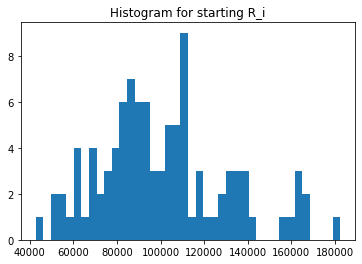

In [22]:
import matplotlib.pyplot as plt
a = starting_Ri.unique()
_ = plt.hist(a, bins=40)  # arguments are passed to np.histogram
plt.title("Histogram for starting R_i")
plt.show()

In [23]:
experiments.UNI_Qi.unique()

array([234991.00271916, 170022.27207922, 168902.27207922, ...,
       123189.16173035, 124229.16173035, 130149.30901628])

In [24]:
experiments.UNI_Si.unique()

array([10000., 14191., 14133., 16772., 15156., 15601., 15728., 17465.,
       15567., 15585., 14620., 14559., 13020., 16917., 13687., 18409.,
       14424., 18630., 14544., 12653., 14781., 14944., 16762., 14430.,
       14300., 14379., 15378., 18315., 13607., 17969., 15482., 15908.,
       14056., 15442., 15119., 15432., 16335., 13013., 17437., 14709.,
       15105., 16495., 15557., 15598., 16213., 14283., 14257., 15941.,
       15238., 13589., 15806., 14260., 13877., 12928., 15863., 17554.,
       13430., 13782., 13043., 13508., 16961., 14869., 15205., 15342.,
       14992., 13466., 16593., 14330., 15479., 14984., 14435., 14635.,
       14421., 15066., 15381., 17355., 15277., 13728., 14440., 18274.,
       14317., 12887., 14233., 14861., 15736., 20476., 17475., 13357.,
       15369., 13751., 14917., 13547., 12924., 14920., 15118., 12959.,
       14664., 13924., 14060., 14149., 18856., 14503., 16584., 15044.,
       12667., 13995., 15864., 14736., 14353., 15015., 14708., 17248.,
      

In [25]:
experiments.UNI_Qj.unique()

array([126330.07812691, 110748.74691397, 109874.74691397, ...,
       145692.46618058, 146606.46618058, 147532.46618058])

In [26]:
experiments.UNI_Rj.unique()

array([ 63165.03906345, 125208.87345698, 126208.87345698, ...,
       159830.23309029, 158830.23309029, 157830.23309029])

In [27]:
starting_Rj = experiments[experiments.timestep == 0]
starting_Rj = starting_Rj['UNI_Rj']
starting_Rj.reset_index(drop=True)
starting_Rj.unique()

array([ 63165.03906345,  83208.87345698,  60451.16988137,  75712.47751304,
       103287.49423241,  84923.05324348, 120984.18084661,  63442.84106905,
       116953.60063319, 203603.89426884,  70637.8515887 ,  72504.54004228,
       165383.63001383, 241801.61985332,  74197.58905611,  90073.97902637,
        77550.68873137,  91768.07509395,  70835.0546442 , 102250.45421452,
       122517.9231894 , 105116.39453922, 116616.98134039,  97663.74858756,
       101974.26537912, 222454.13679694,  93947.03753225,  75967.60527887,
       107196.4876564 ,  97612.50149636,  99143.07131612,  69004.39540919,
        53642.98879822,  93003.37329919, 129273.91133498, 101907.3757217 ,
       157670.46393556,  74439.70910161,  98879.60449674, 116603.55162645,
       110283.05588753, 144911.36733928, 127643.6336613 , 126081.64059932,
        68430.98066127,  74921.44508323, 116626.08498325, 183238.25473686,
        67930.26018656,  80193.22430096, 107830.23309029,  79304.65485187,
       113322.92096438, 1

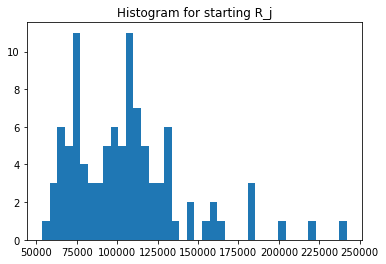

In [28]:
a = starting_Rj.unique()
_ = plt.hist(a, bins=40)  # arguments are passed to np.histogram
plt.title("Histogram for starting R_j")
plt.show()

In [29]:
experiments.UNI_Sj.unique()

array([10000], dtype=int64)

In [30]:
experiments.UNI_ij.unique()

array([117495.50135958, 112969.63603961, 112290.1753212 ,  68824.92112422,
        90966.24299436,  82257.98971196,  82286.50855935,  62973.06639424,
        83802.88617593,  84516.21258366, 102216.11620354, 103666.06970946,
       161561.20028609, 130603.02513683, 103023.28983708,  67282.02216372,
        52458.35073539, 107014.65789057,  52935.55780611, 182437.27830573,
        99562.84804397, 108843.04166626,  93117.88422135,  70940.73323924,
       111261.18377294,  79621.8676403 , 108170.57813688,  85969.93480342,
        57126.84793488, 134599.42759769,  53738.68354952,  84201.59076479,
       119257.05562057,  85865.50347172,  92668.15450814,  86034.4775969 ,
        76917.92516885, 160920.31283036,  63227.95366503, 100166.11696606,
        92933.55858926,  71981.73815777,  83317.25550298,  84970.44067322,
        74472.65917597, 110738.61693473, 112446.39442698,  76154.65308934,
        90450.43859842, 135294.92838467, 111351.95223329,  81106.97228219,
       121962.7820952 , 1

In [31]:
experiments.UNI_ji.unique()

array([ 63165.03906345,  83208.87345698,  75712.47751304,  72504.54004228,
        84923.05324348,  60451.16988137, 103287.49423241,  63442.84106905,
       120984.18084661, 116953.60063319, 157670.46393556, 203603.89426884,
        70637.8515887 ,  74197.58905611,  91768.07509395, 165383.63001383,
       241801.61985332,  77550.68873137,  90073.97902637, 102250.45421452,
        70835.0546442 , 105116.39453922, 122517.9231894 , 116616.98134039,
        97663.74858756, 107196.4876564 , 101974.26537912,  99143.07131612,
        93947.03753225, 116603.55162645, 222454.13679694,  75967.60527887,
        97612.50149636, 108719.28576106,  69004.39540919,  53642.98879822,
        93003.37329919, 129273.91133498, 127643.6336613 , 101907.3757217 ,
        74439.70910161,  98879.60449674, 110283.05588753, 126081.64059932,
       144911.36733928,  68430.98066127,  74921.44508323, 183238.25473686,
       116626.08498325,  79304.65485187,  67930.26018656,  78297.27648277,
       107830.23309029,  

In [32]:
experiments.UNI_Sij.unique()

array([7.42160793e+09, 9.40007615e+09, 8.50176737e+09, 4.99011925e+09,
       7.72513110e+09, 4.97259171e+09, 8.49916728e+09, 3.99519024e+09,
       1.01388235e+10, 9.88447537e+09, 1.61164625e+10, 2.11068155e+10,
       1.14123361e+10, 9.69042959e+09, 9.45424900e+09, 1.11273451e+10,
       1.26845142e+10, 8.29906042e+09, 4.76811632e+09, 1.86542946e+10,
       7.05253978e+09, 1.14411881e+10, 1.14086098e+10, 8.27289416e+09,
       1.08661843e+10, 8.53518455e+09, 1.10306152e+10, 8.52332338e+09,
       5.36689813e+09, 1.56947713e+10, 1.19543925e+10, 6.39659321e+09,
       1.16409795e+10, 9.33523621e+09, 6.39450998e+09, 4.61514652e+09,
       7.15362651e+09, 2.08027983e+10, 8.07064575e+09, 1.02076661e+10,
       6.91794707e+09, 7.11752580e+09, 9.18848155e+09, 1.07132126e+10,
       1.07919349e+10, 7.57795215e+09, 8.42464636e+09, 1.39544457e+10,
       1.05488805e+10, 1.07295176e+10, 7.56416709e+09, 6.35045503e+09,
       1.31512752e+10, 1.26418732e+10, 6.43743324e+09, 9.87537959e+09,
      

What are the trade sizes?

In [33]:
experiments.trade_random_size.unique()

array([1000], dtype=int64)

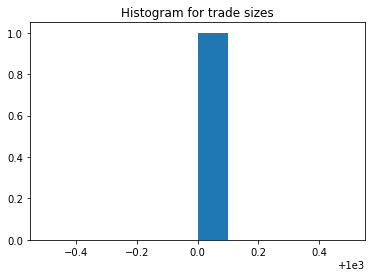

In [34]:
b = experiments.trade_random_size.unique()
_ = plt.hist(b, bins=10)  # arguments are passed to np.histogram
plt.title("Histogram for trade sizes")
#plt.xlim(-2000, 20000)
plt.show()

In [35]:
def get_M(k, v):
    if k == 'sim_config':
        k, v = 'M', v['M']
    return k, v

config_ids = [
    dict(
        get_M(k, v) for k, v in config.__dict__.items() if k in ['simulation_id', 'run_id', 'sim_config', 'subset_id']
    ) for config in configs
]

# Agent sequences

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4459: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


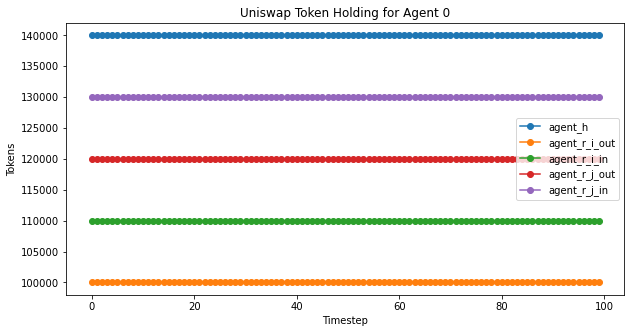

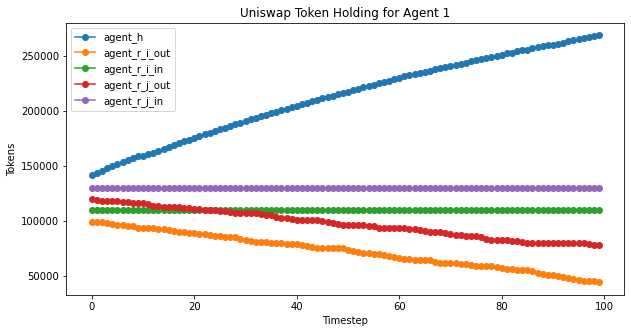

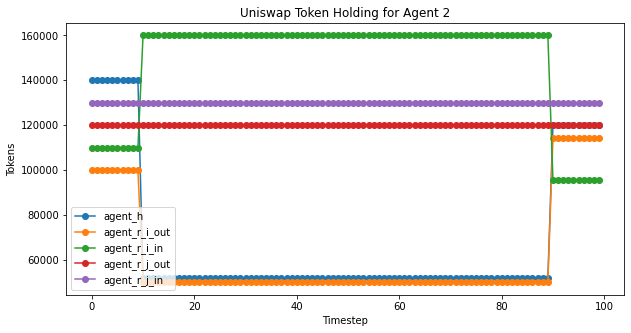

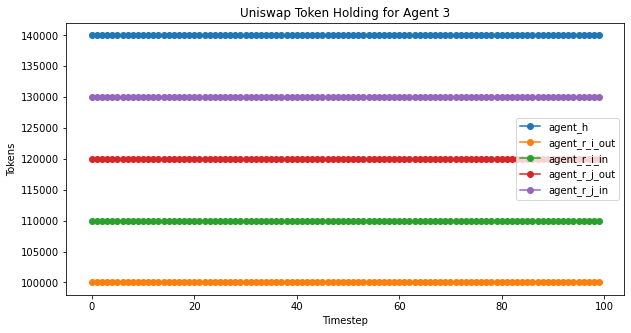

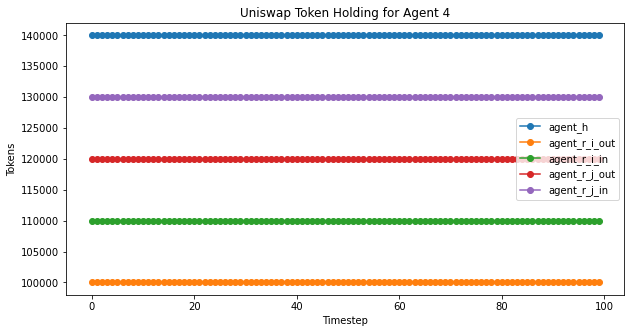

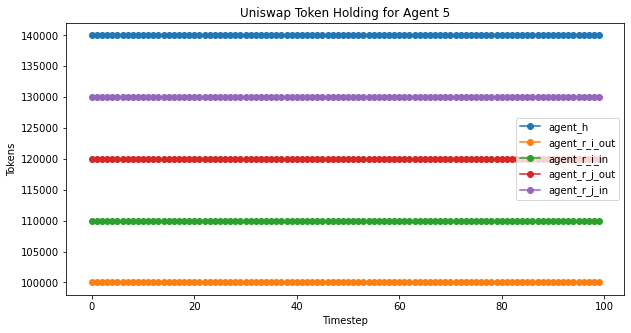

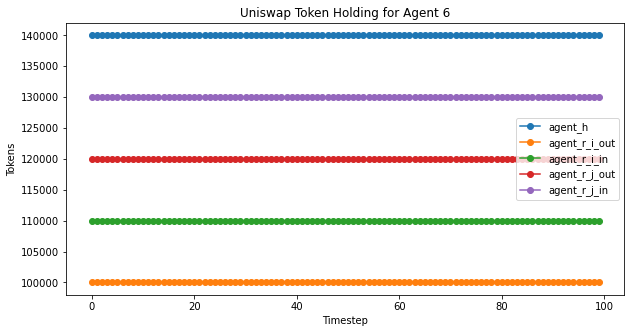

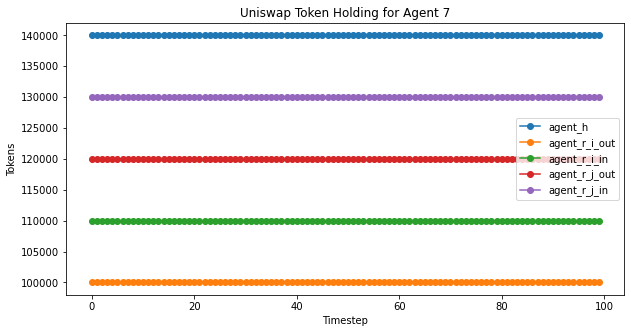

In [36]:
agent_plot(experiment2,'Uniswap Token Holding for Agent ', 100) #,4,'j')

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4459: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


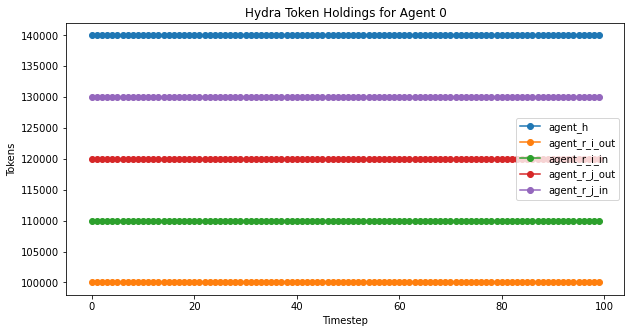

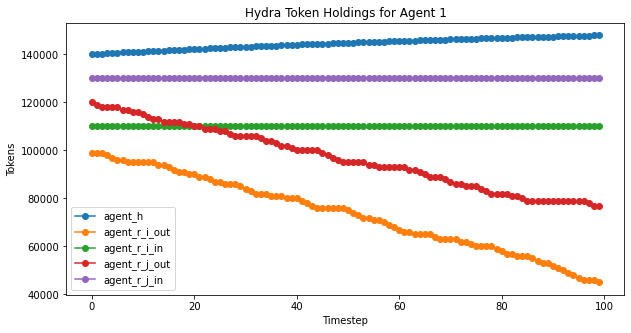

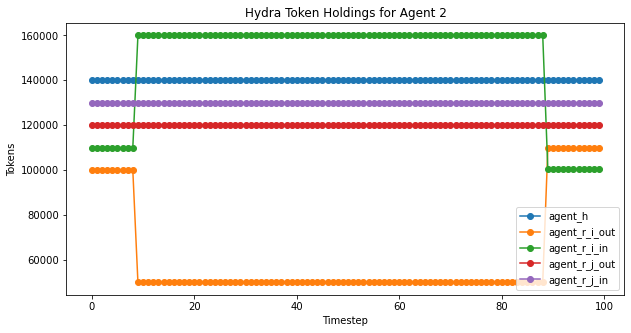

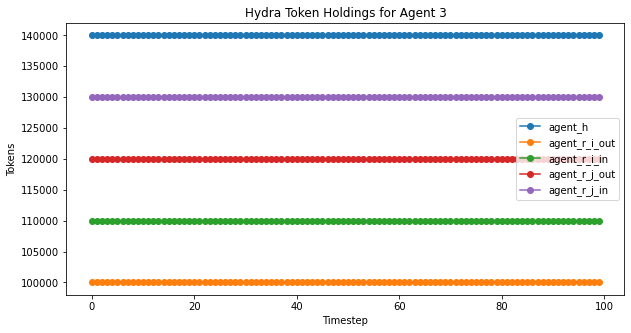

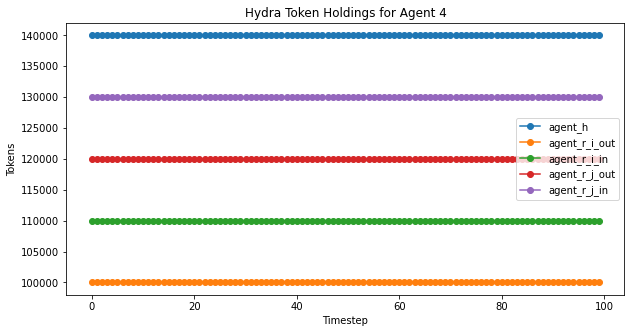

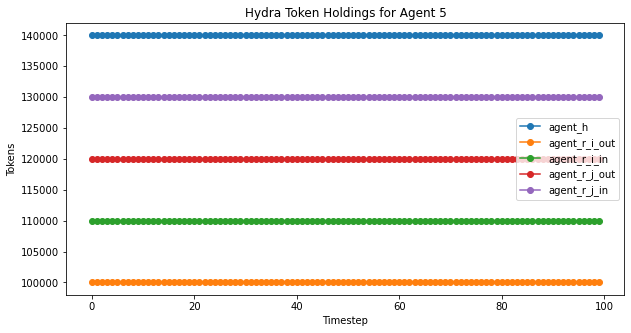

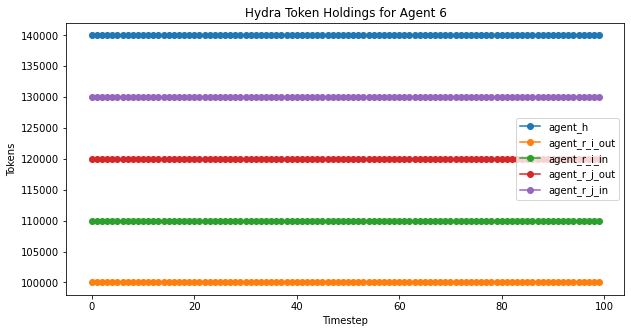

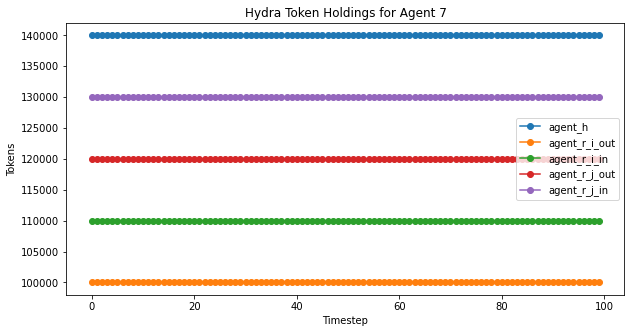

In [37]:
hydra_agent_plot(experiment2,'Hydra Token Holdings for Agent ', 100)

# Liquidity dynamics

Movement of the Uniswap variables

- 'UNI_Ri', 'UNI_Qi', 'UNI_Si'
- 'UNI_Rj', 'UNI_Qj', 'UNI_Sj'
- 'UNI_ij', 'UNI_ji', 'UNI_Sij'

## Uniswap -- Ri-Q instance

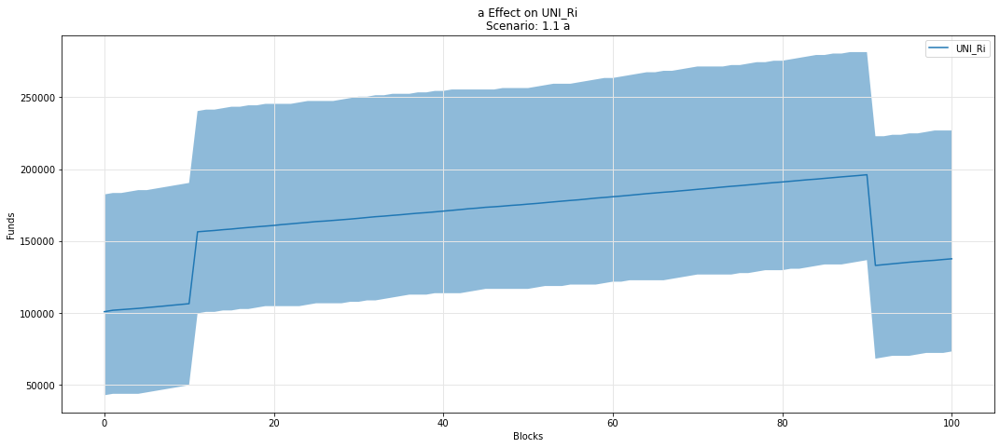

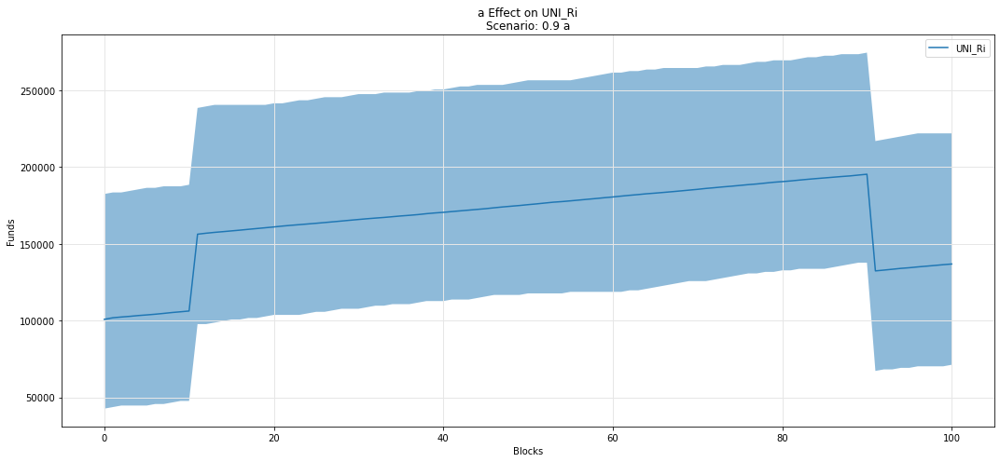

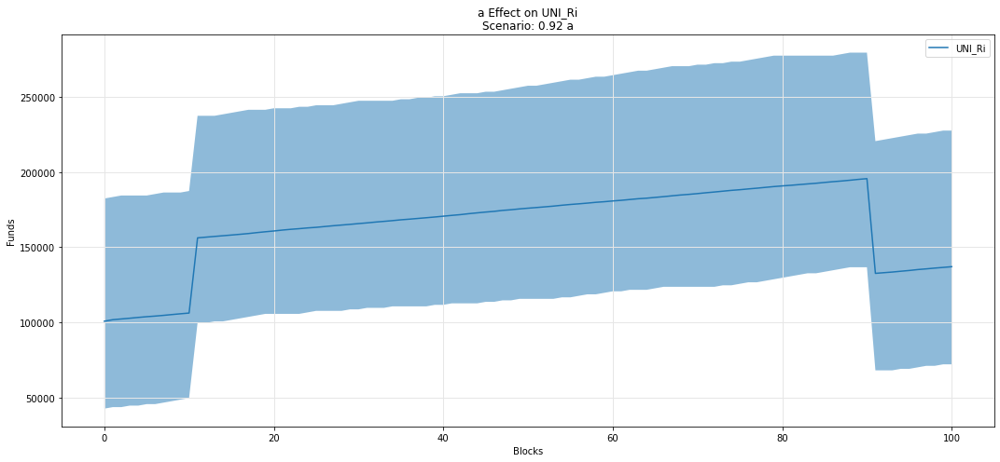

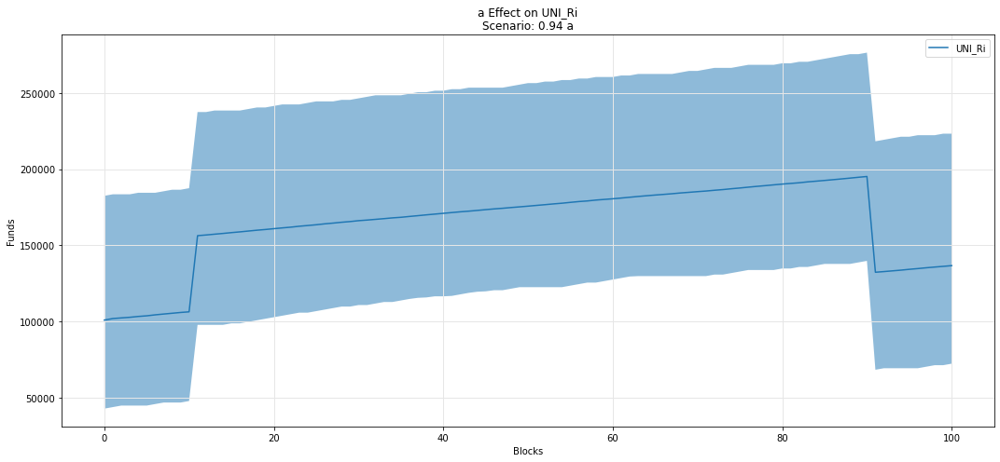

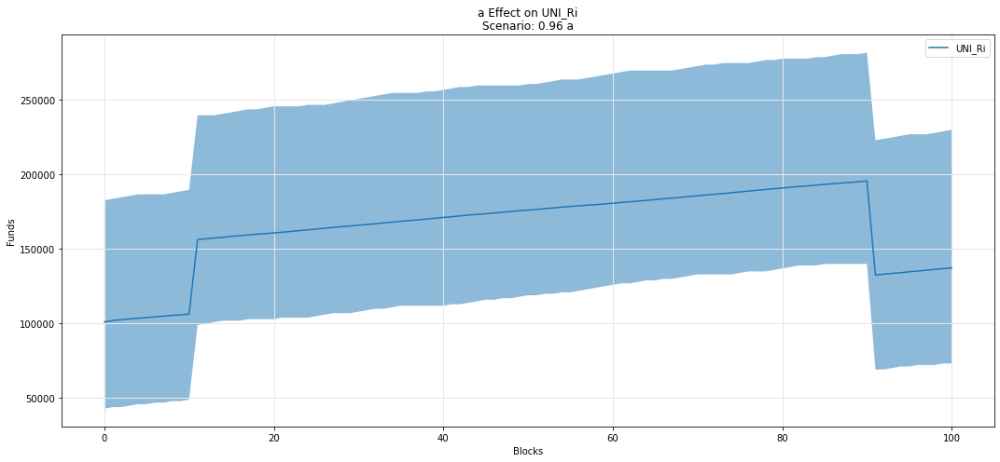

...

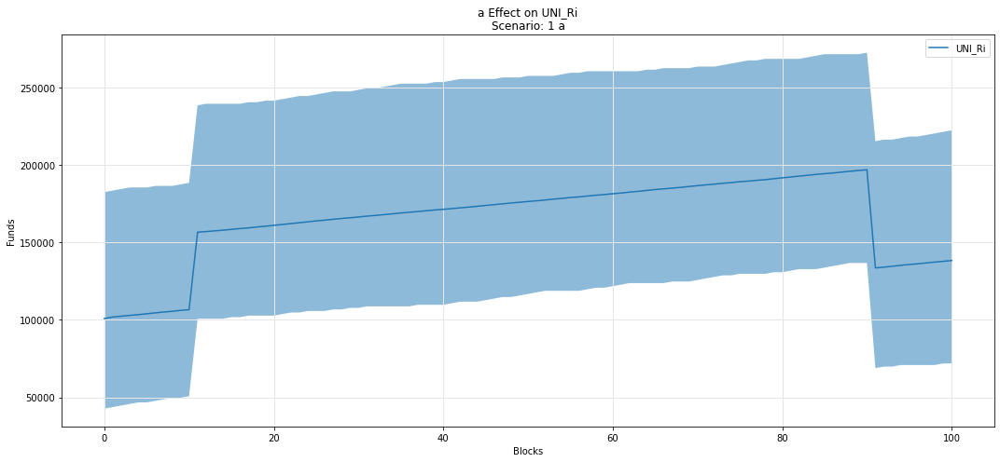

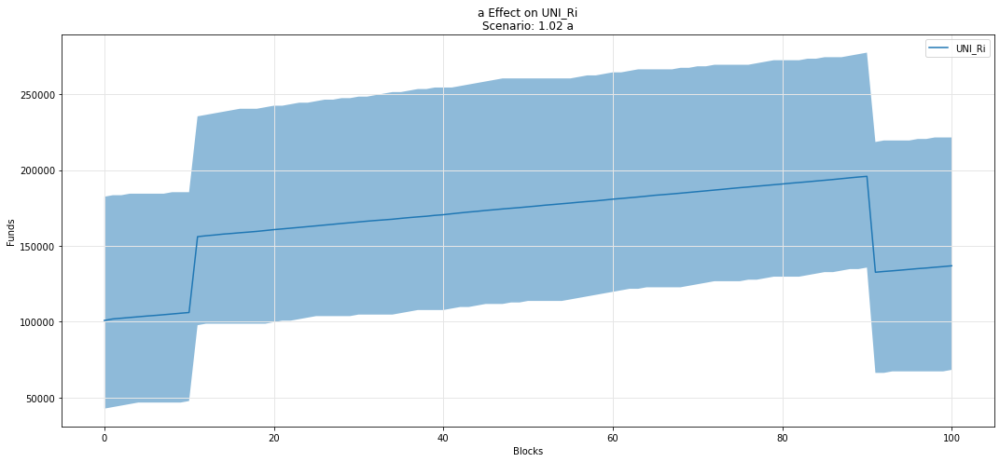

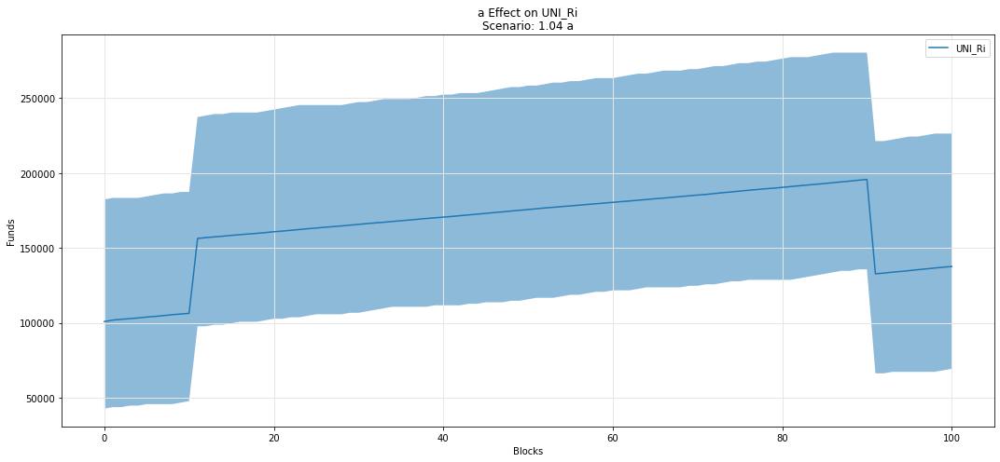

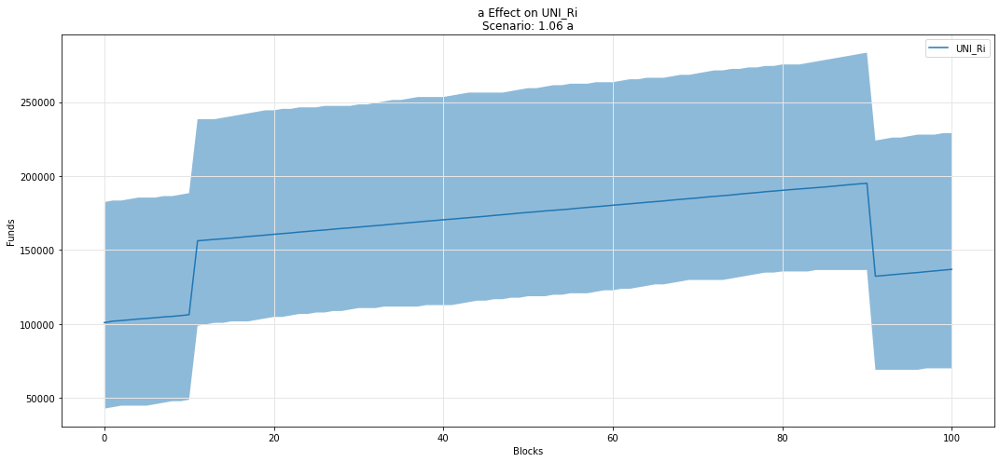

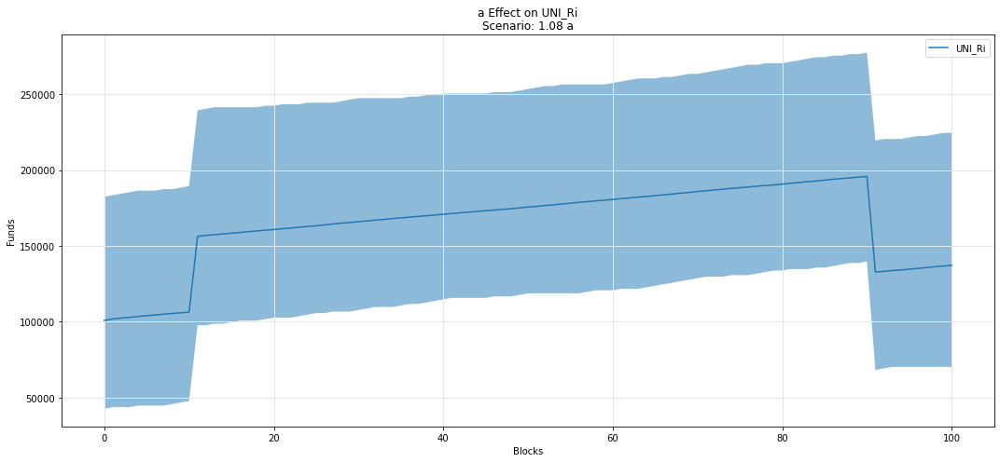

In [38]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Ri')

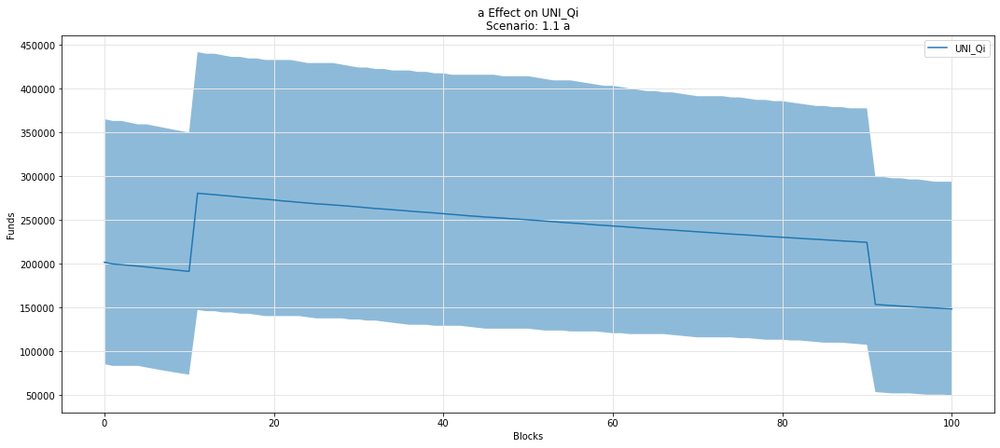

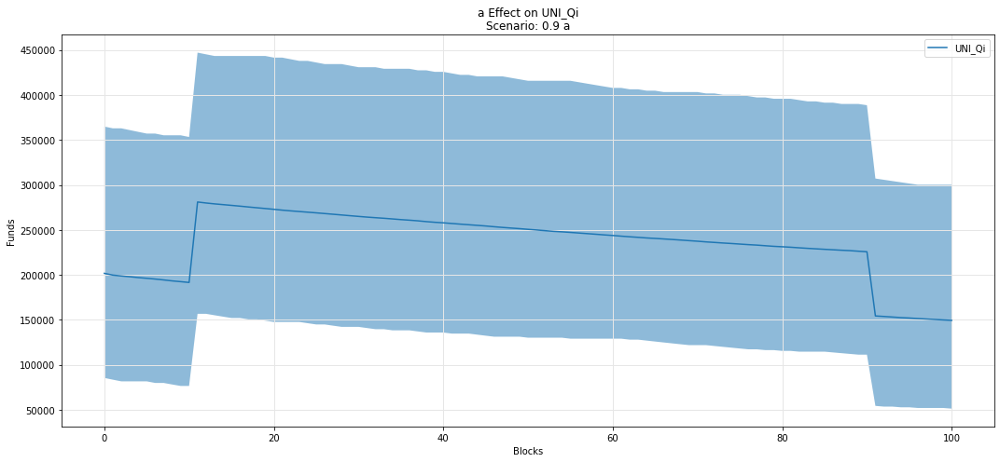

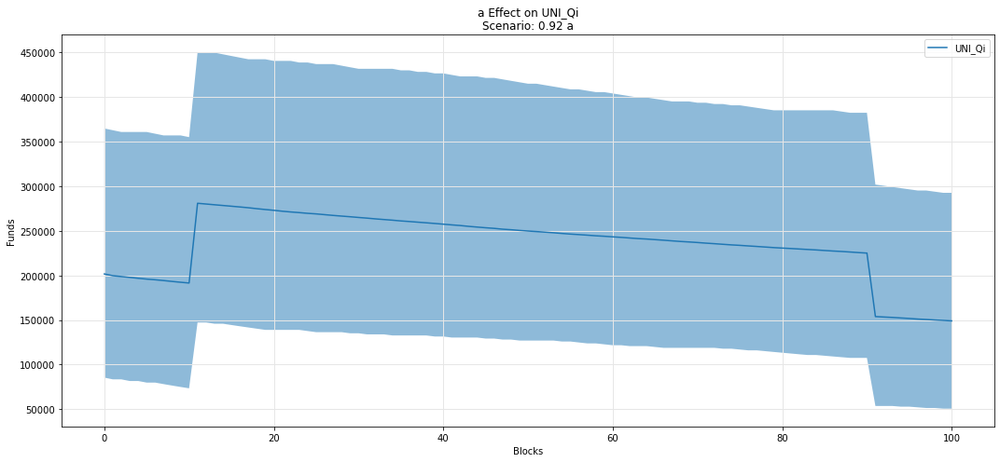

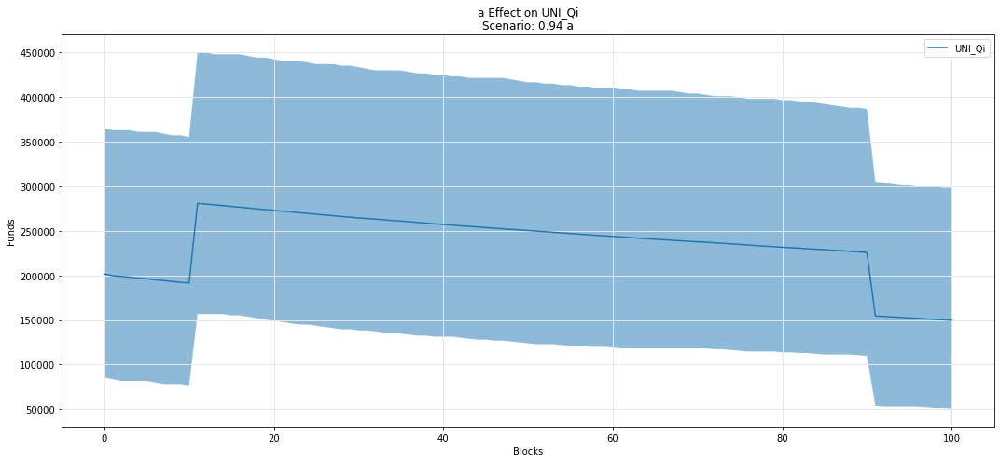

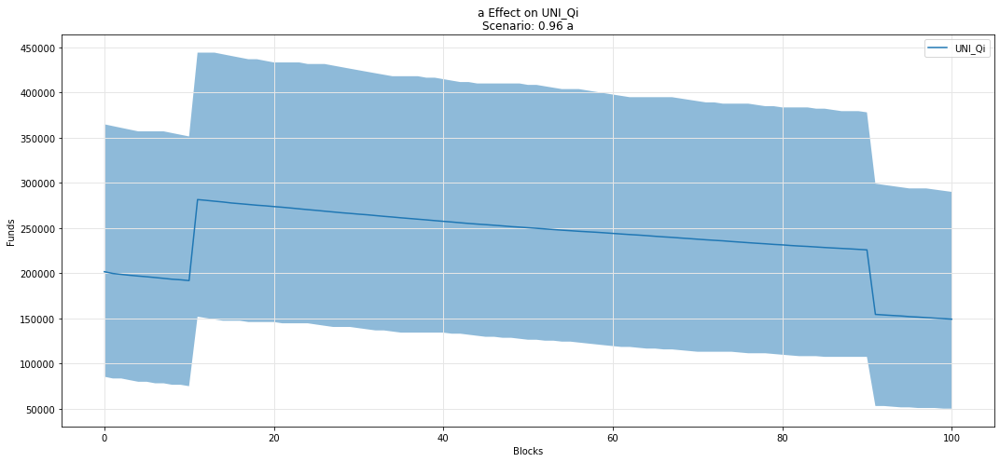

...

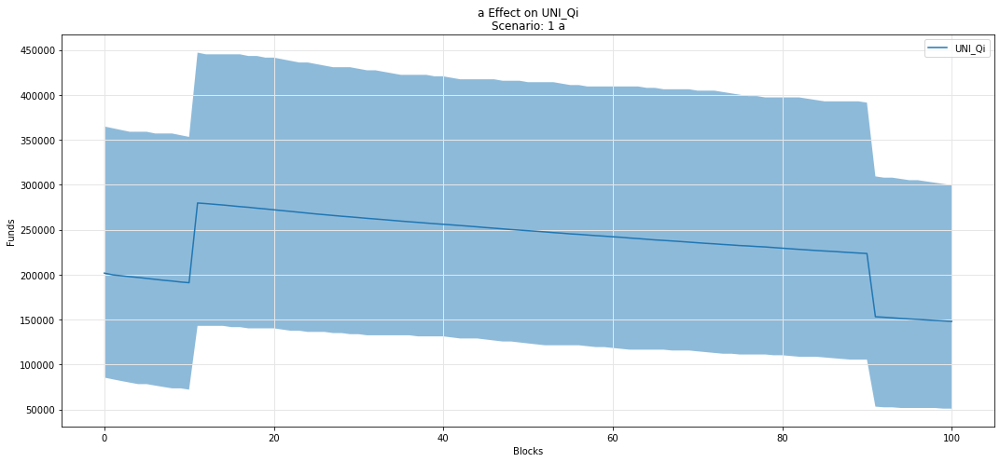

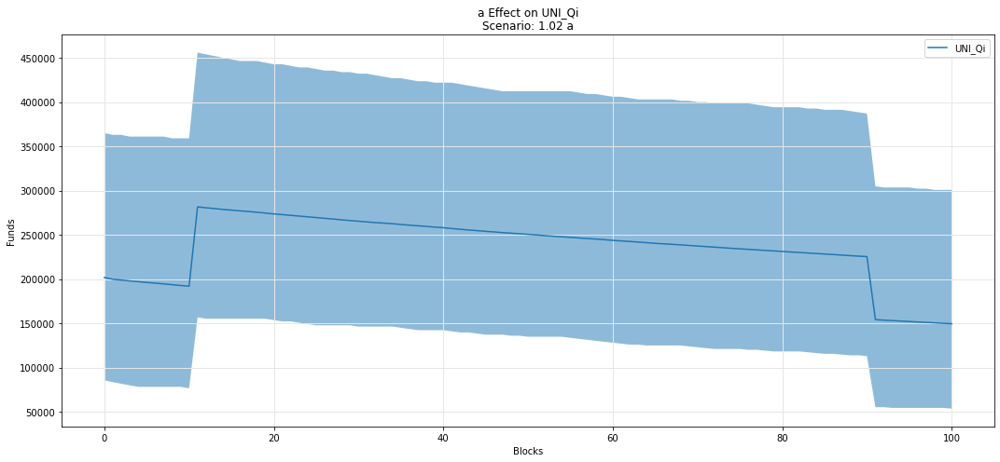

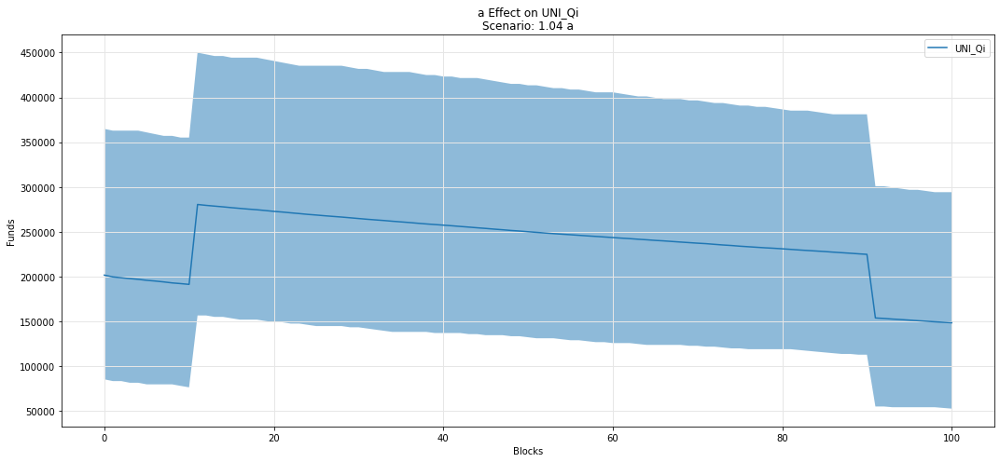

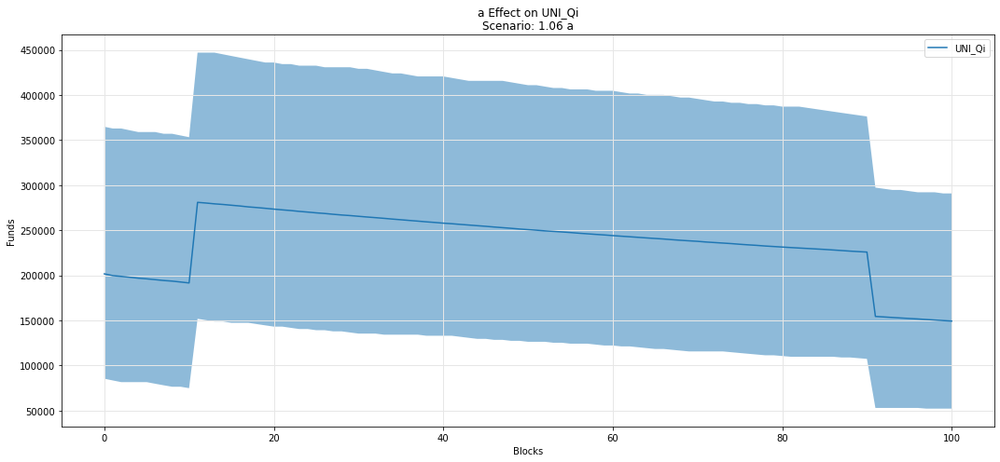

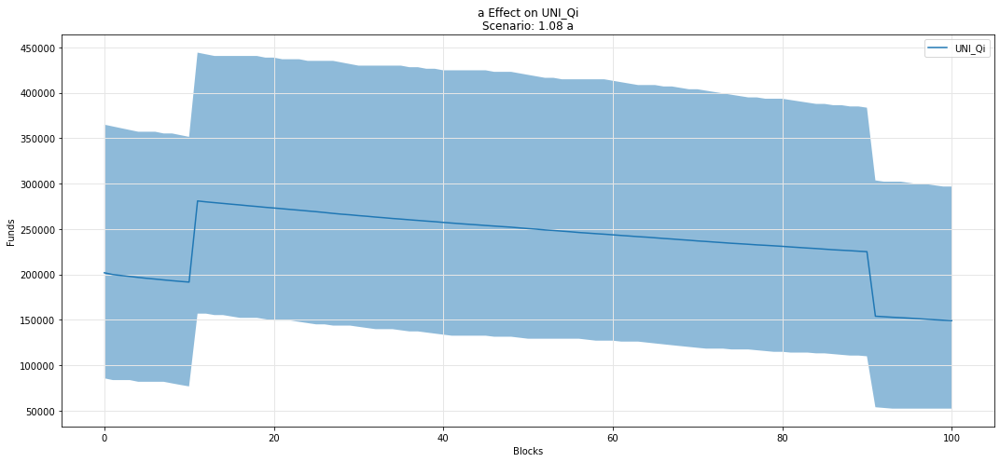

In [39]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Qi')

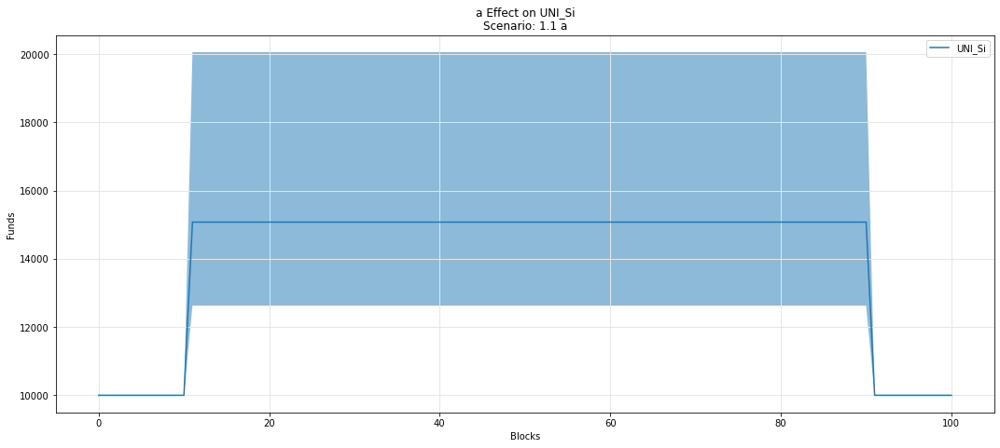

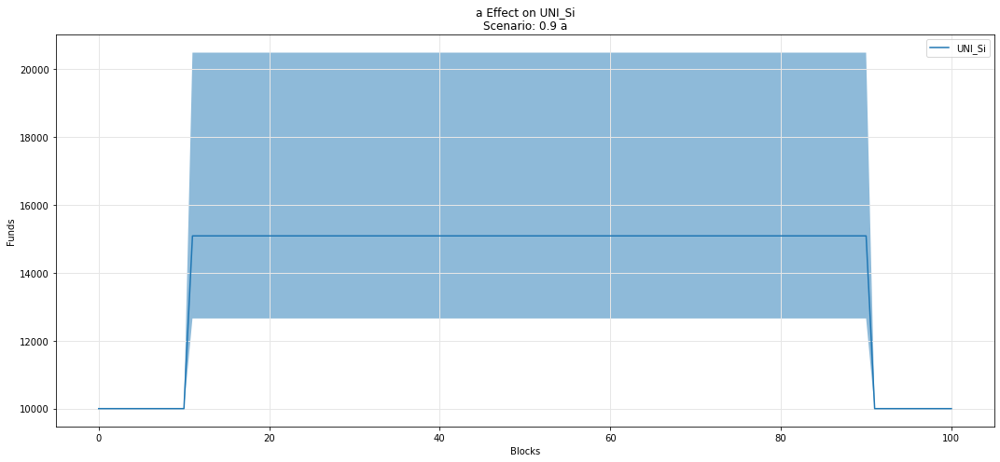

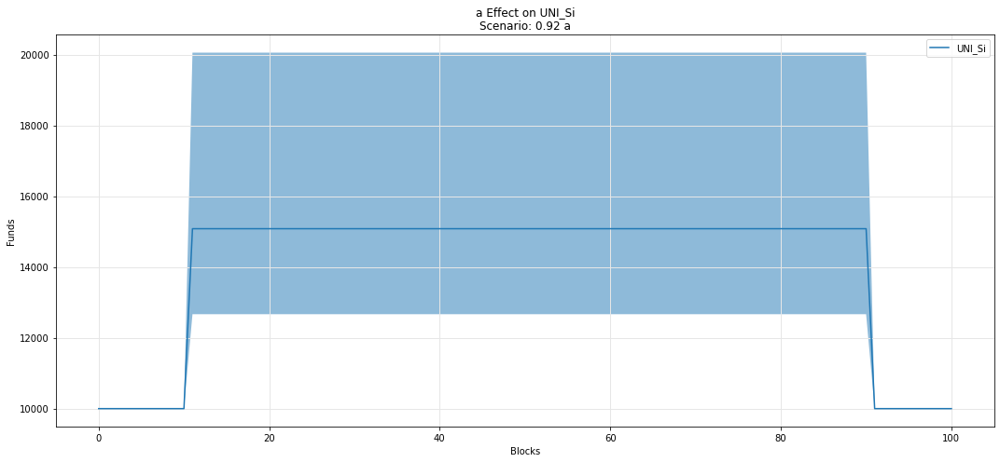

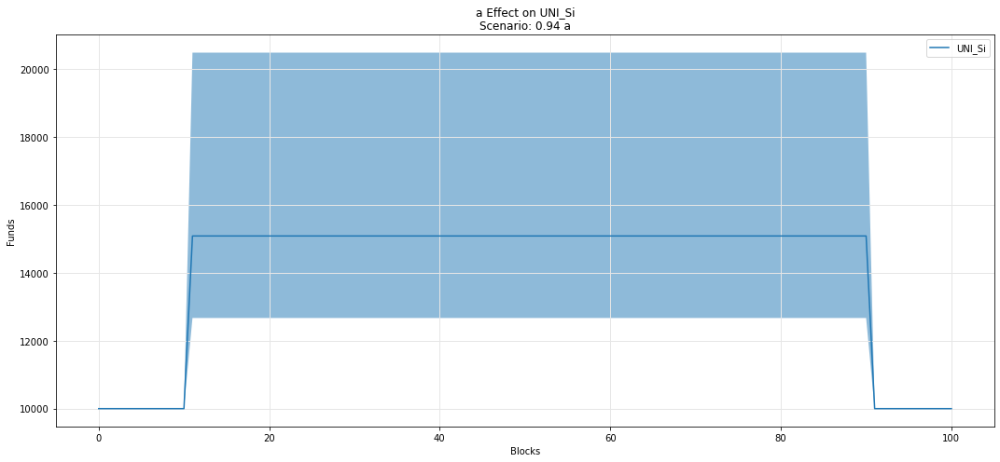

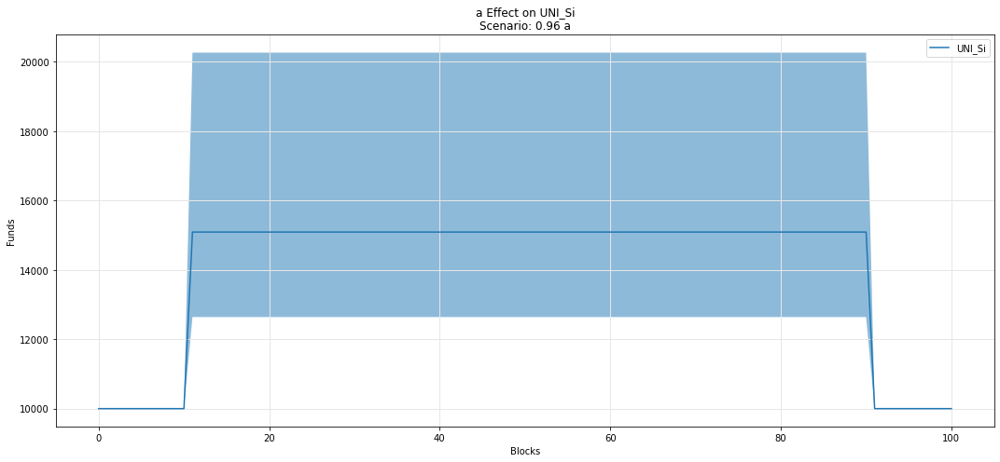

...

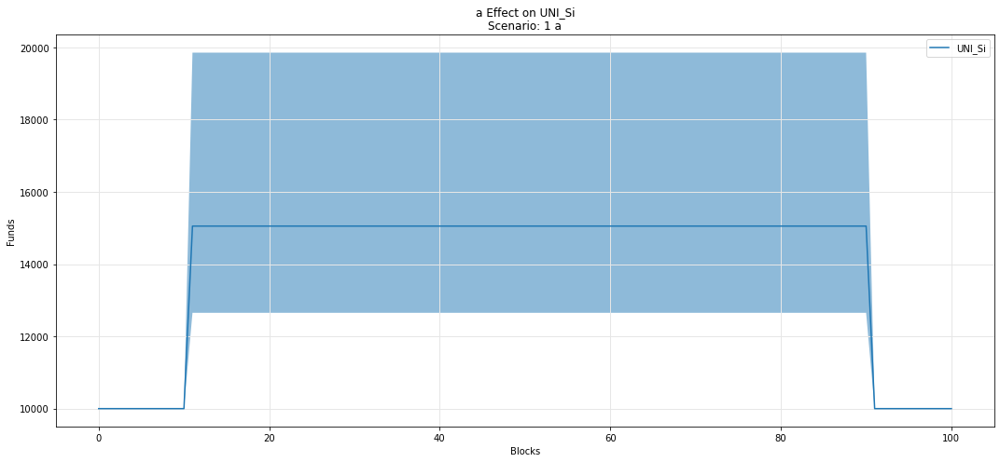

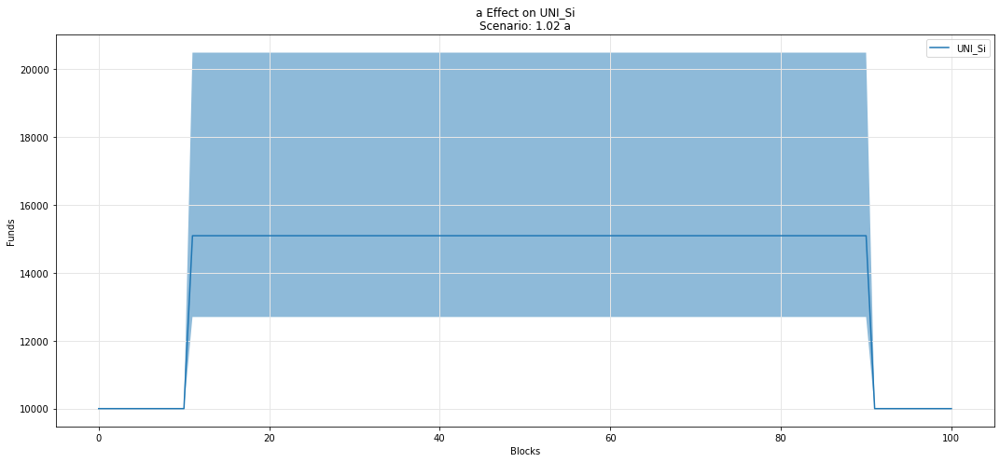

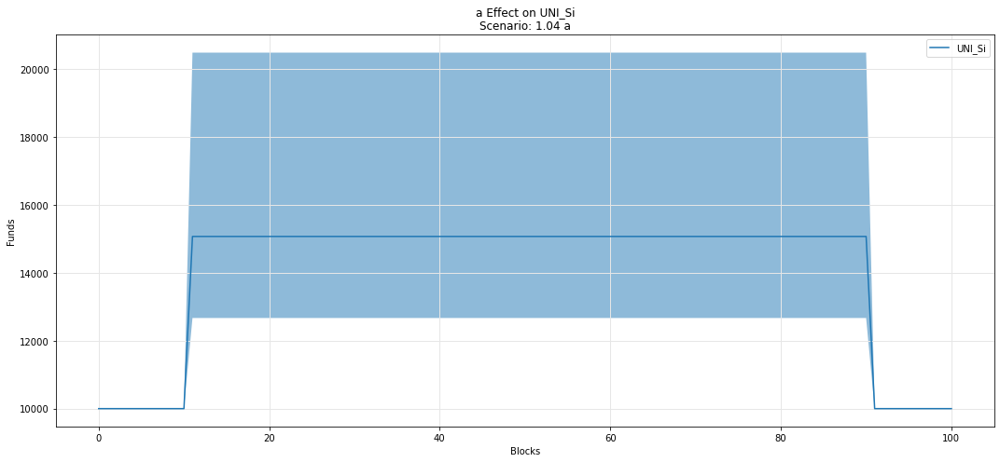

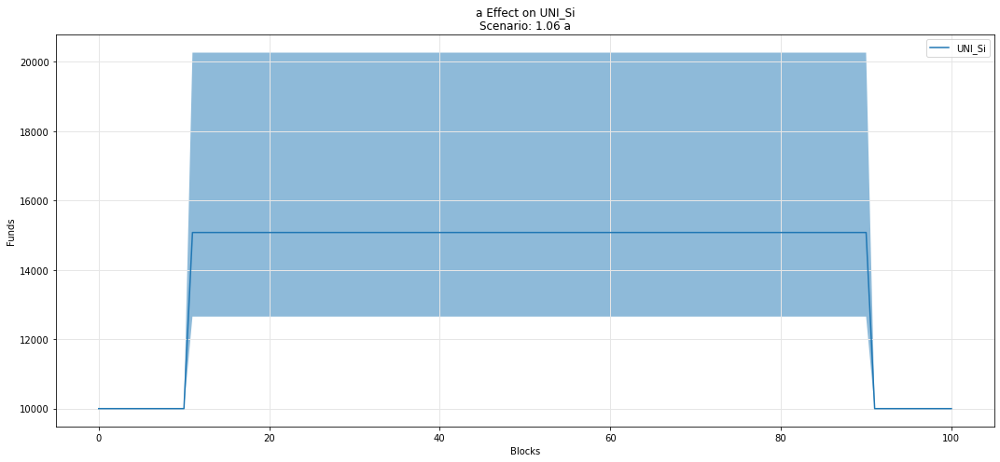

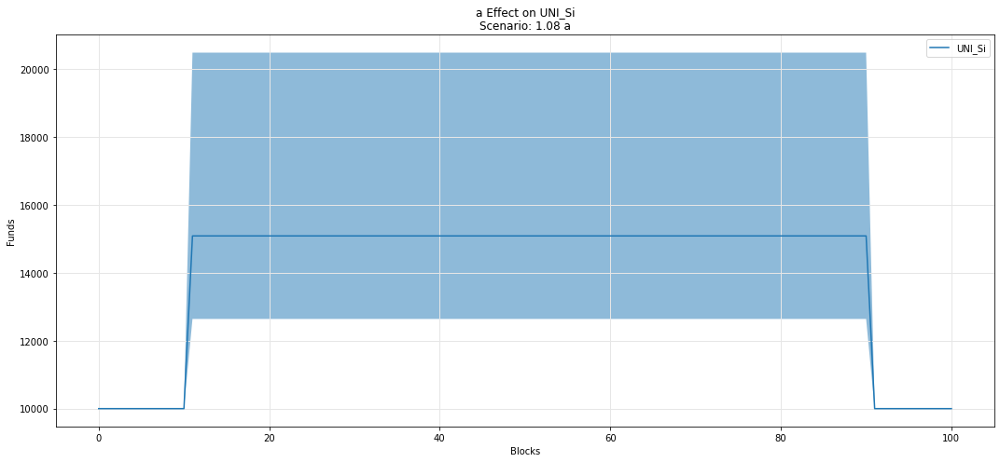

In [40]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Si')

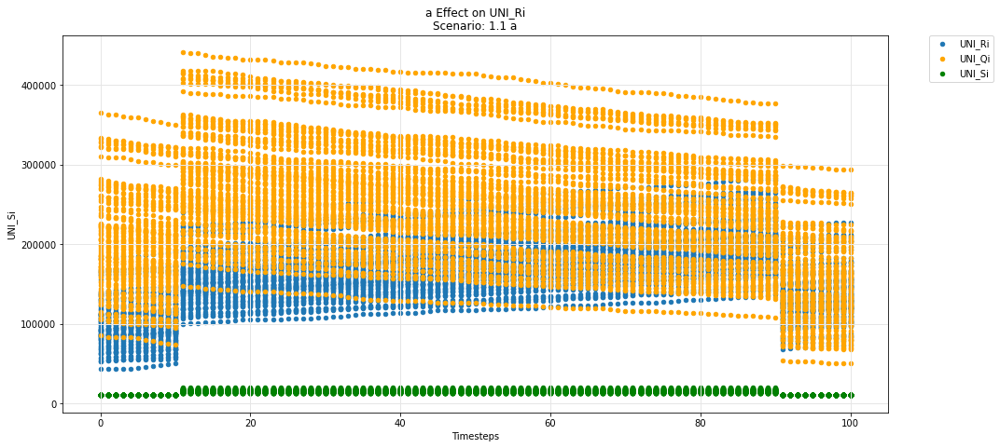

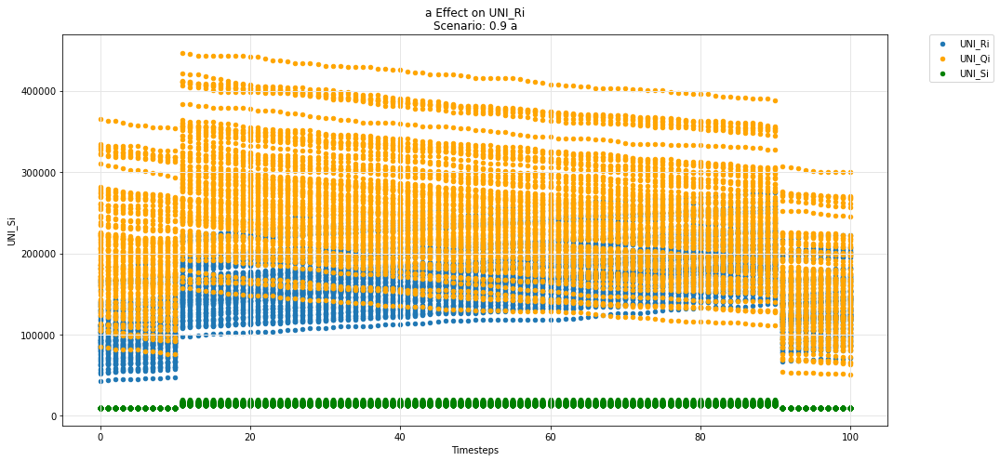

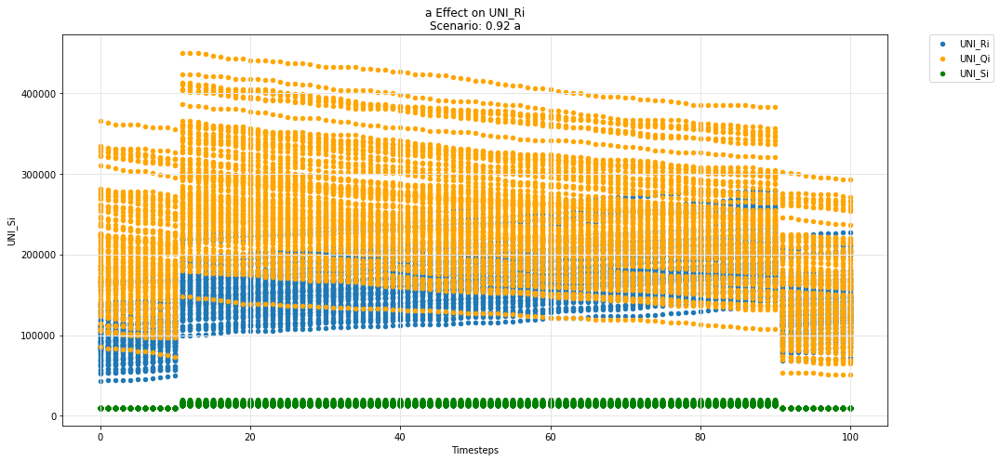

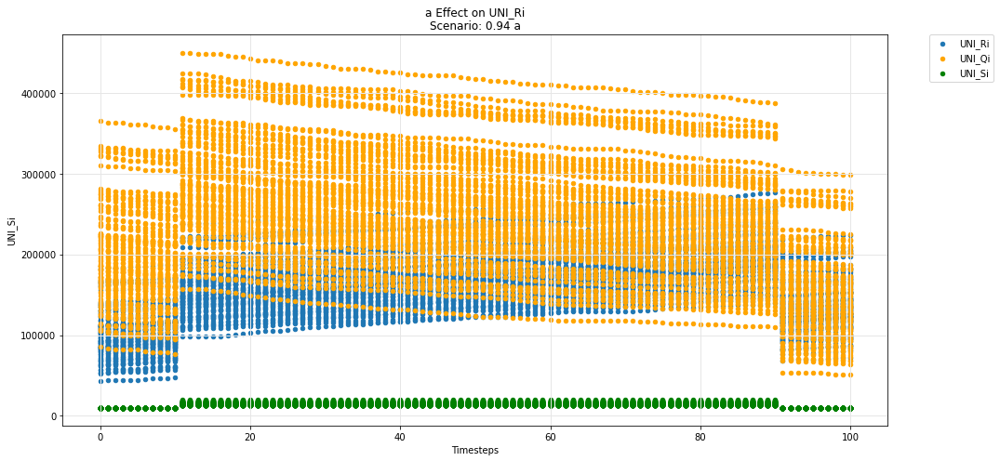

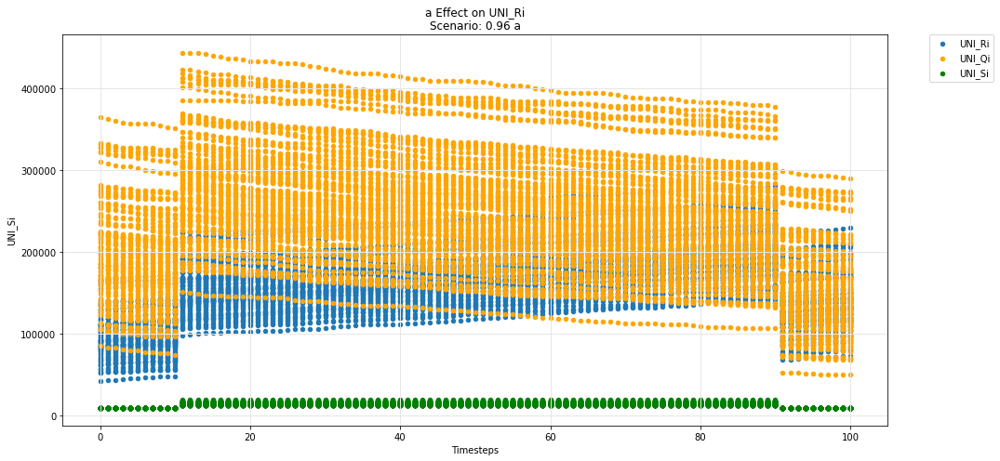

...

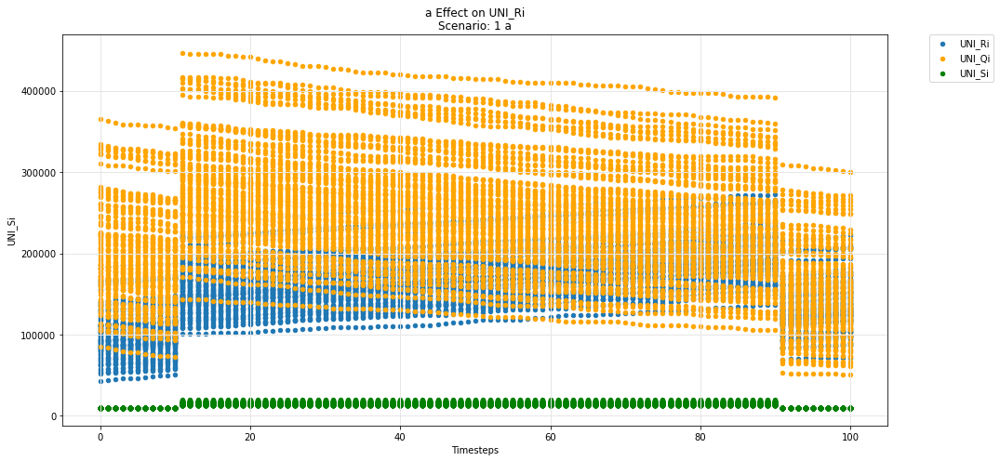

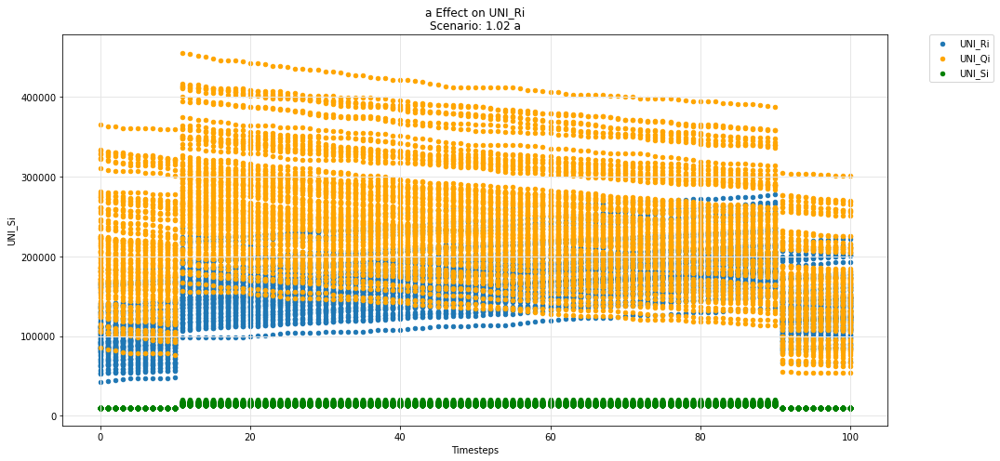

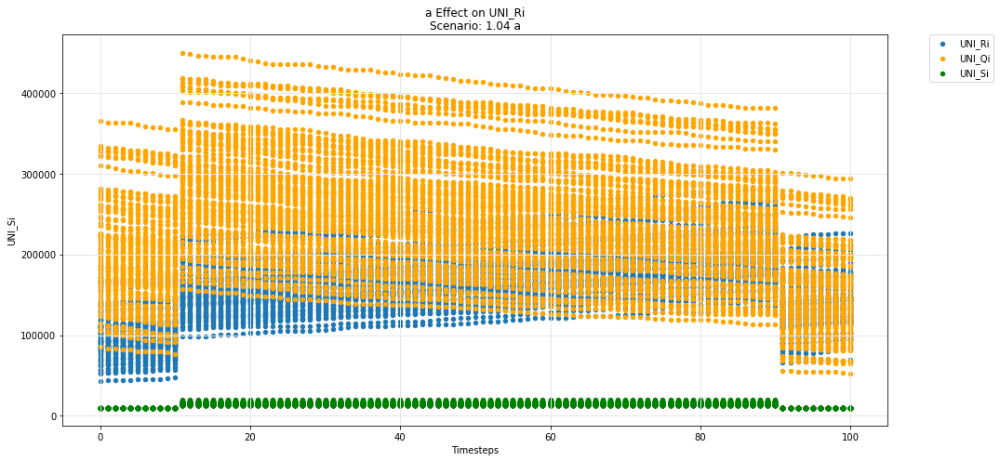

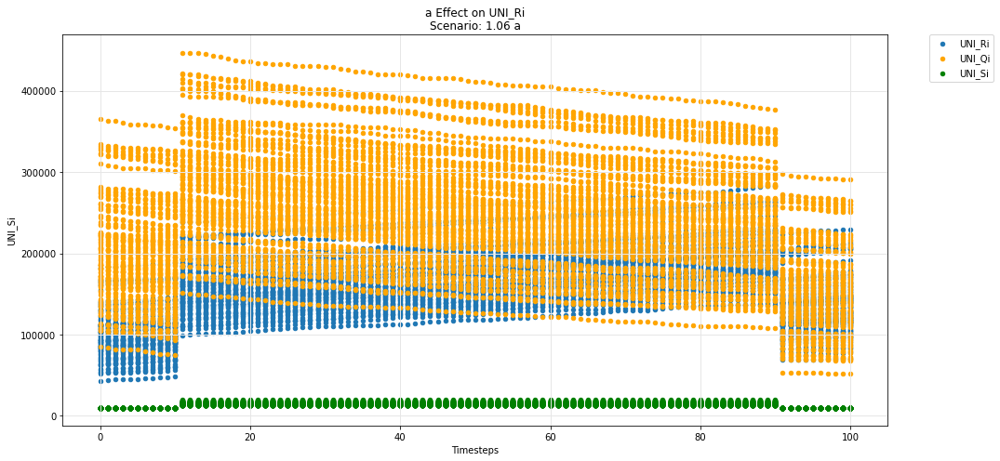

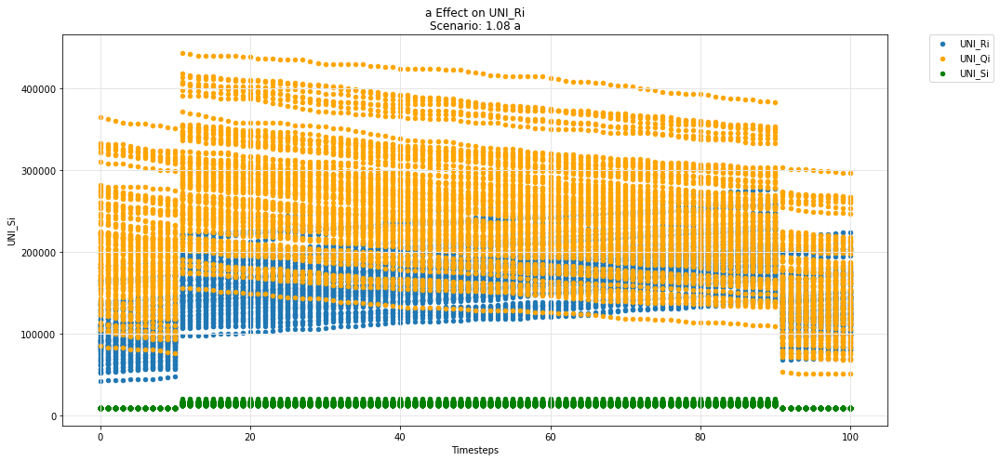

In [41]:
param_test_plot(experiments, config_ids, 'a', 'UNI_Ri', 'UNI_Qi', 'UNI_Si')

## Uniswap -- Rj-Q instance

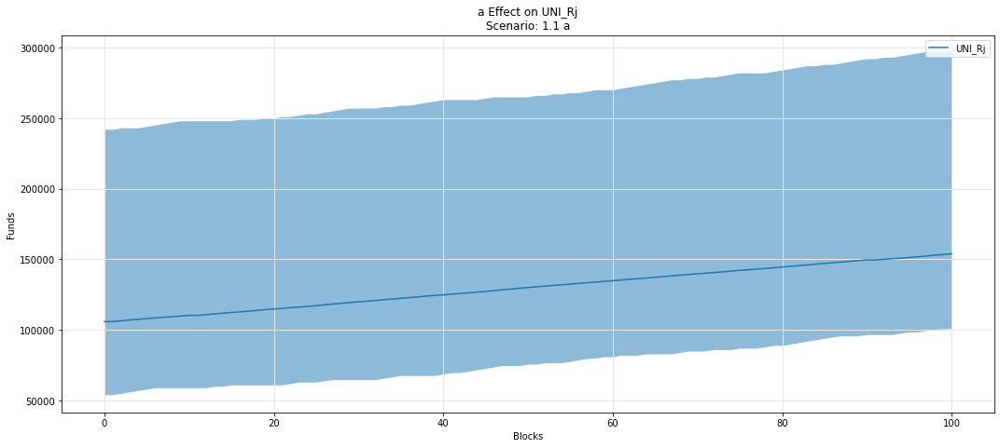

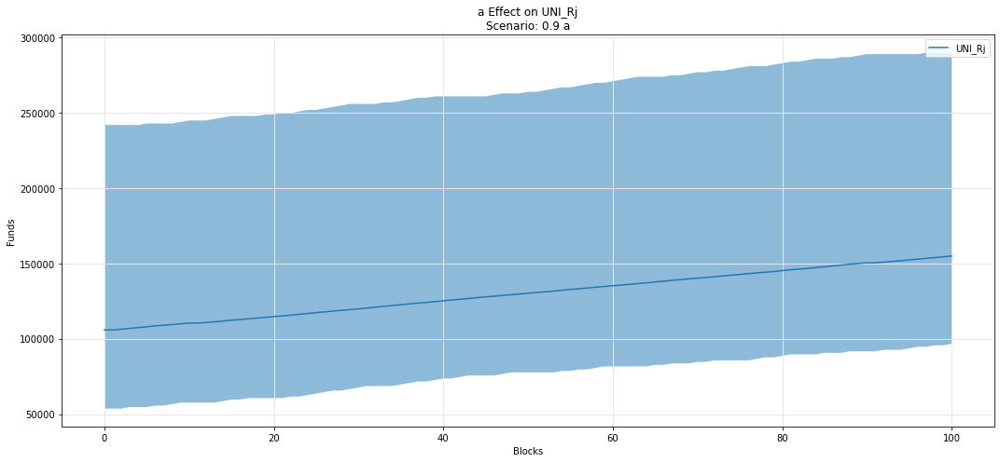

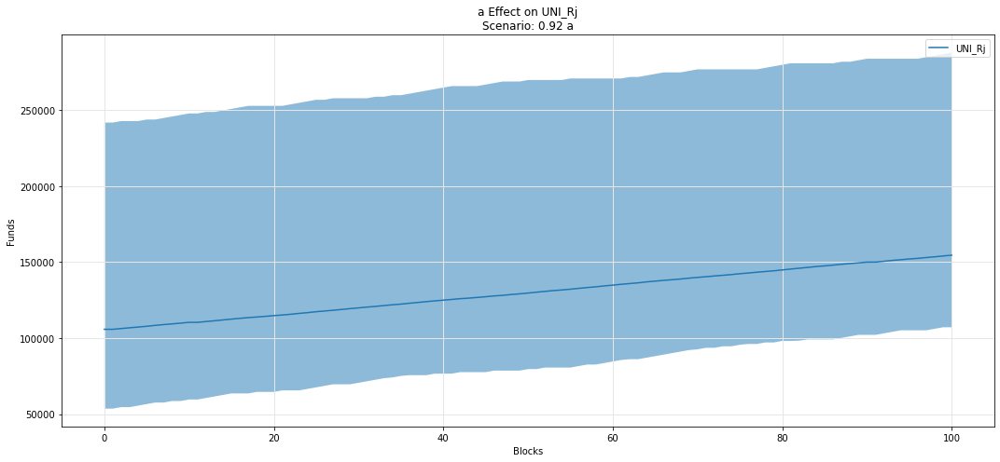

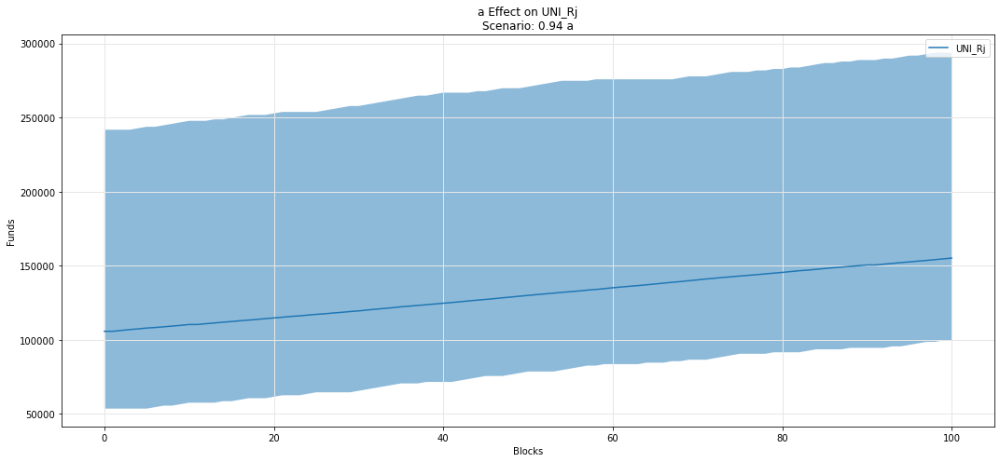

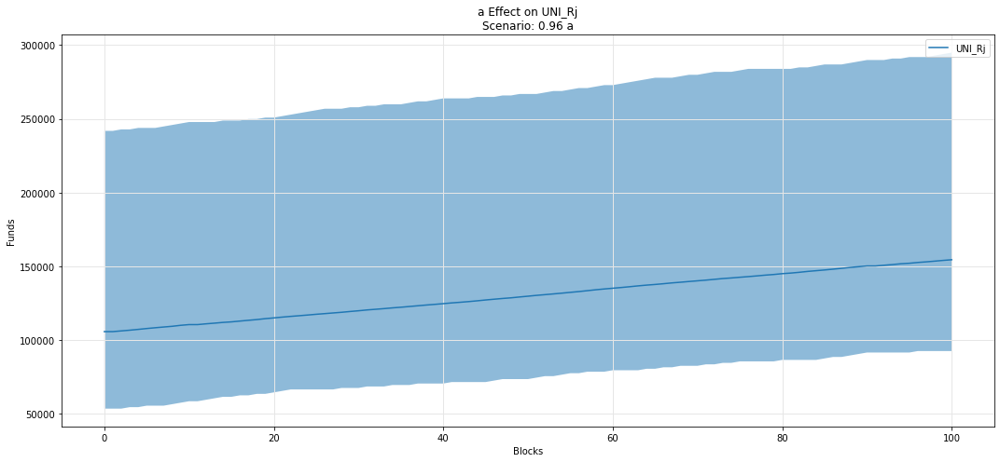

...

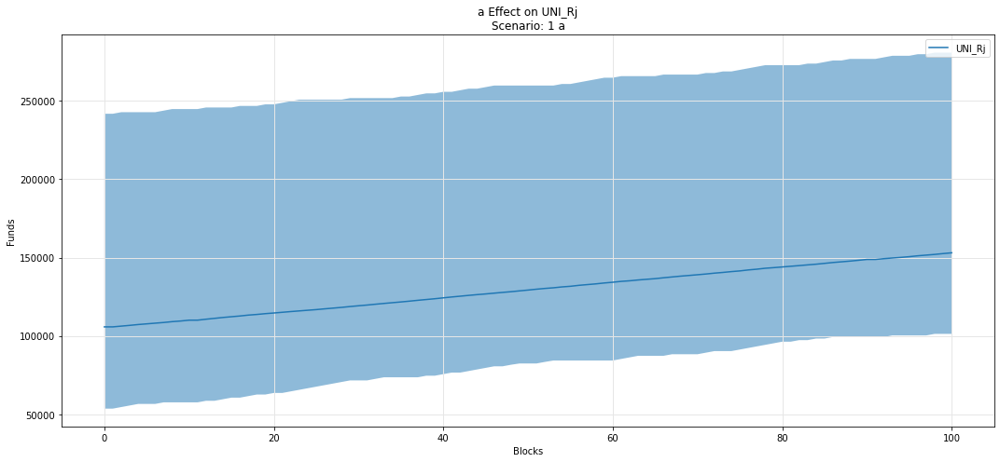

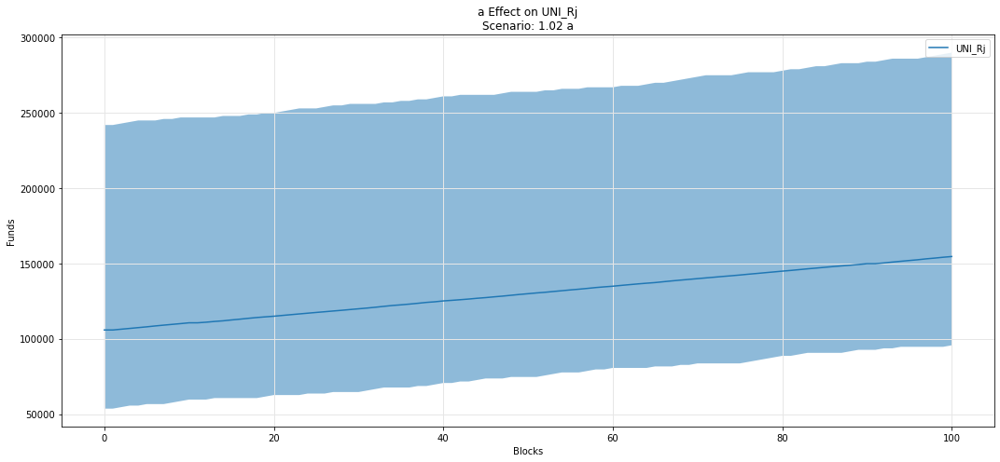

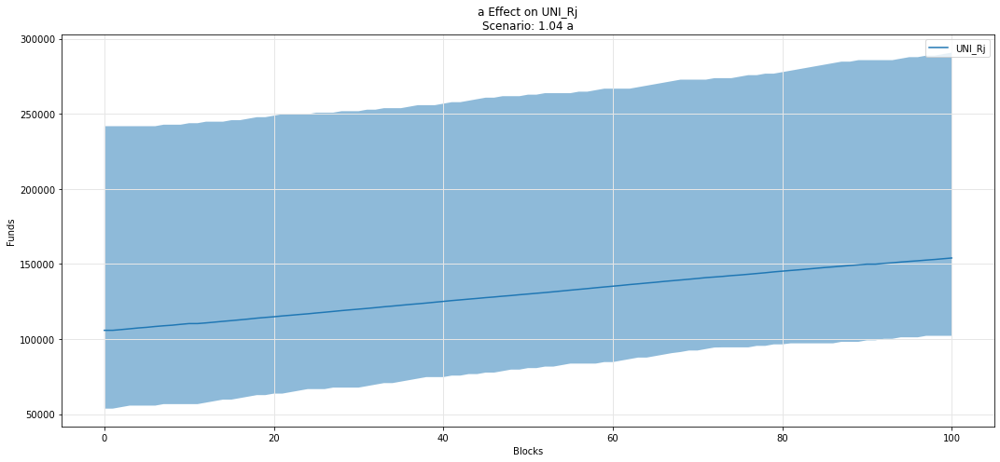

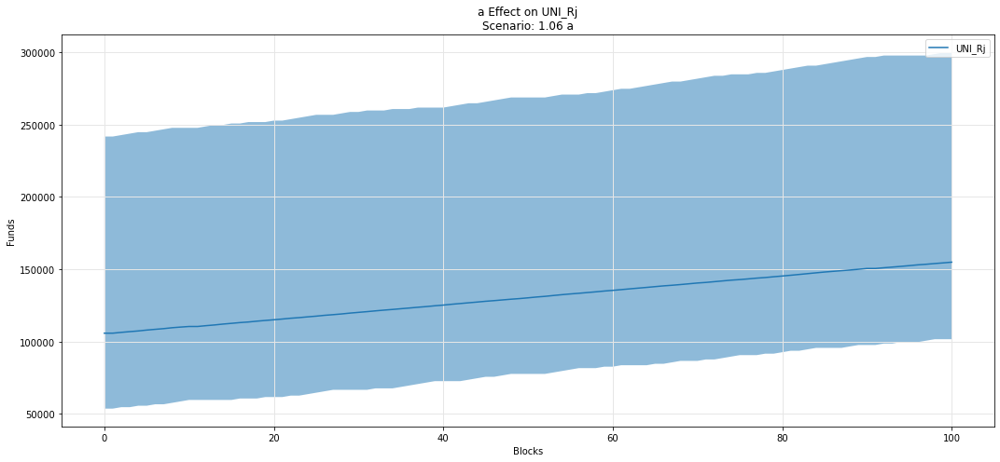

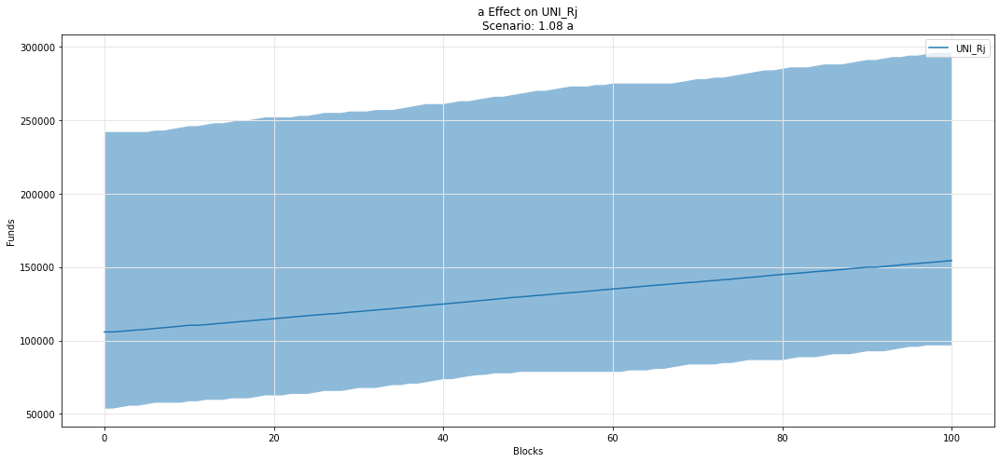

In [42]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Rj')

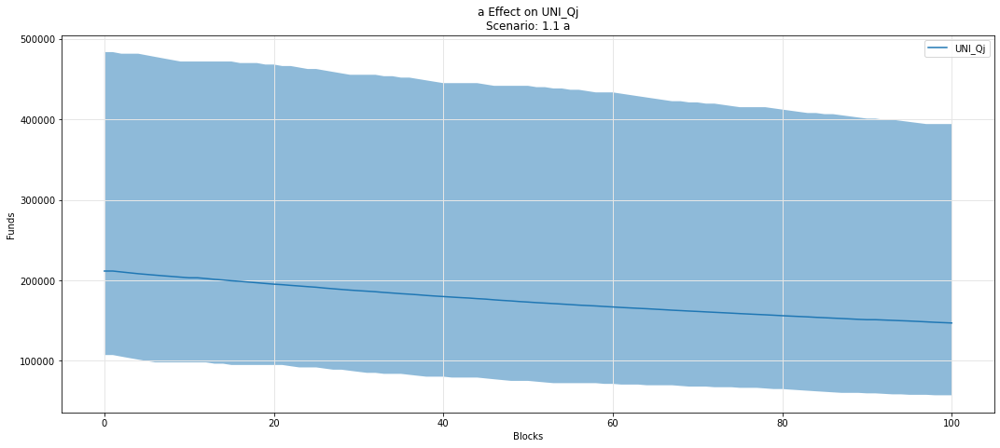

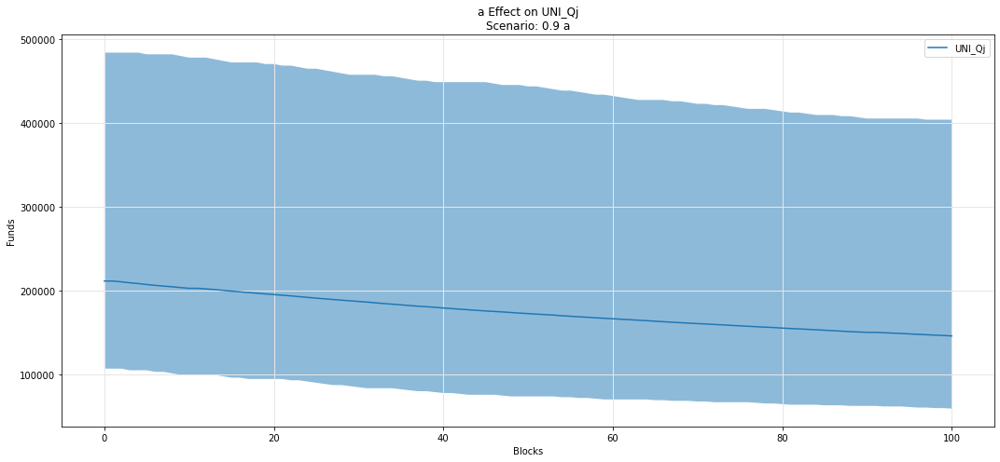

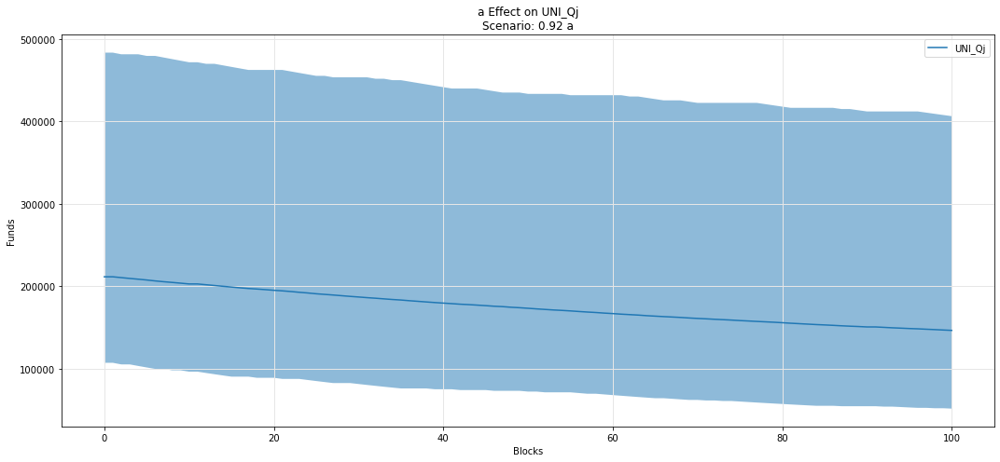

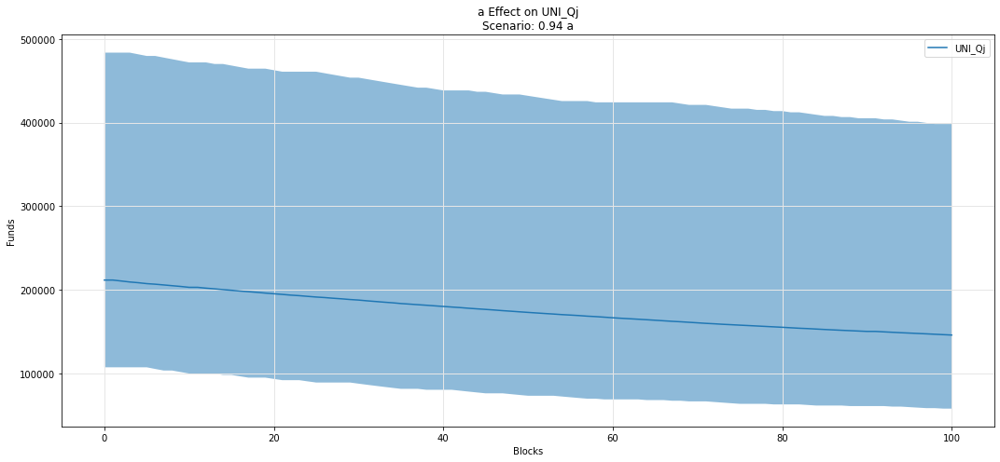

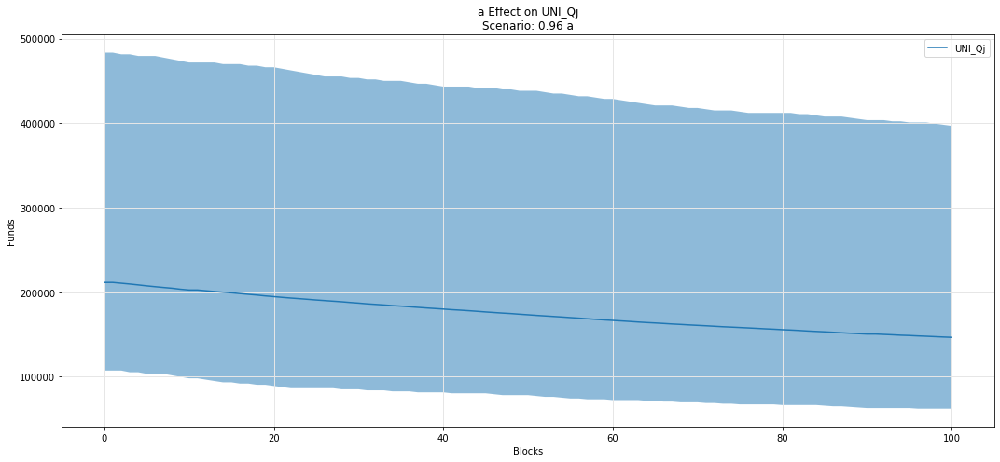

...

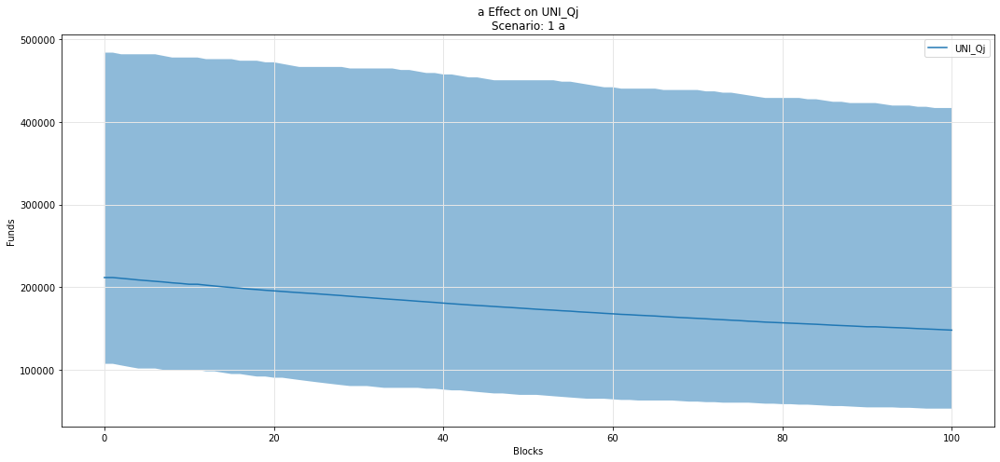

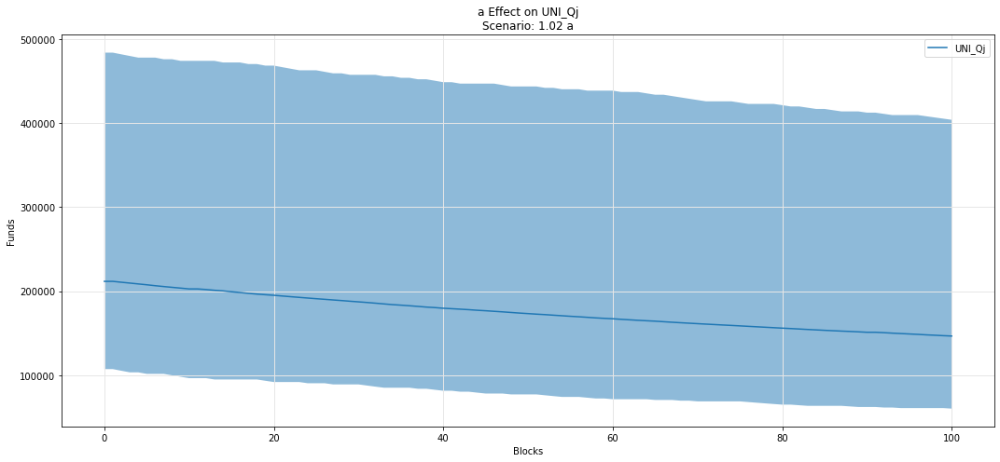

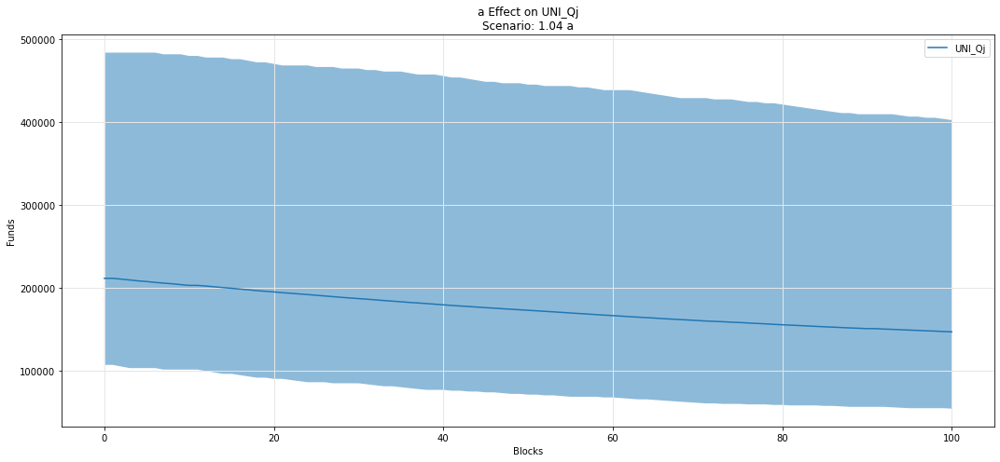

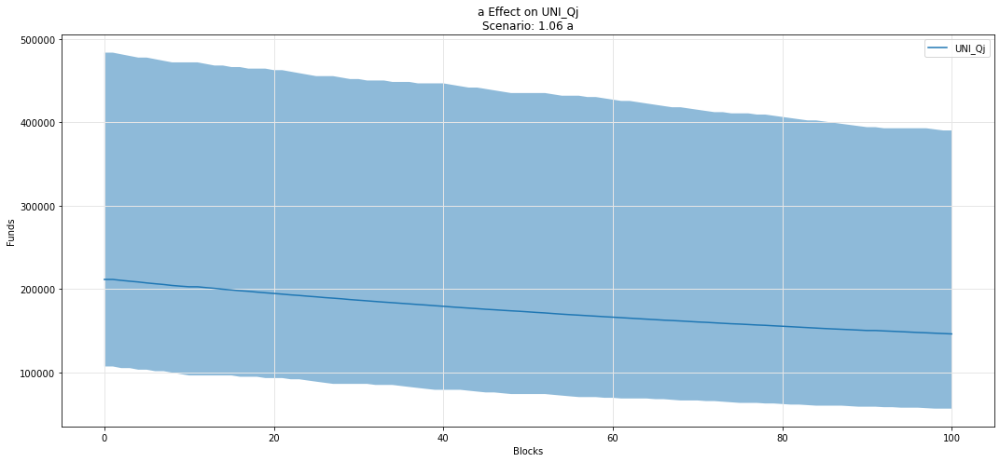

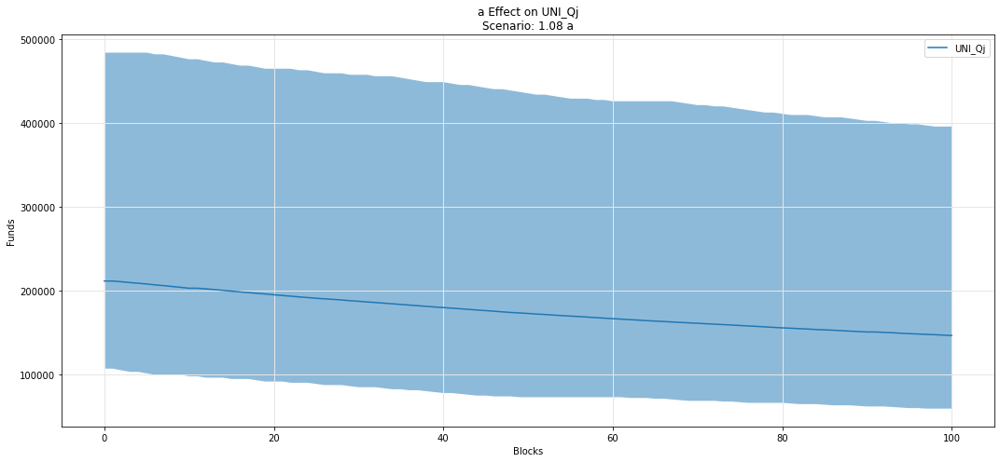

In [43]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Qj')

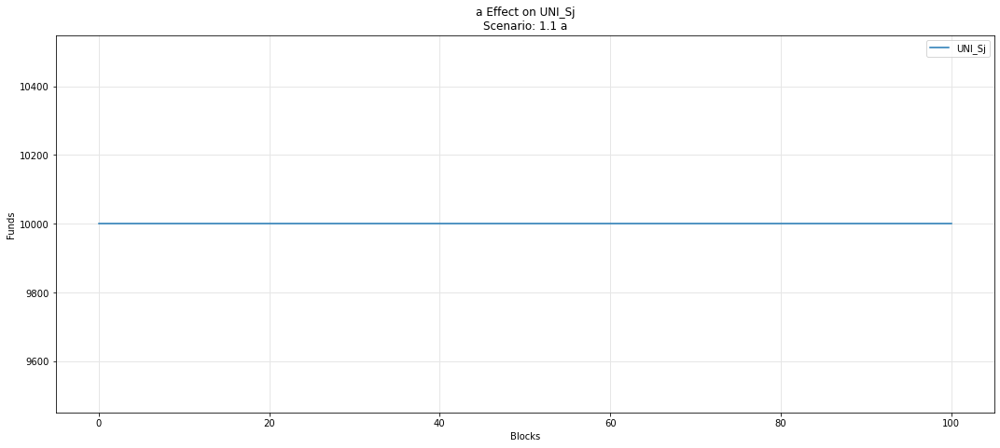

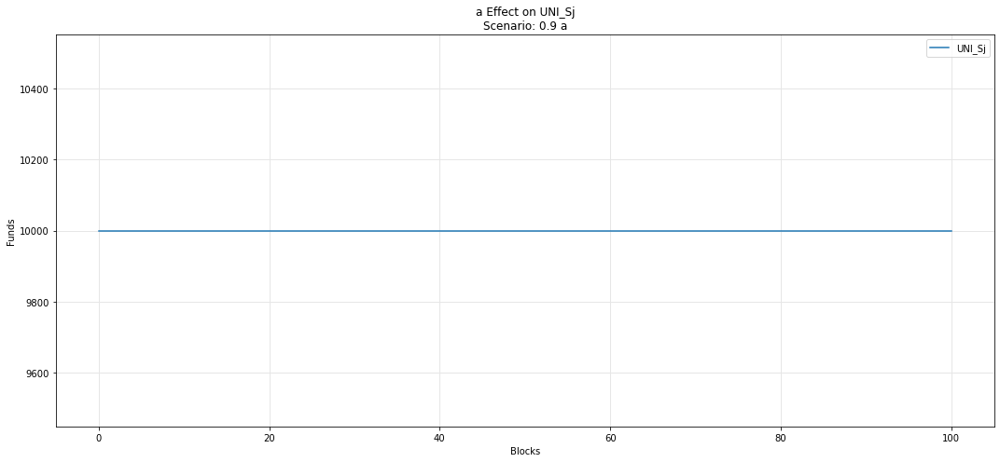

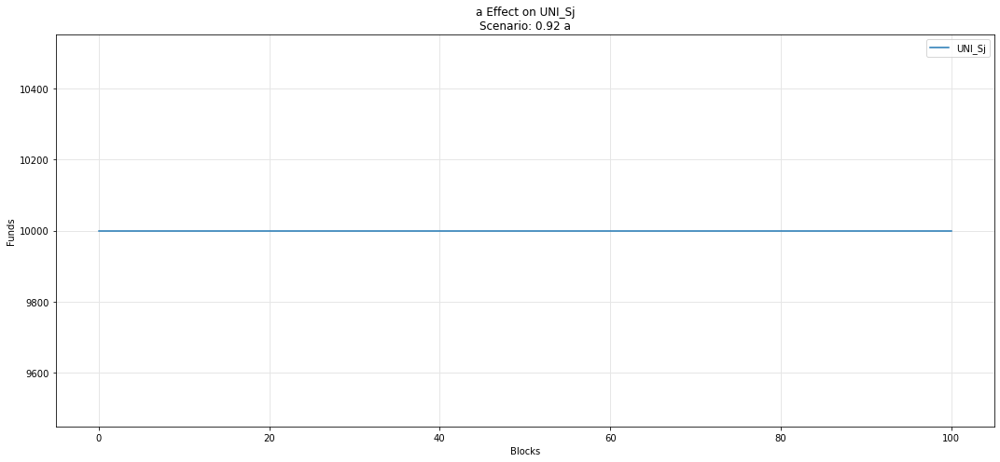

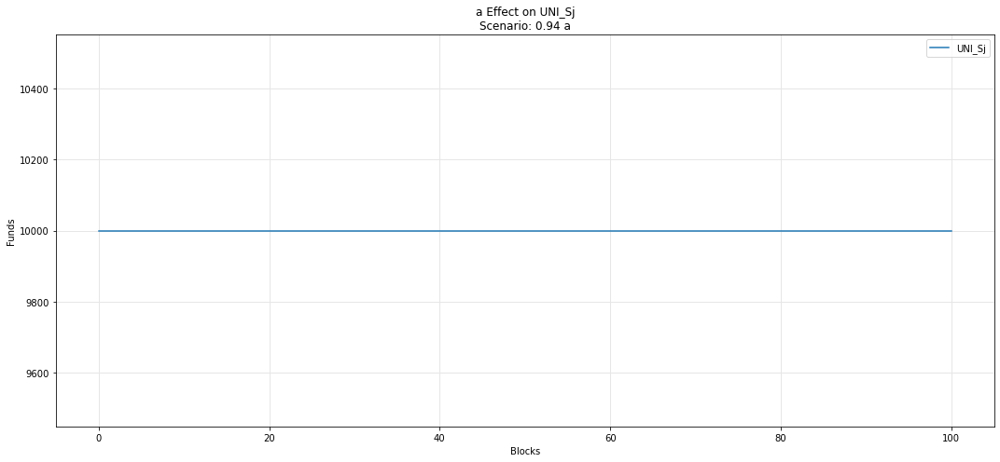

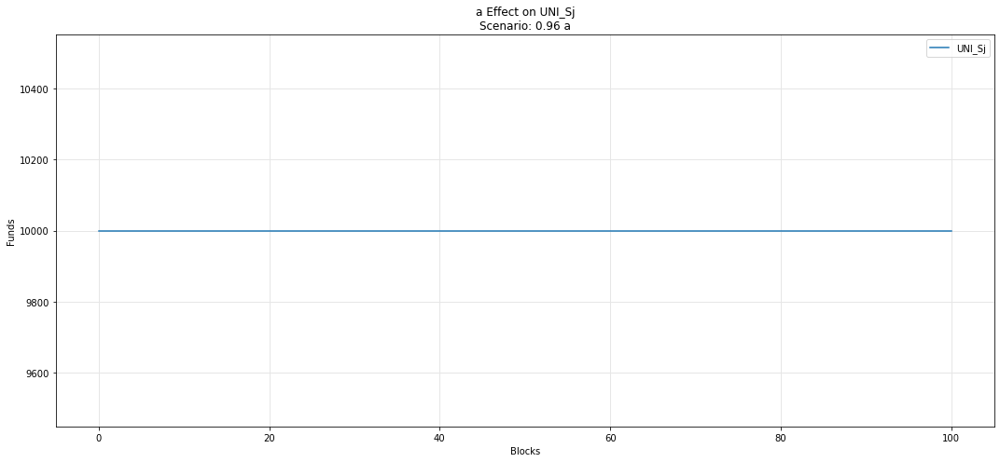

...

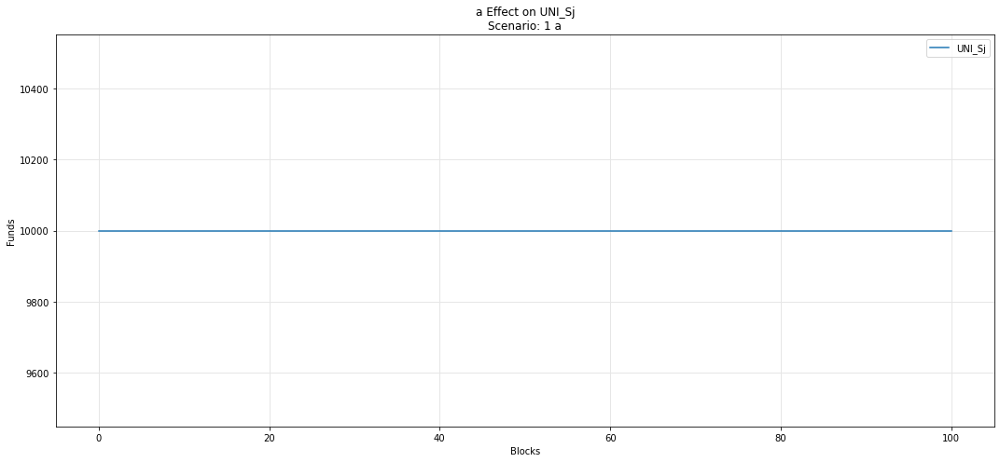

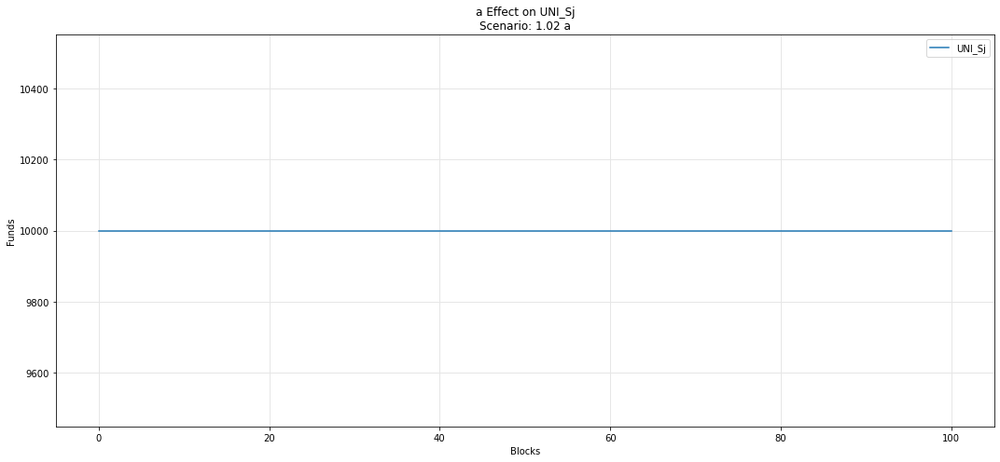

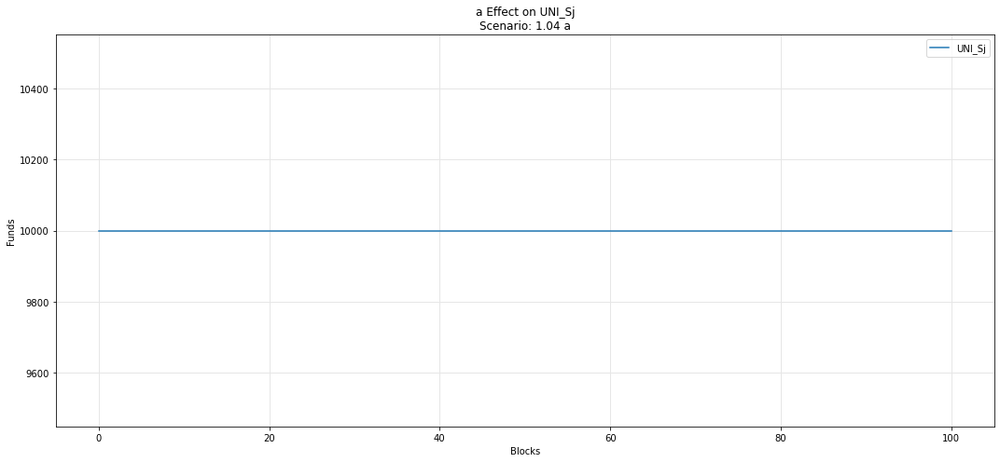

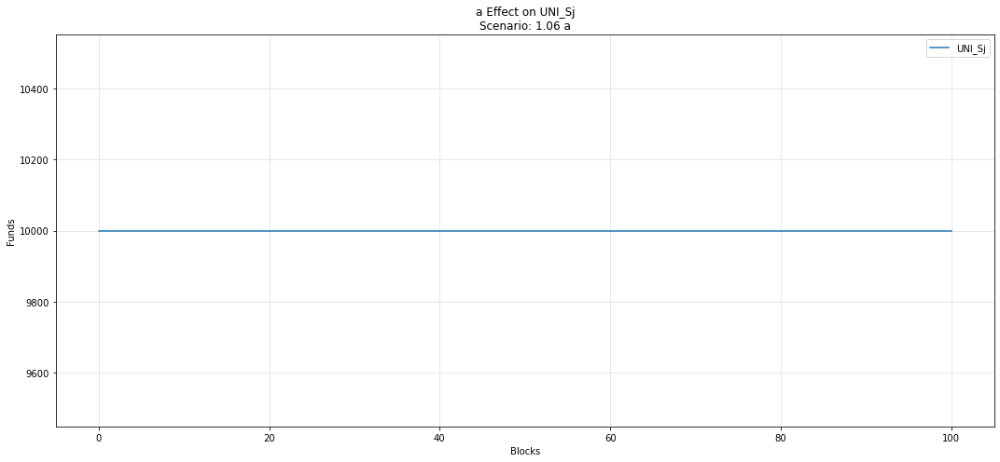

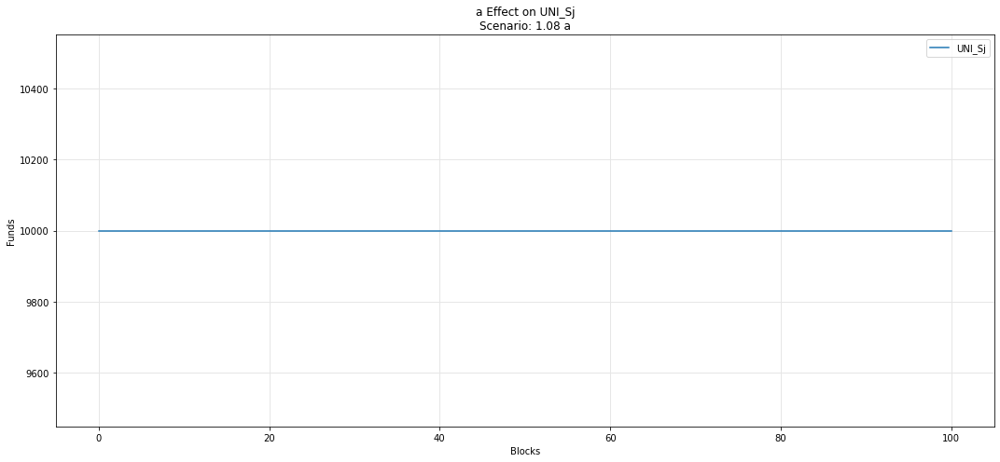

In [44]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Sj')

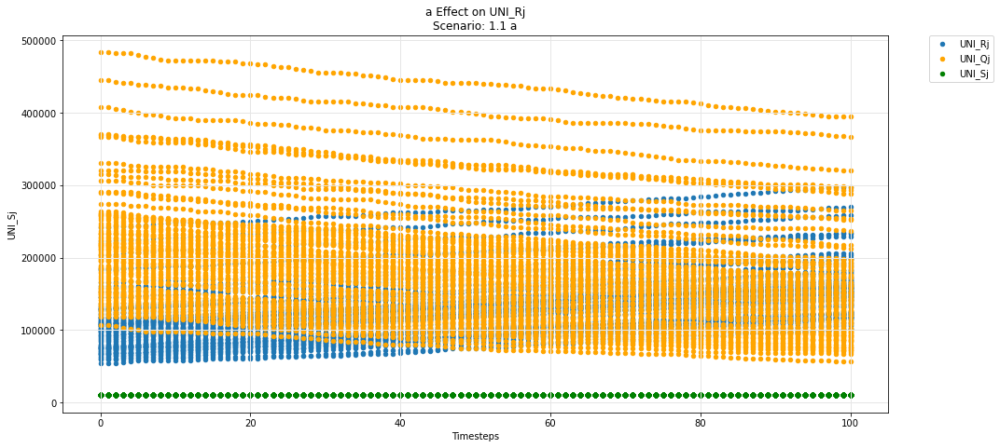

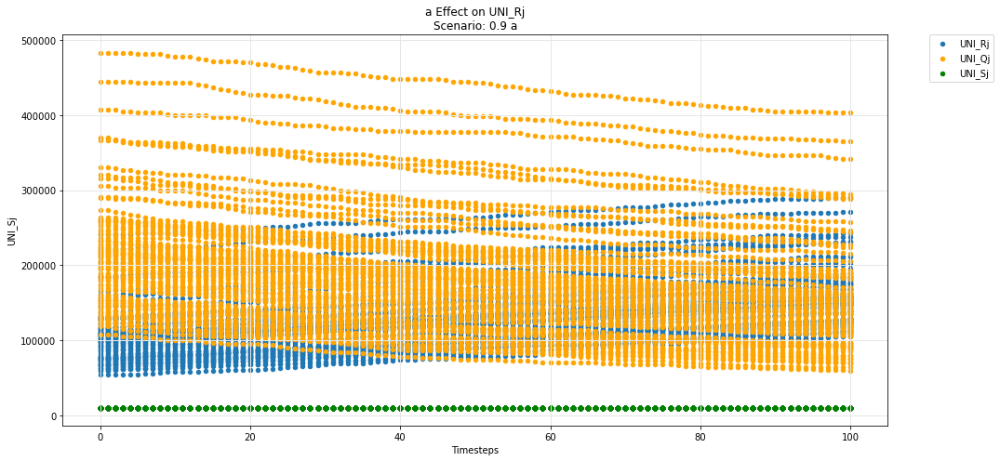

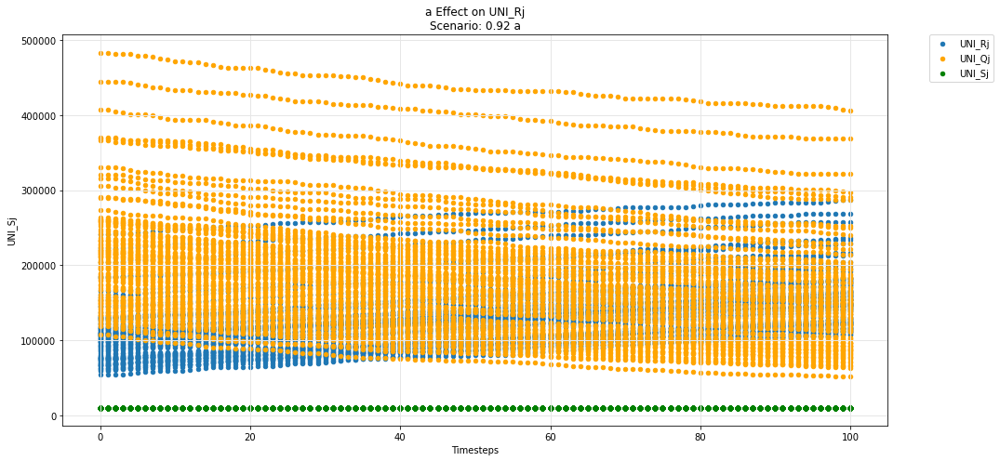

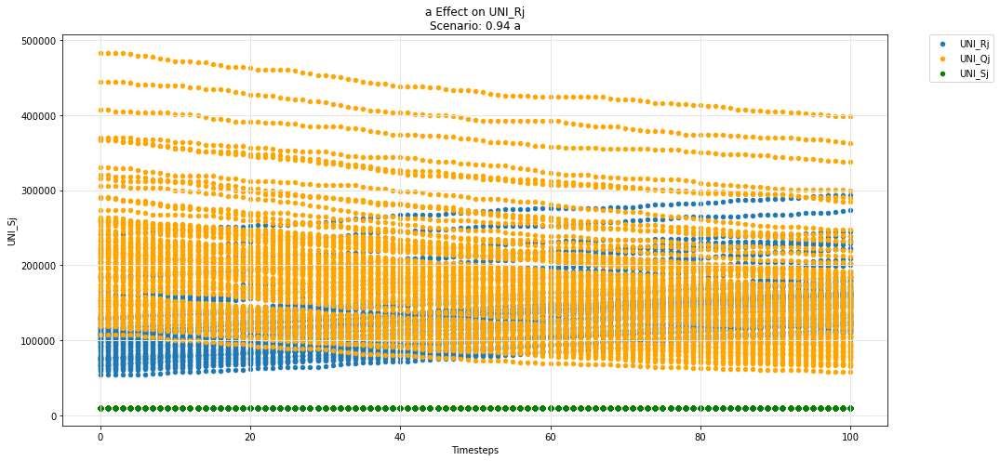

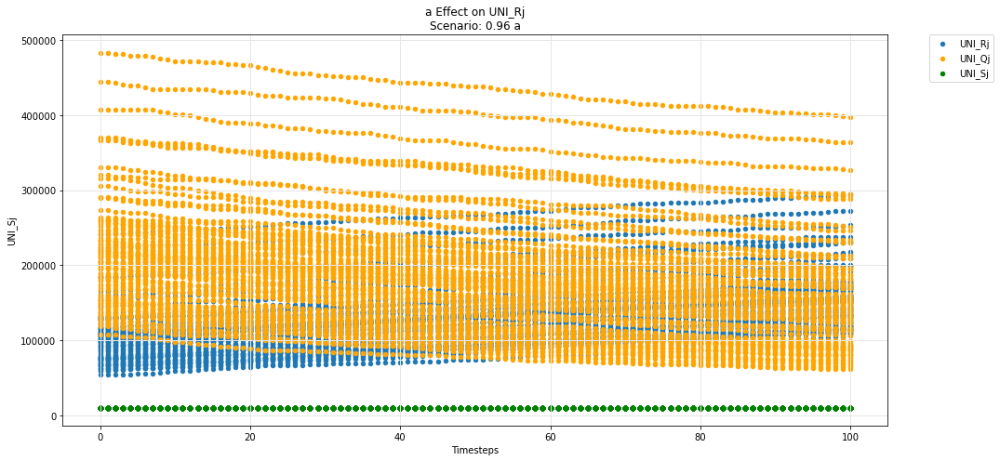

...

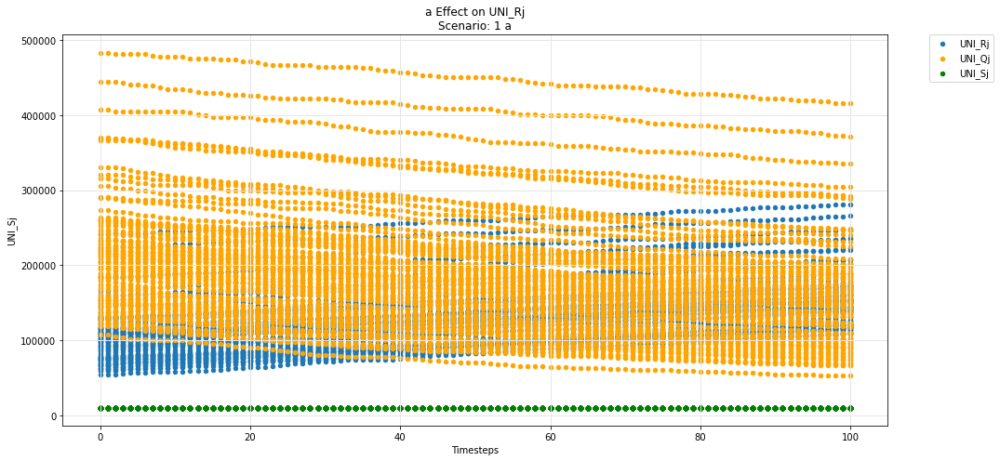

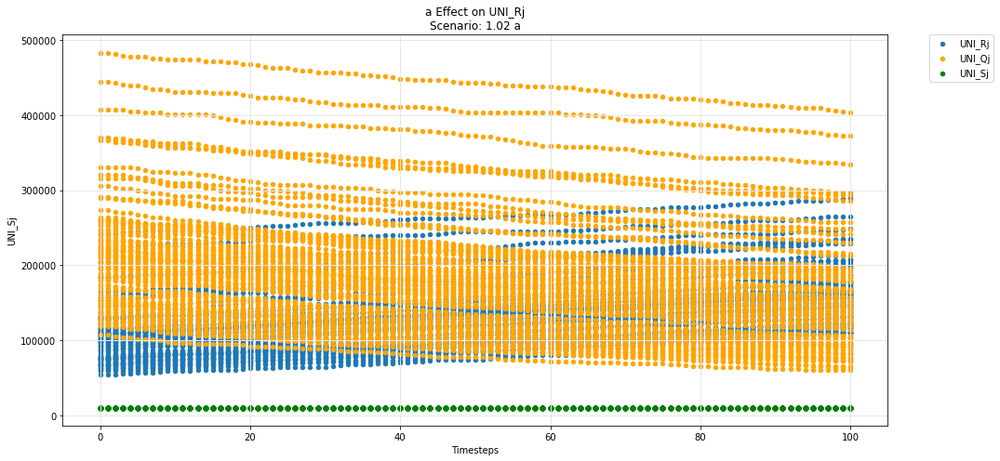

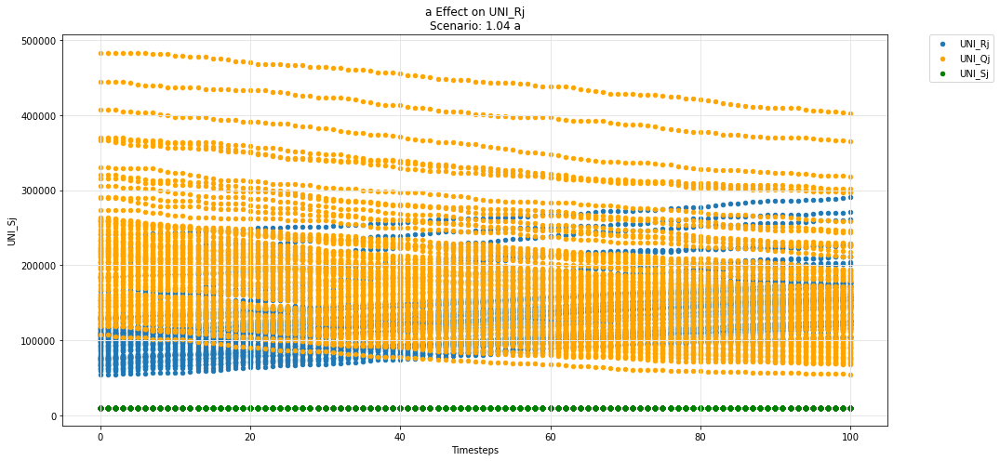

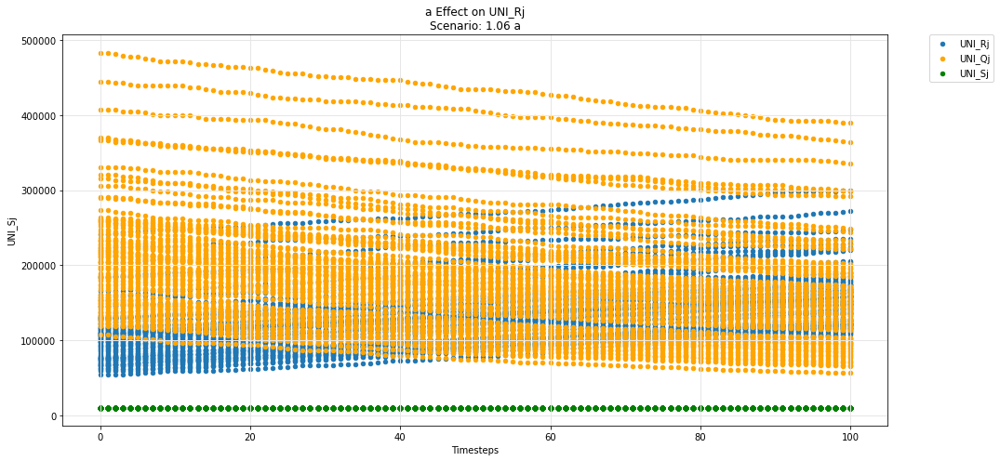

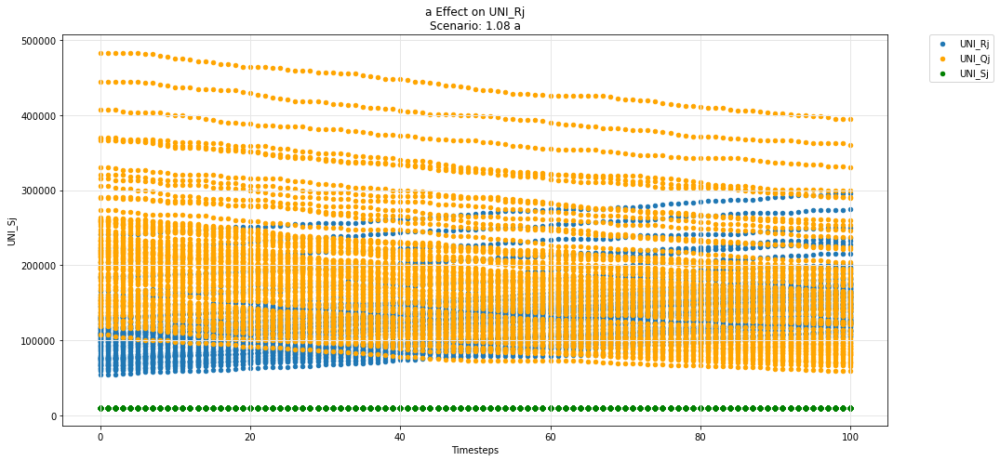

In [45]:
param_test_plot(experiments, config_ids, 'a', 'UNI_Rj', 'UNI_Qj', 'UNI_Sj')

## Uniswap -- ij-Q instance

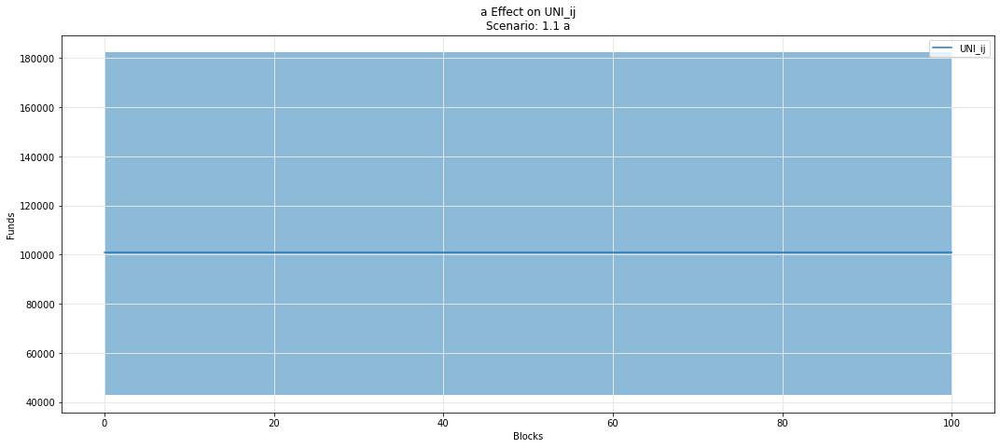

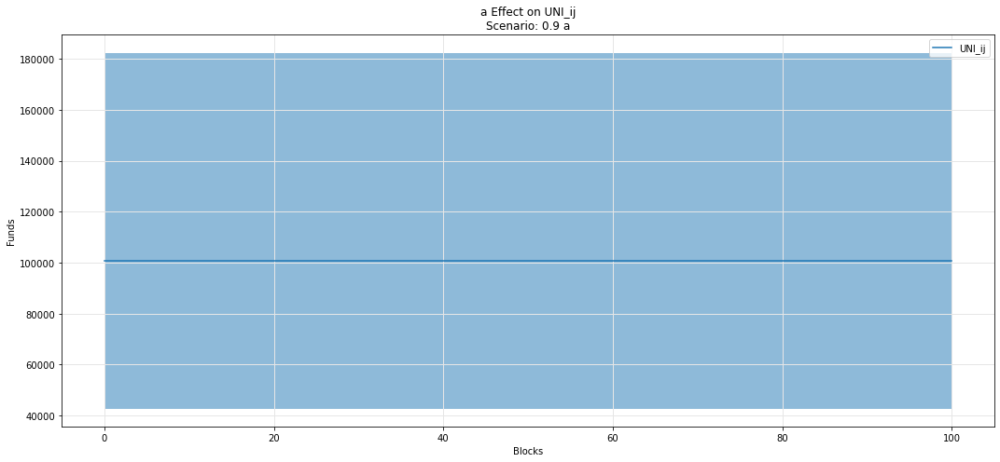

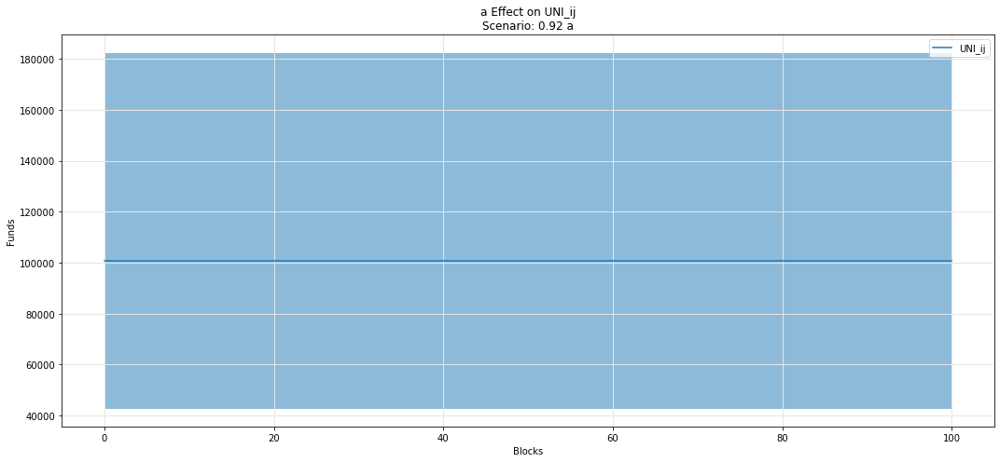

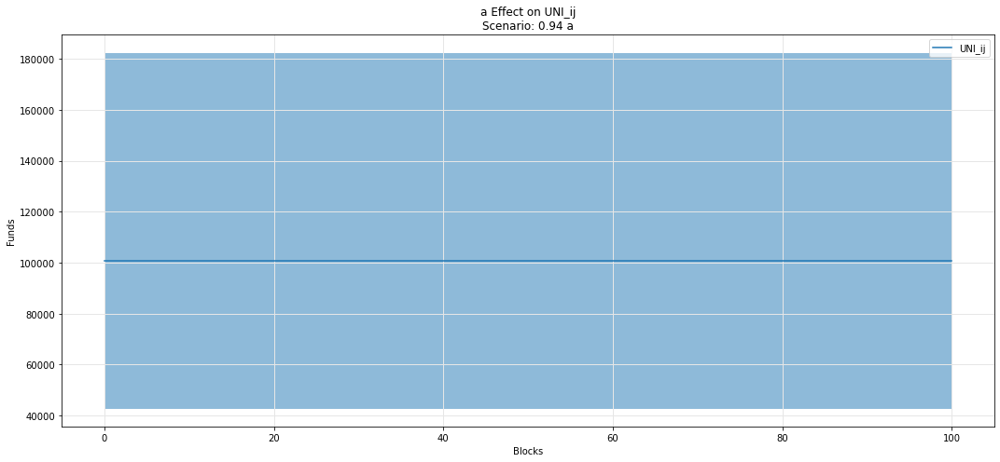

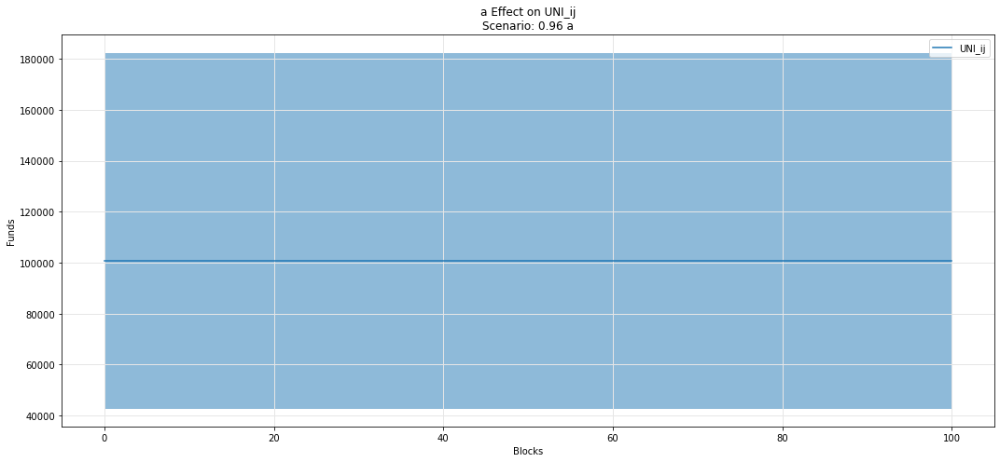

...

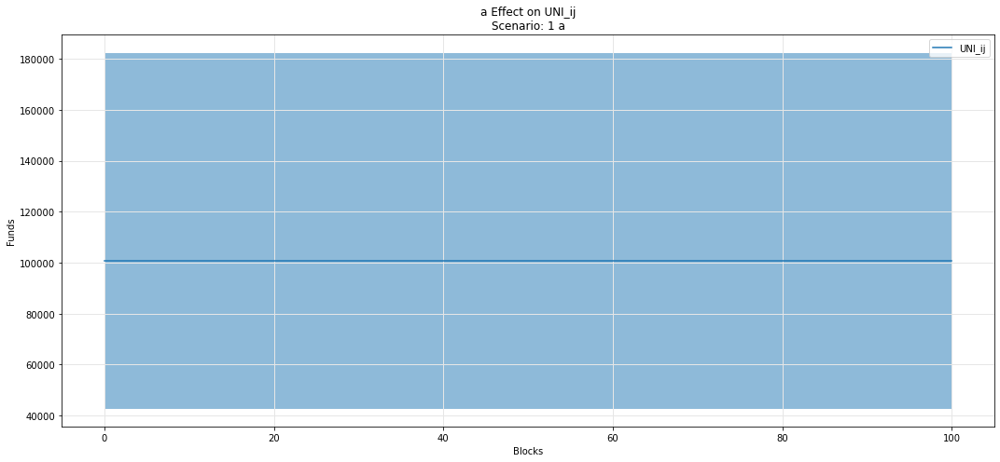

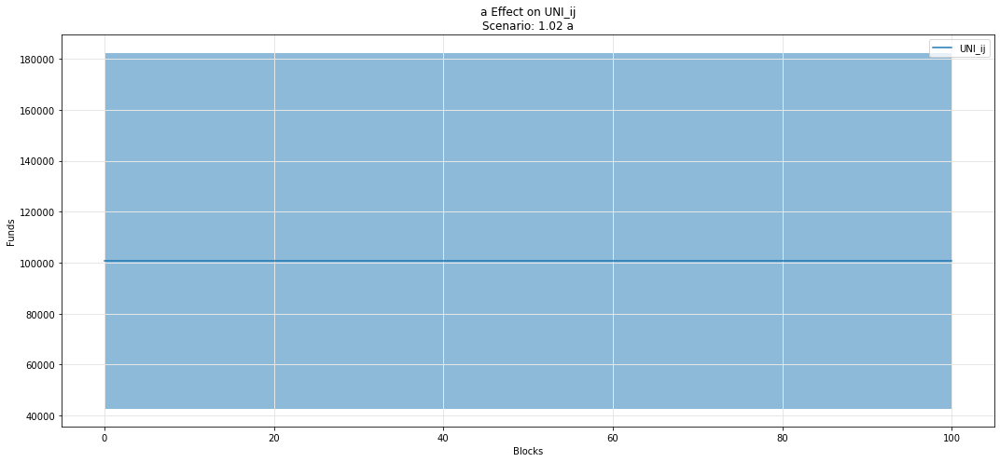

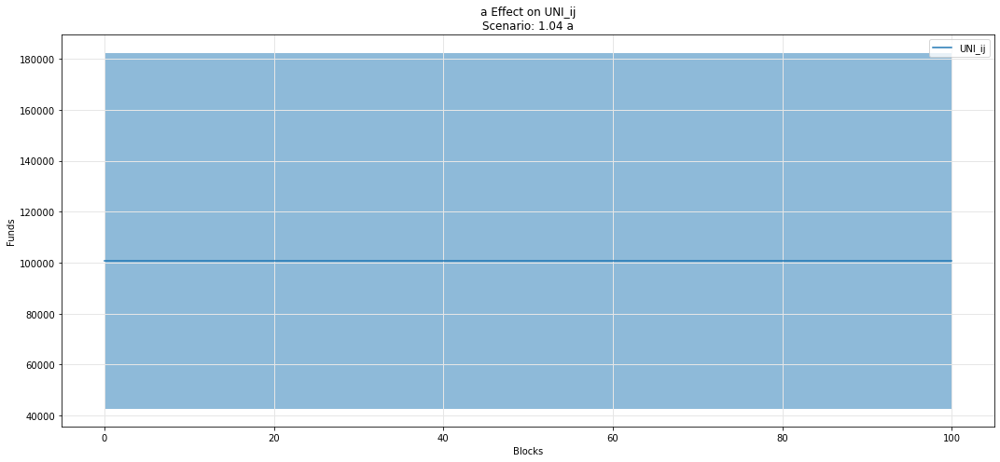

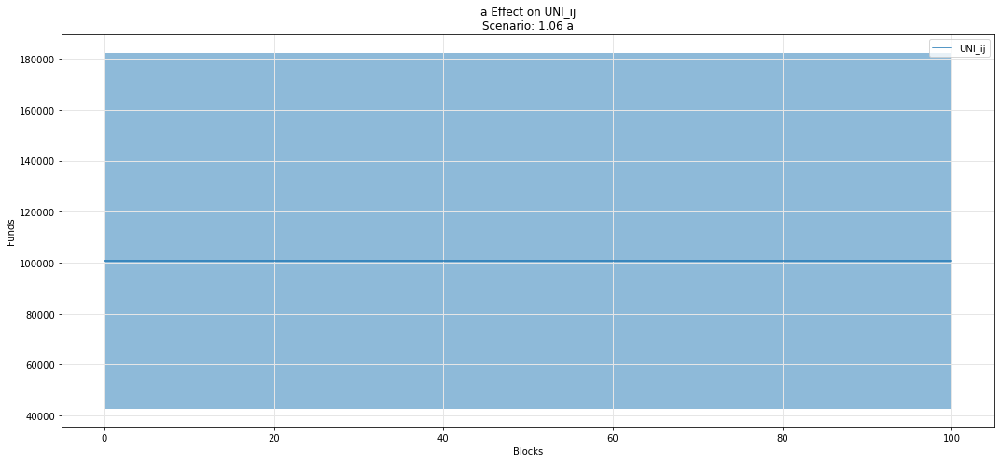

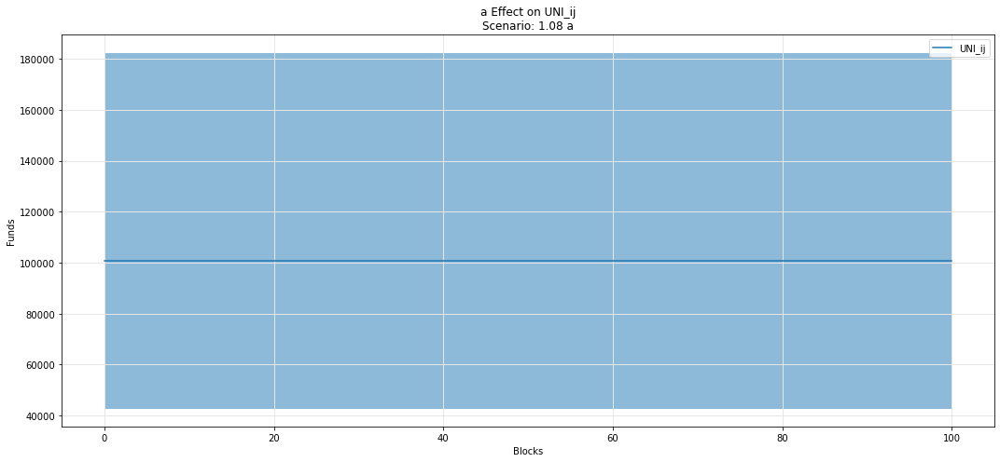

In [46]:
param_fan_plot3(experiments, config_ids, 'a','UNI_ij')

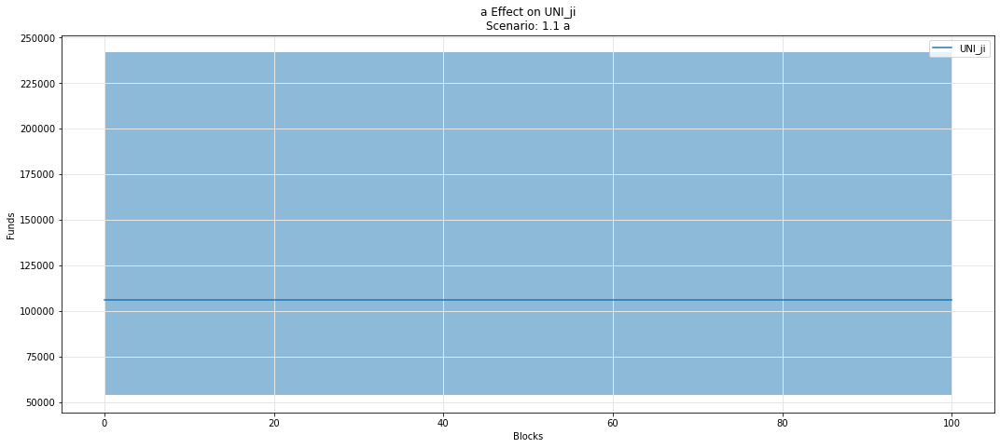

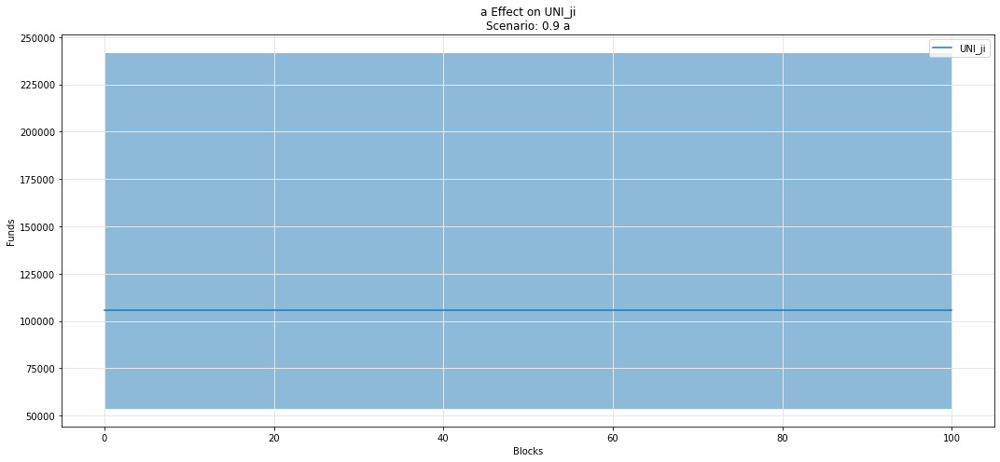

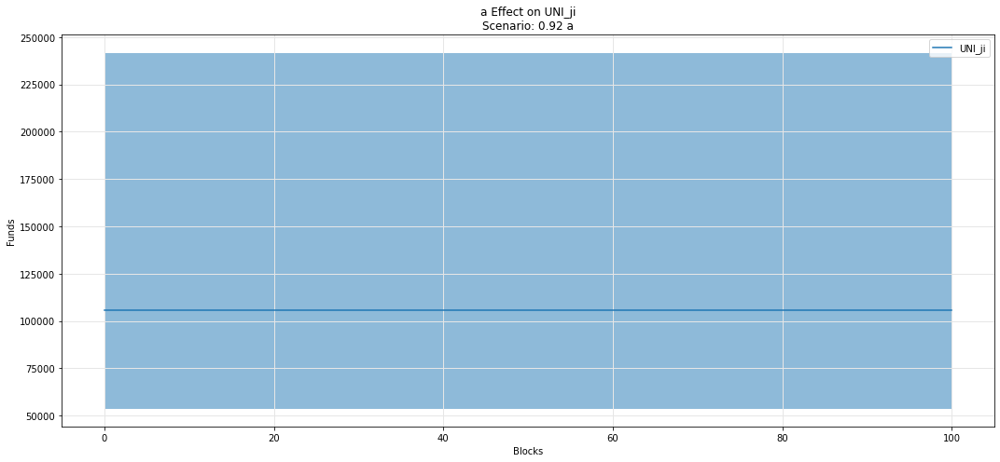

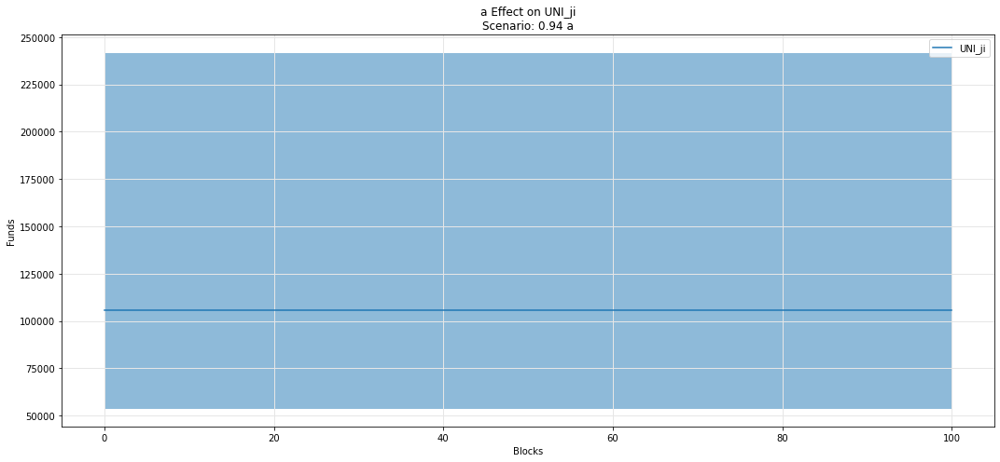

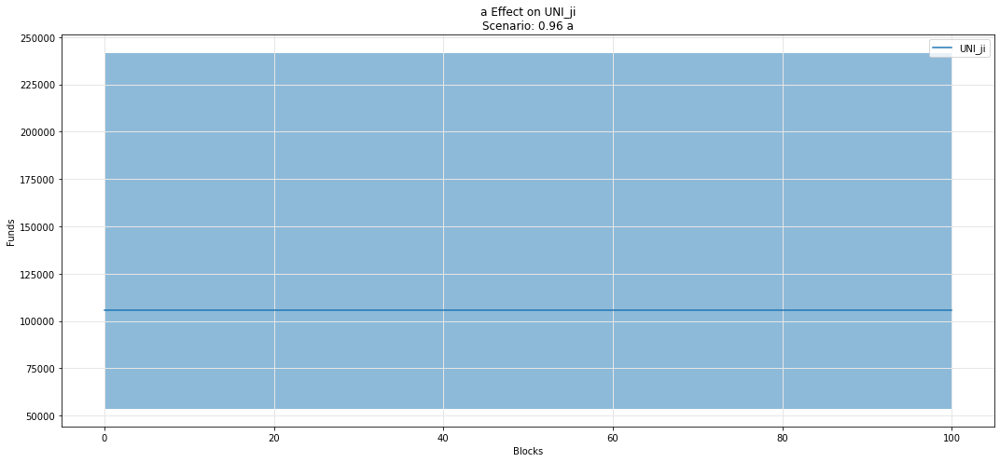

...

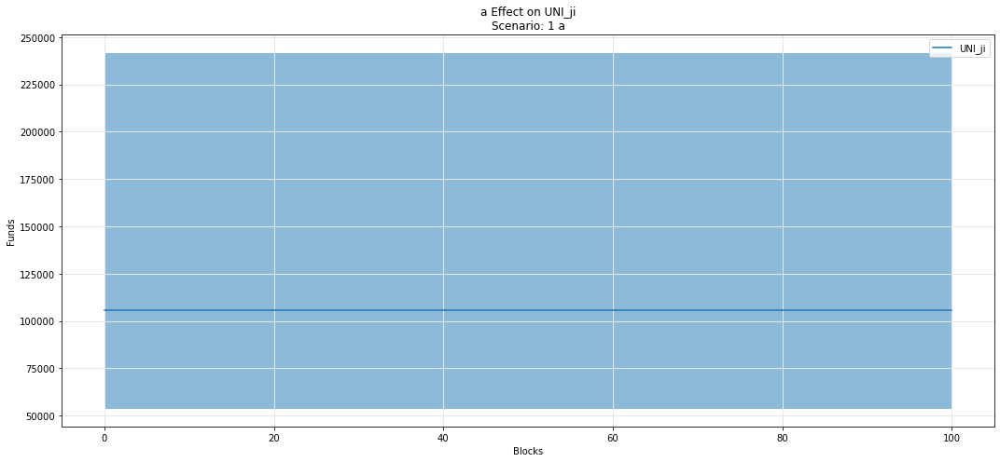

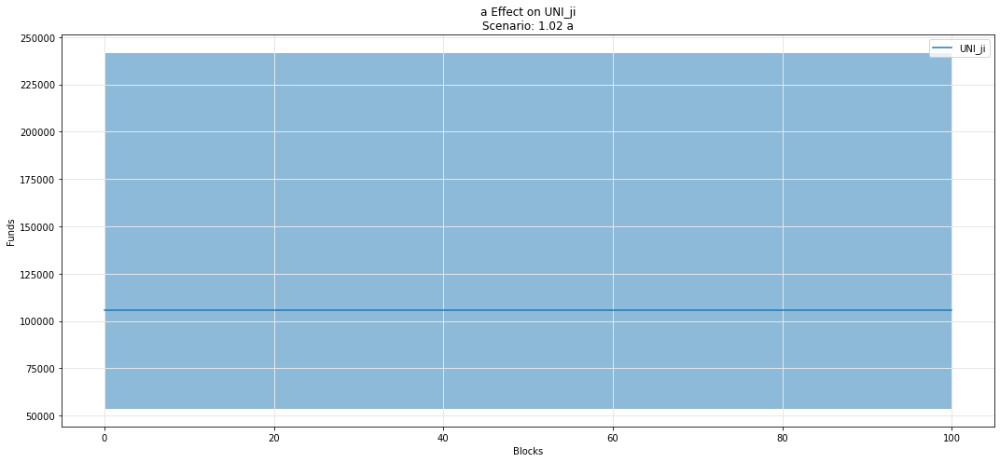

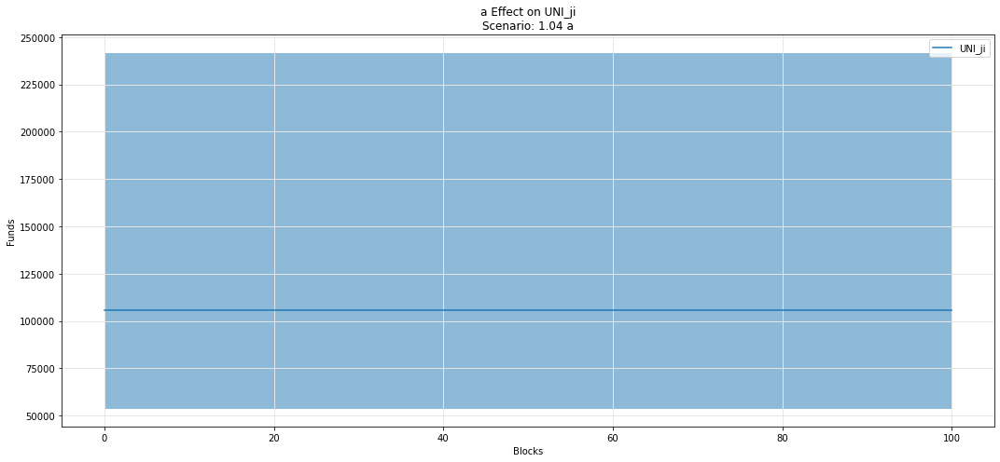

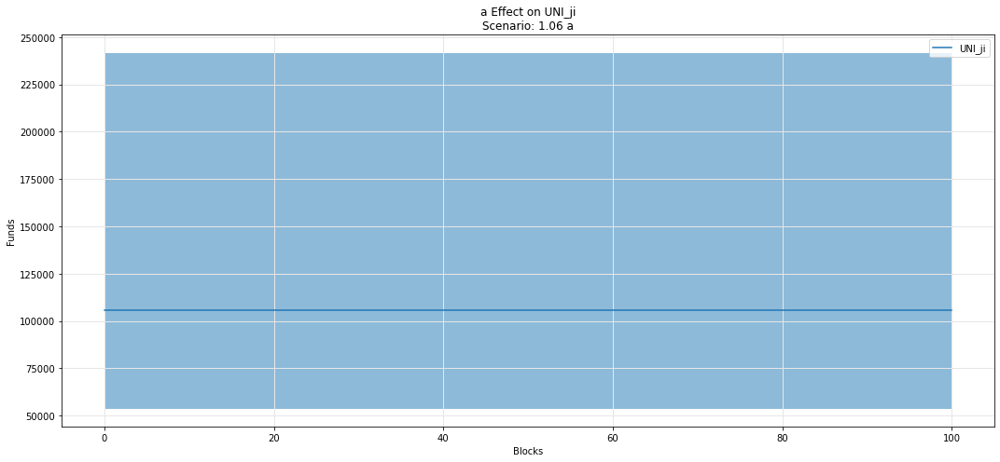

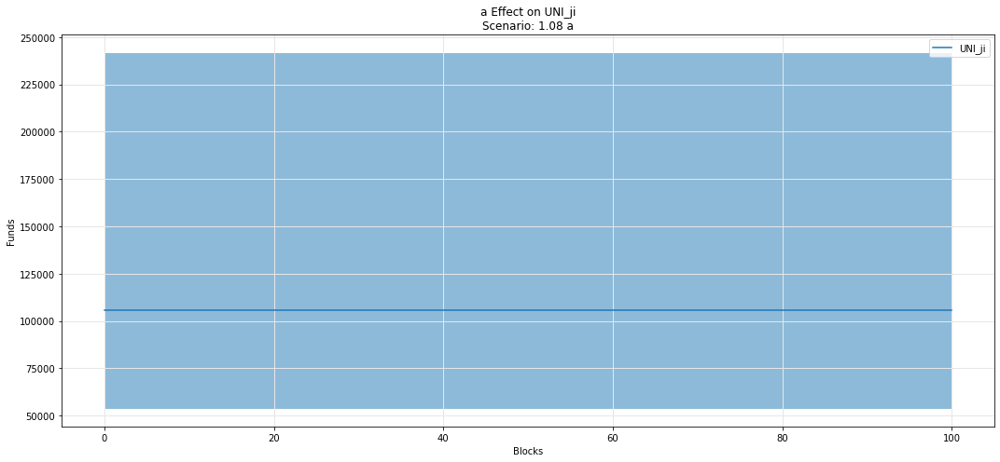

In [47]:
param_fan_plot3(experiments, config_ids, 'a','UNI_ji')

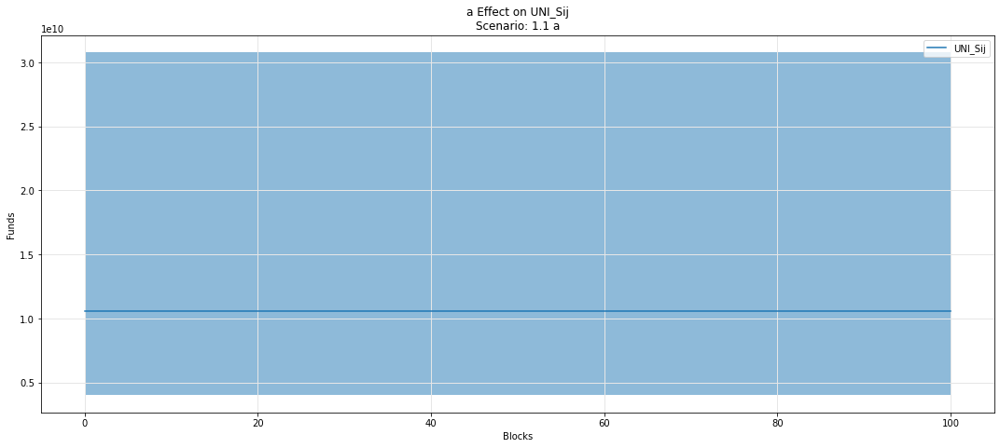

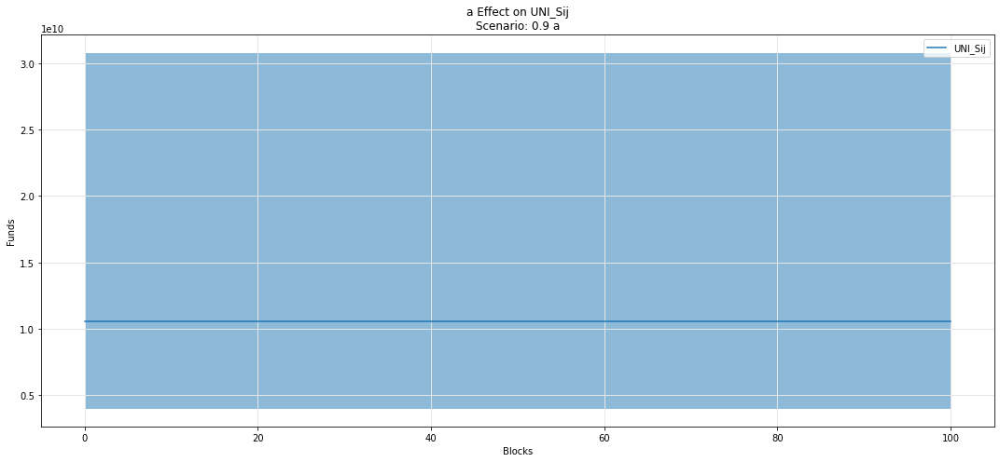

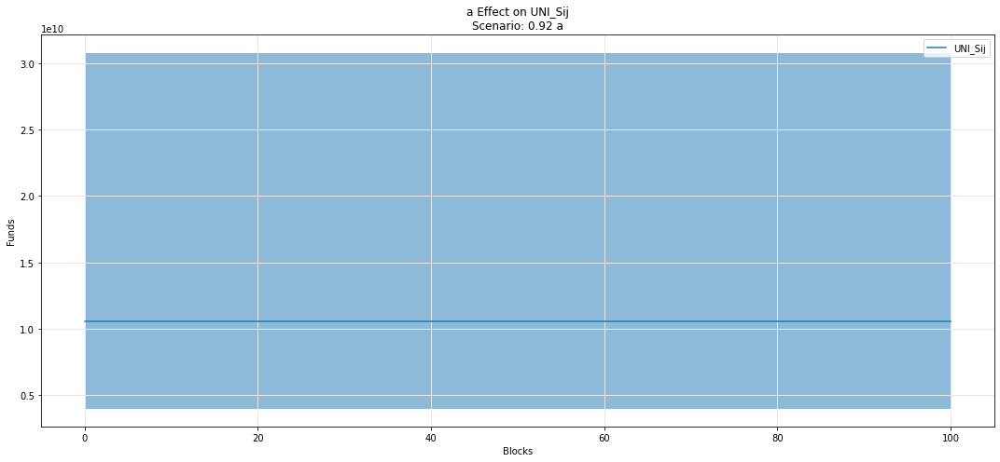

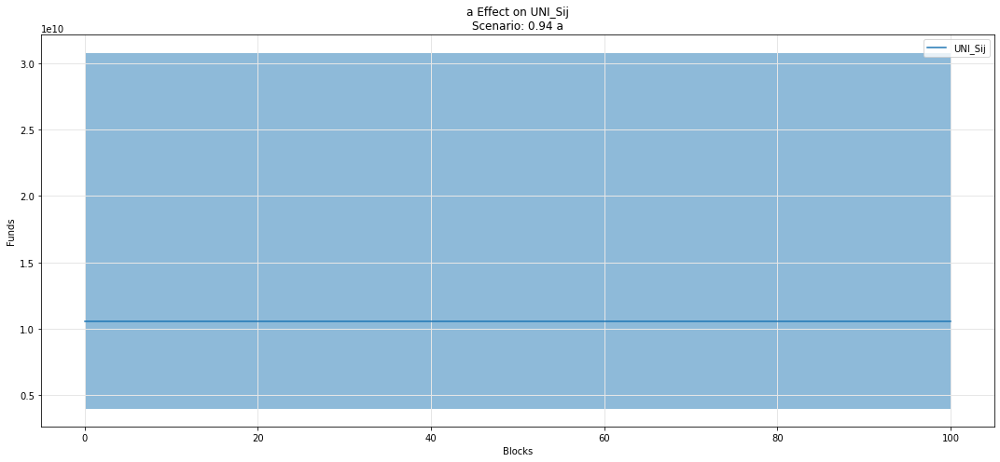

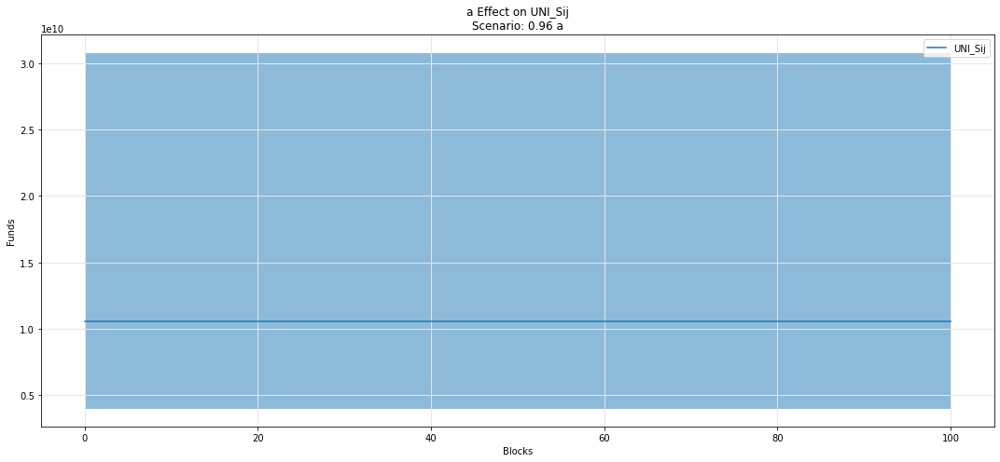

...

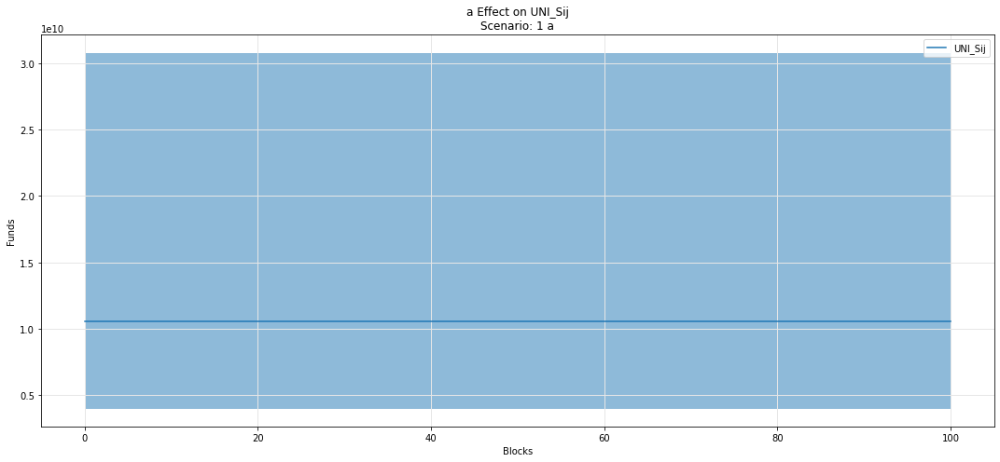

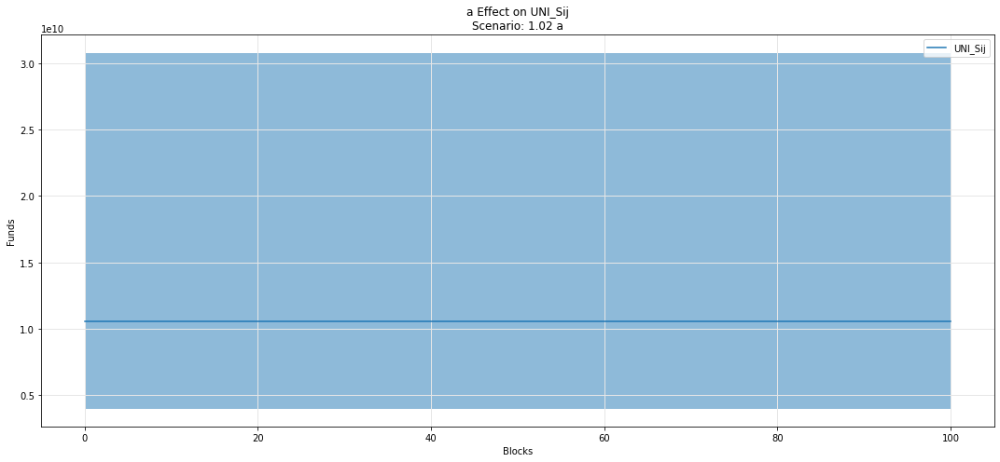

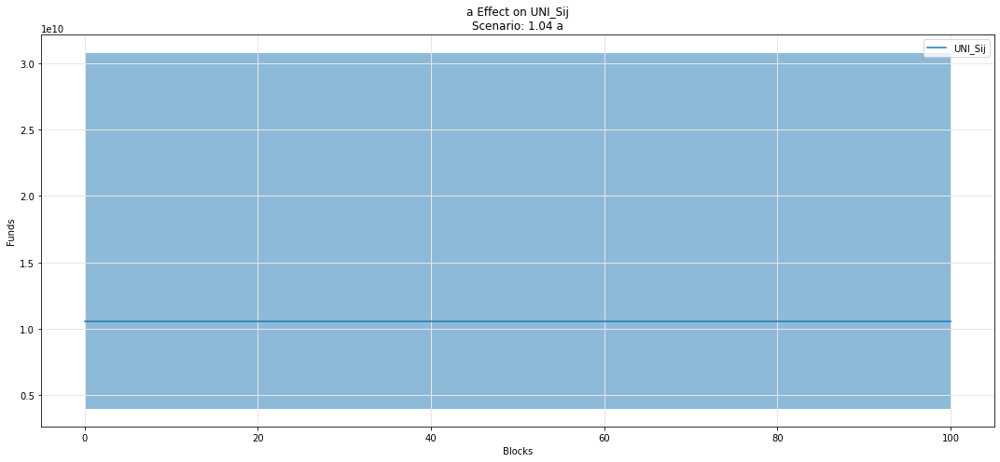

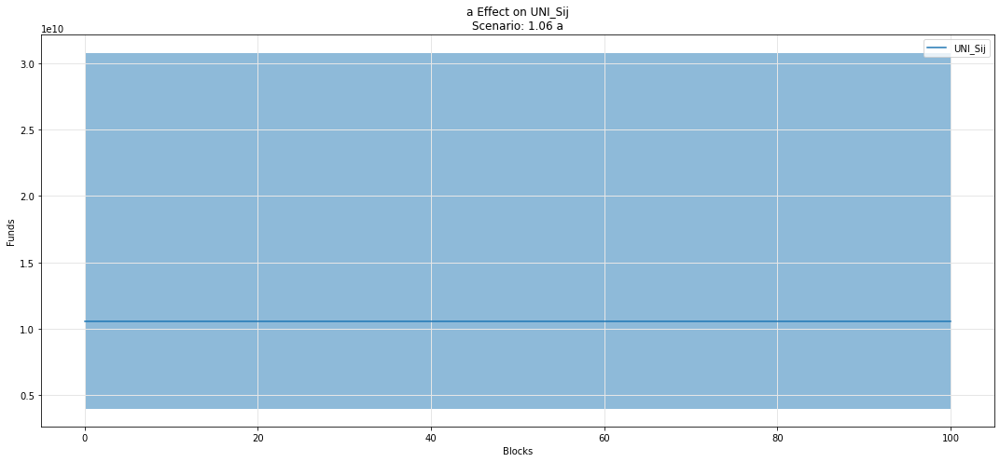

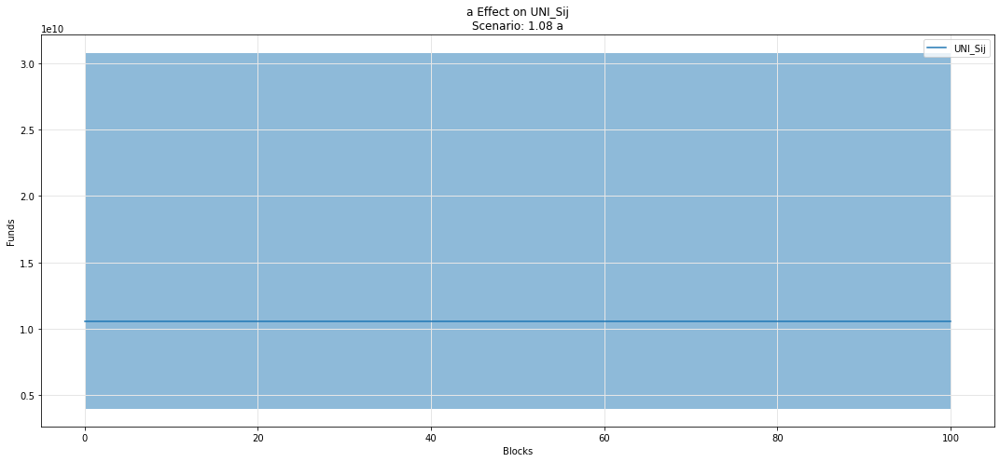

In [48]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Sij')

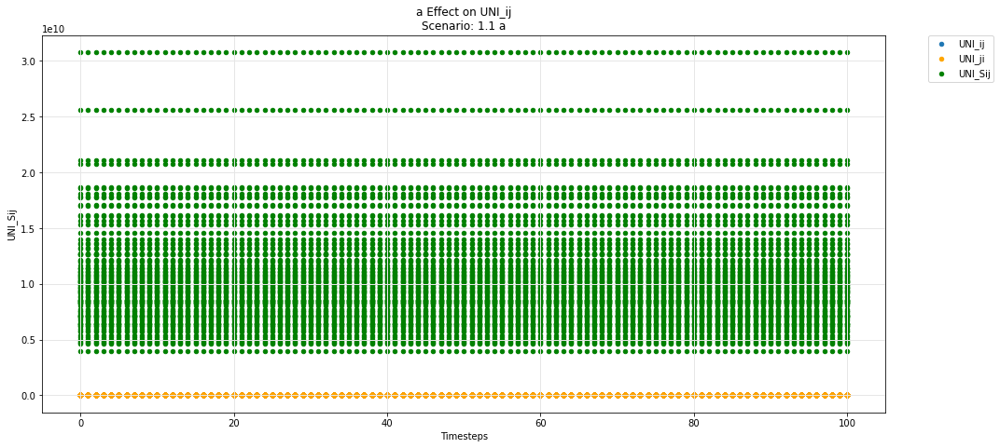

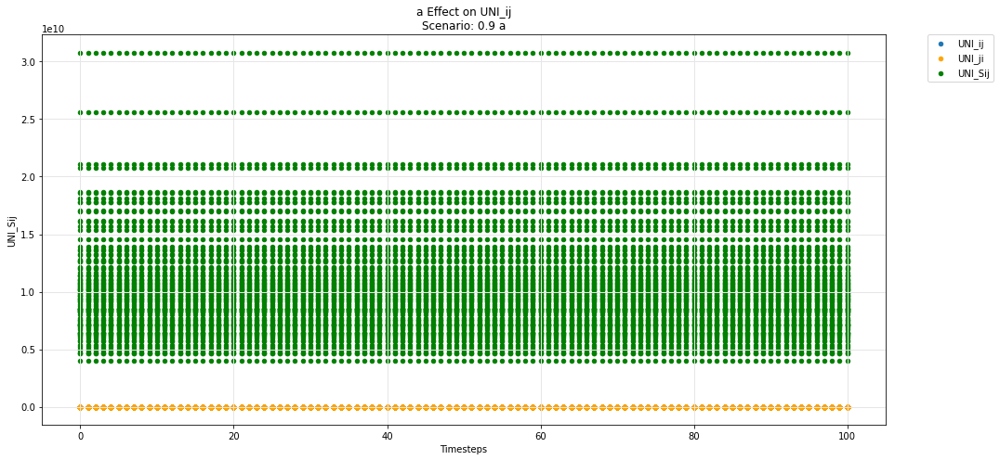

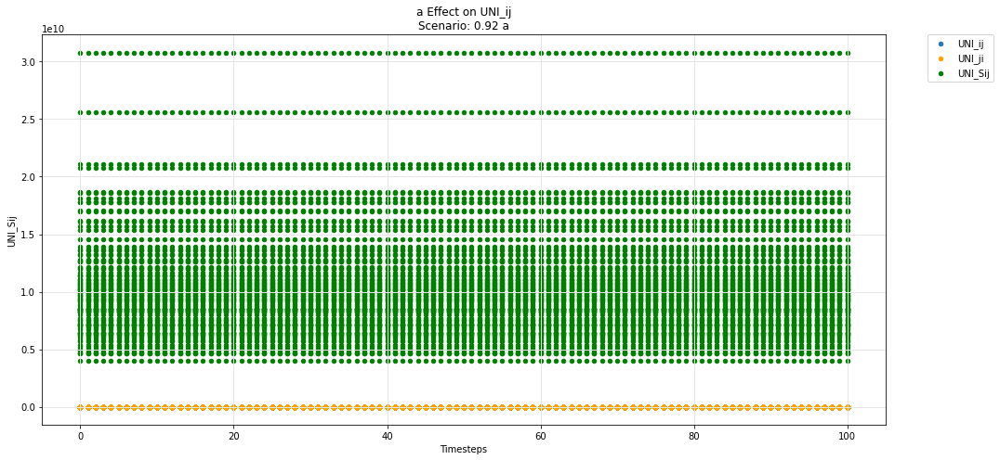

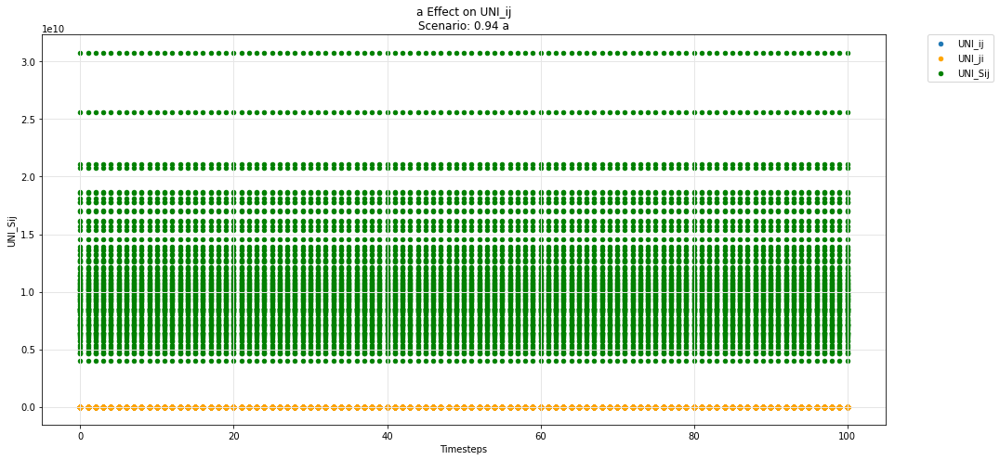

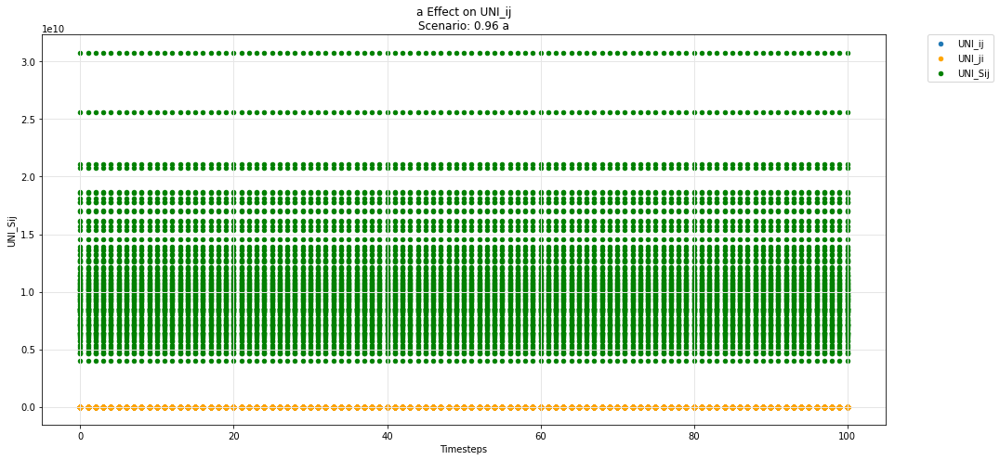

...

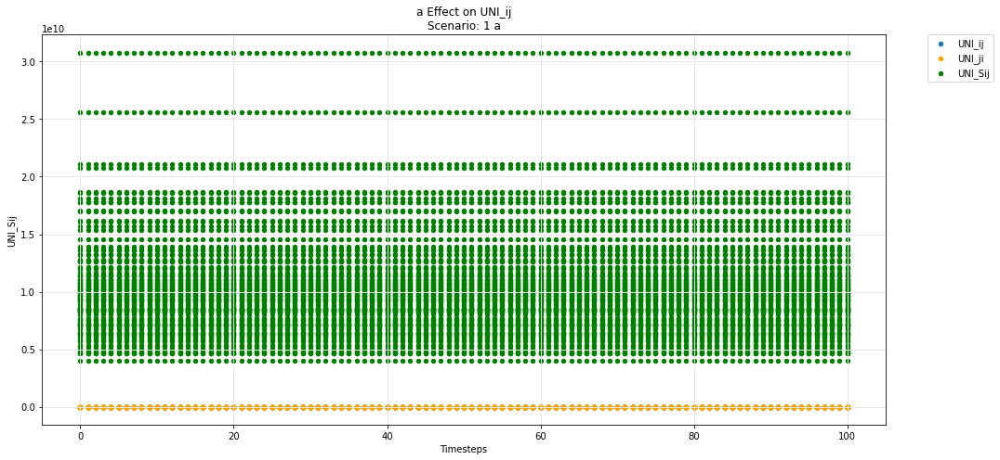

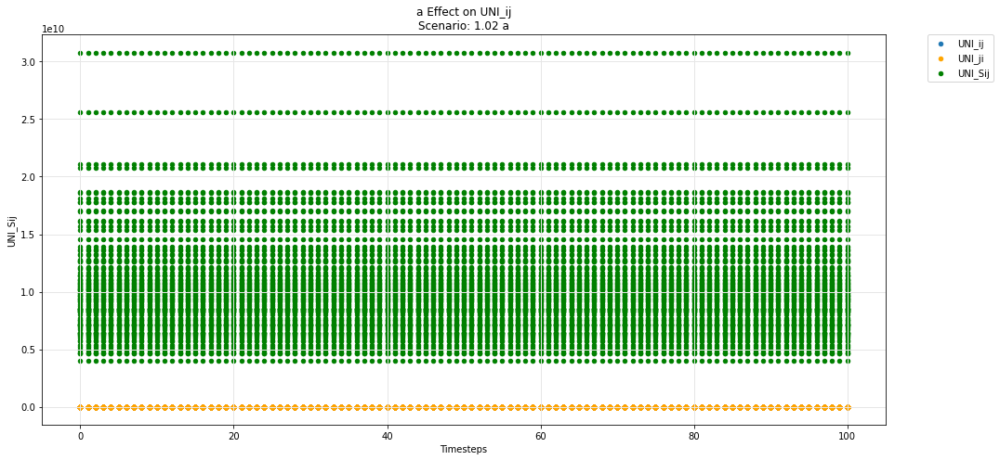

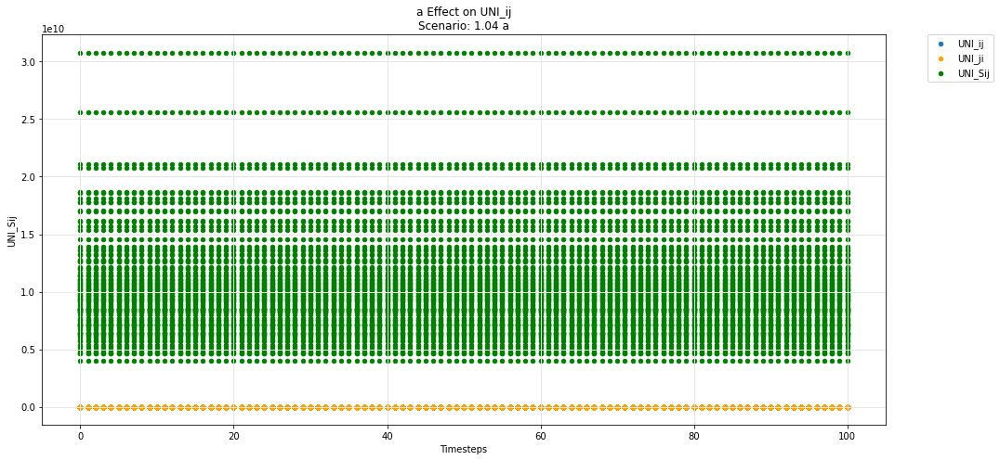

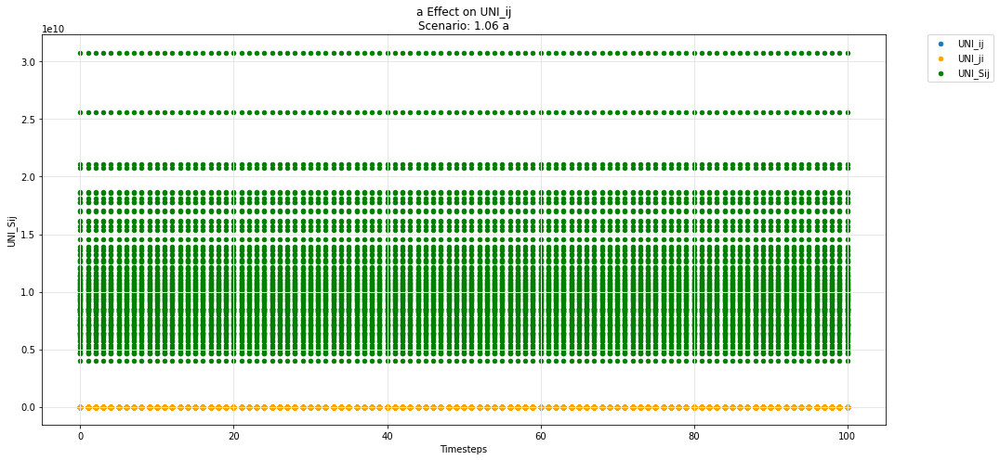

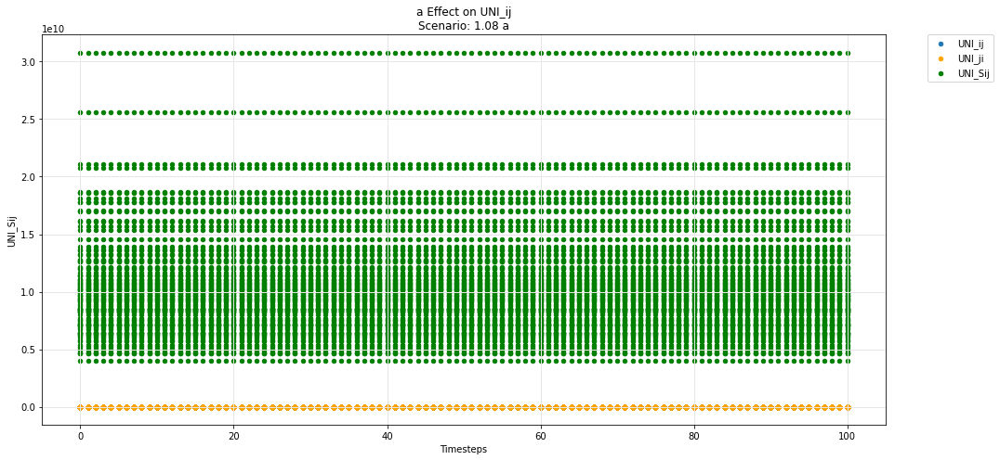

In [49]:
param_test_plot(experiments, config_ids, 'a', 'UNI_ij', 'UNI_ji', 'UNI_Sij')

## Hydra -- base

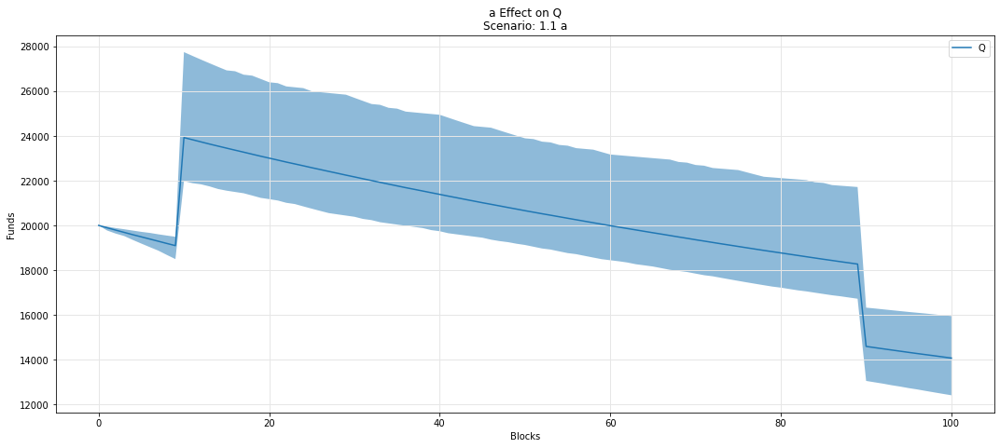

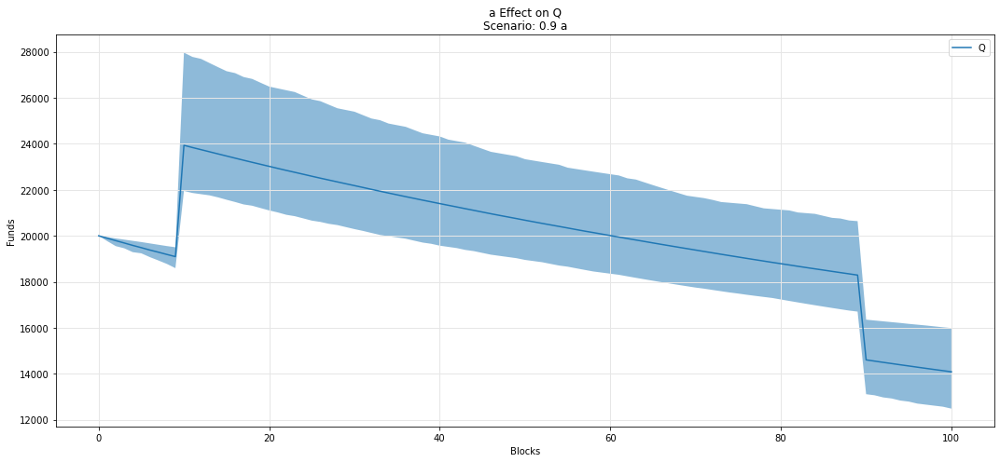

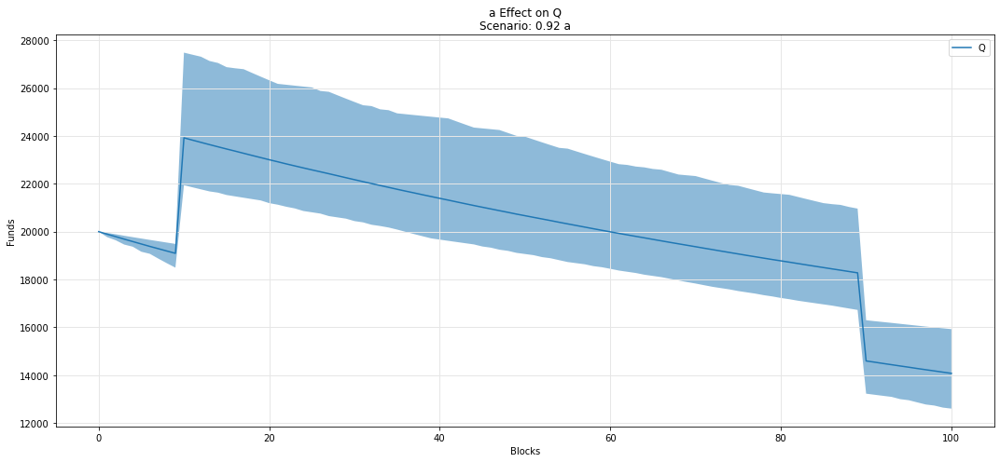

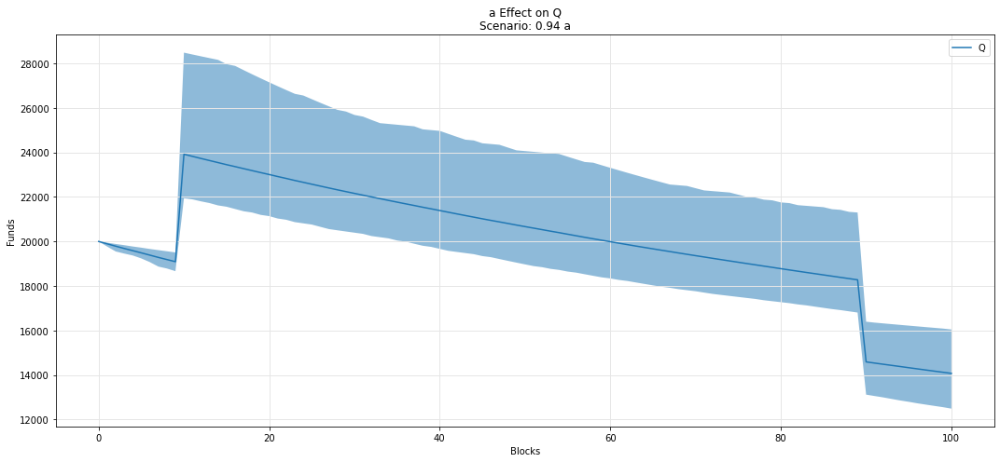

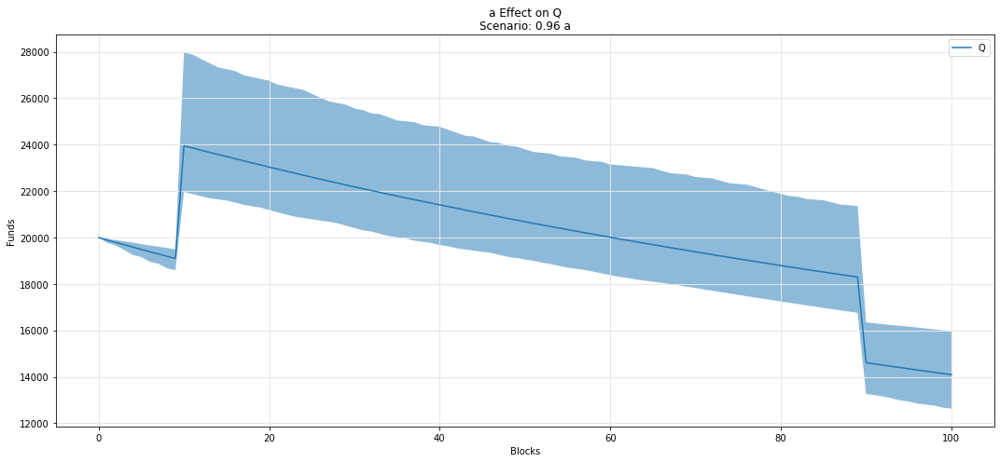

...

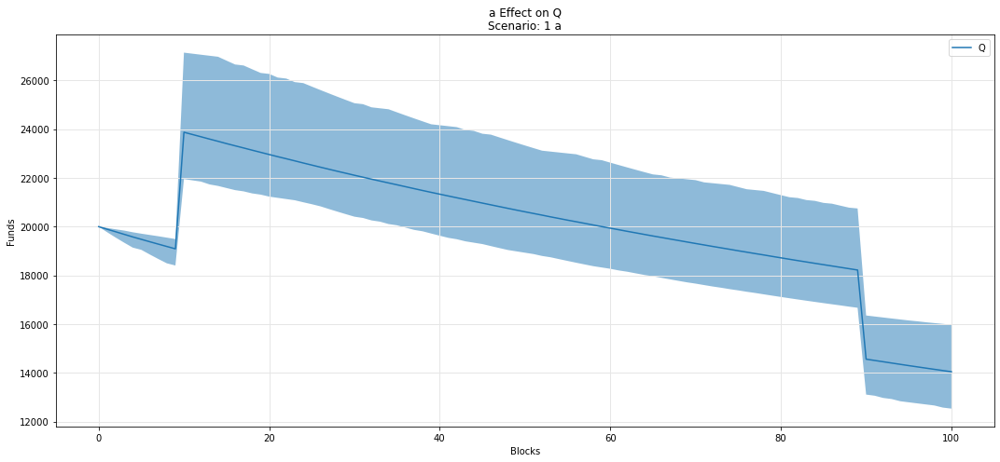

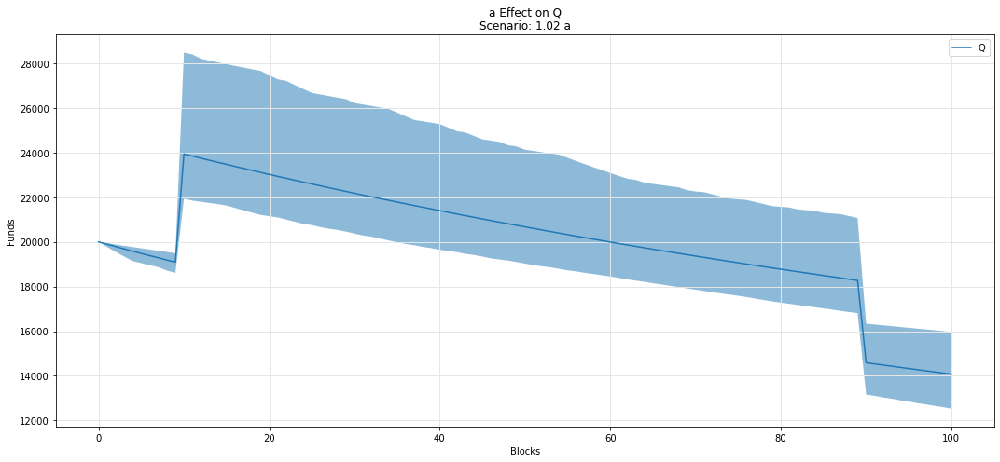

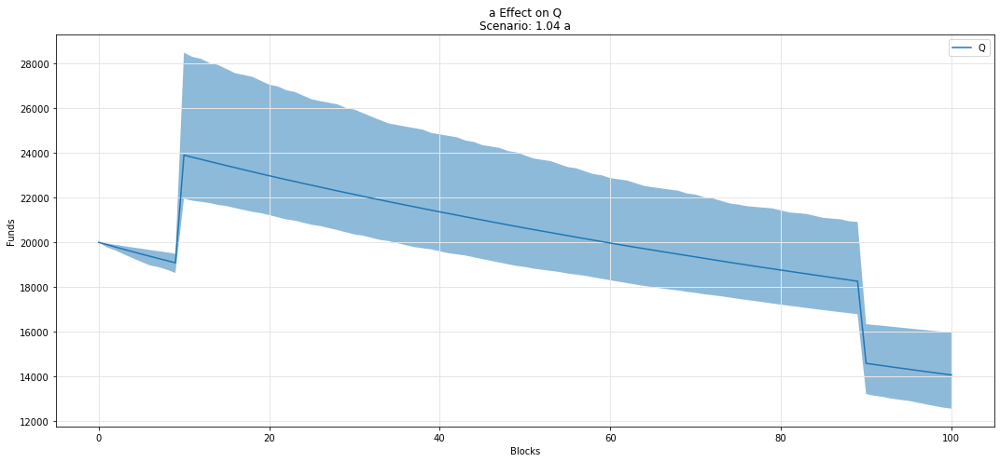

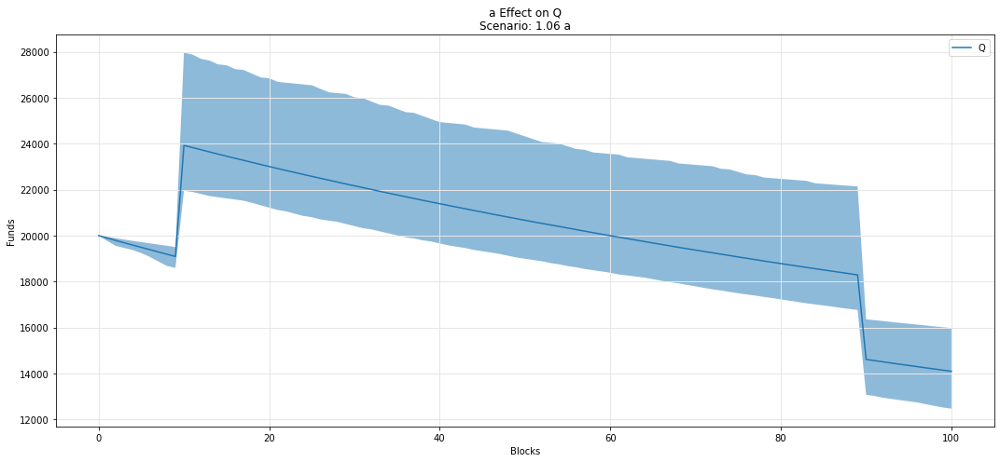

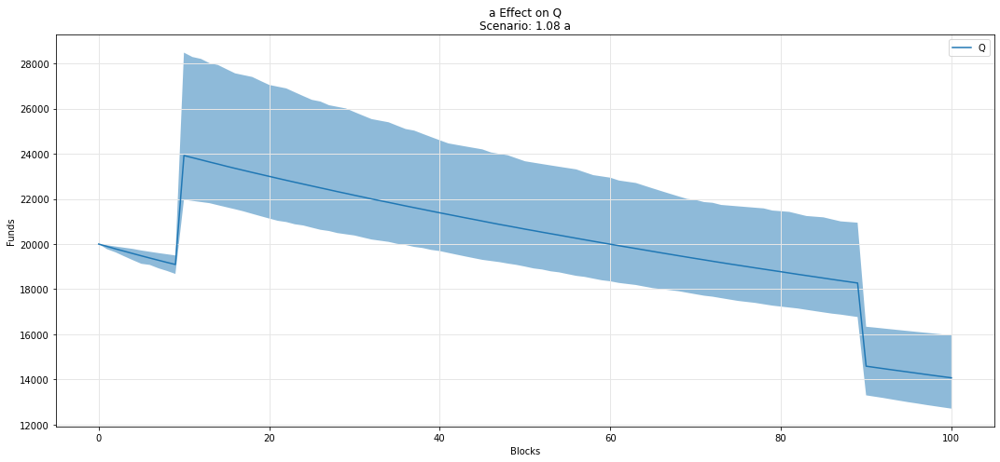

In [50]:
param_fan_plot3(experiments, config_ids, 'a','Q')

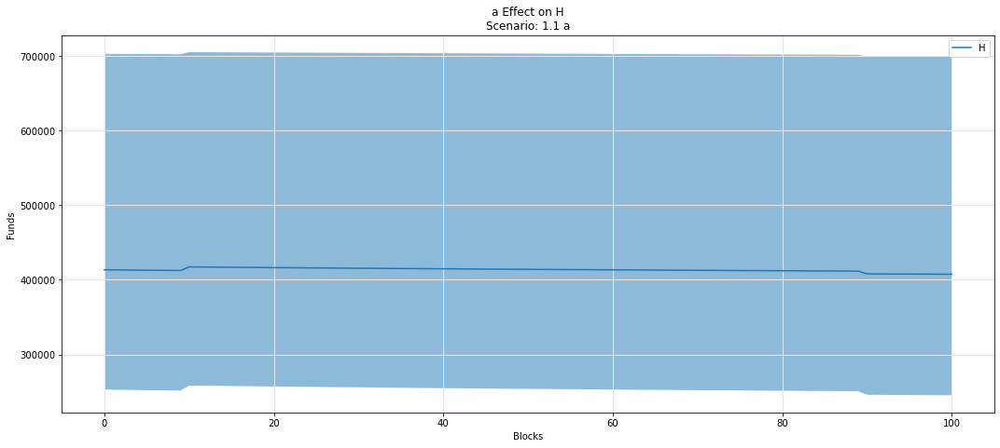

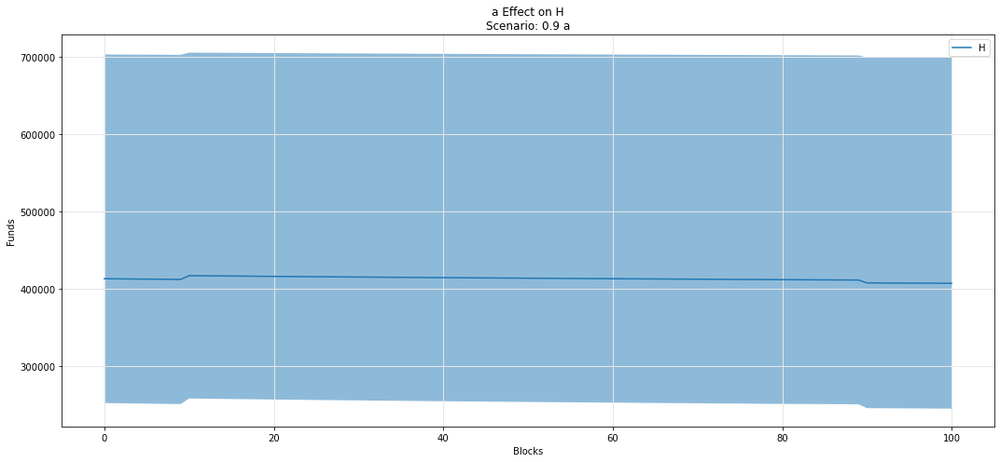

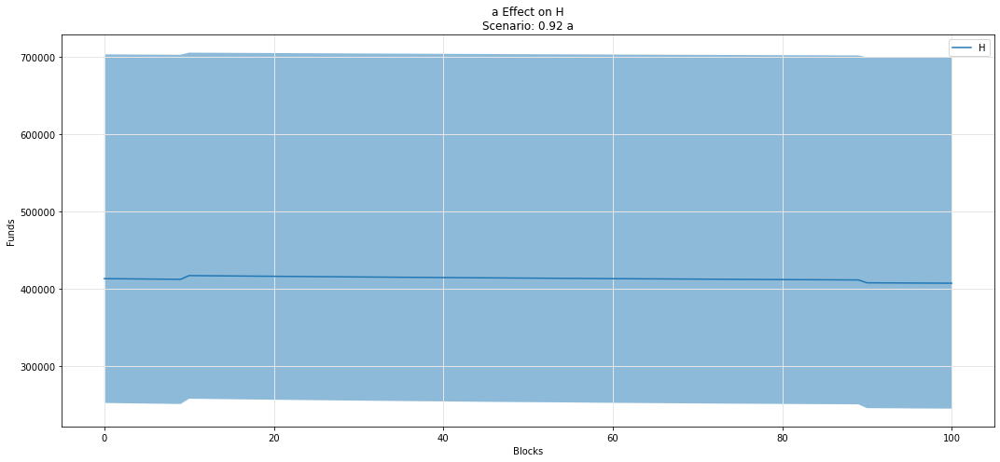

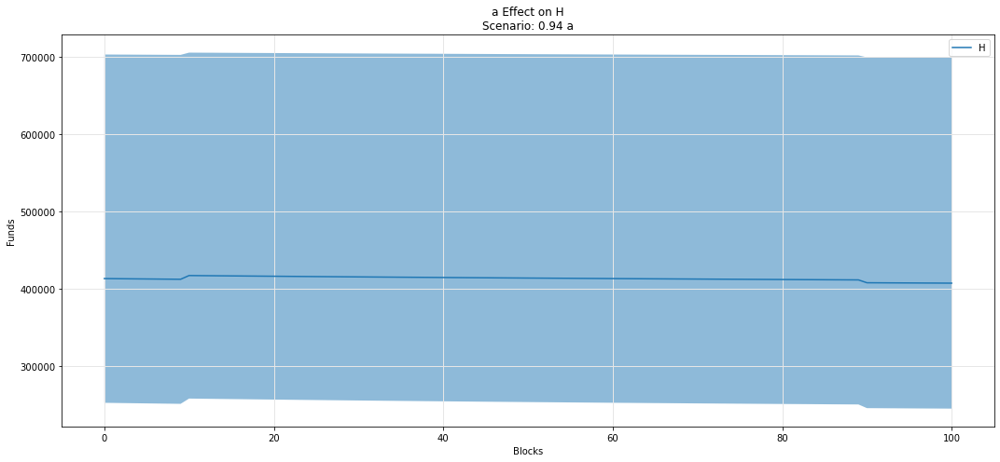

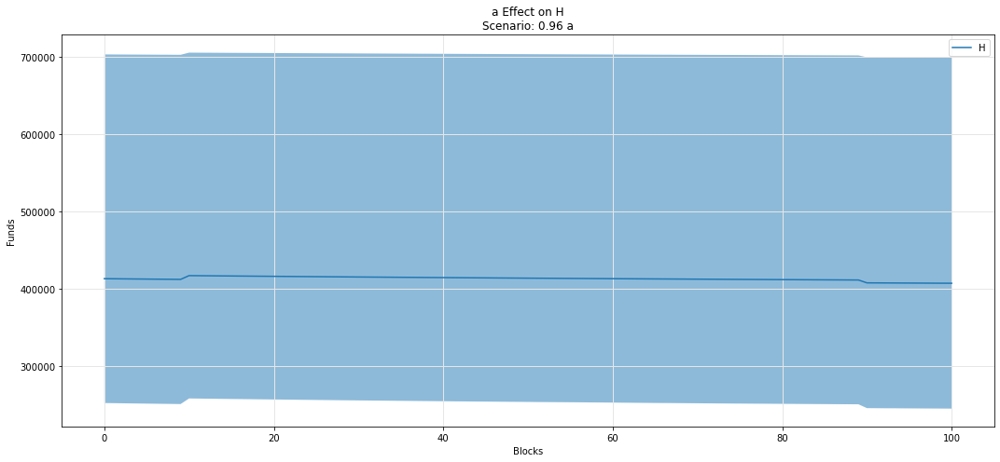

...

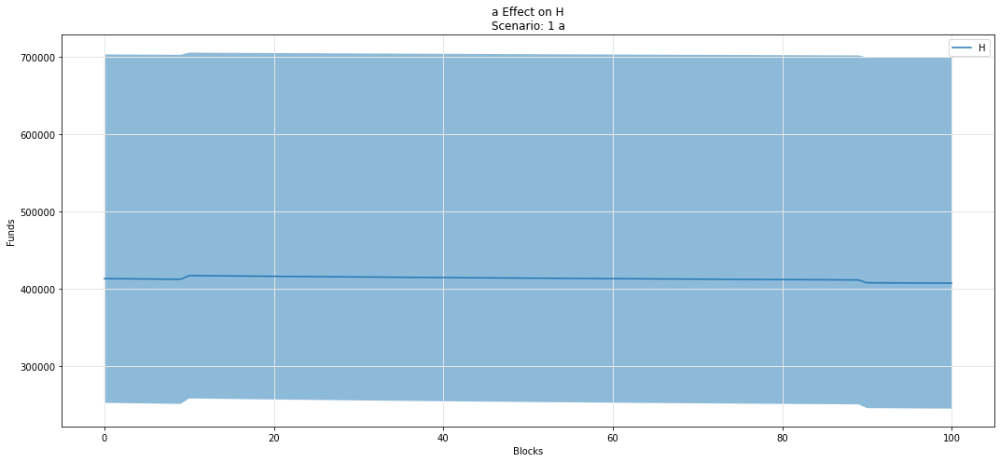

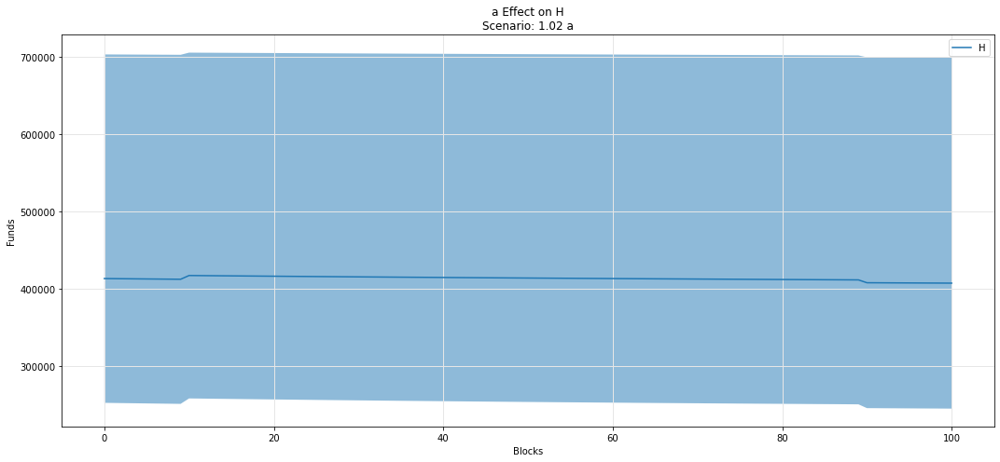

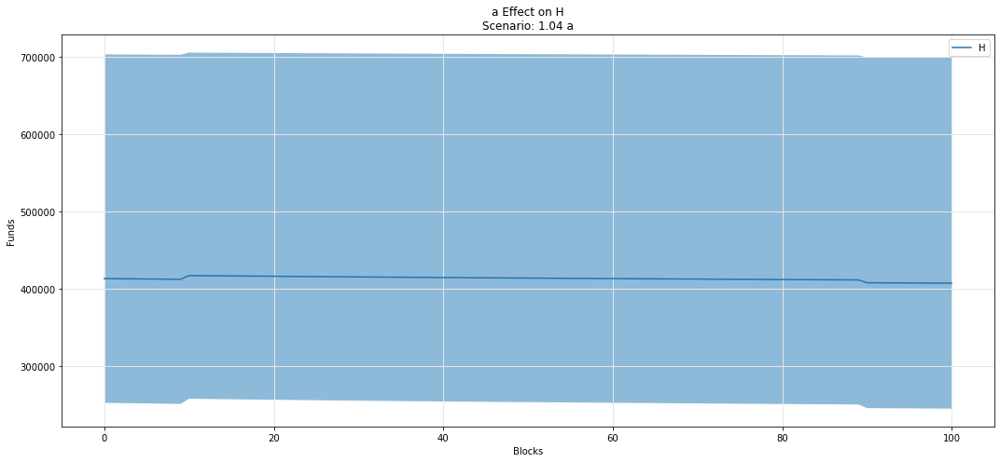

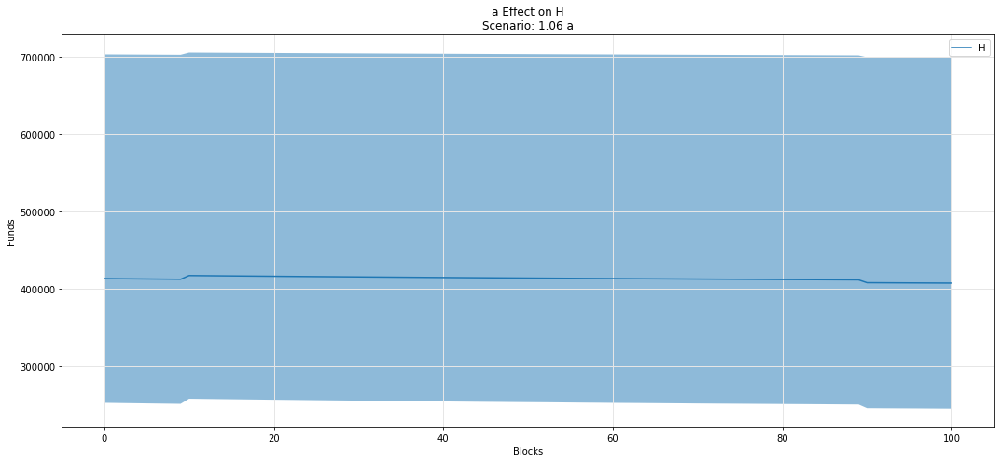

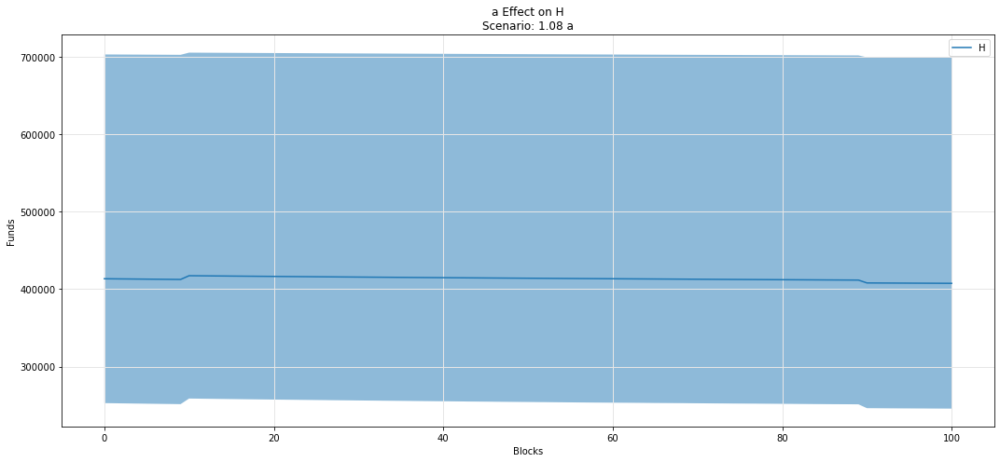

In [51]:
param_fan_plot3(experiments, config_ids, 'a','H')

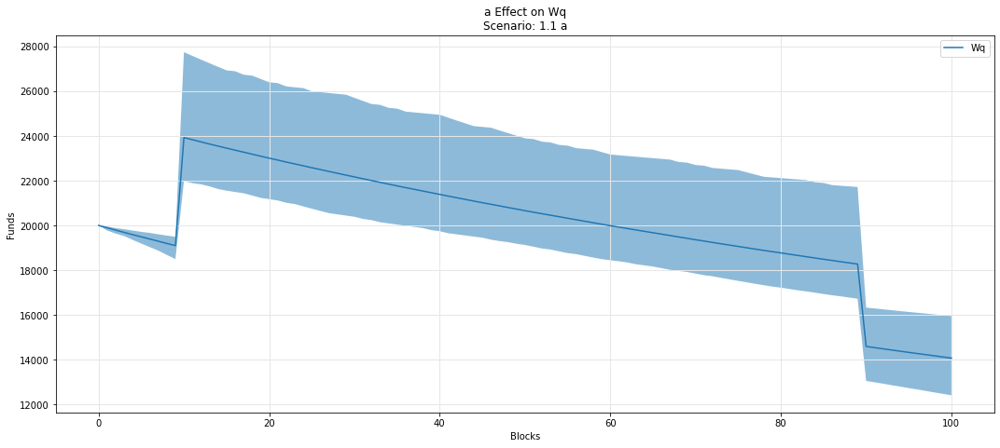

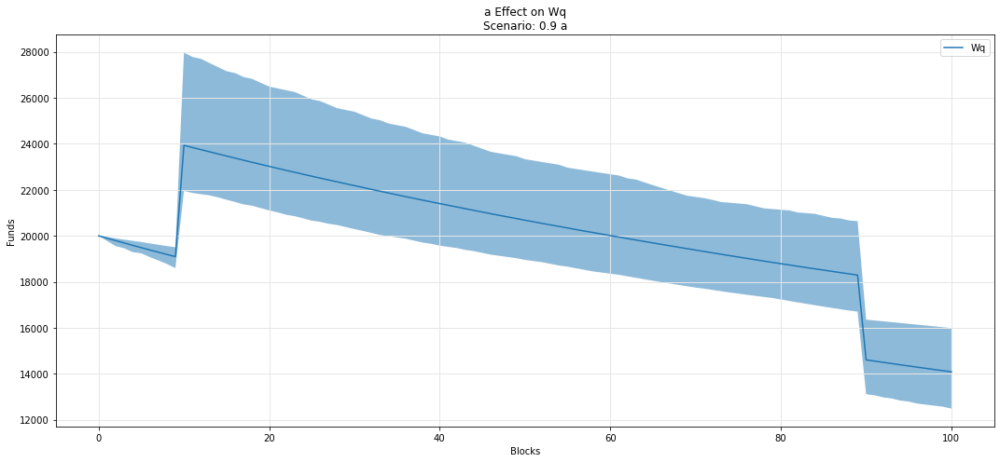

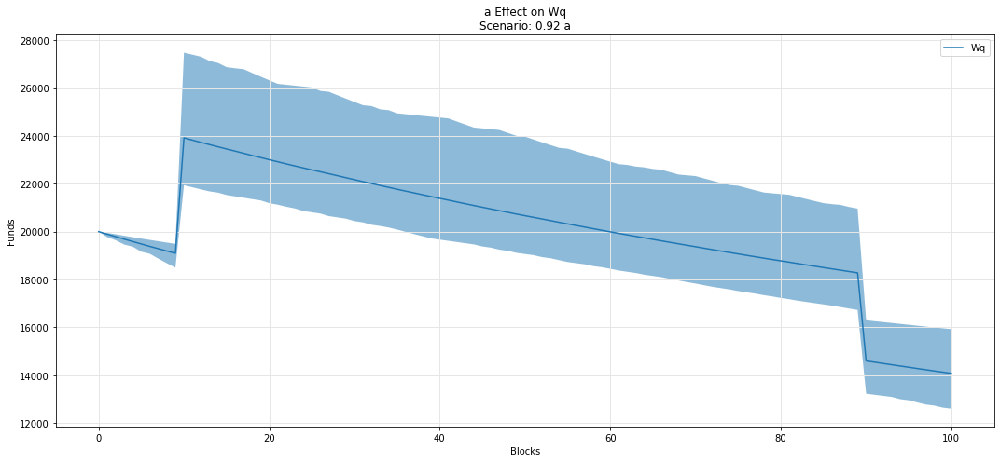

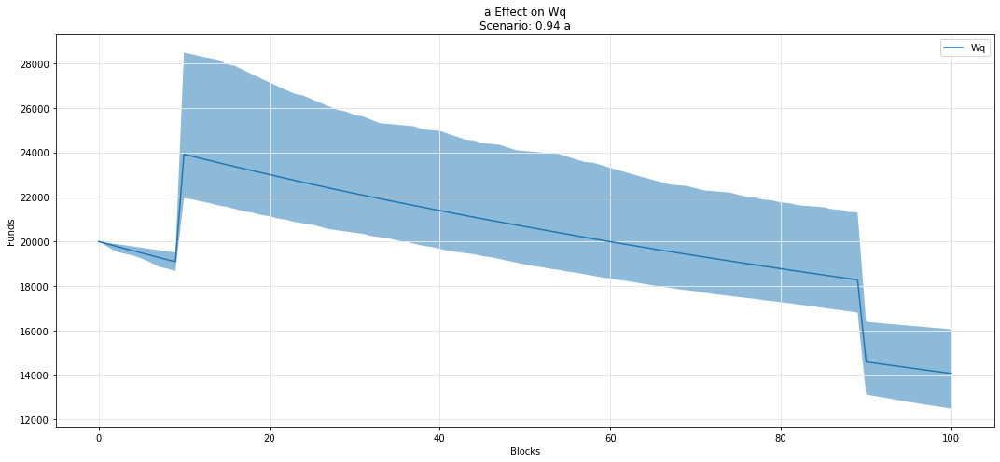

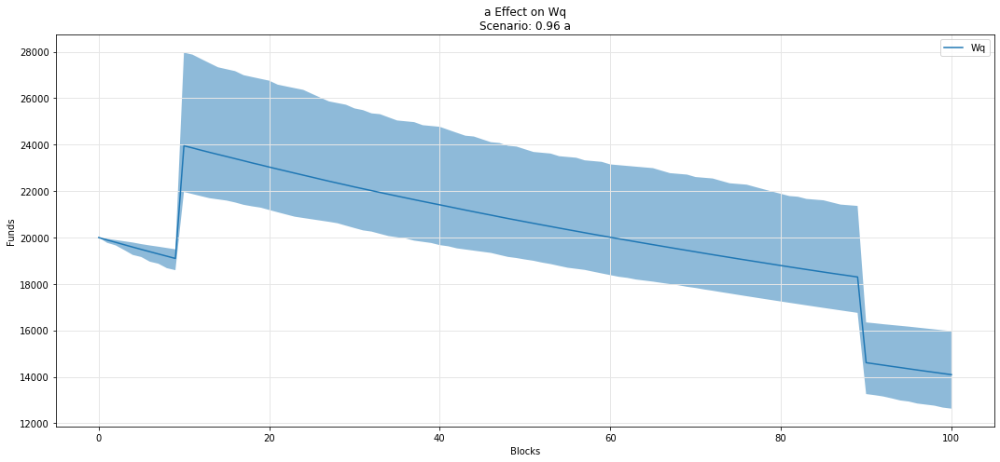

...

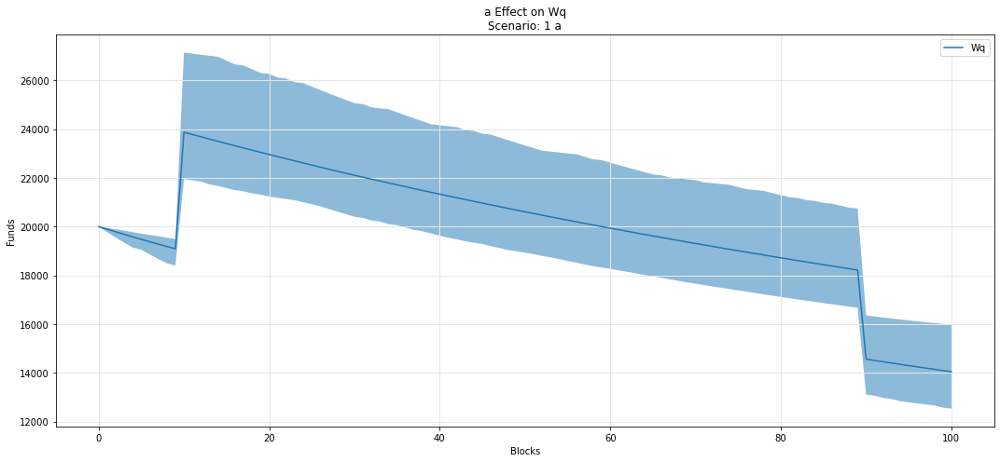

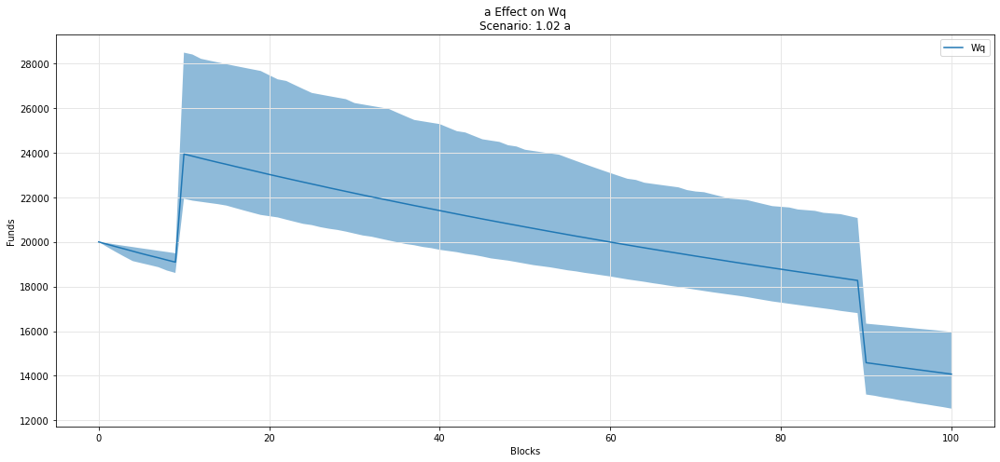

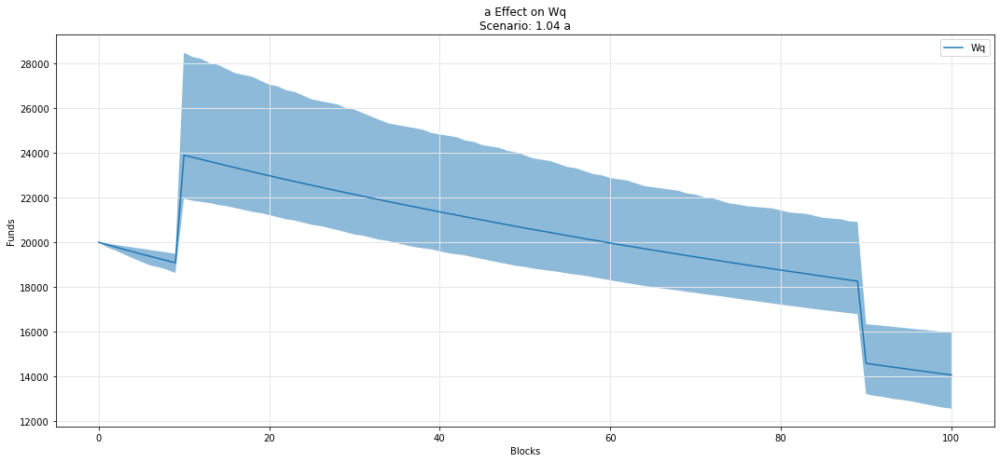

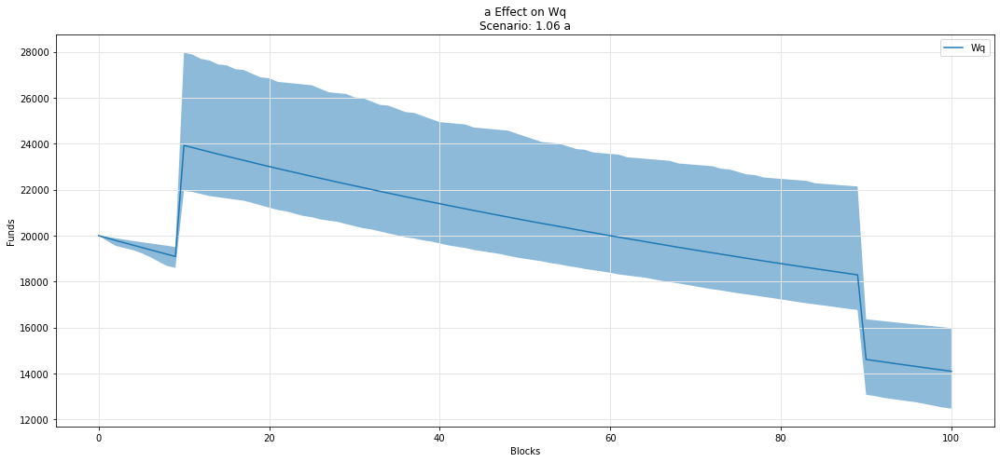

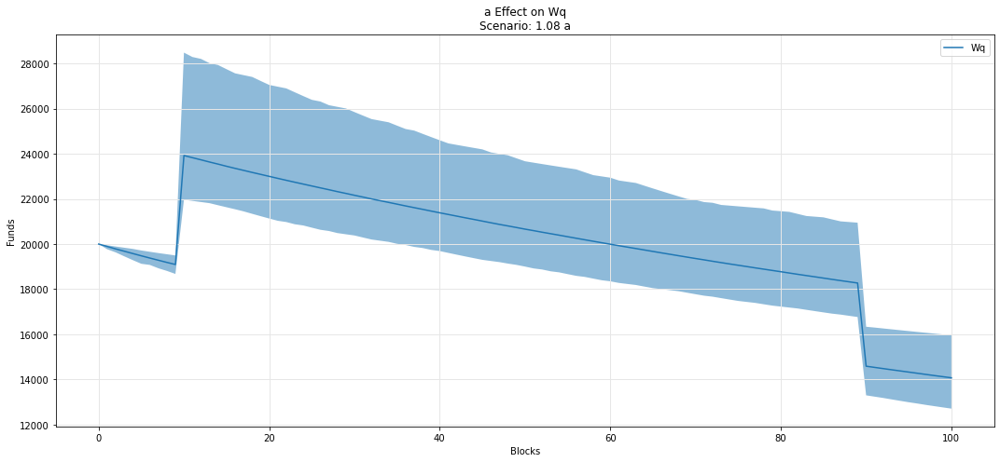

In [52]:
param_fan_plot3(experiments, config_ids, 'a','Wq')

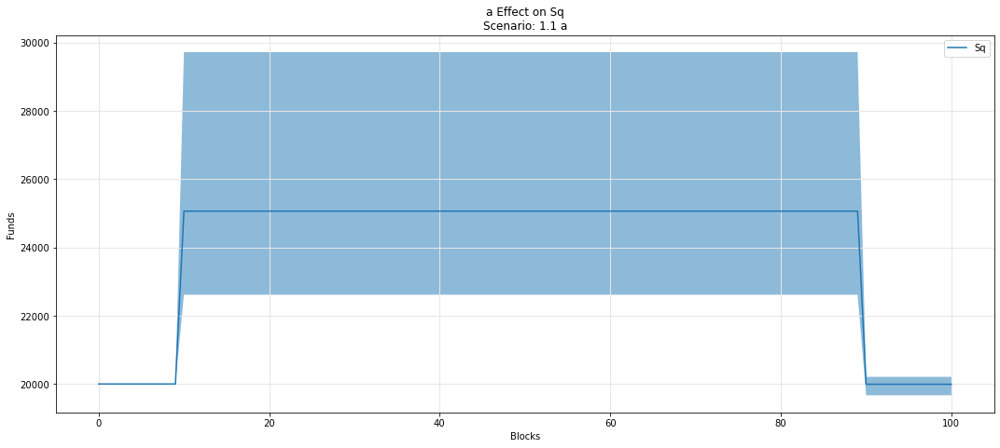

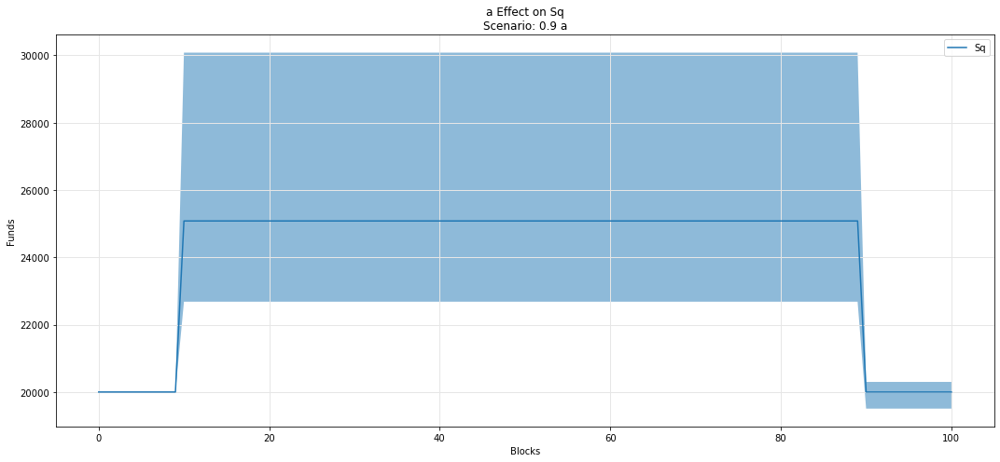

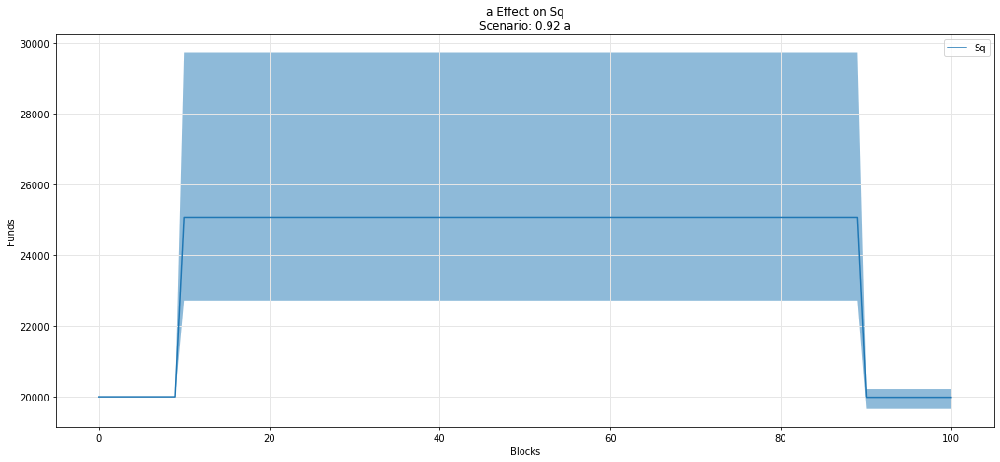

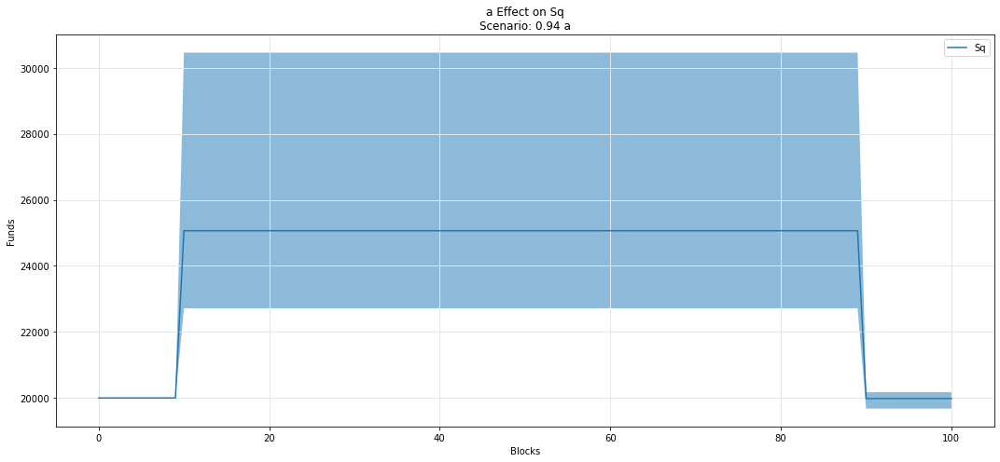

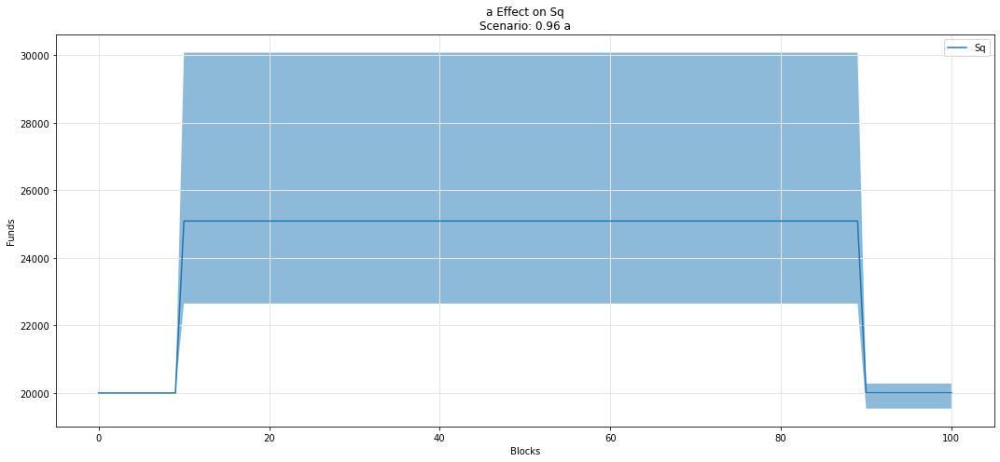

...

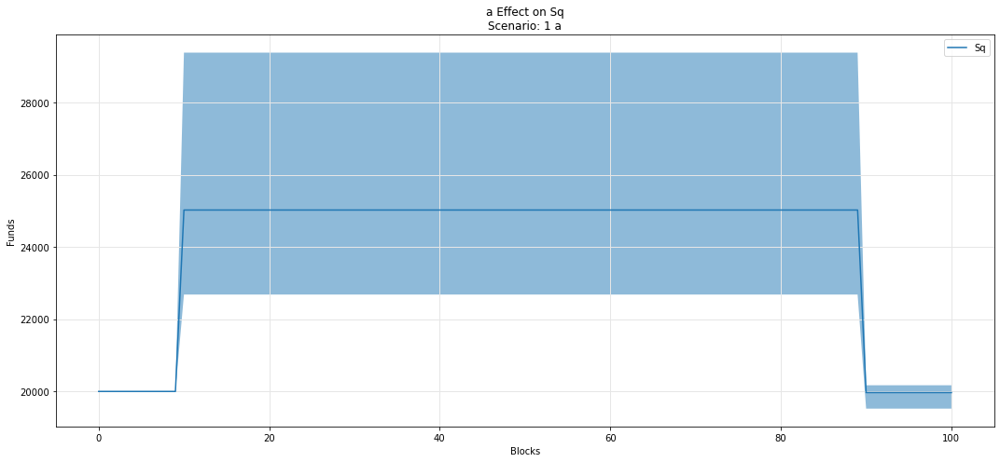

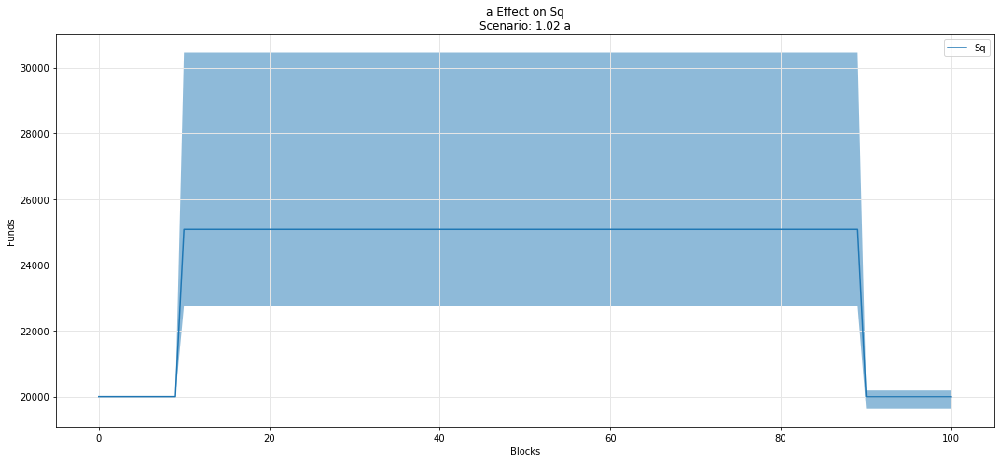

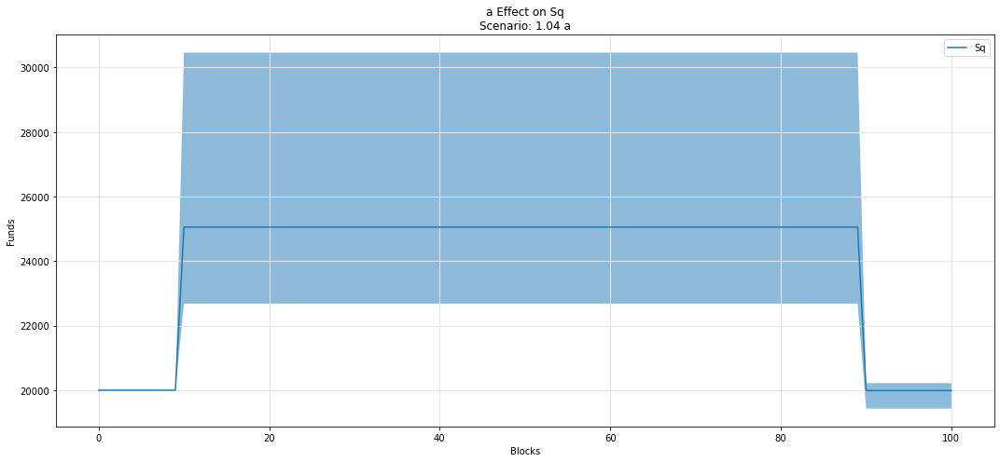

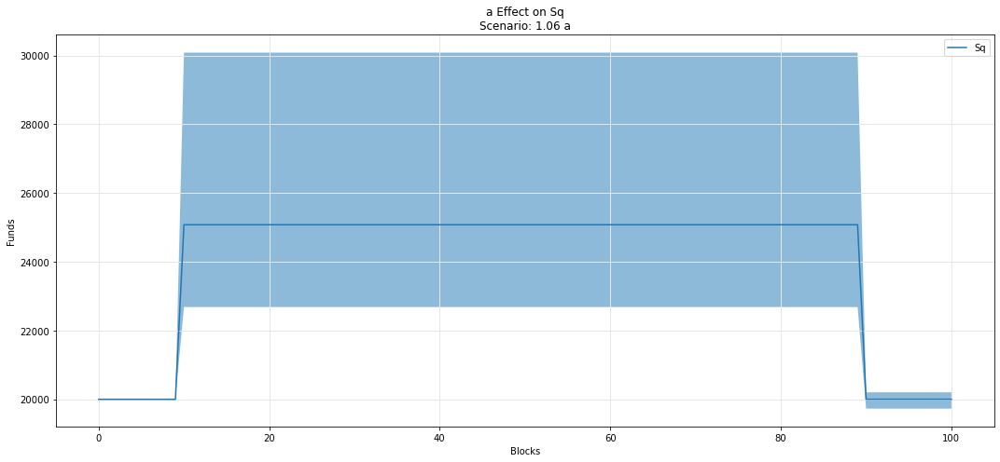

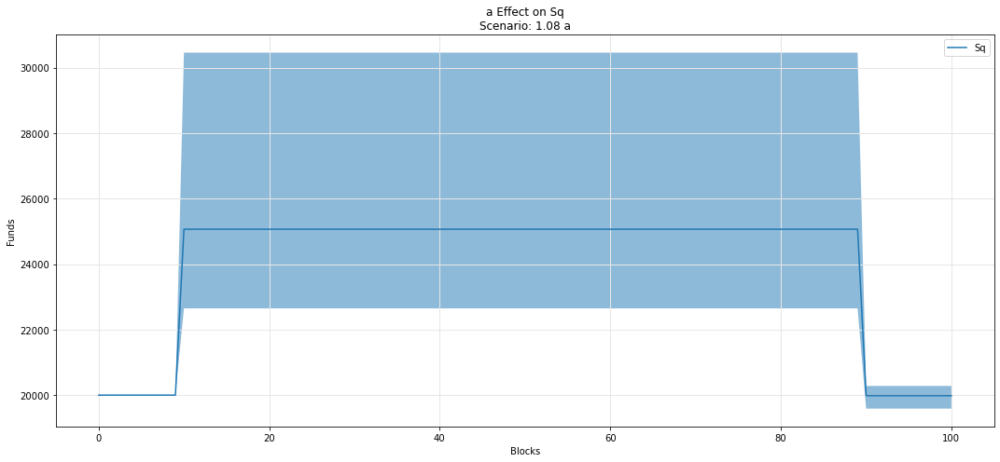

In [53]:
param_fan_plot3(experiments, config_ids, 'a','Sq')

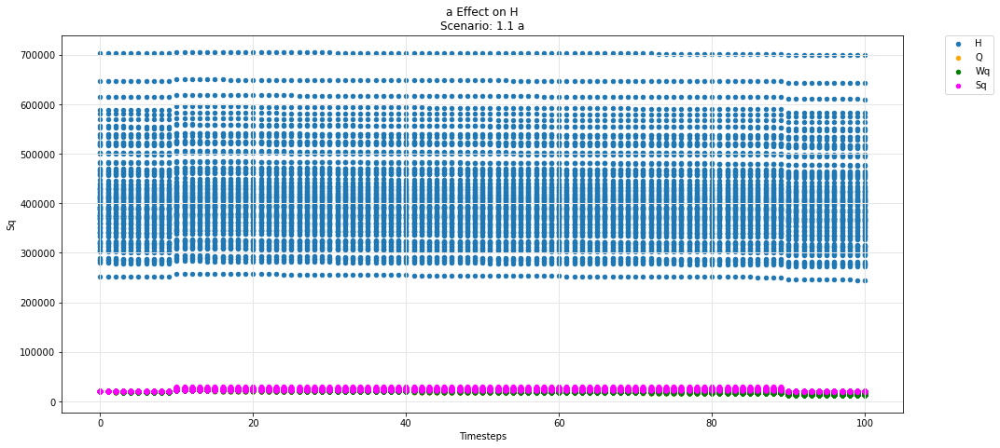

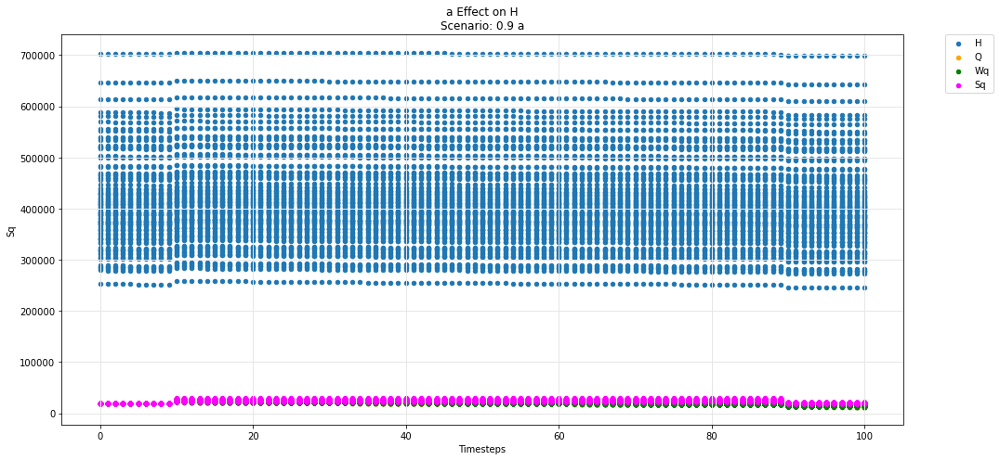

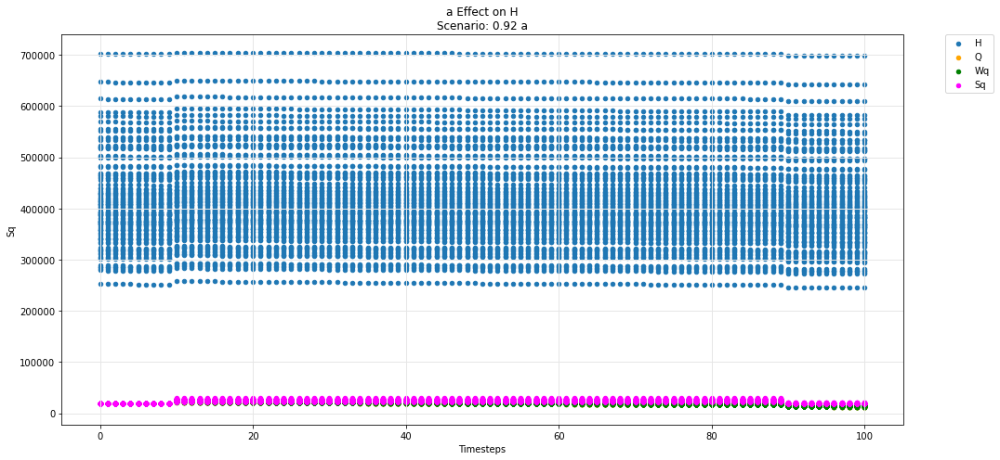

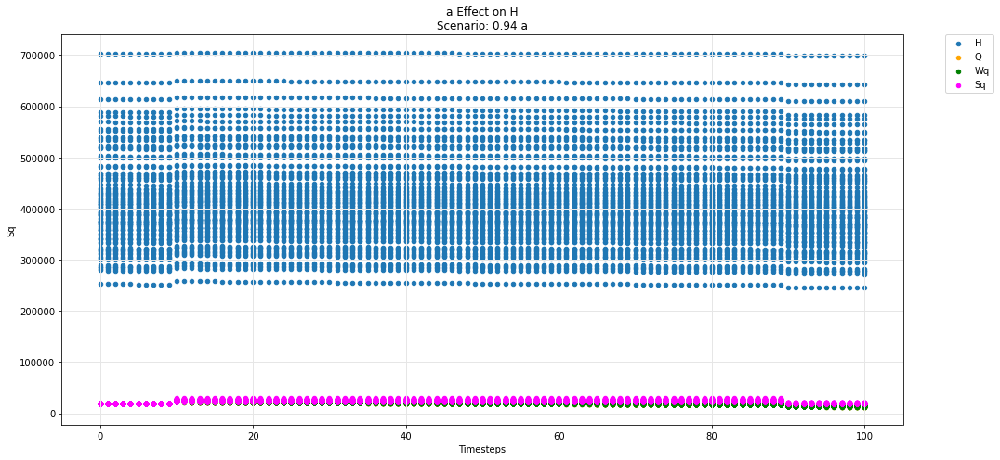

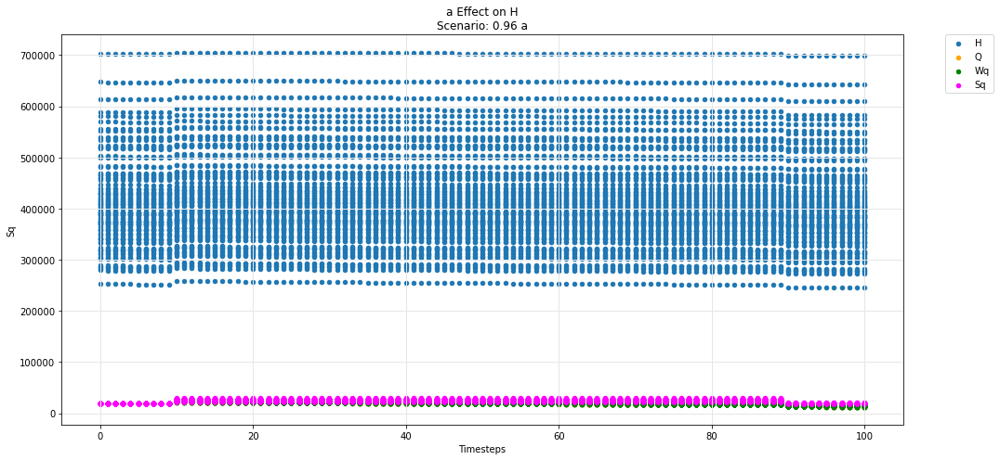

...

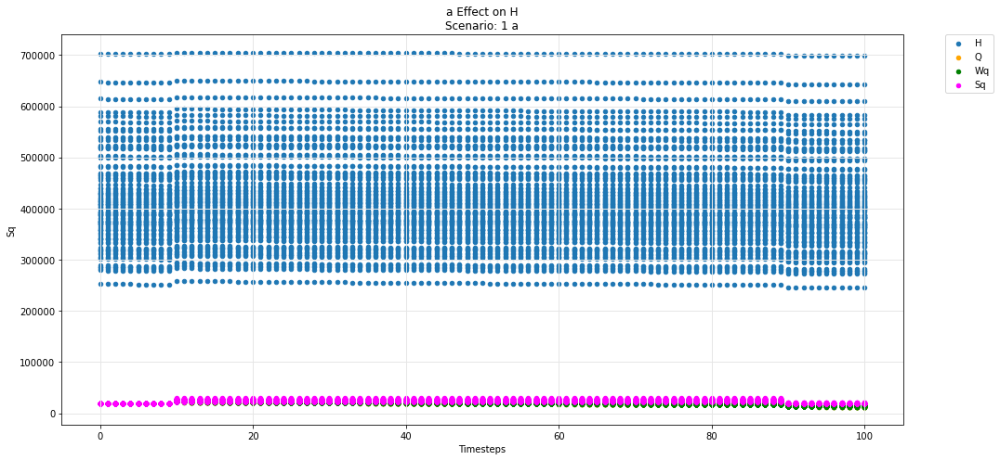

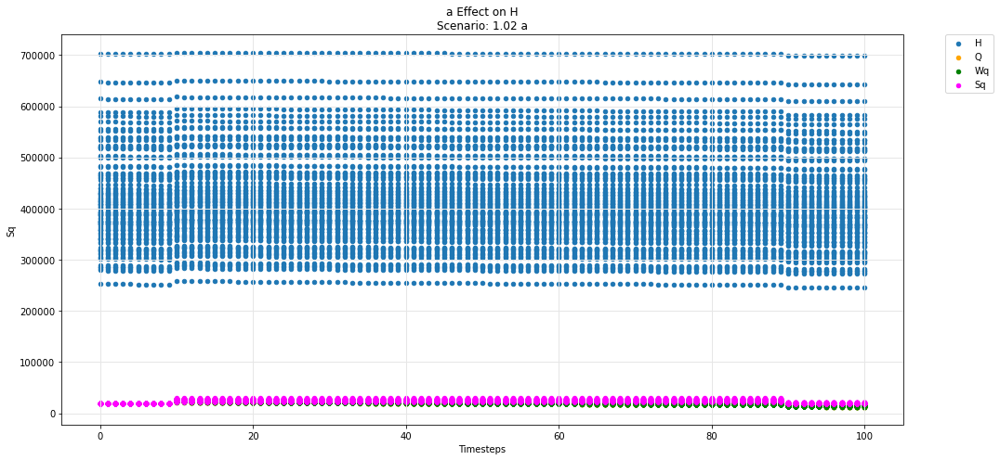

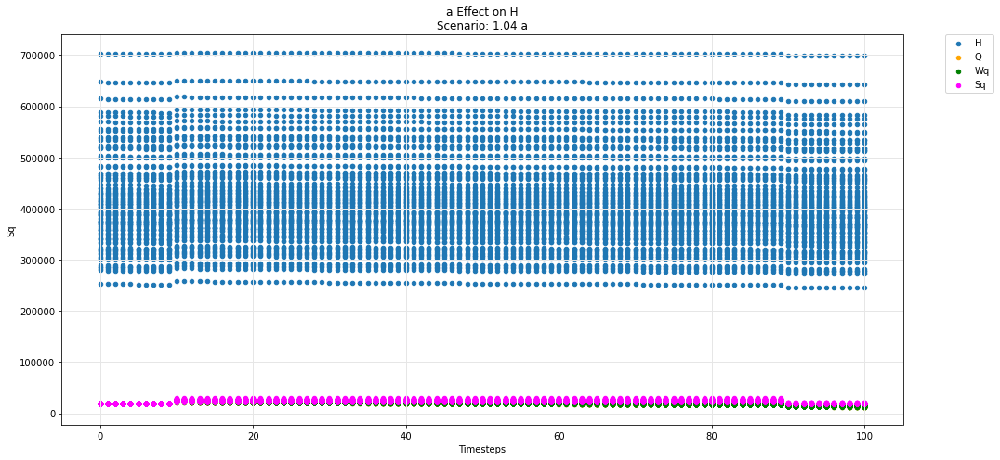

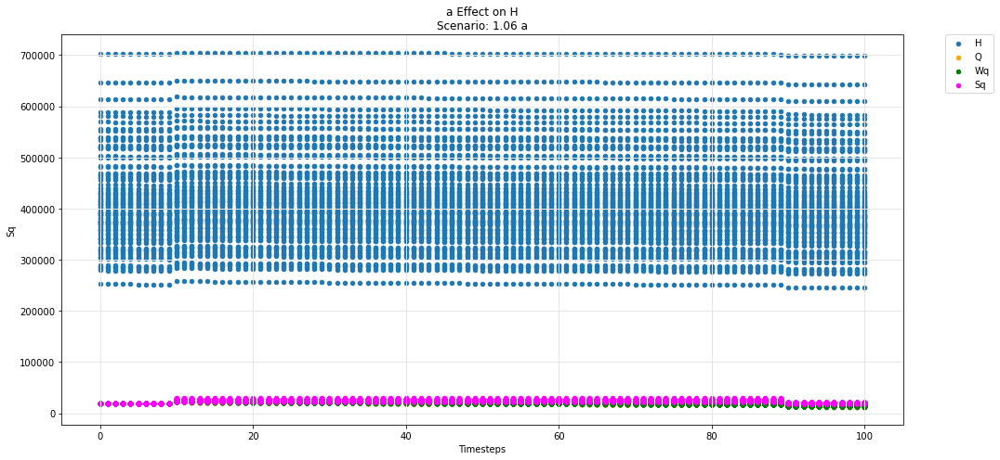

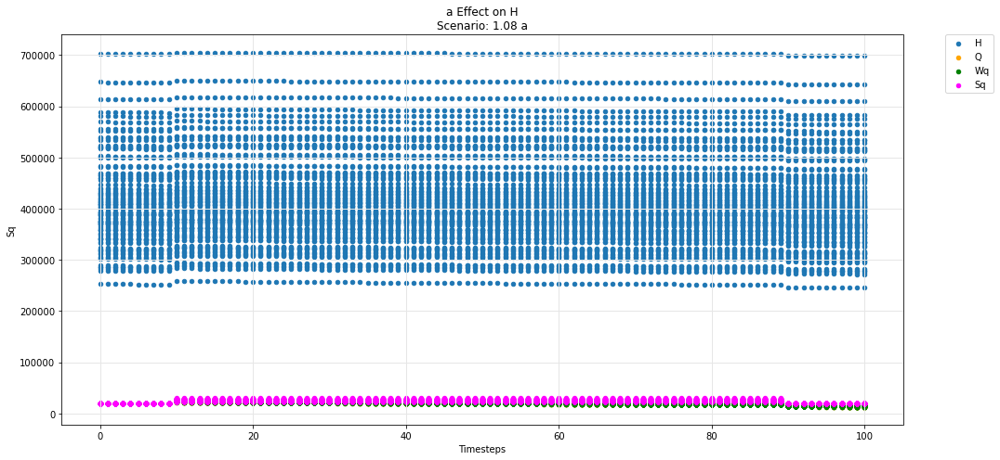

In [54]:
param_test_plot(experiments, config_ids, 'a', 'H', 'Q', 'Wq', 'Sq')

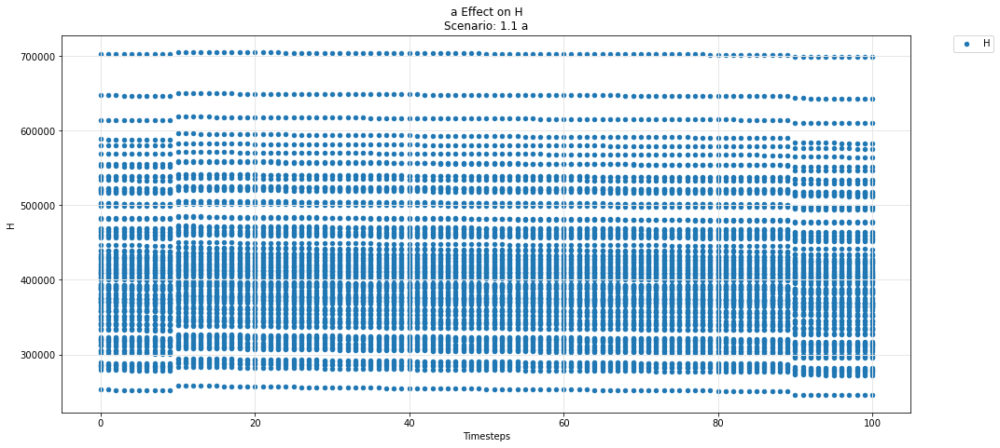

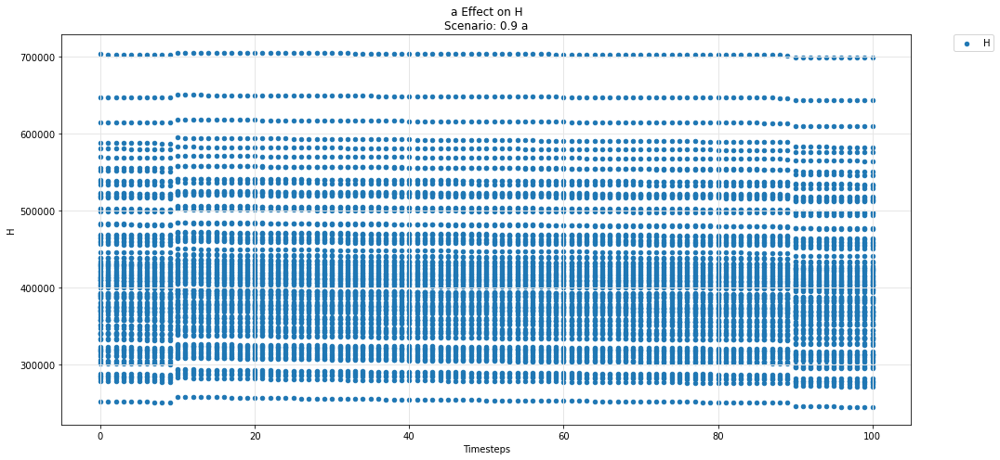

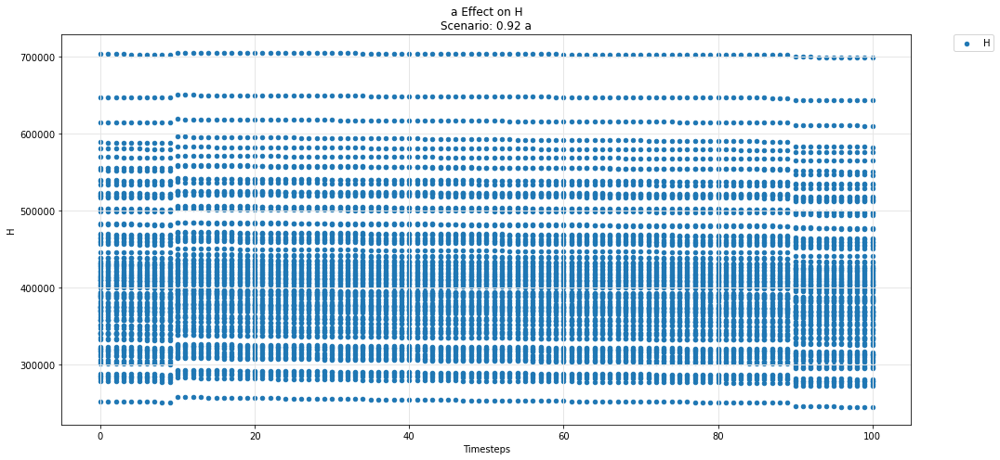

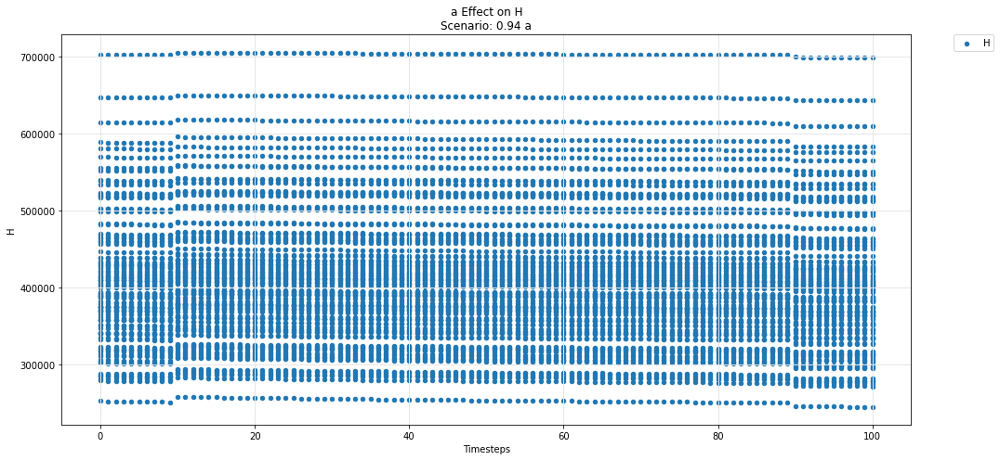

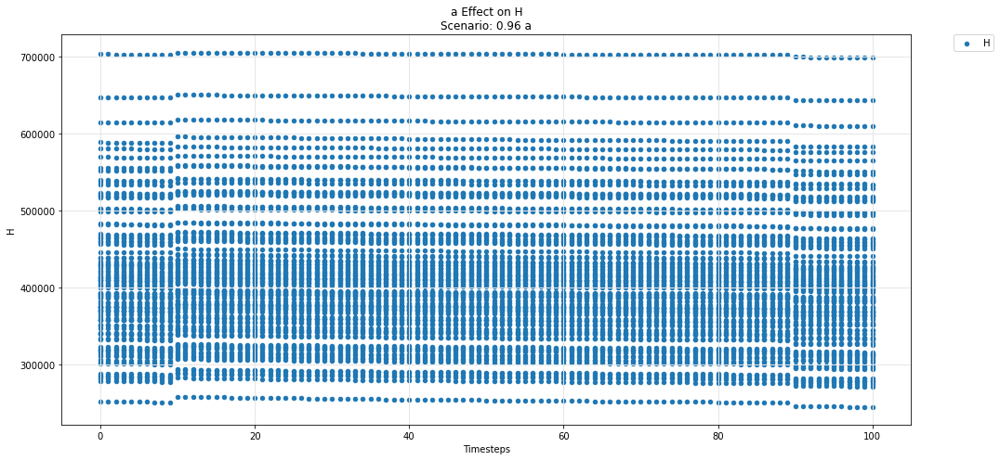

...

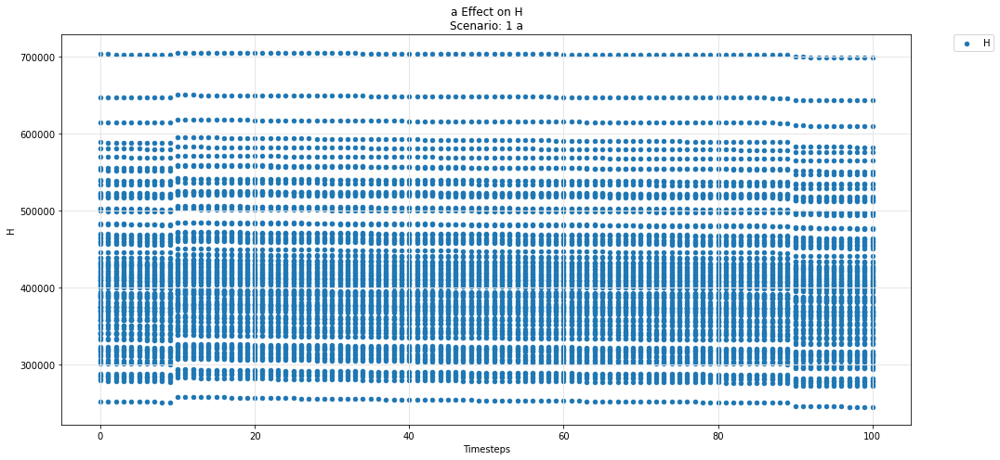

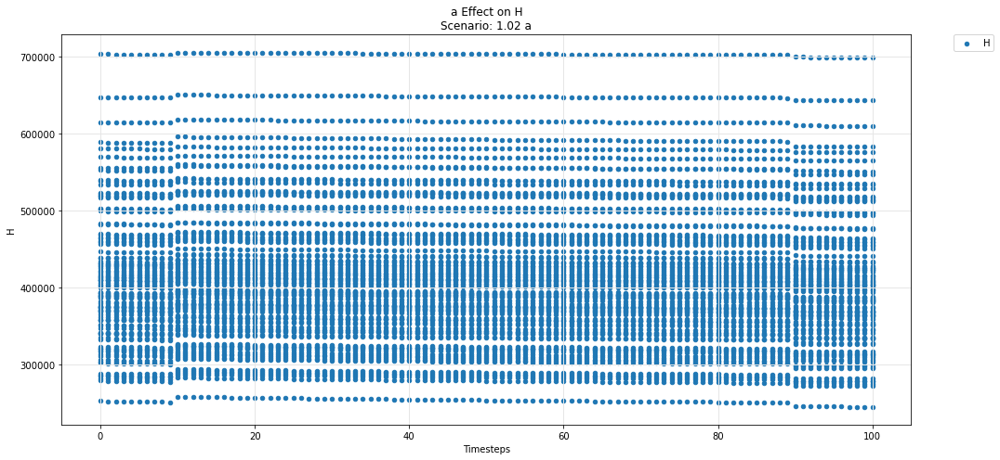

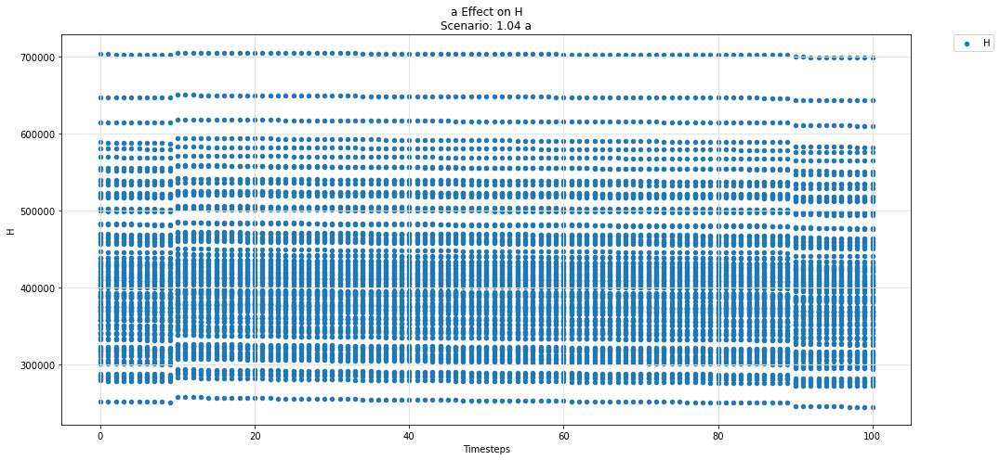

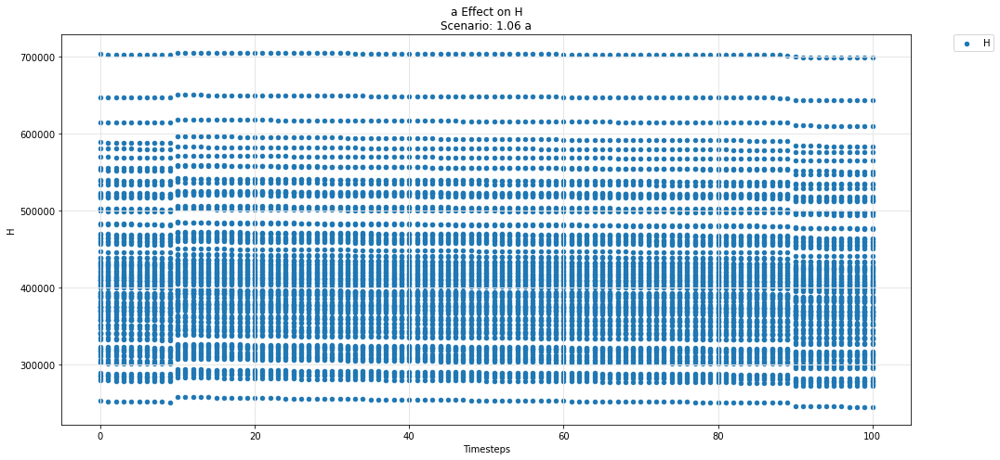

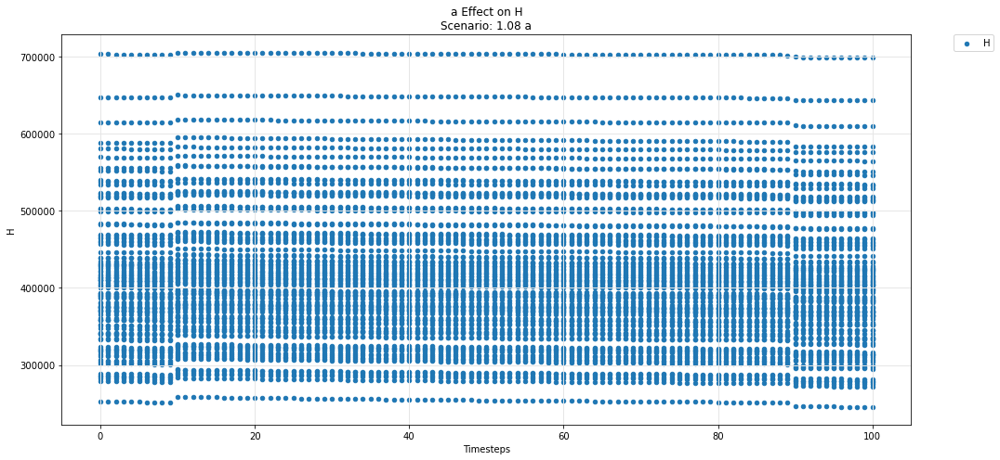

In [55]:
param_test_plot(experiments, config_ids, 'a', 'H')

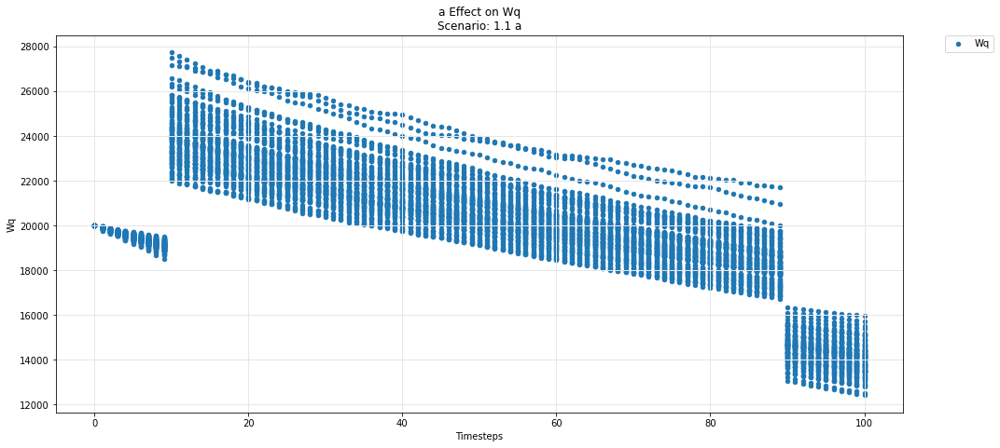

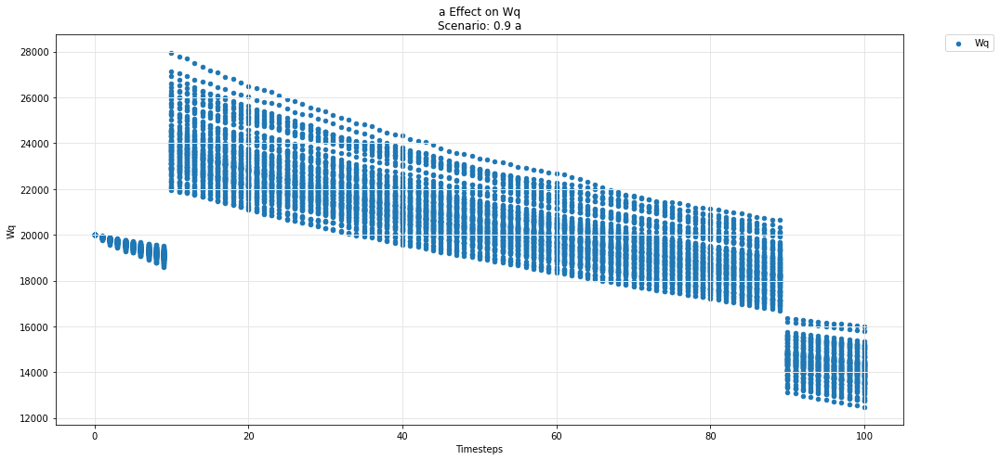

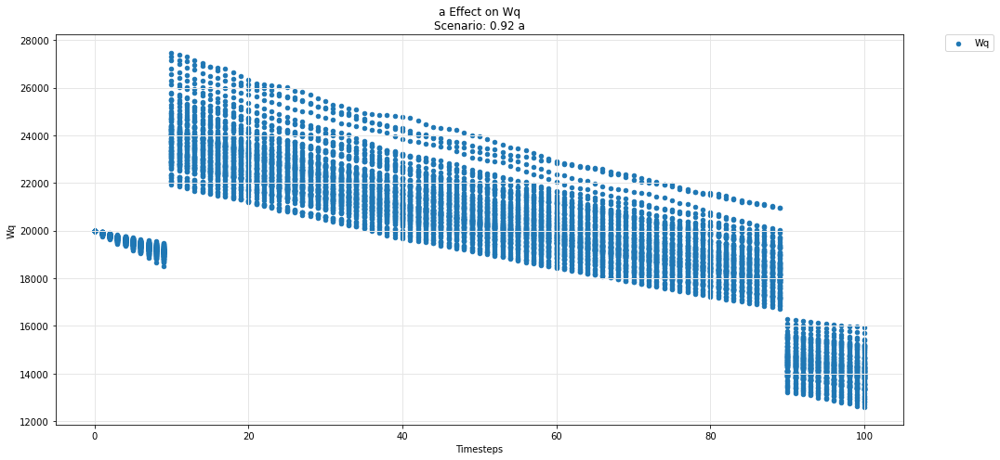

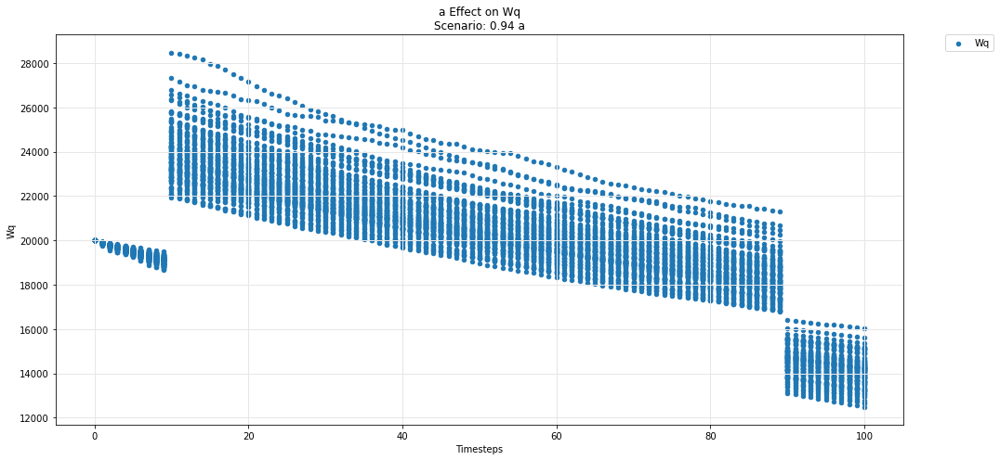

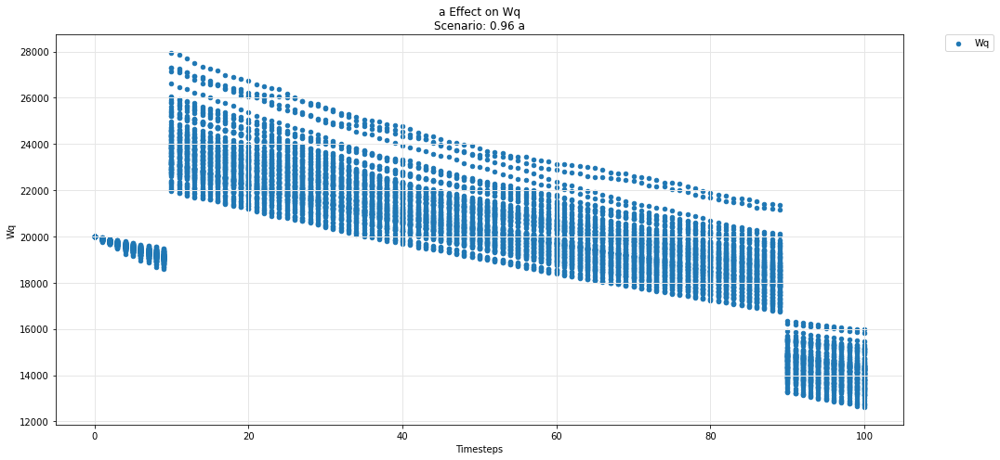

...

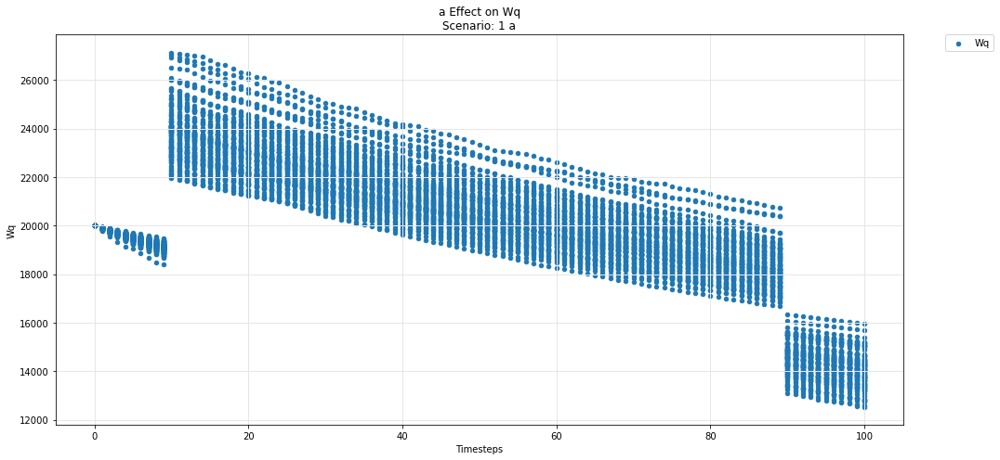

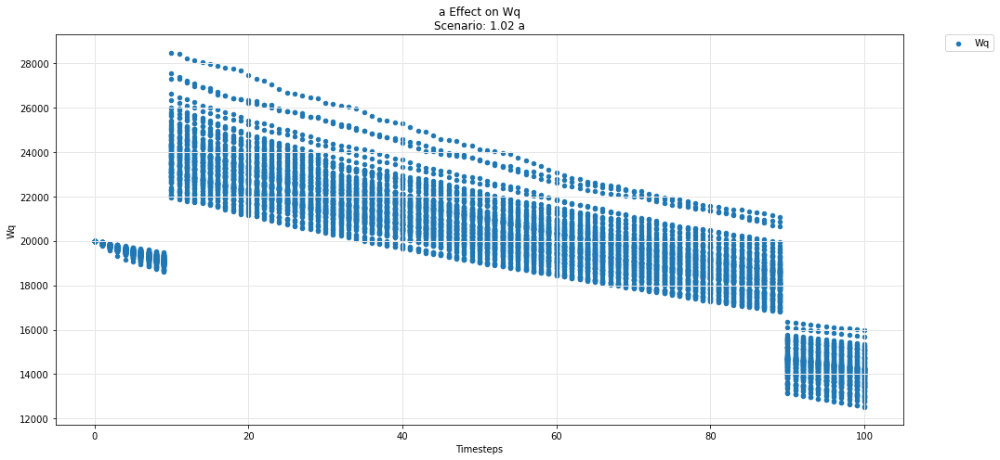

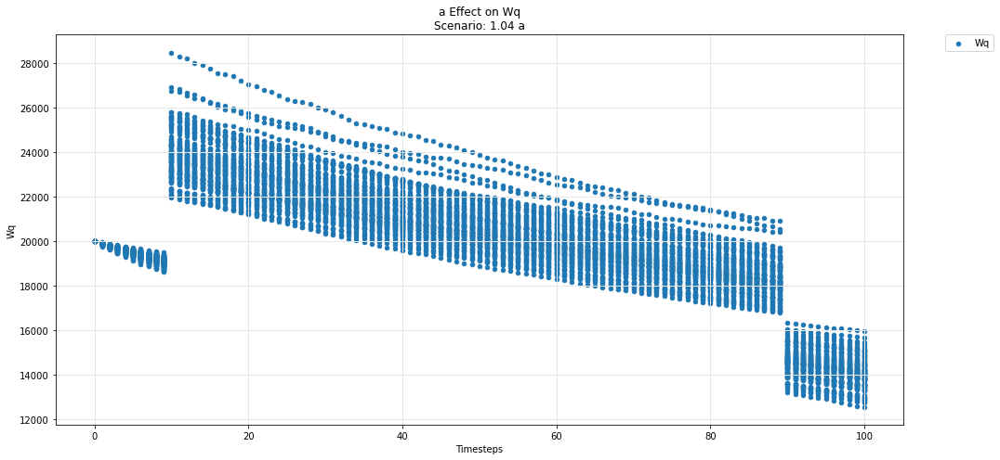

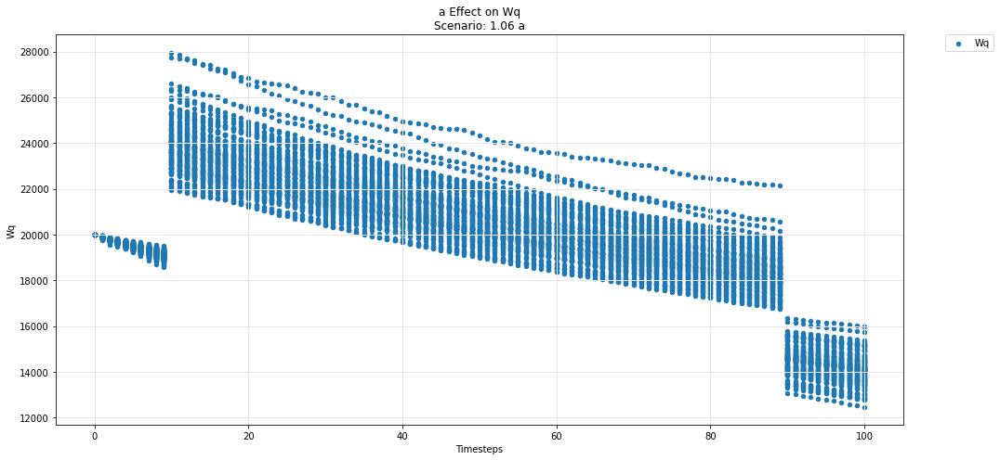

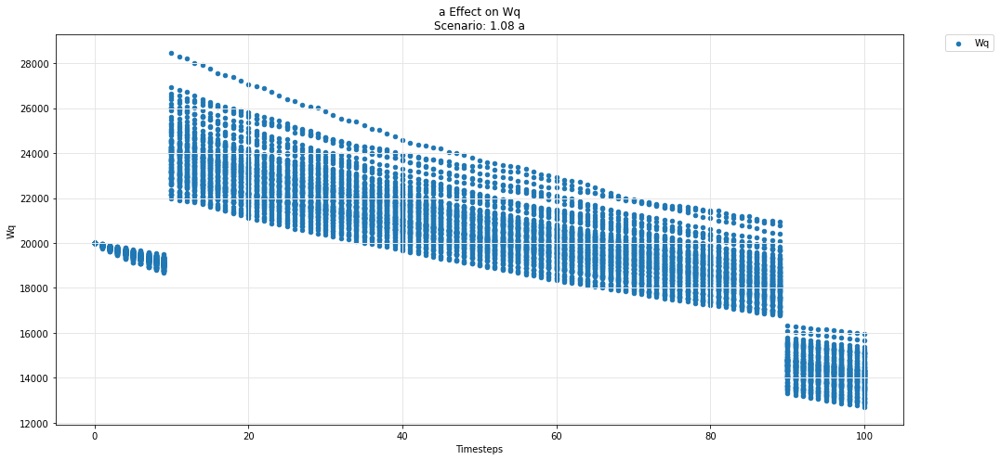

In [56]:
param_test_plot(experiments, config_ids, 'a', 'Wq')

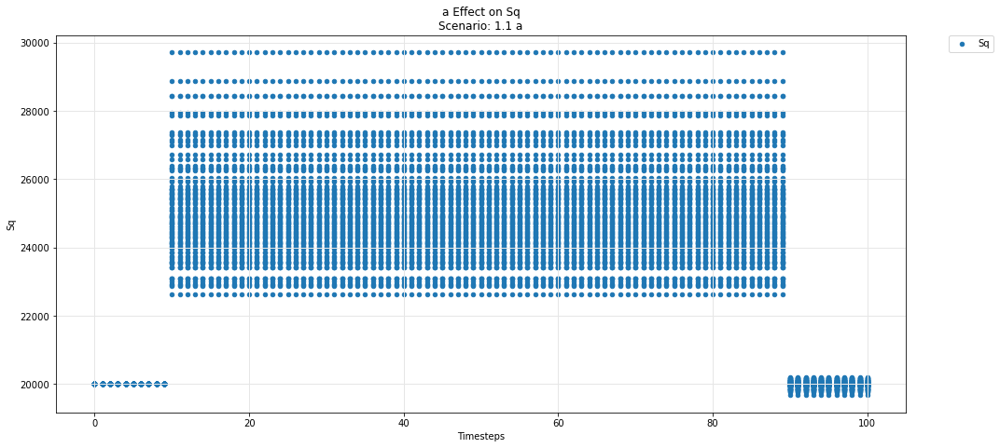

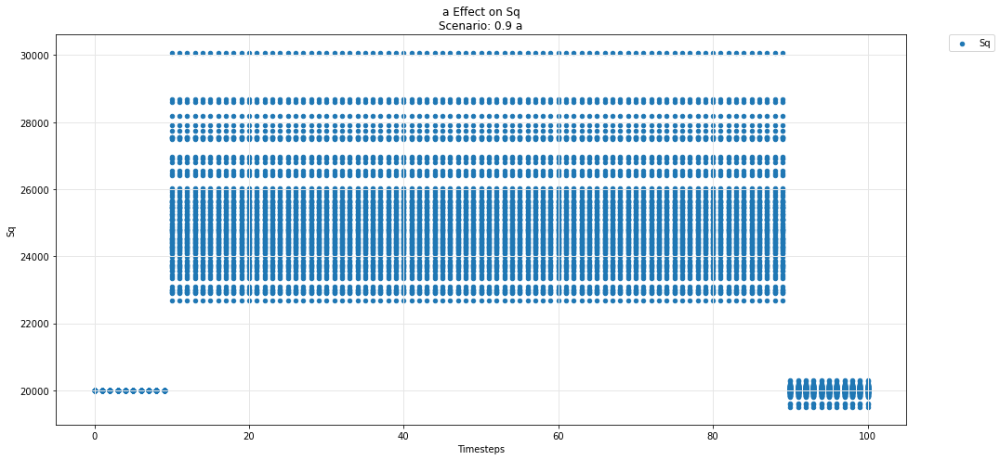

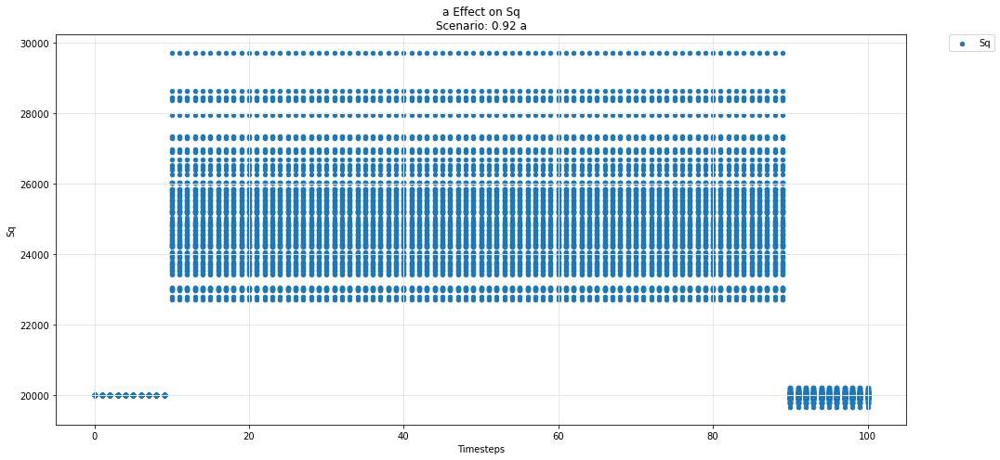

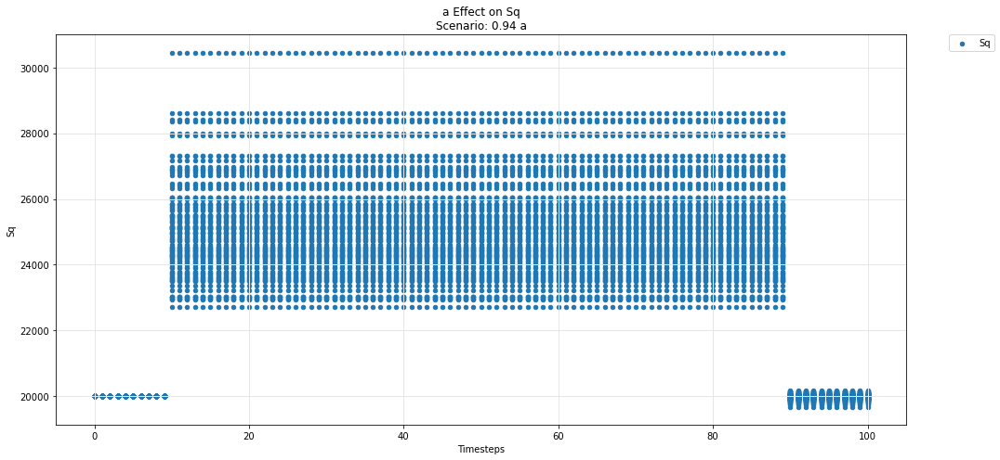

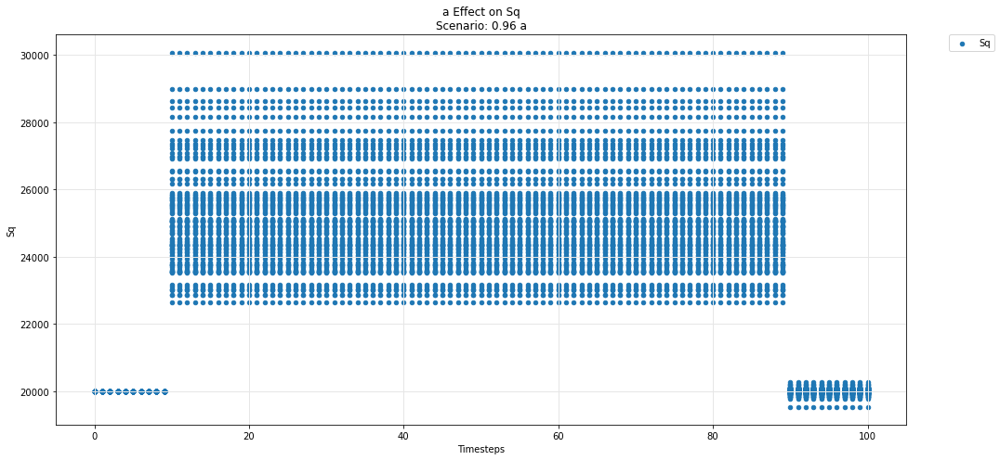

...

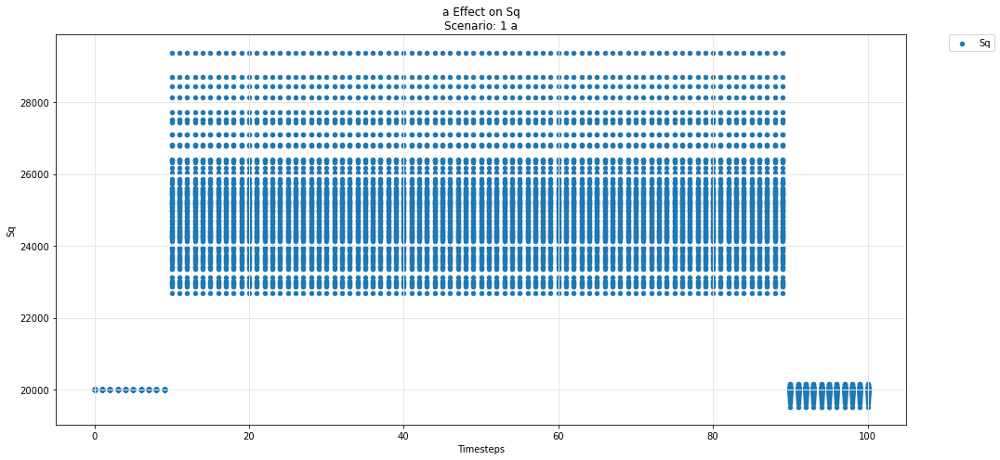

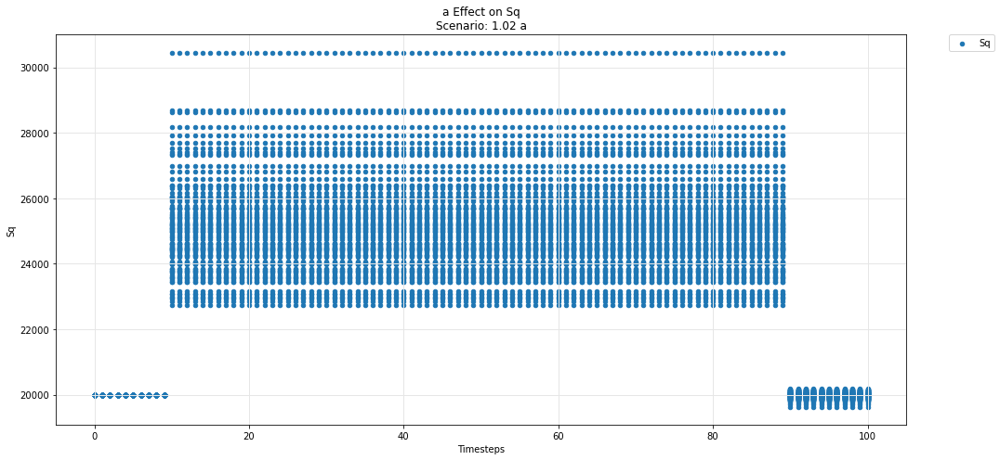

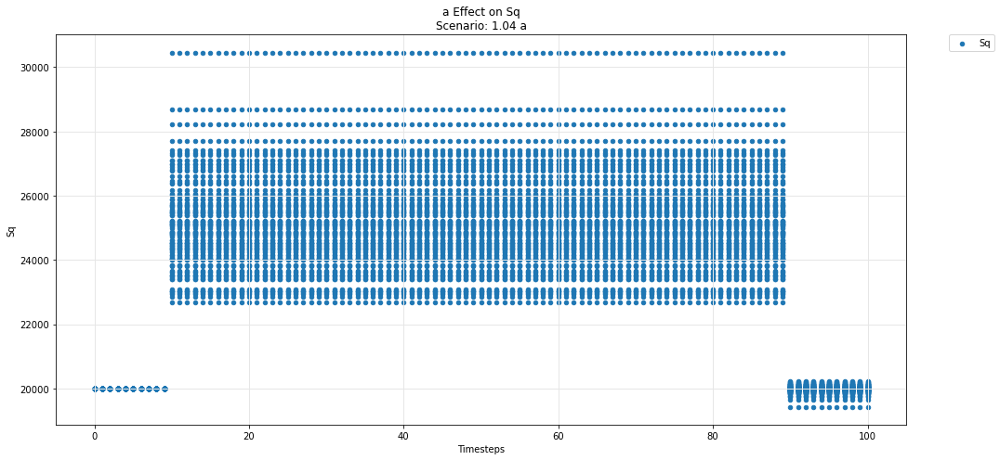

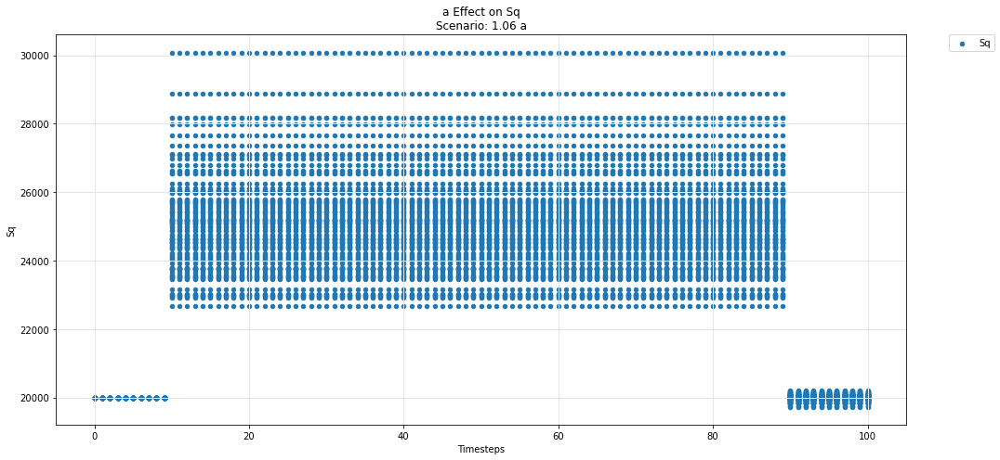

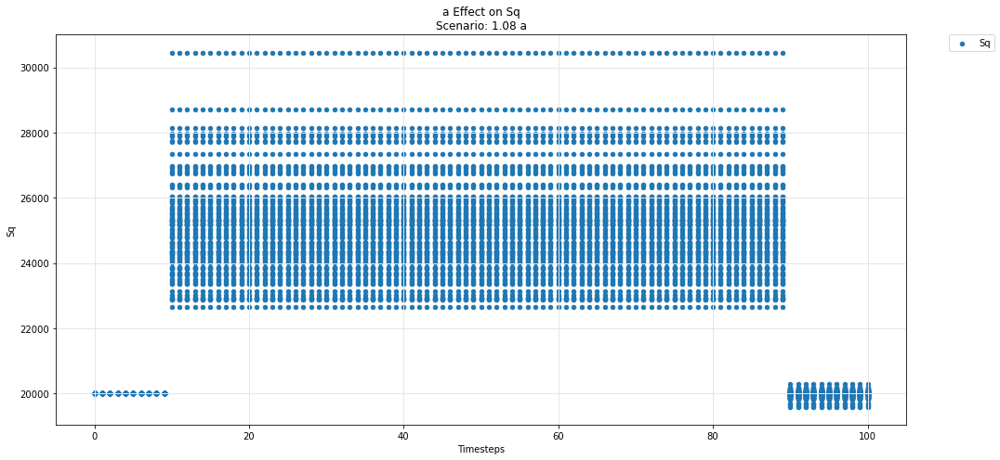

In [57]:
param_test_plot(experiments, config_ids, 'a', 'Sq')

## Hydra -- pool

Movement of the Omnipool variables
- Asset i
- Asset j
- Asset k

over the course of the simulation

In [58]:
def param_pool_simulation_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        df = df.groupby('timestep').agg({df_label: ['min', 'mean', 'max']}).reset_index()
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=(df_label,'mean'), label=df_label, ax=ax, legend=True, kind ='scatter')
        ax.fill_between(df.timestep, df[(df_label,'min')], df[(df_label,'max')], alpha=0.3)    
        for count, arg in enumerate(args):
            df = sub_experiments.copy()
            
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))
            df = df.groupby('timestep').agg({df_arg_label: ['min', 'mean', 'max']}).reset_index()

            df.plot(x='timestep', y=(df_arg_label,'mean'), label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')
            ax.fill_between(df.timestep, df[(df_arg_label,'min')], df[(df_arg_label,'max')], alpha=0.3)    

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

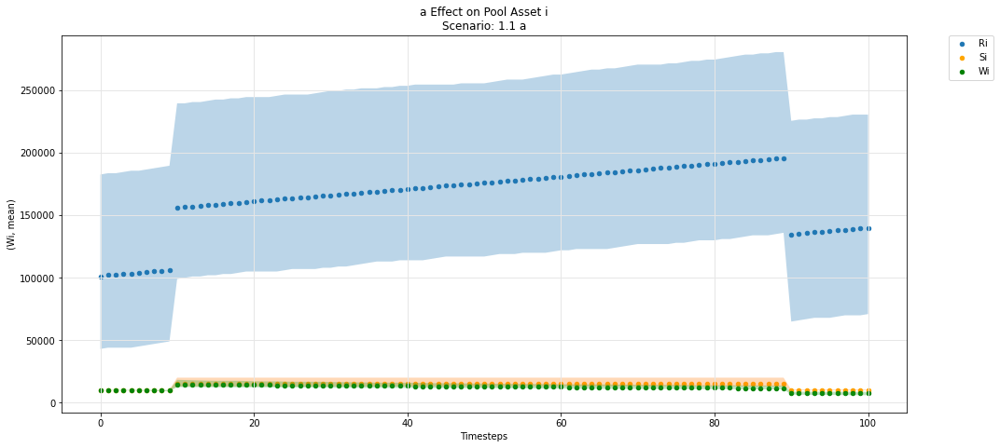

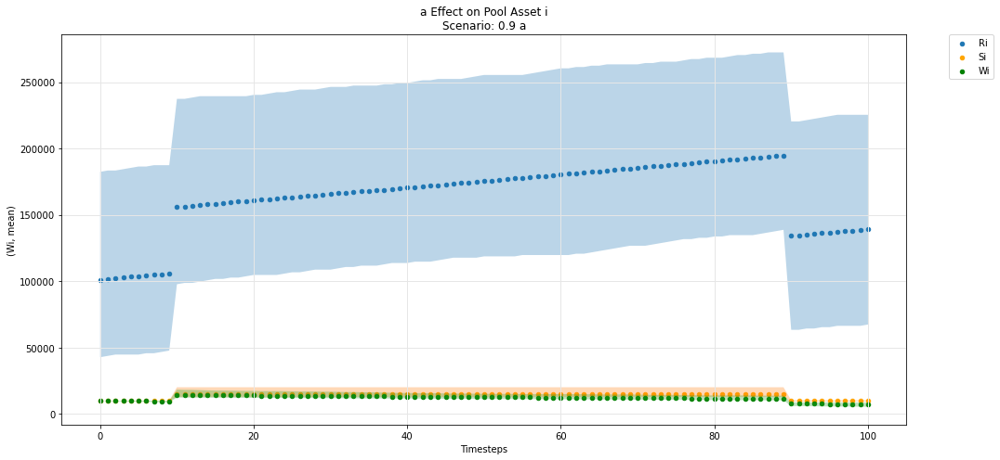

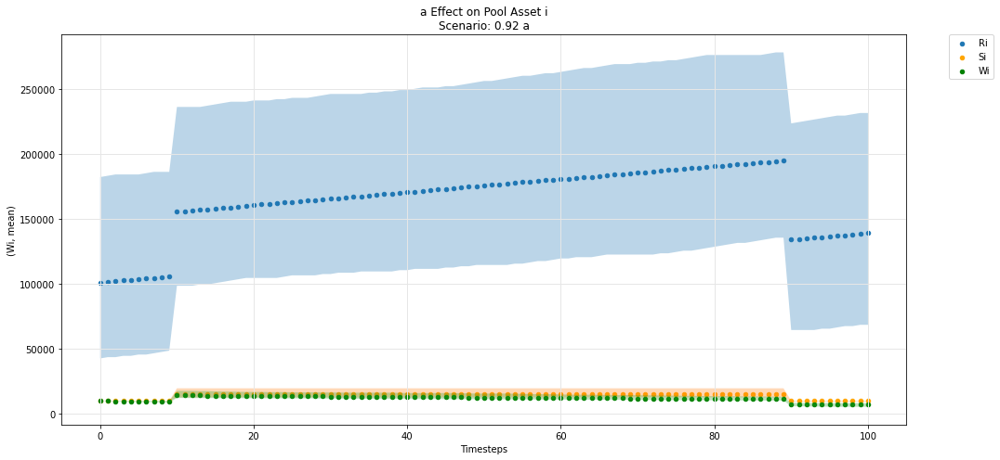

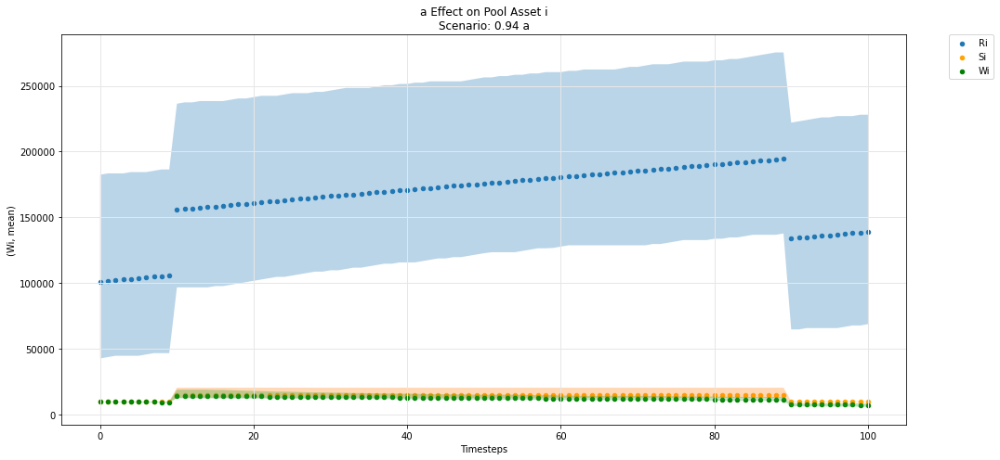

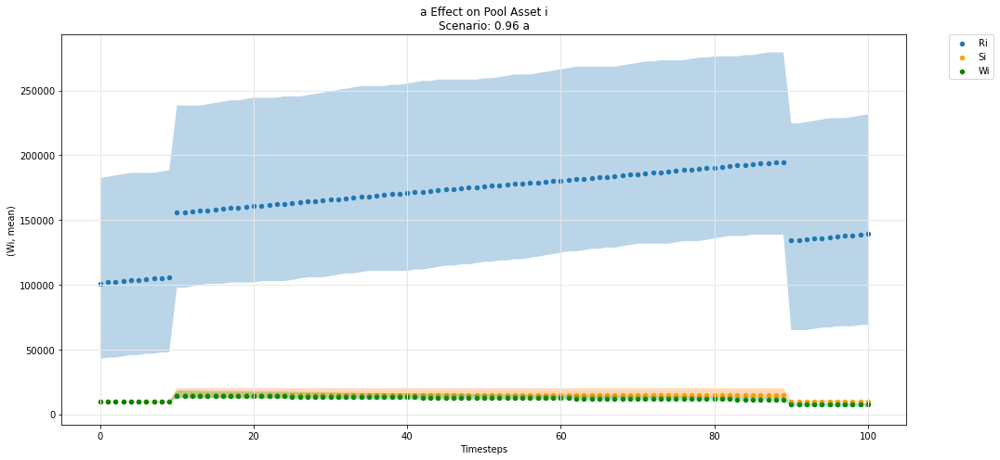

...

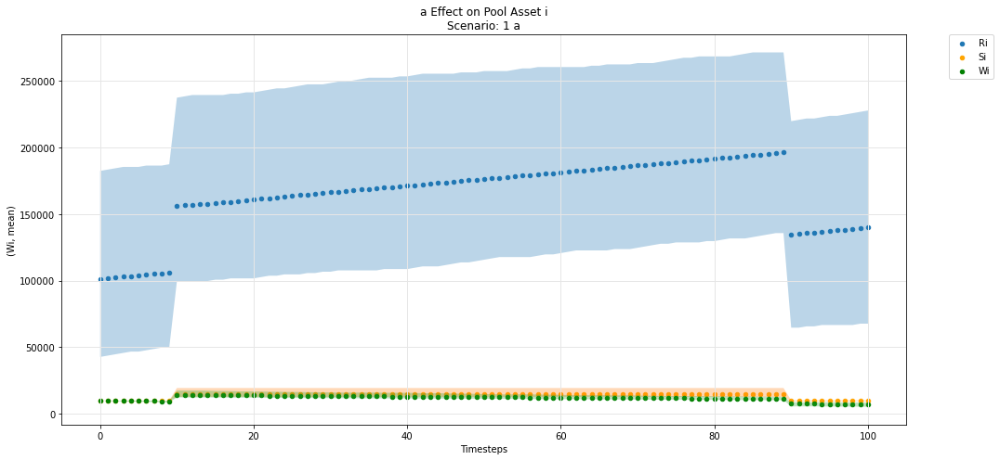

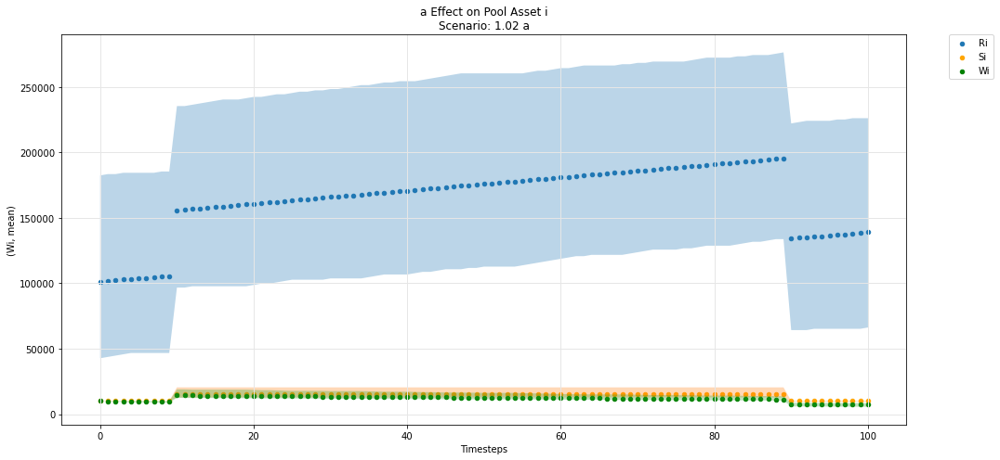

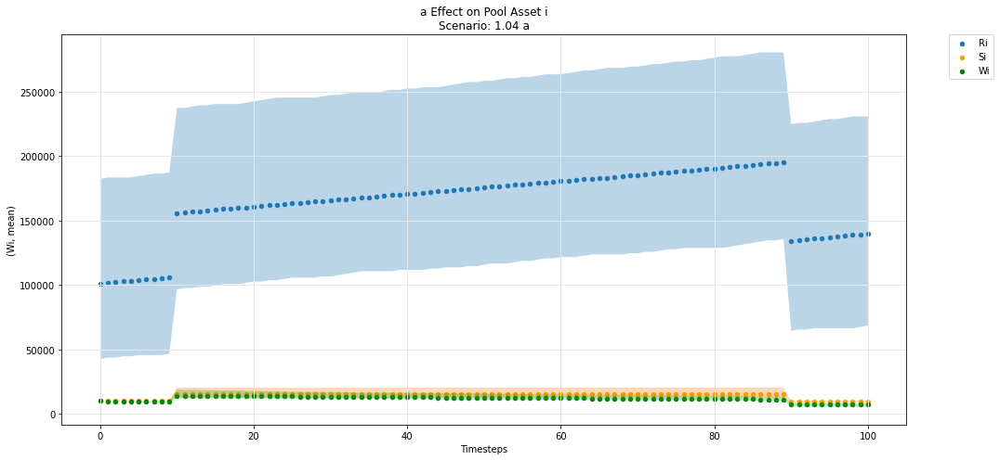

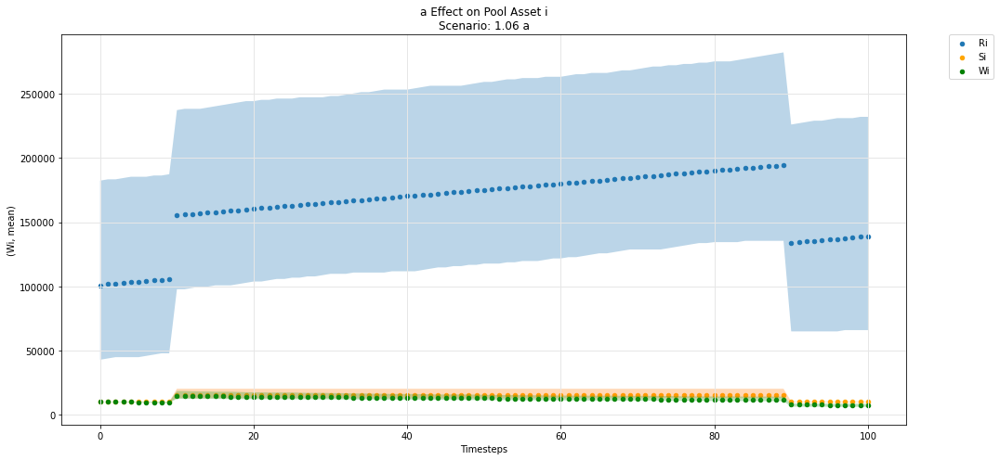

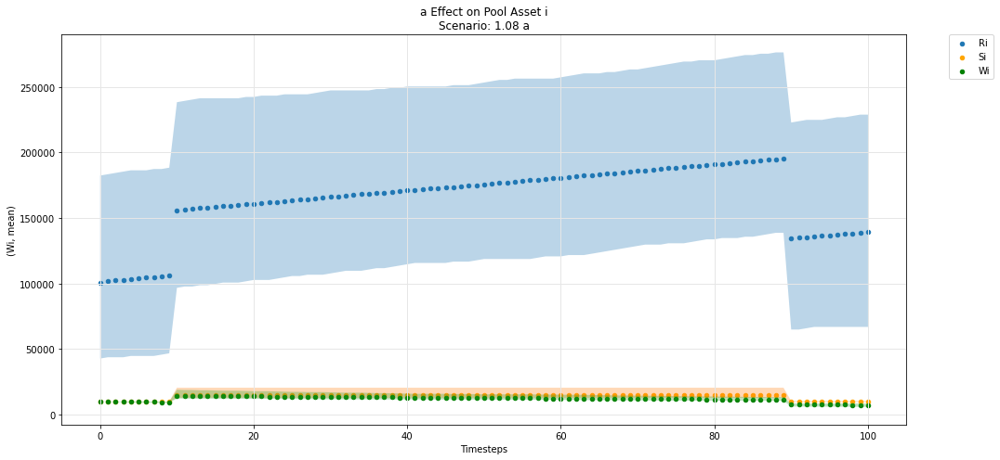

In [59]:
param_pool_simulation_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

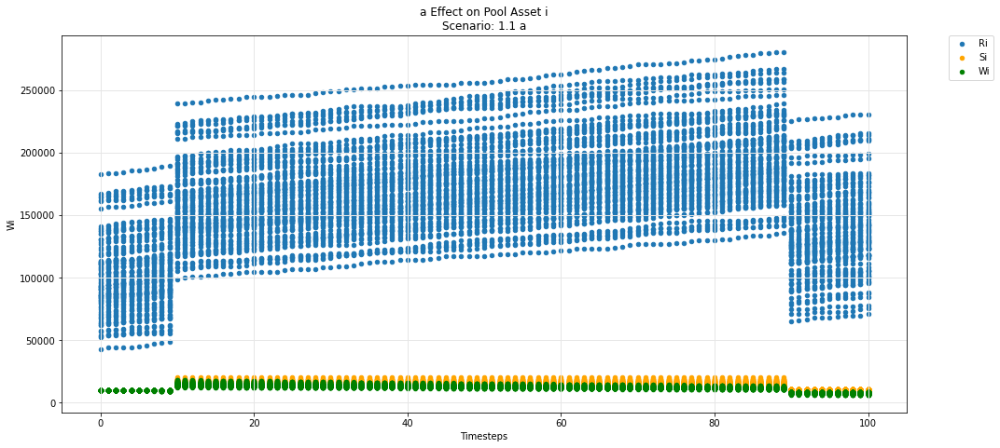

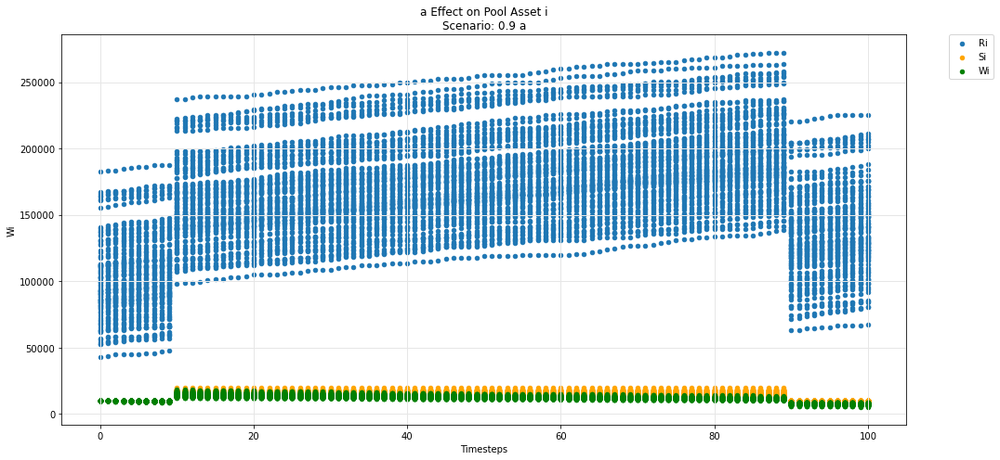

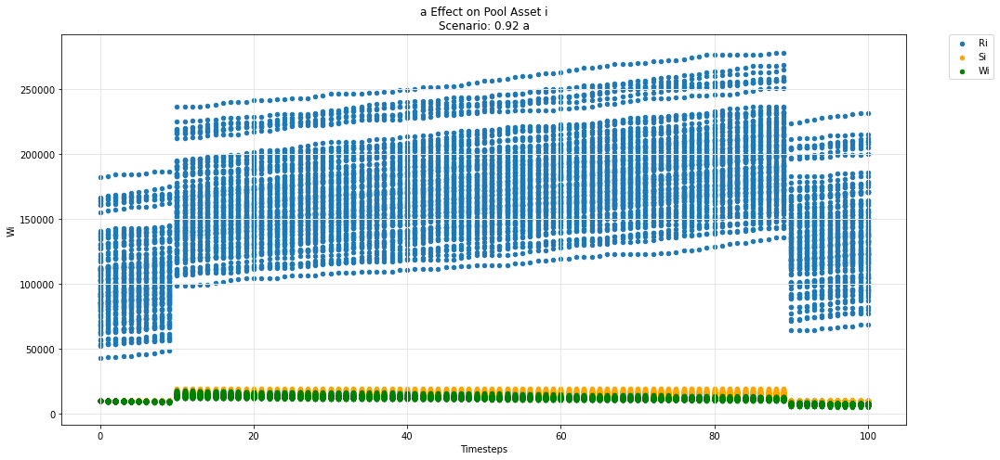

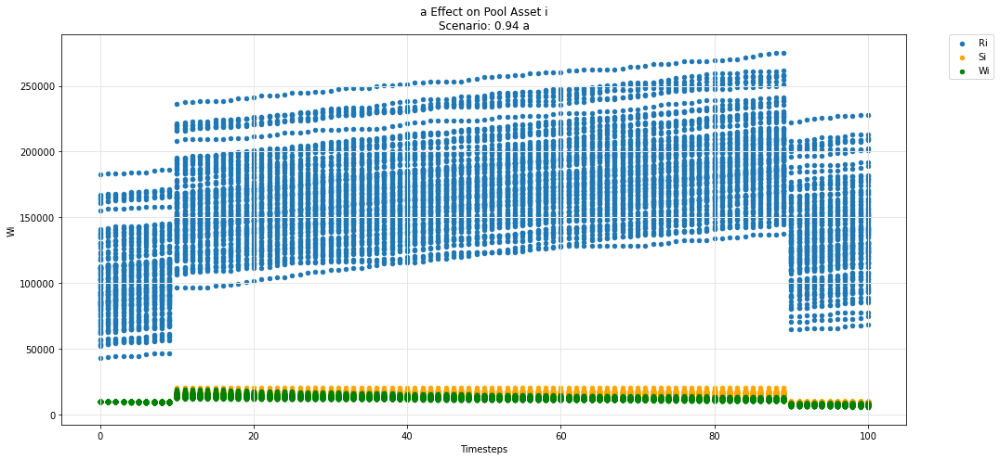

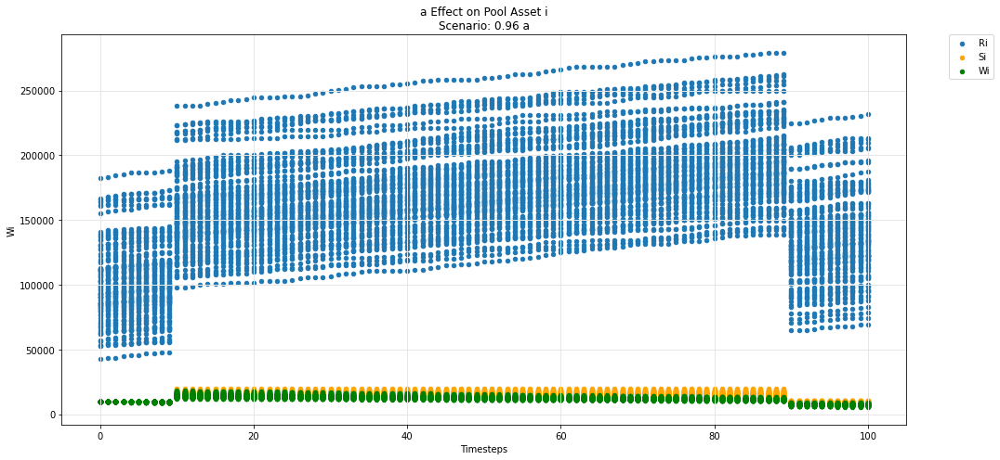

...

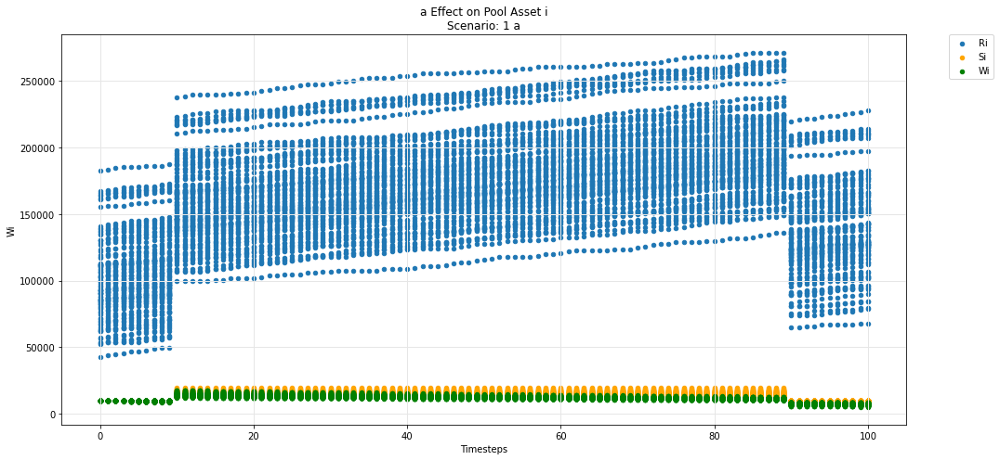

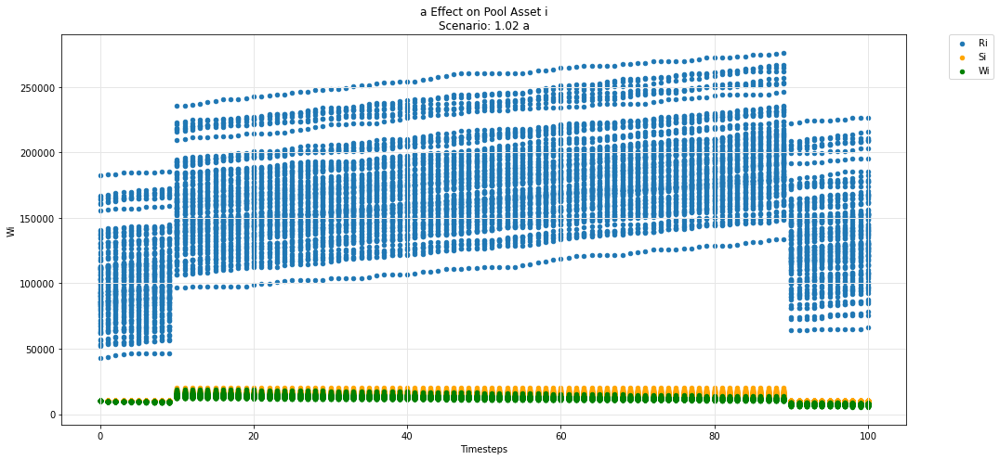

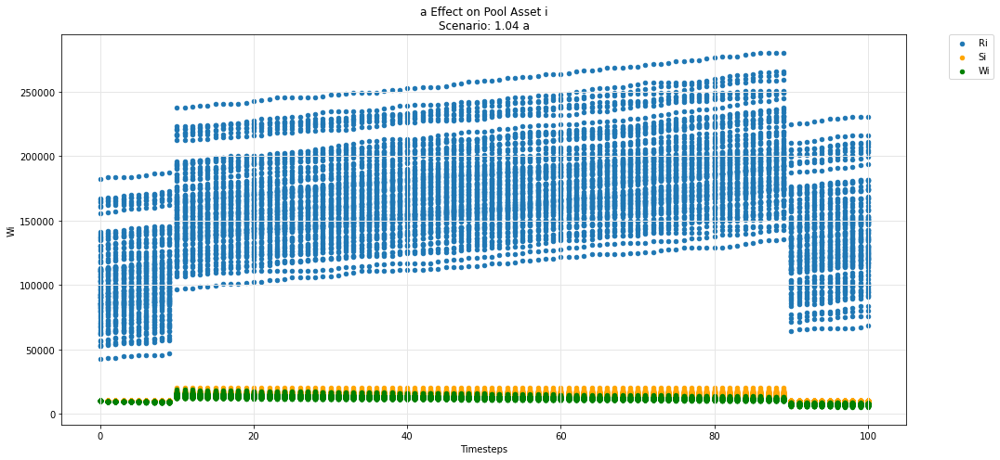

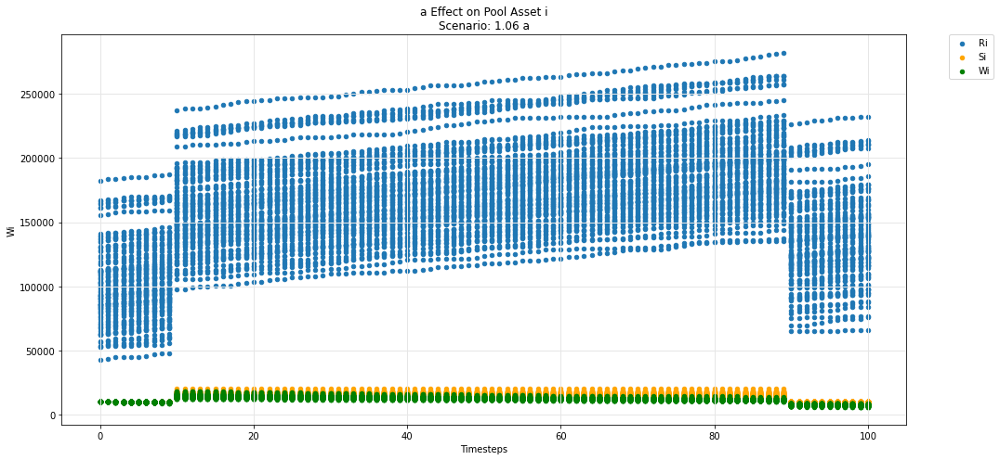

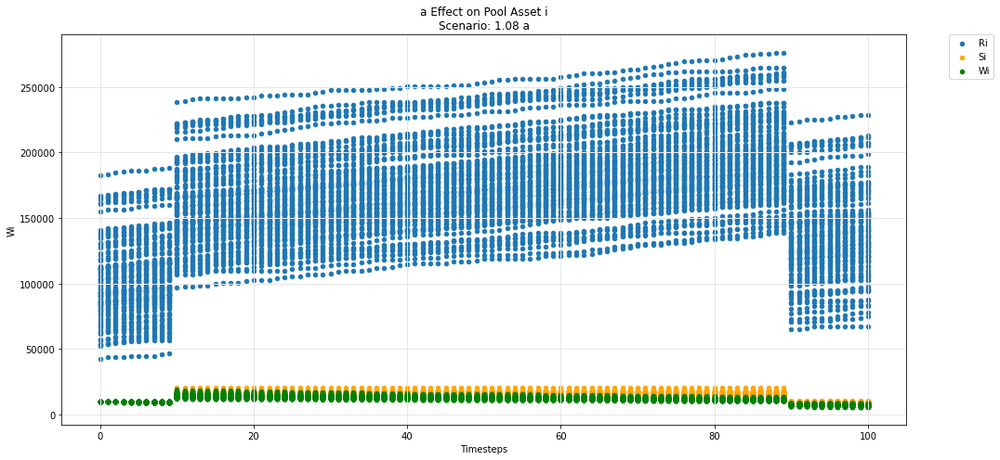

In [60]:
param_pool_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

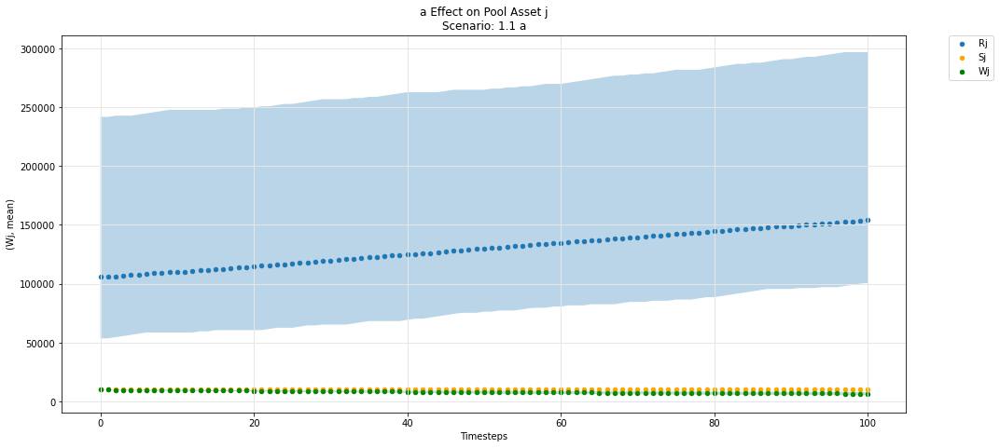

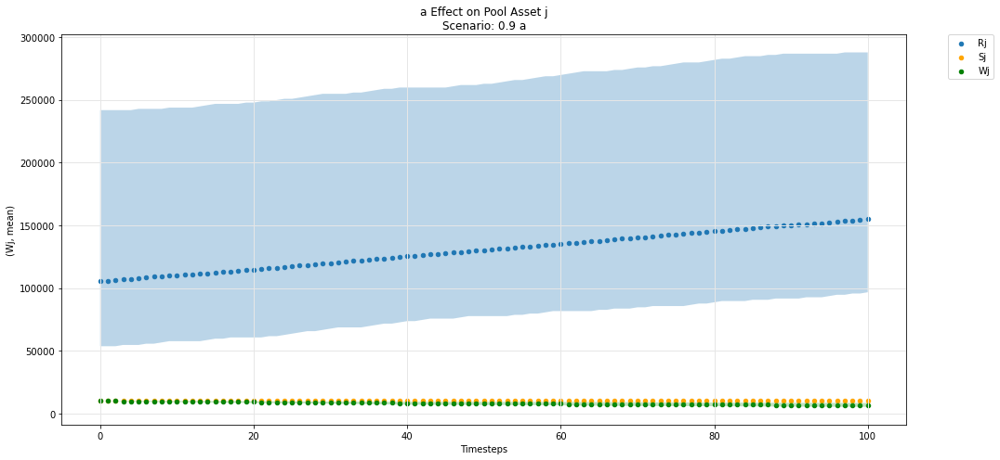

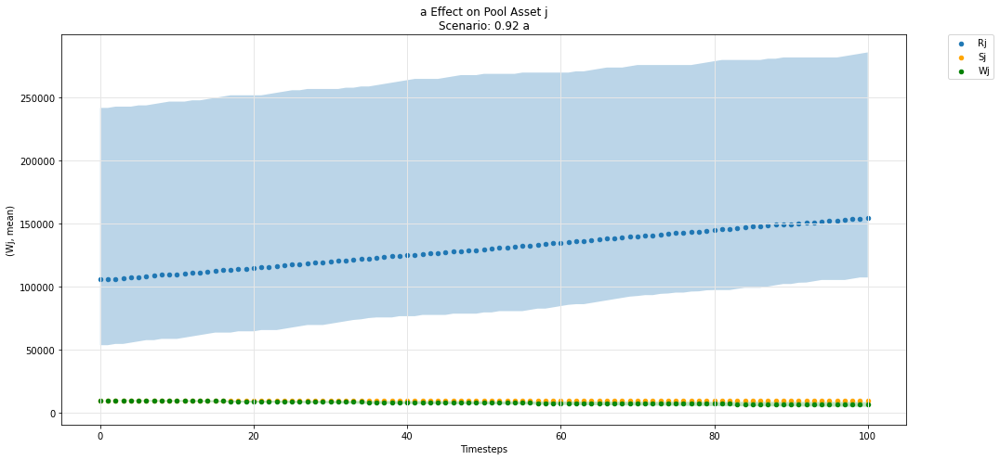

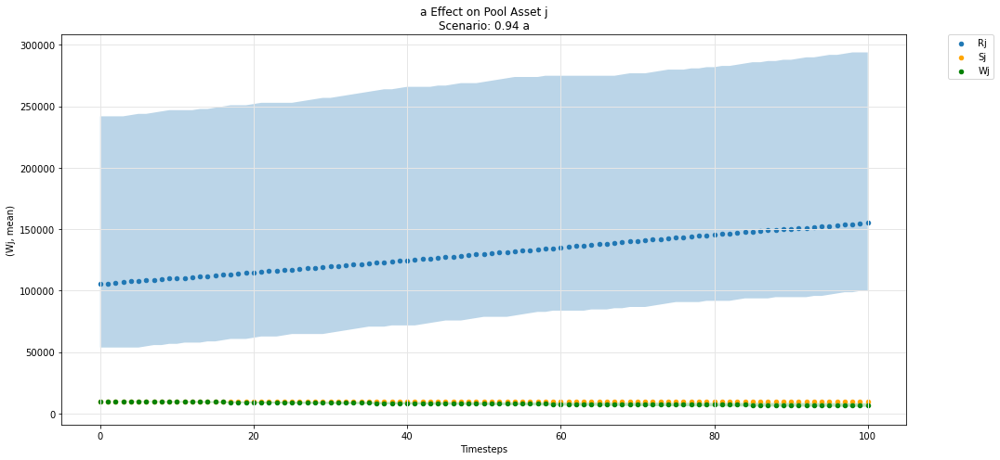

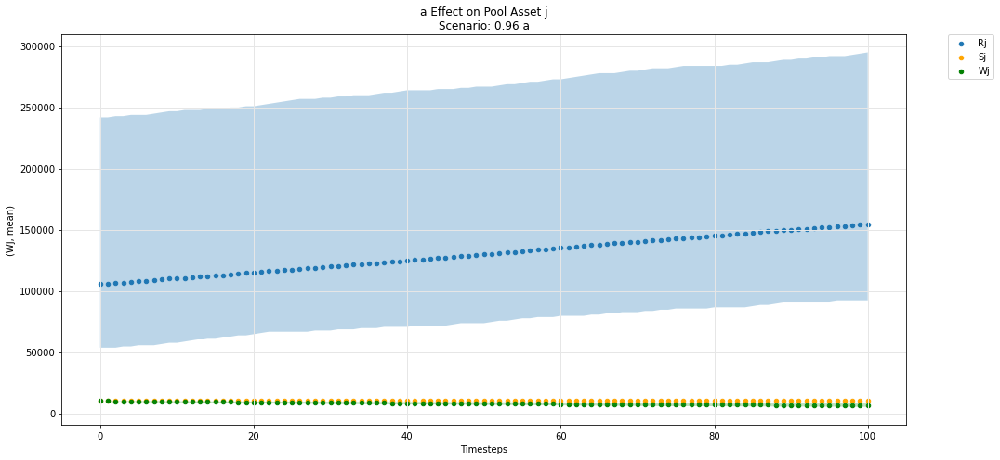

...

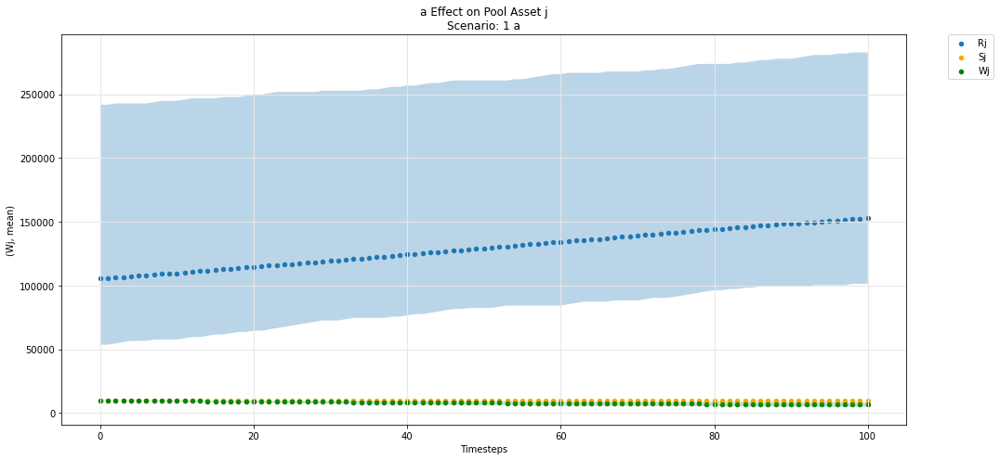

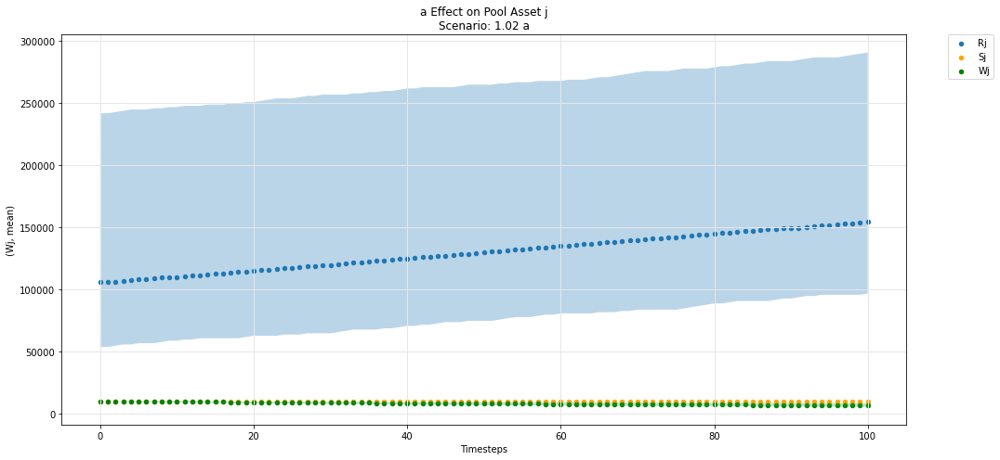

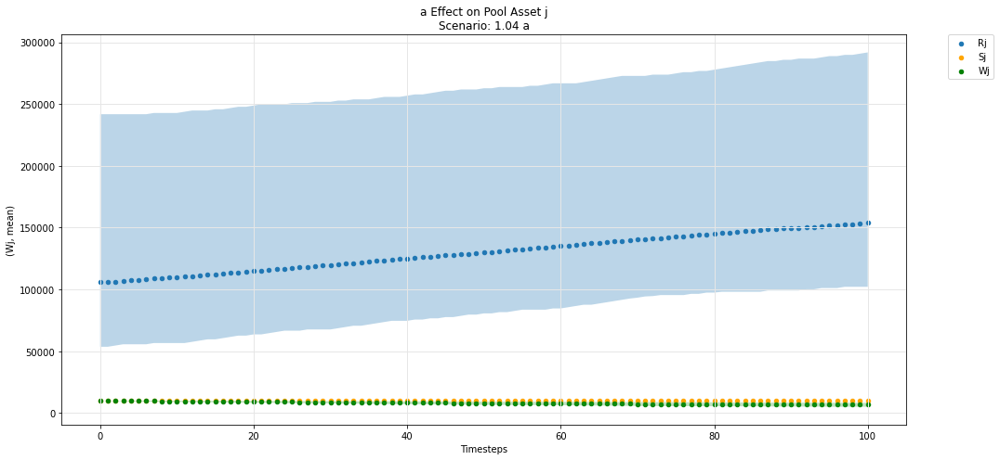

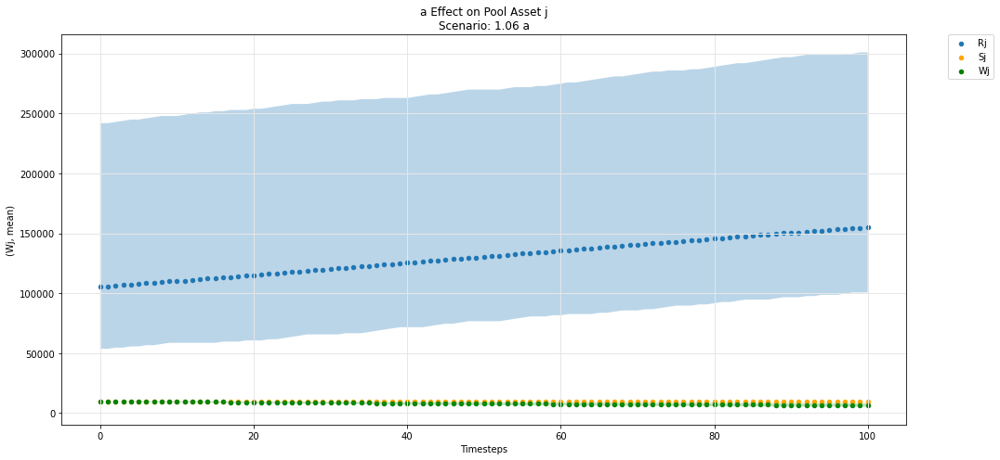

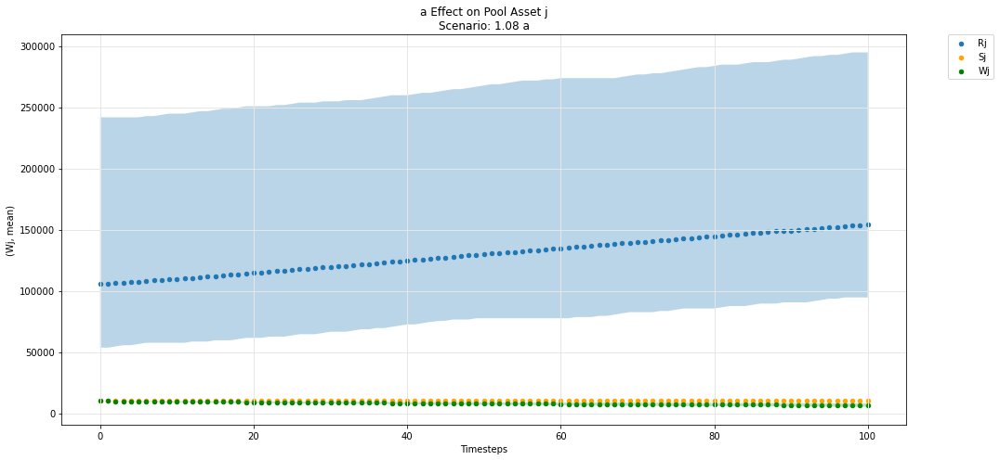

In [61]:
param_pool_simulation_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

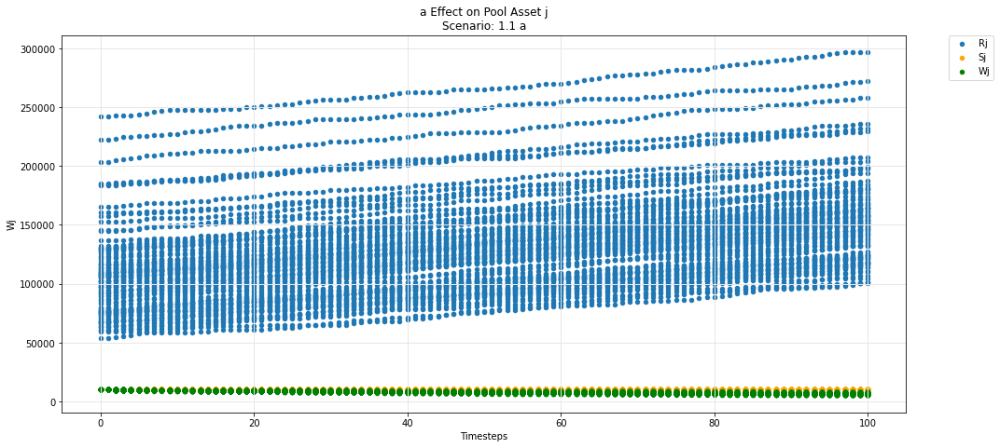

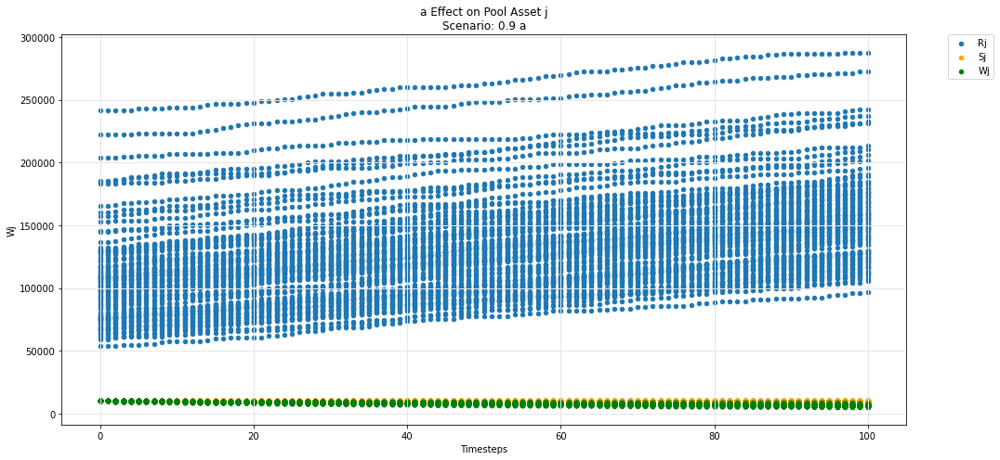

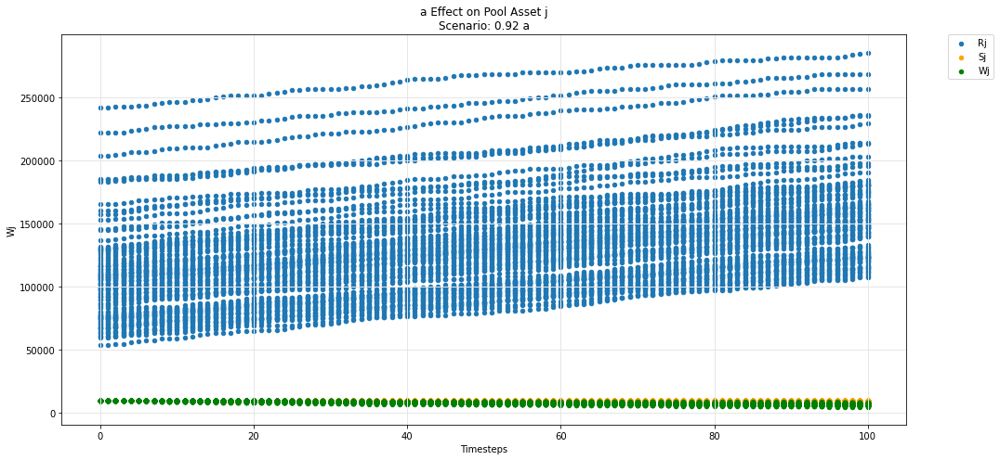

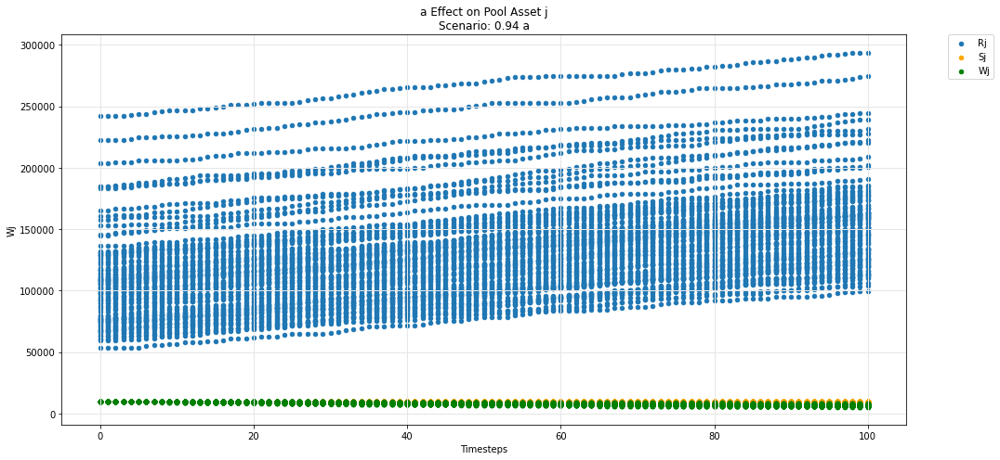

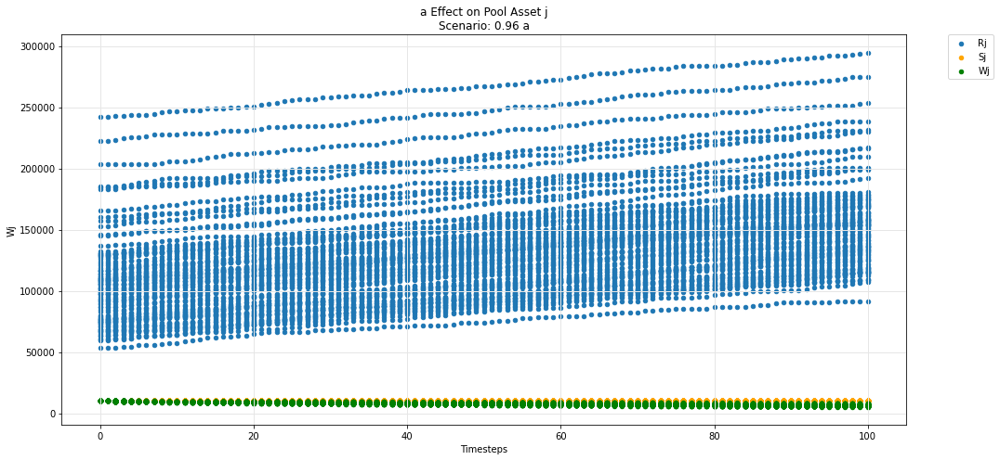

...

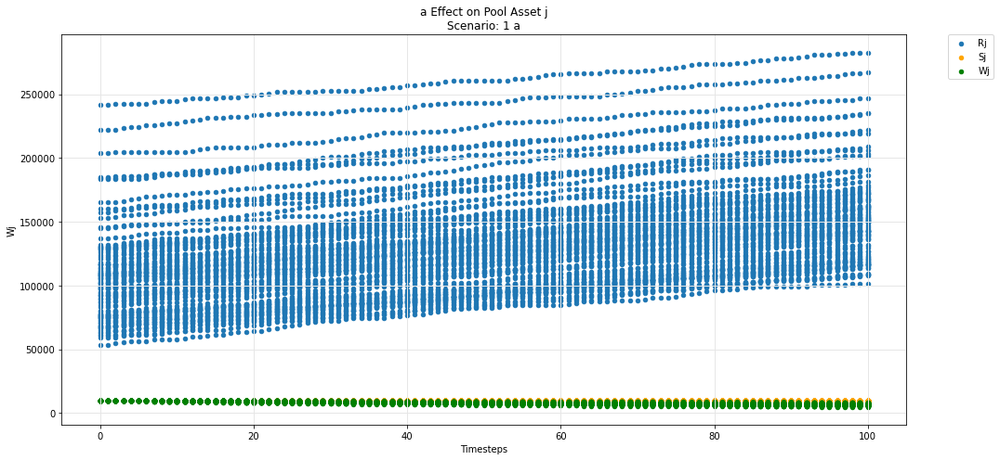

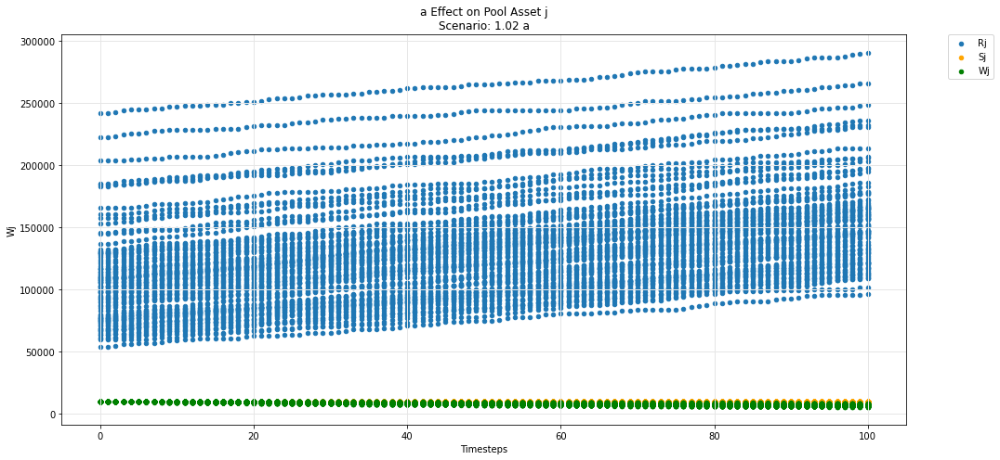

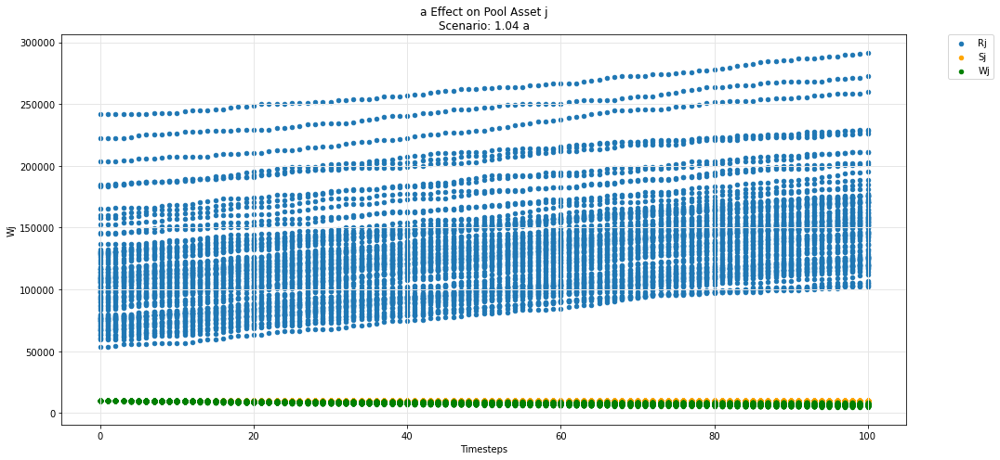

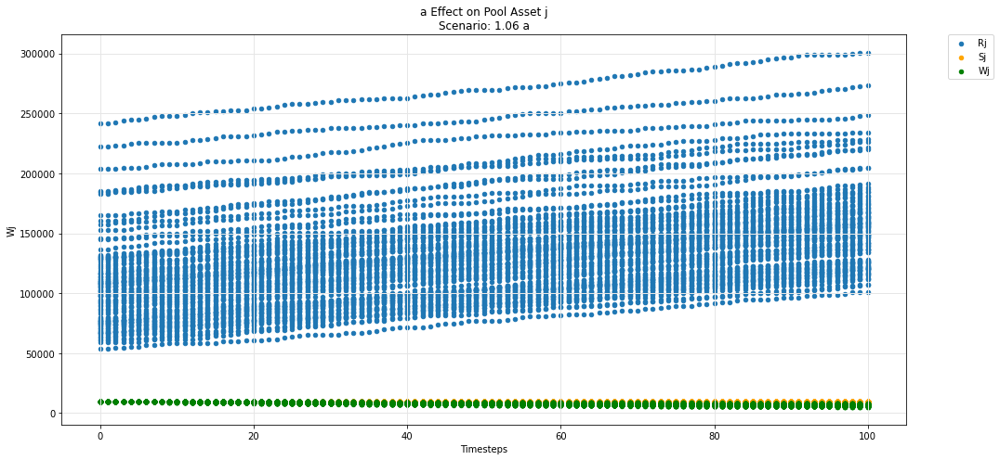

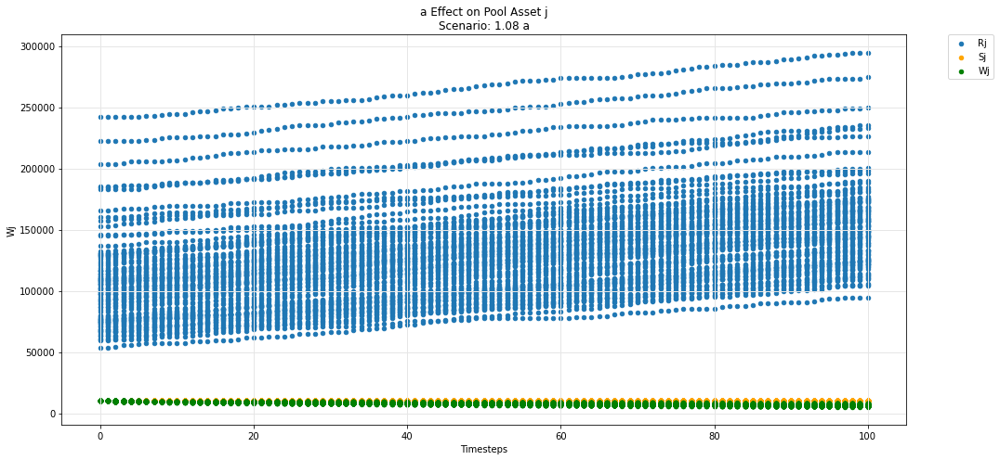

In [62]:
param_pool_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

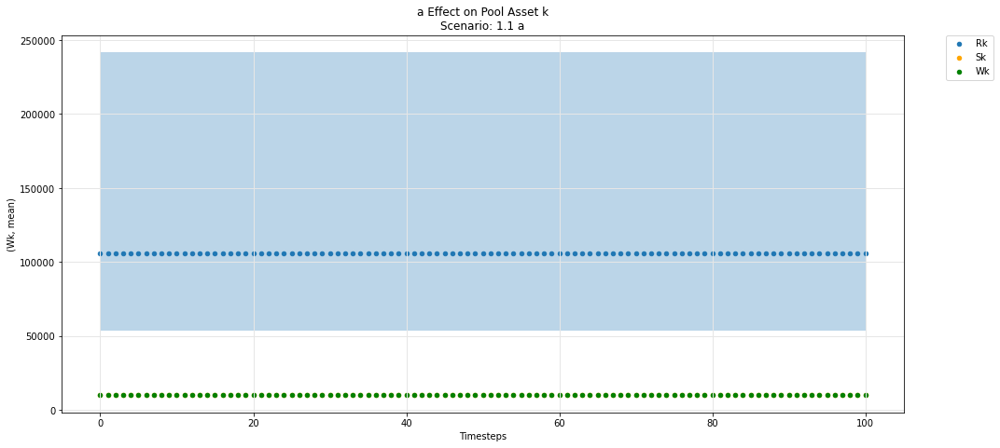

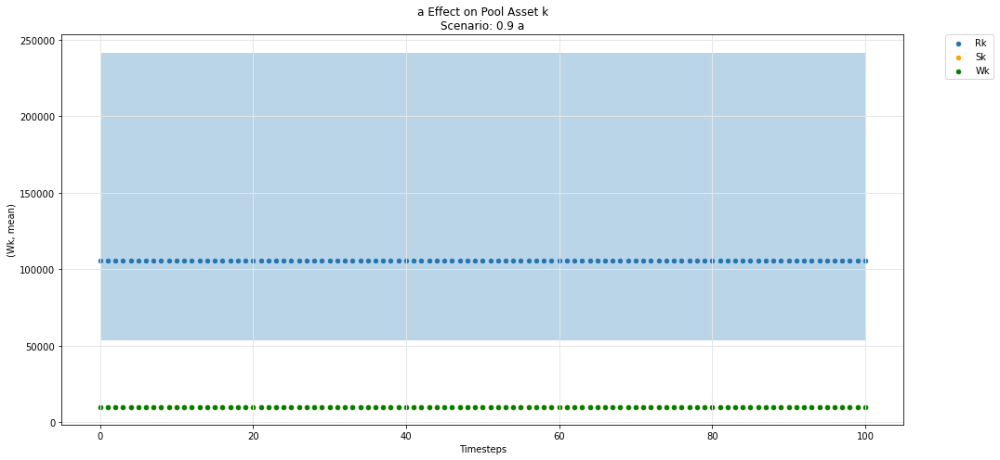

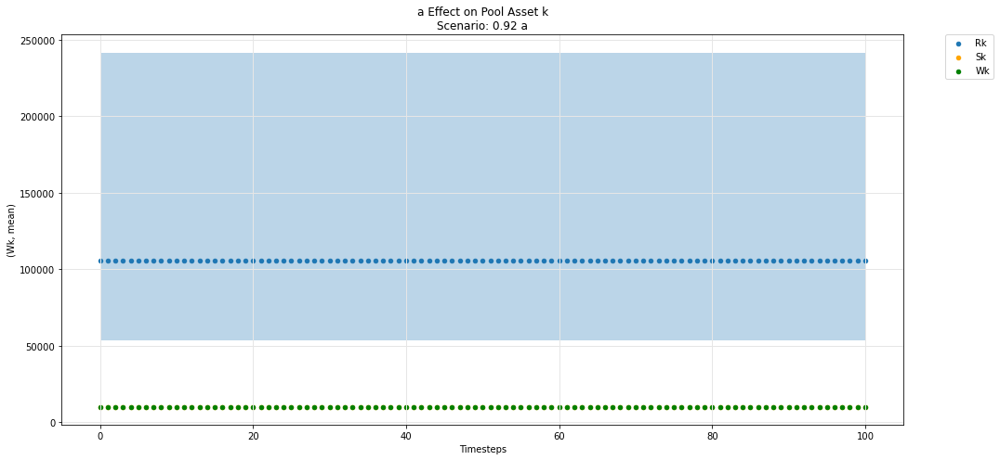

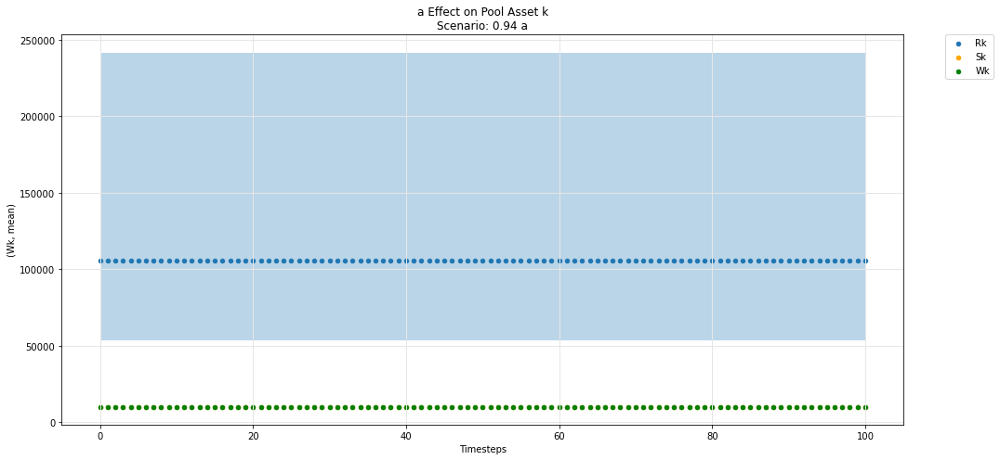

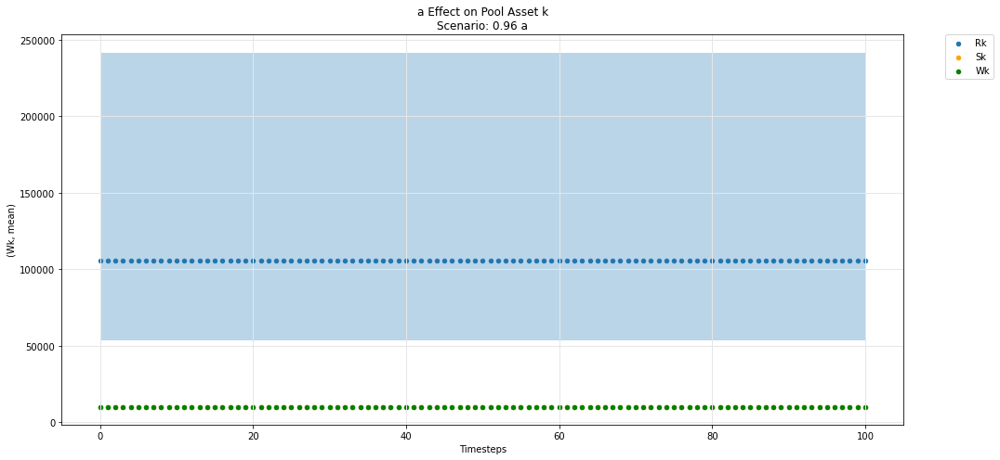

...

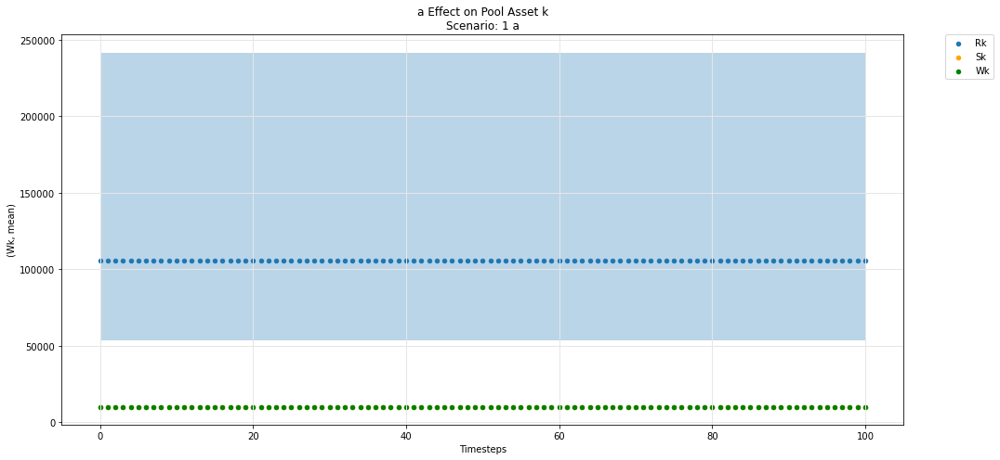

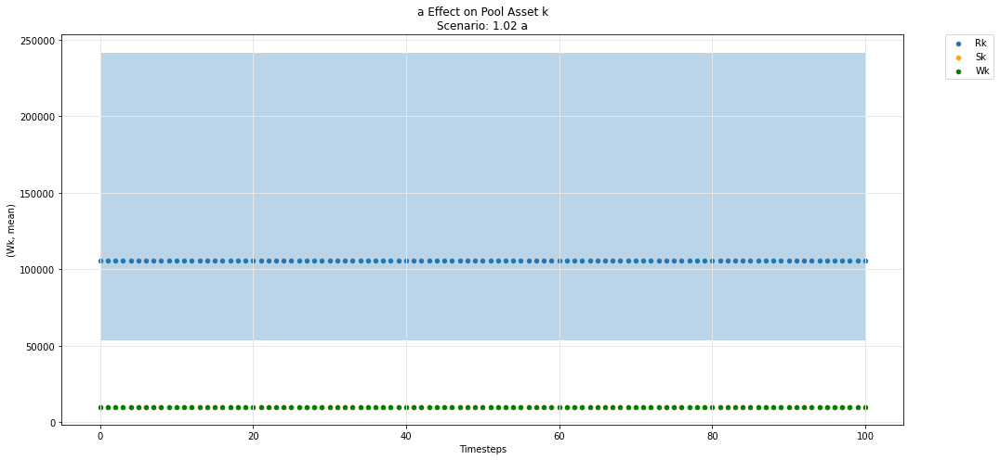

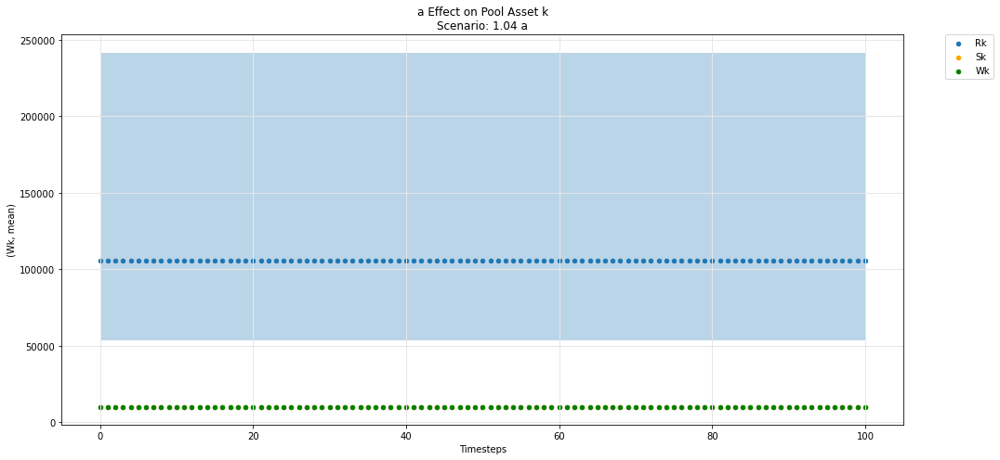

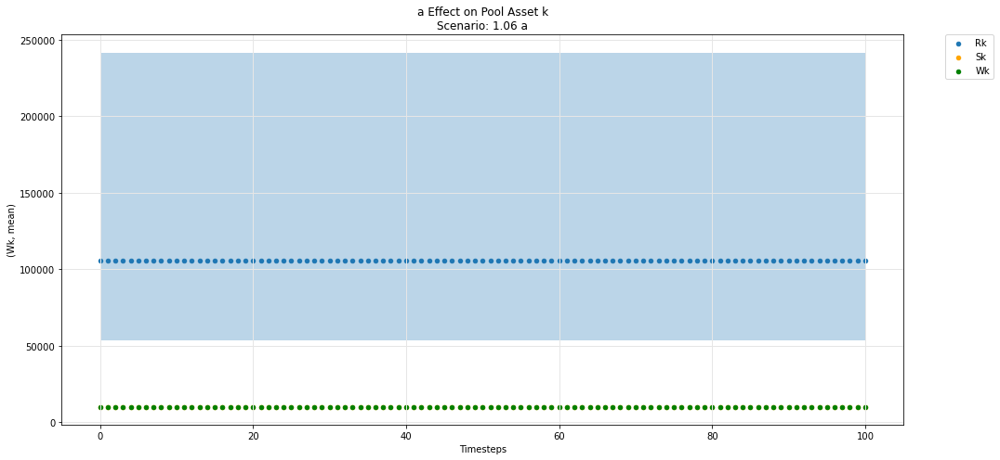

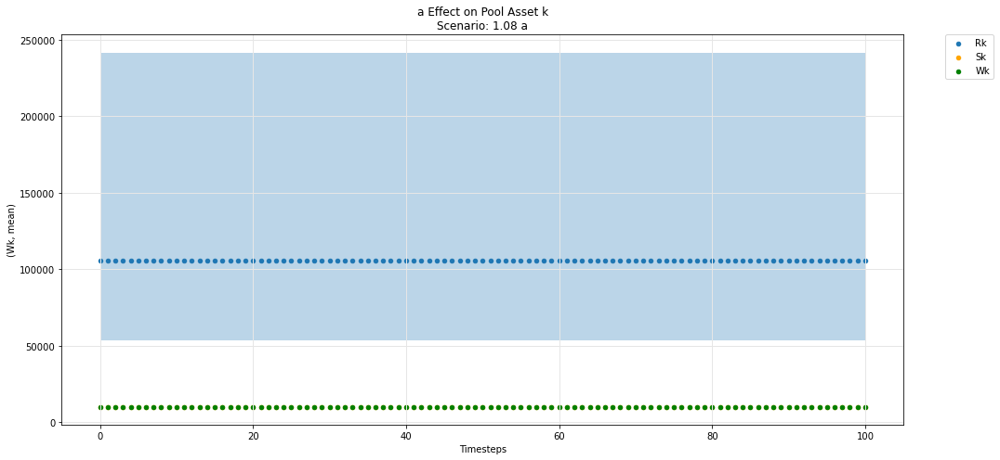

In [63]:
param_pool_simulation_plot(experiments, config_ids, 'a','k', 'R', 'S', 'W')

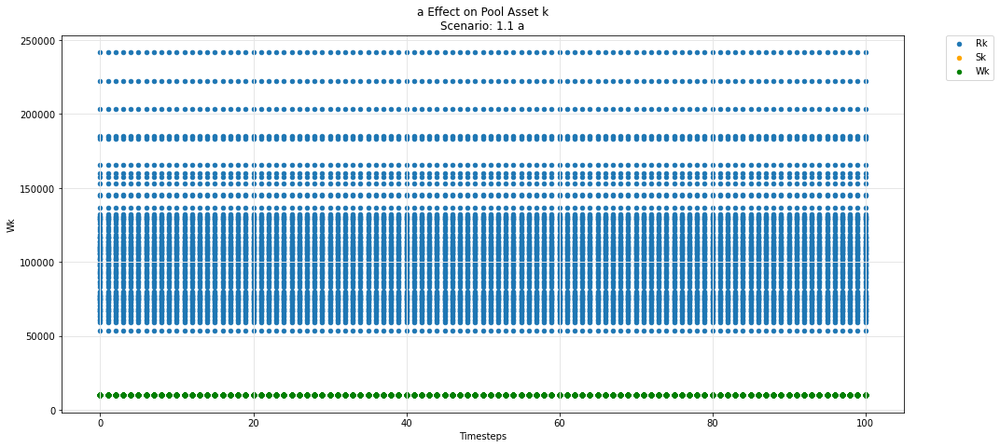

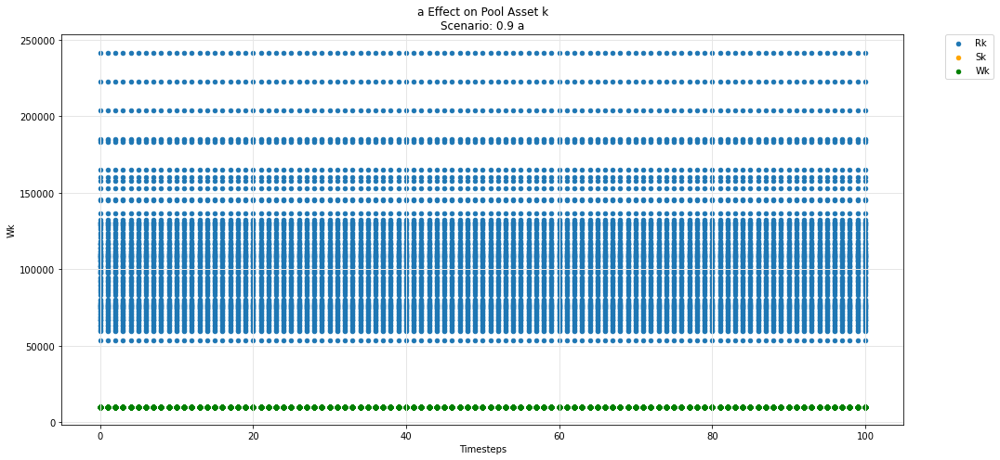

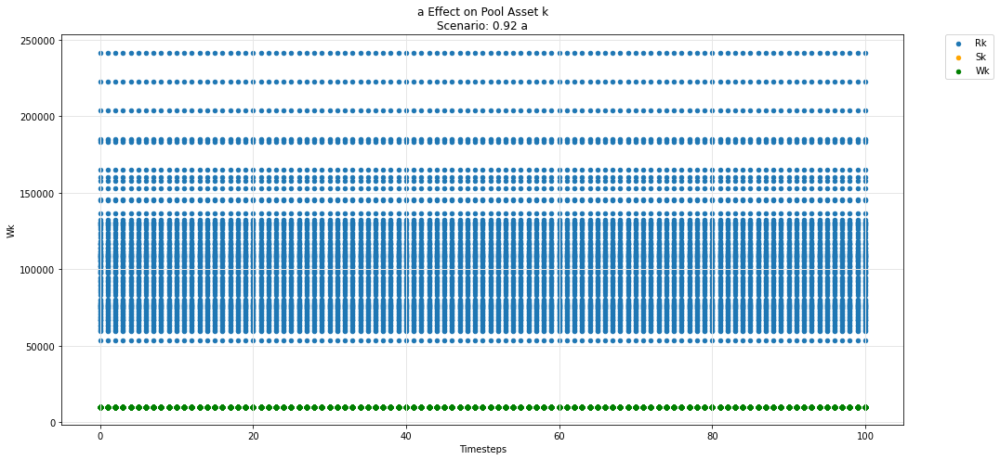

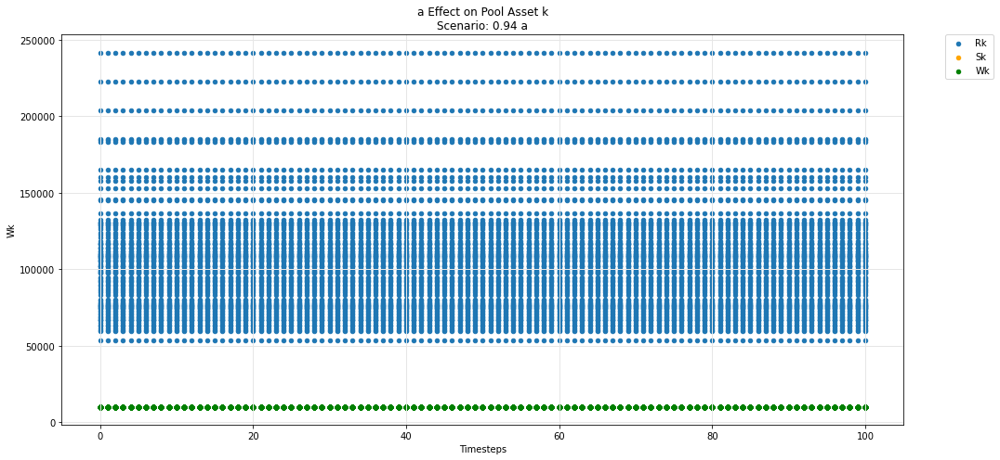

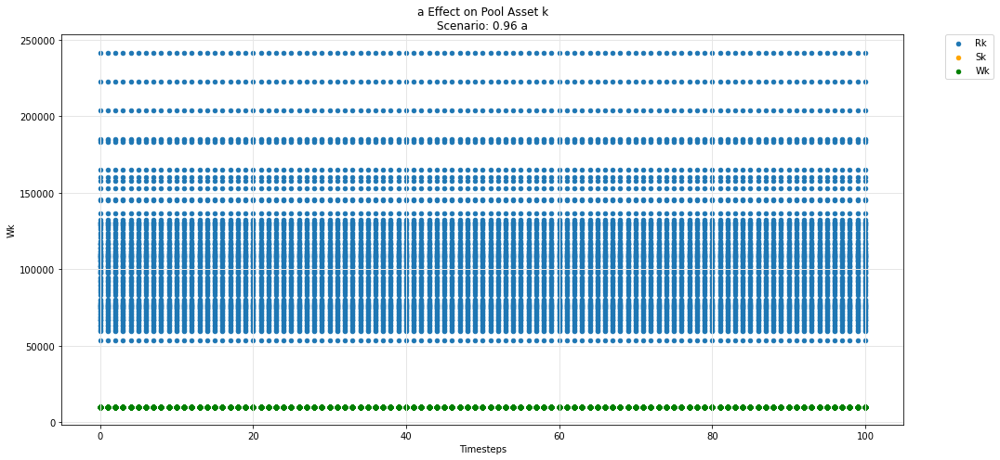

...

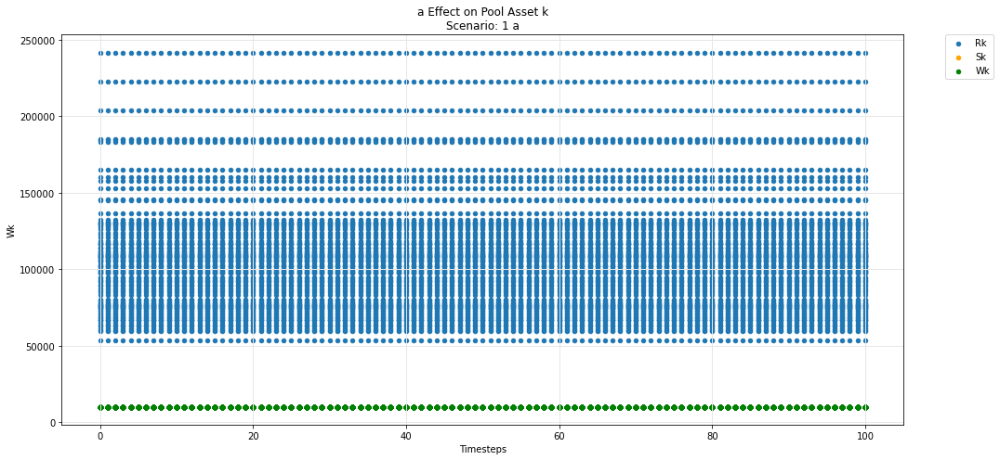

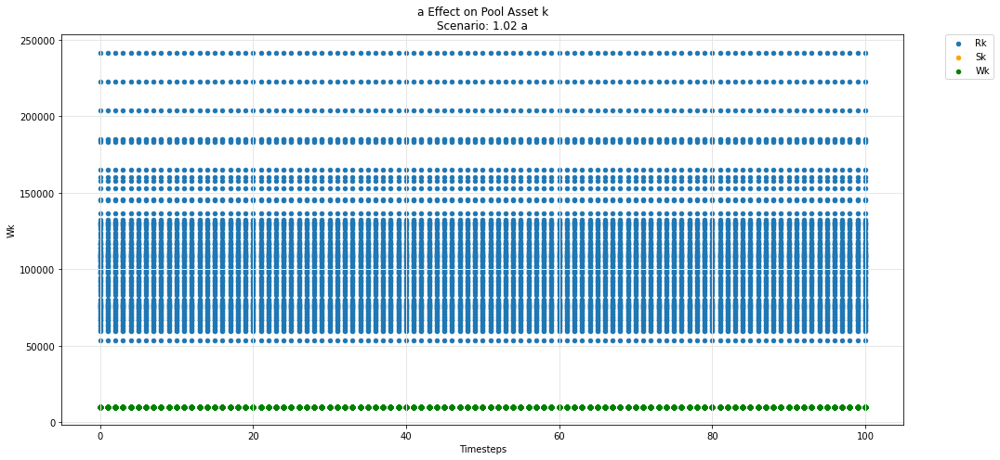

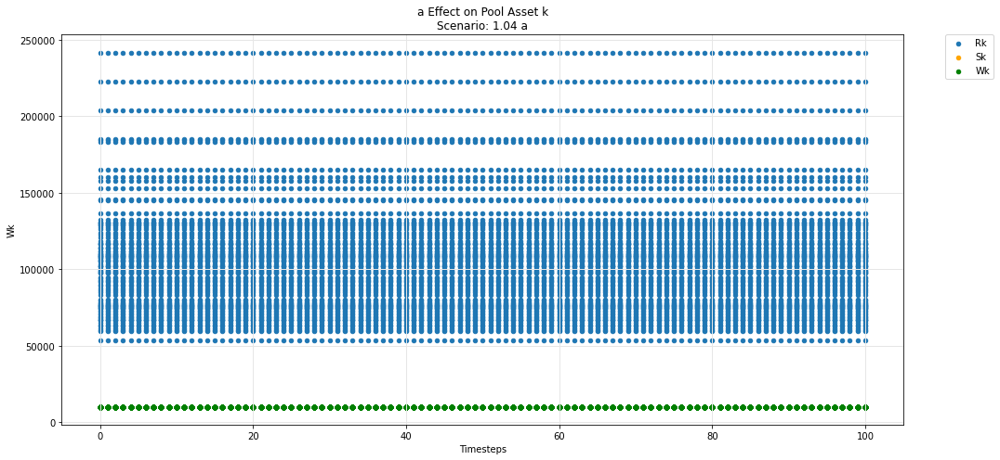

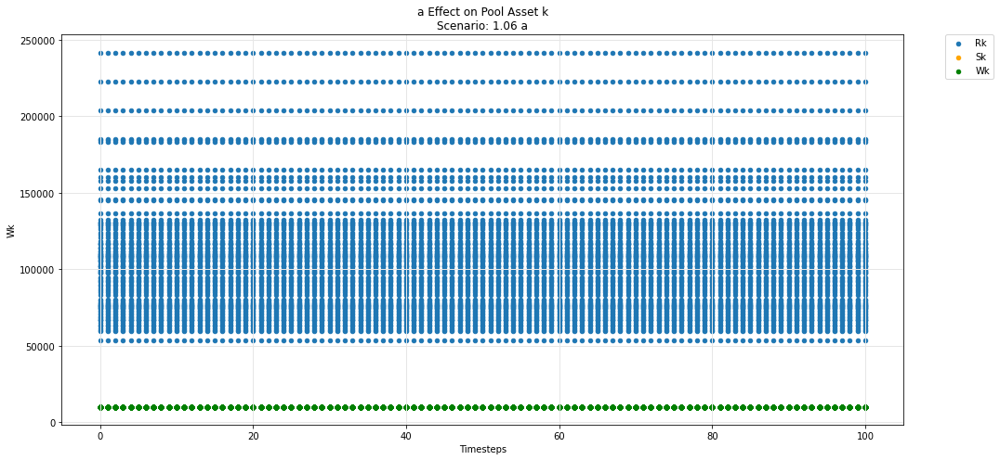

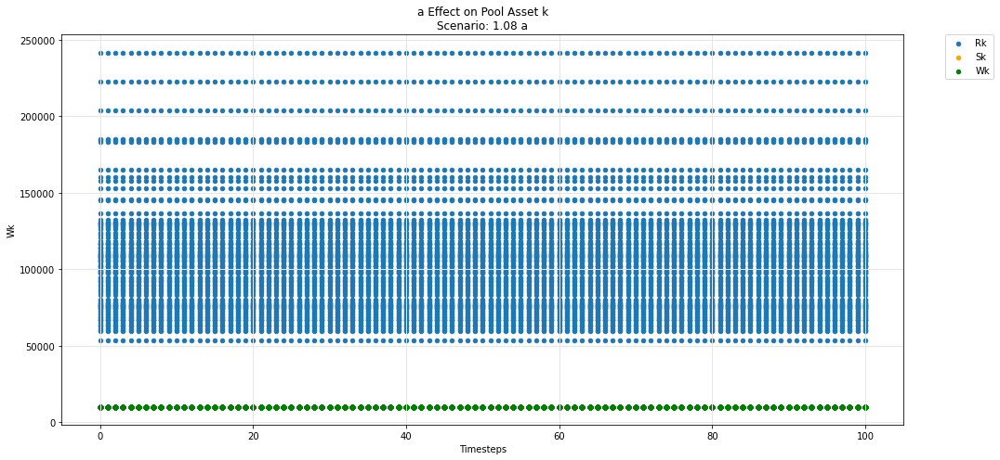

In [64]:
param_pool_plot(experiments, config_ids, 'a','k', 'R', 'S', 'W')

In [65]:
def param_pool_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=df_label, label=df_label, ax=ax, legend=True, kind ='scatter')

        for count, arg in enumerate(args):
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))

            df.plot(x='timestep', y=df_arg_label, label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

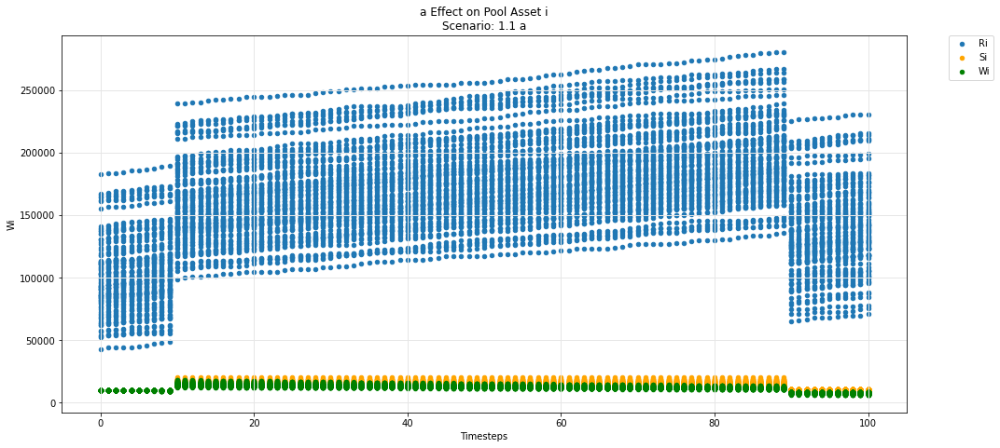

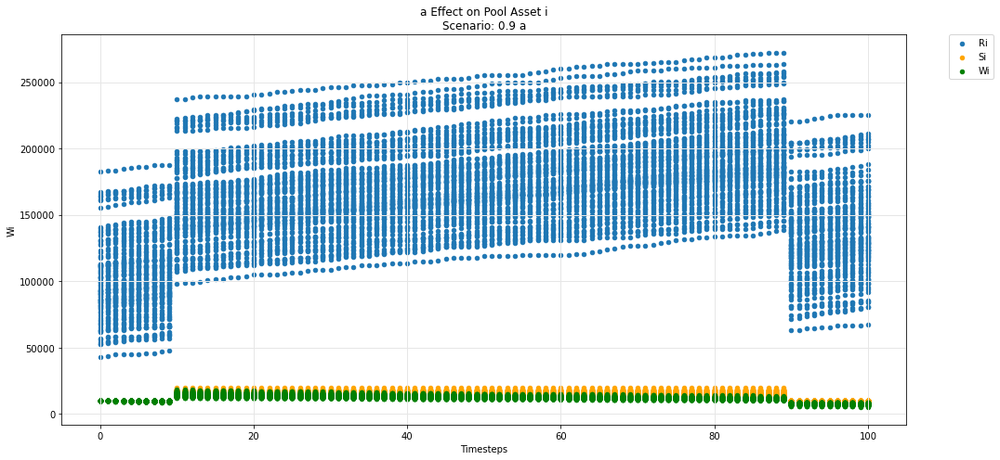

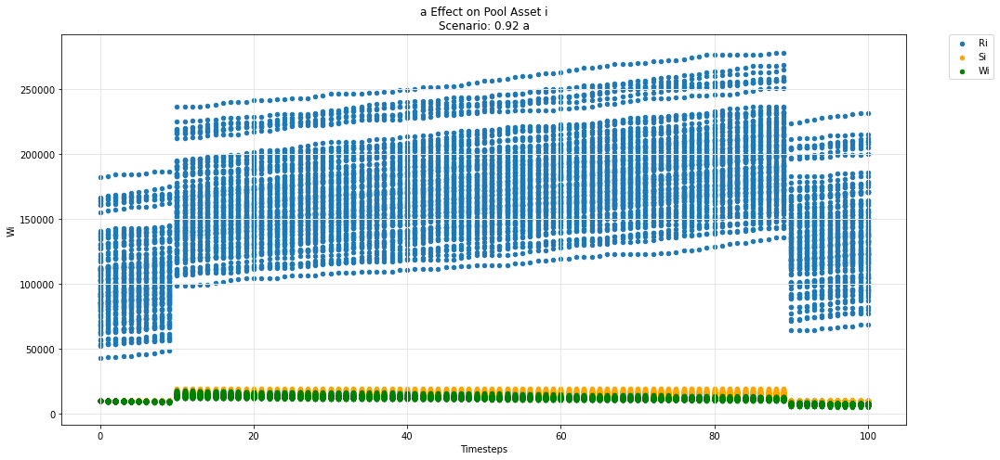

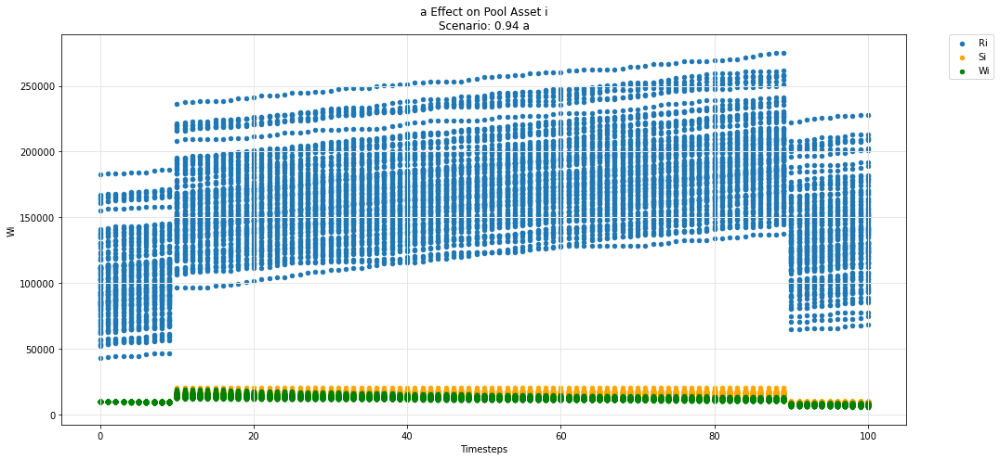

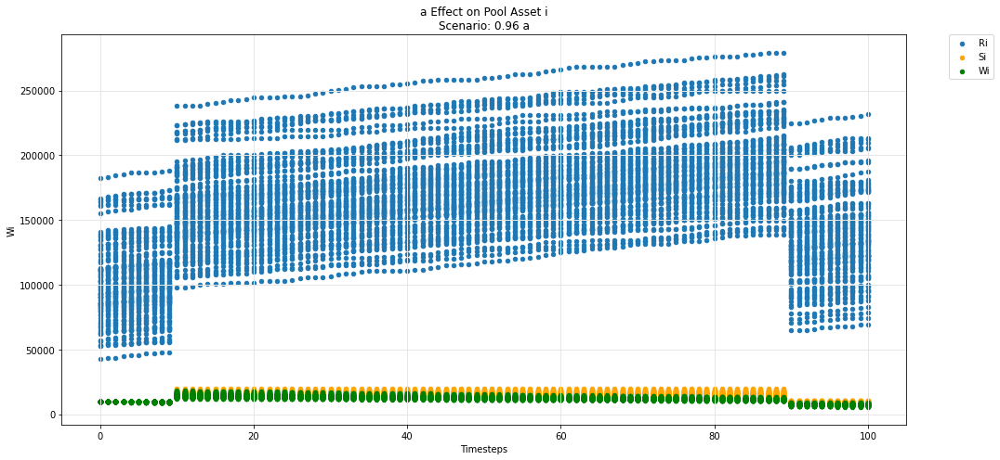

...

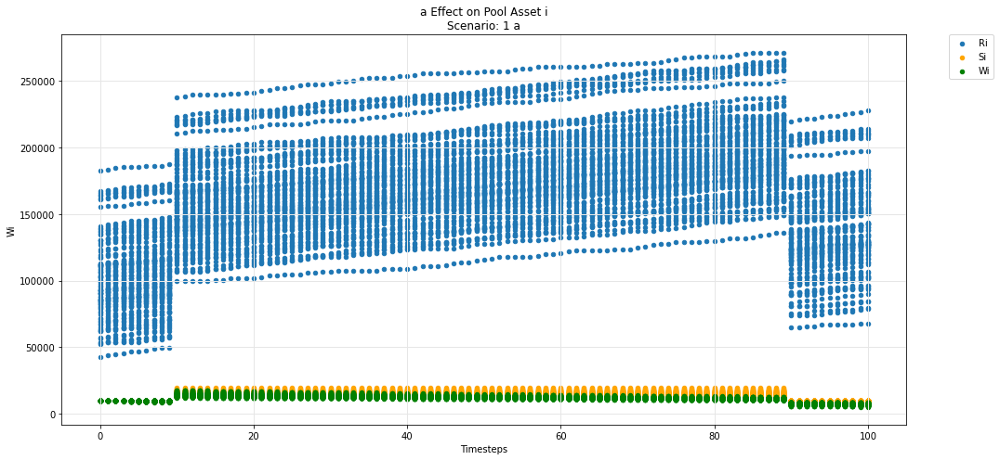

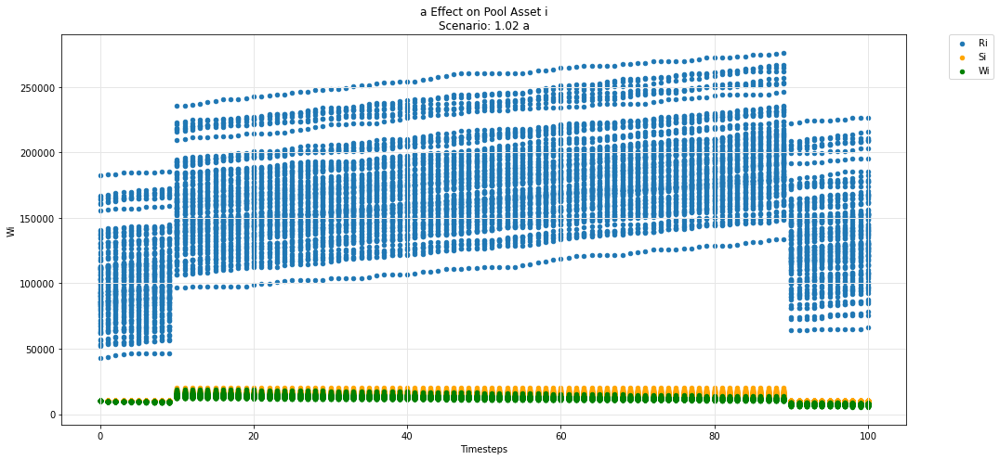

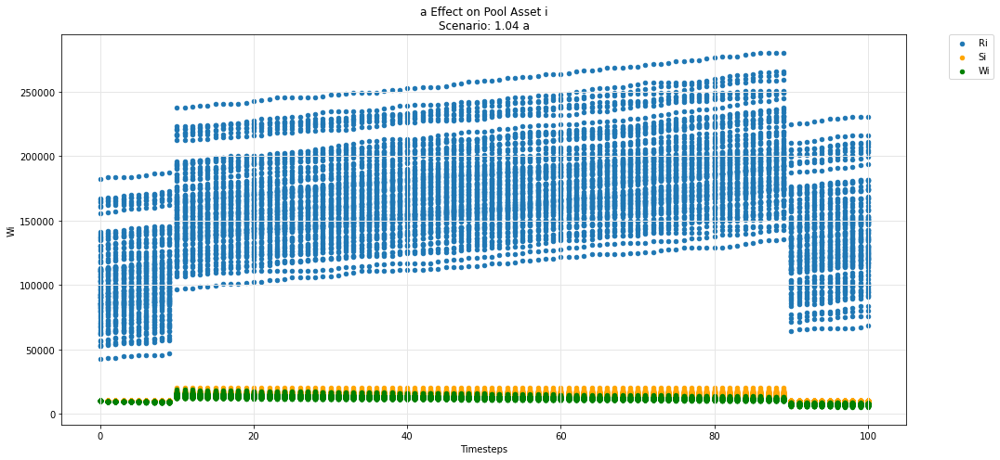

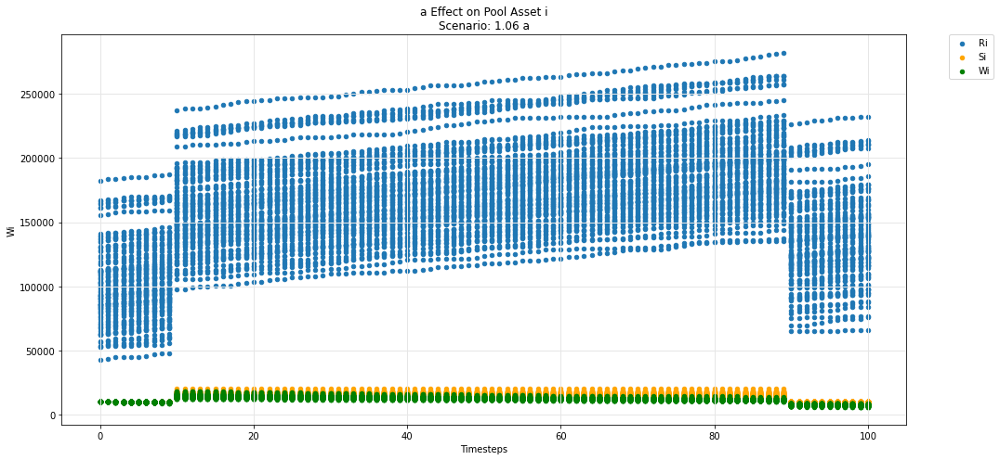

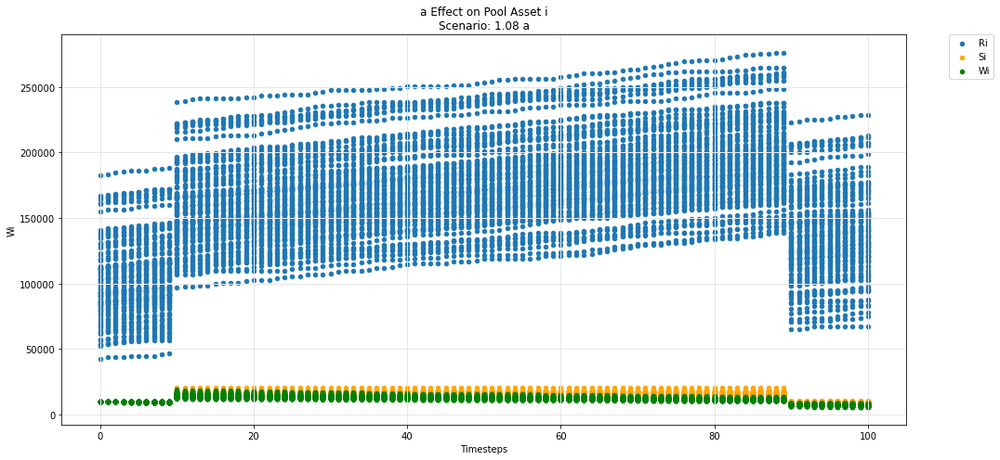

In [66]:
param_pool_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

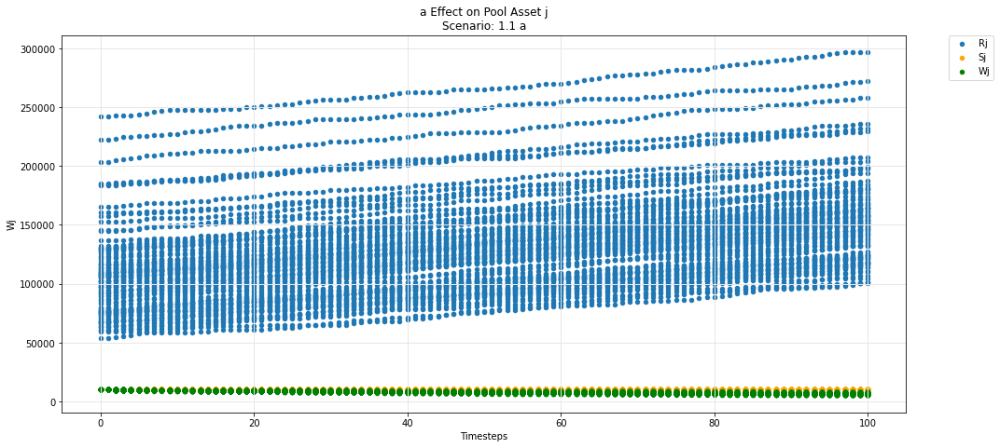

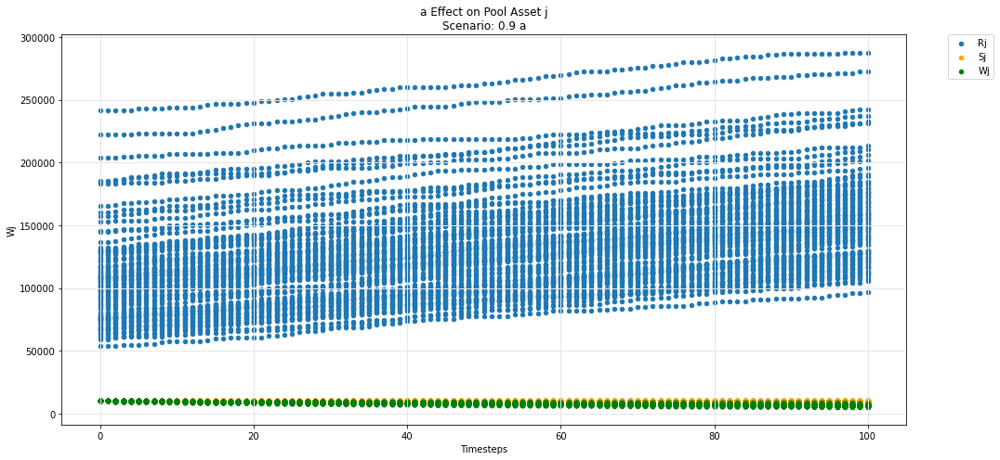

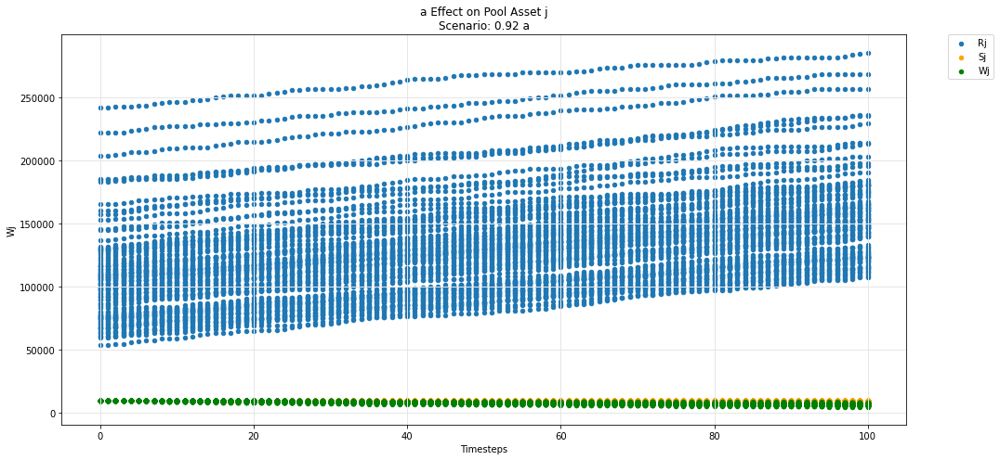

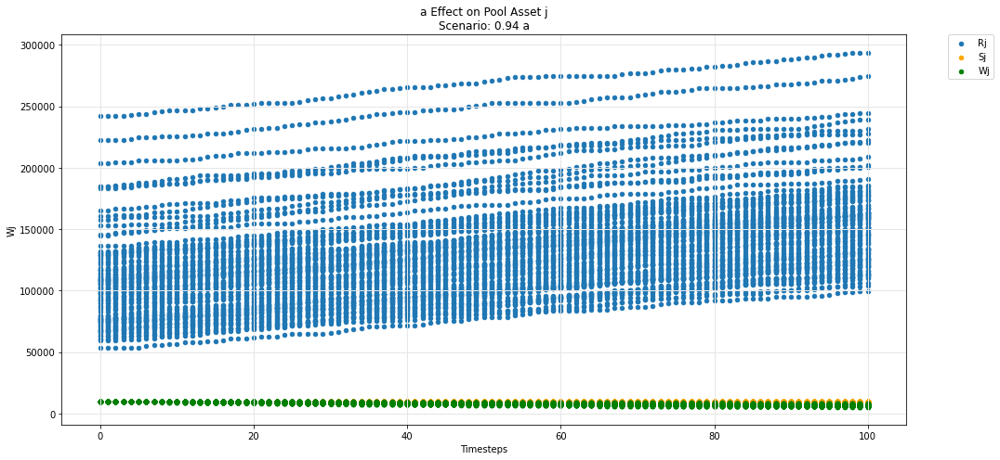

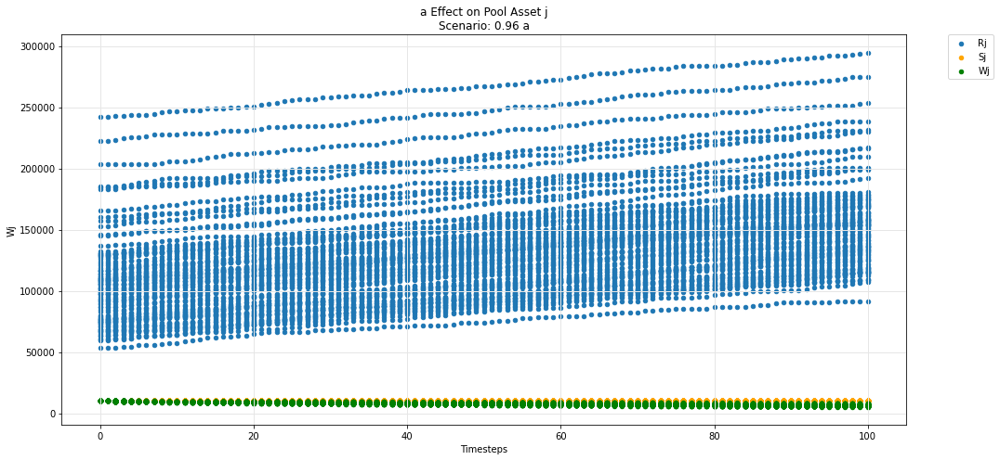

...

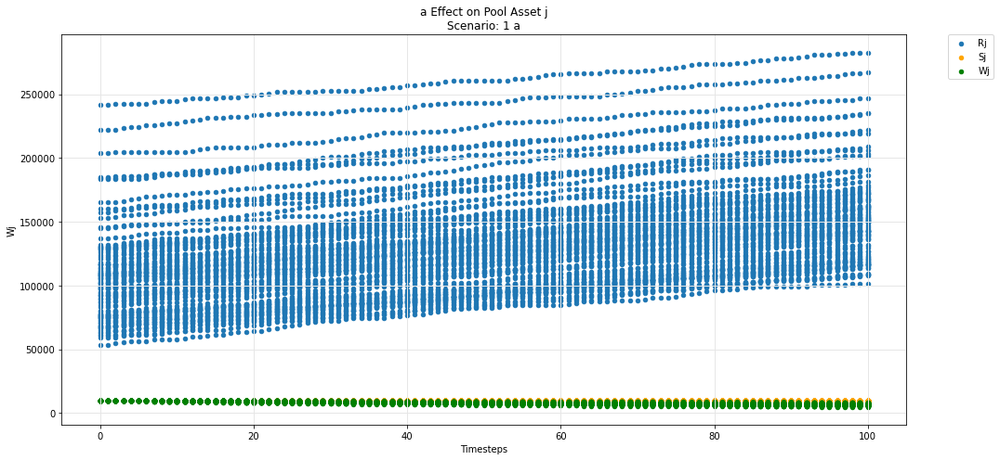

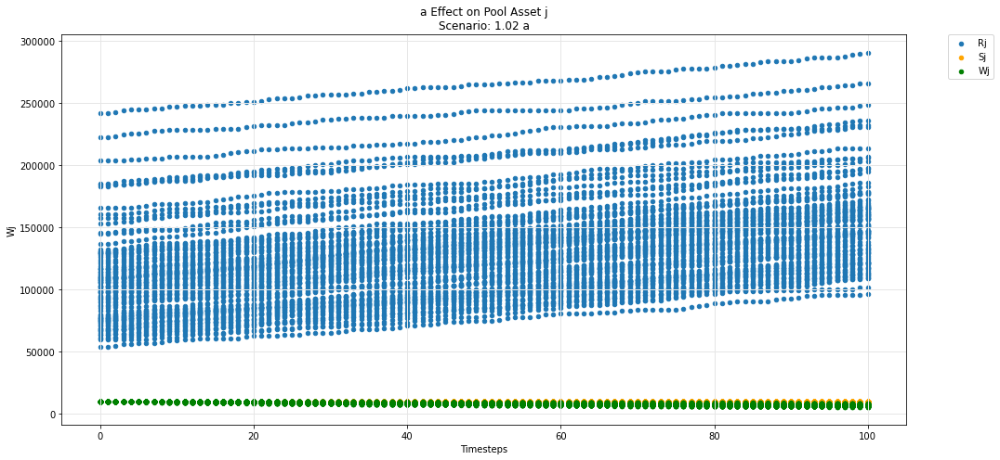

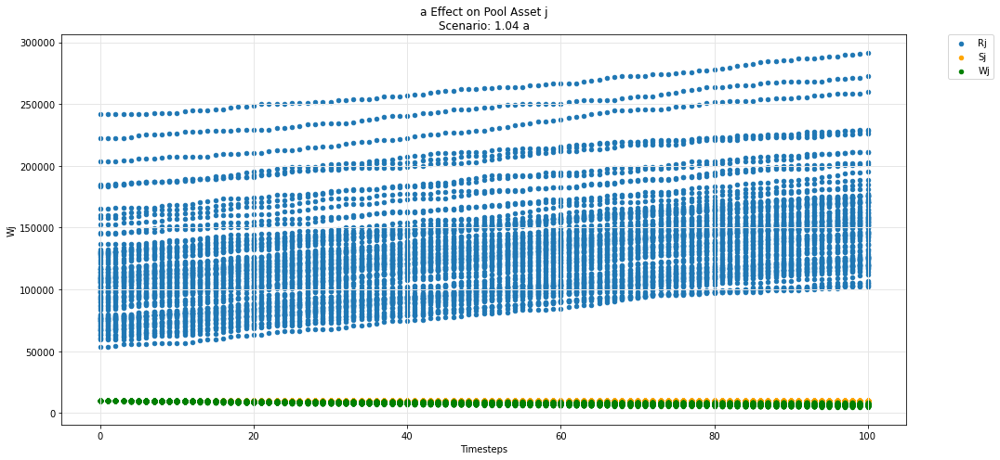

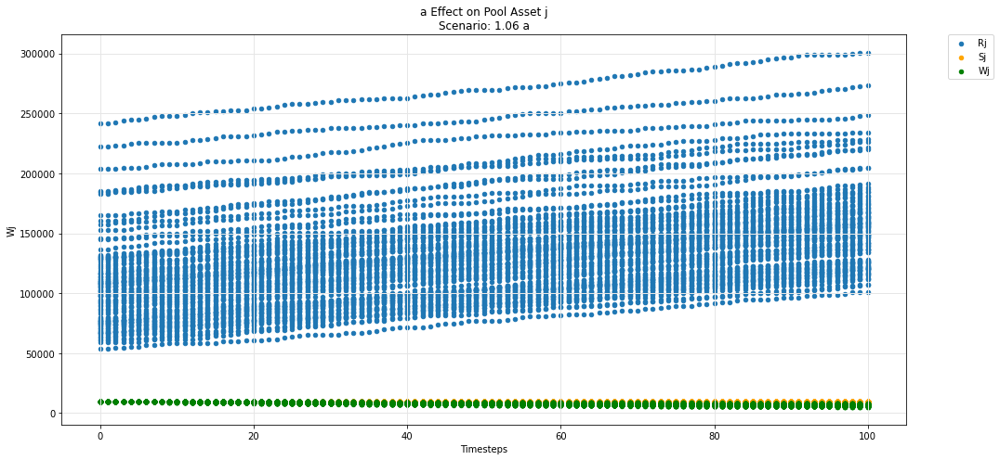

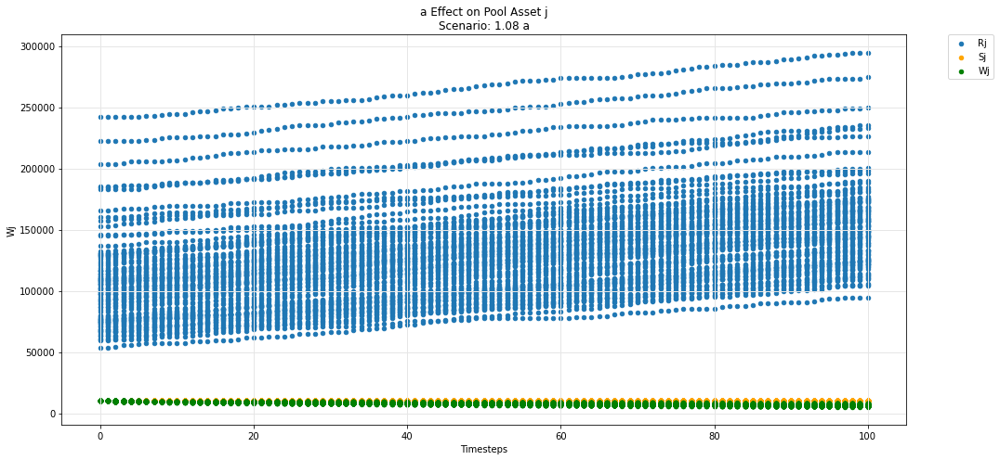

In [67]:
param_pool_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

In [68]:
def param_pool_simulation_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        df = df.groupby('timestep').agg({df_label: ['min', 'mean', 'max']}).reset_index()
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=(df_label,'mean'), label=df_label, ax=ax, legend=True, kind ='scatter')
        ax.fill_between(df.timestep, df[(df_label,'min')], df[(df_label,'max')], alpha=0.3)    
        for count, arg in enumerate(args):
            df = sub_experiments.copy()
            
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))
            df = df.groupby('timestep').agg({df_arg_label: ['min', 'mean', 'max']}).reset_index()

            df.plot(x='timestep', y=(df_arg_label,'mean'), label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')
            ax.fill_between(df.timestep, df[(df_arg_label,'min')], df[(df_arg_label,'max')], alpha=0.3)    

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

# Prices

## Uniswap

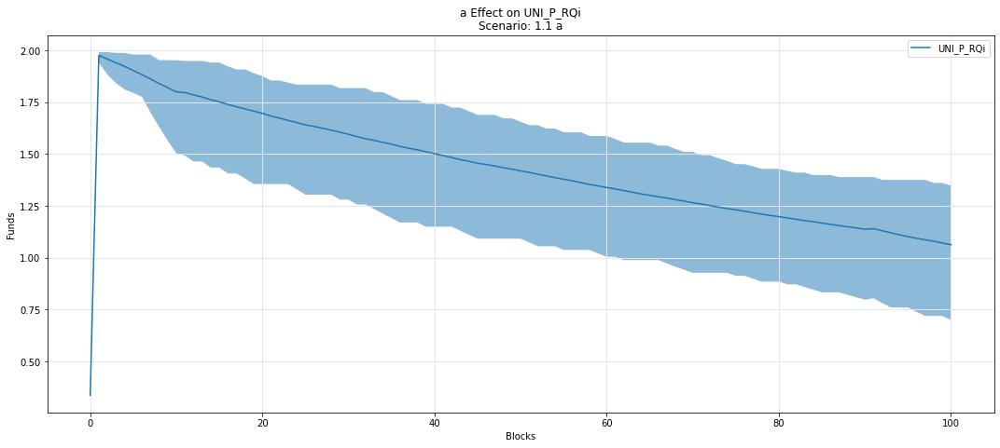

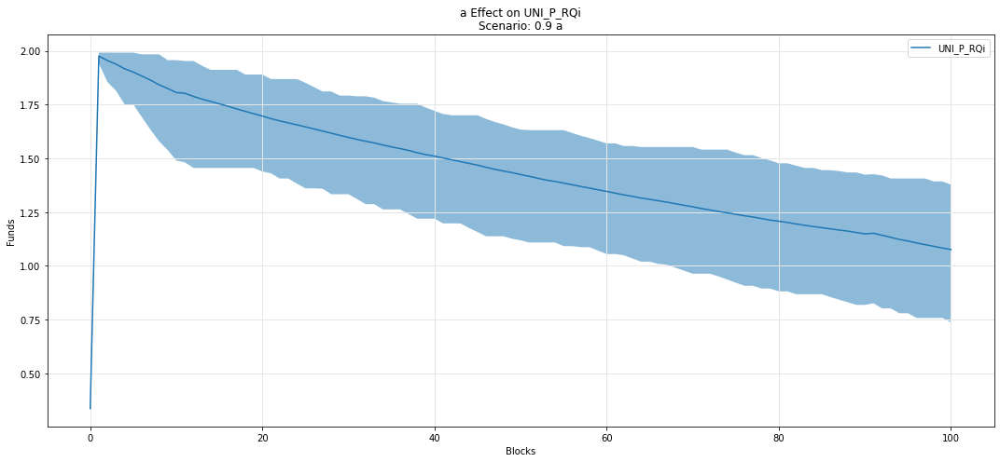

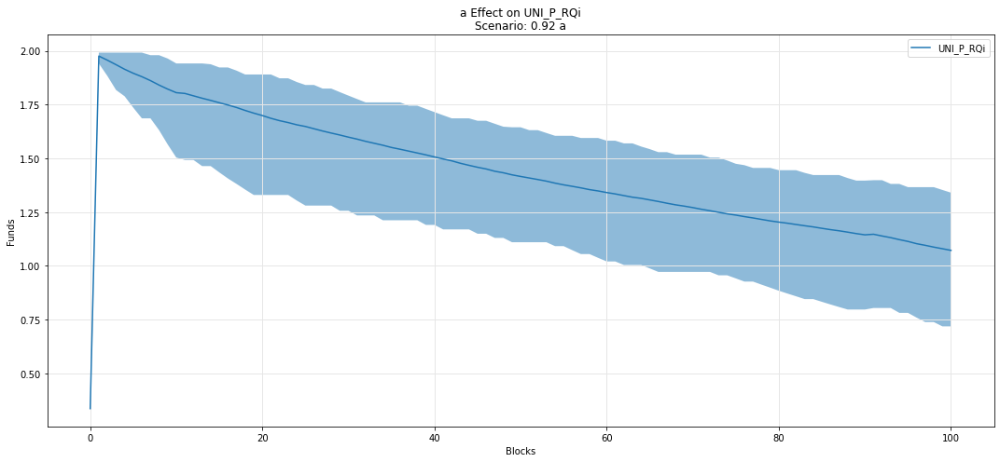

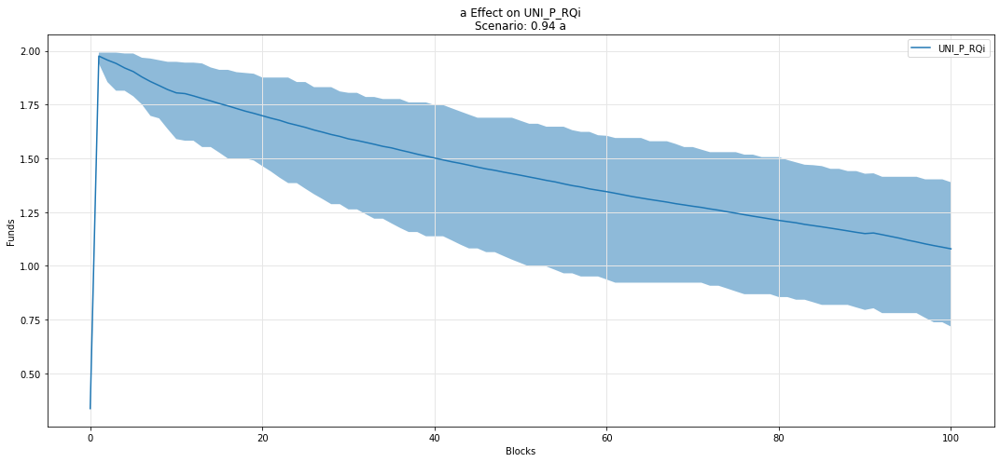

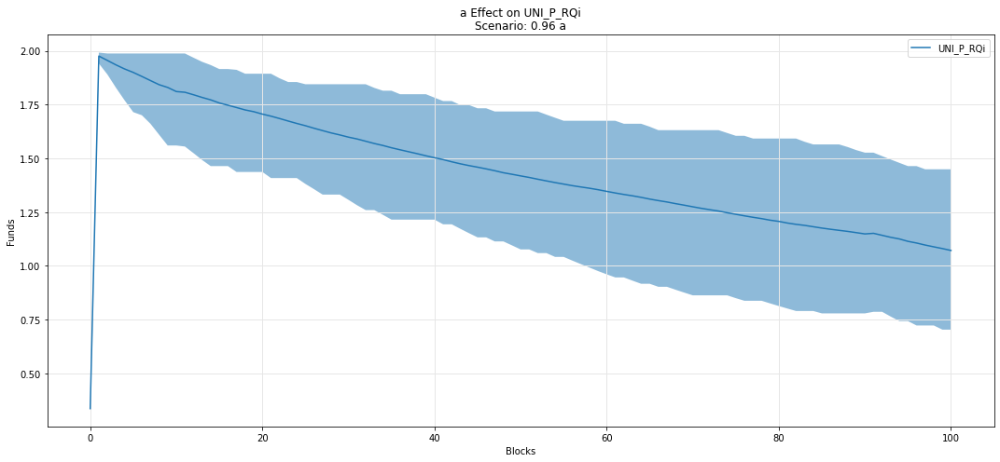

...

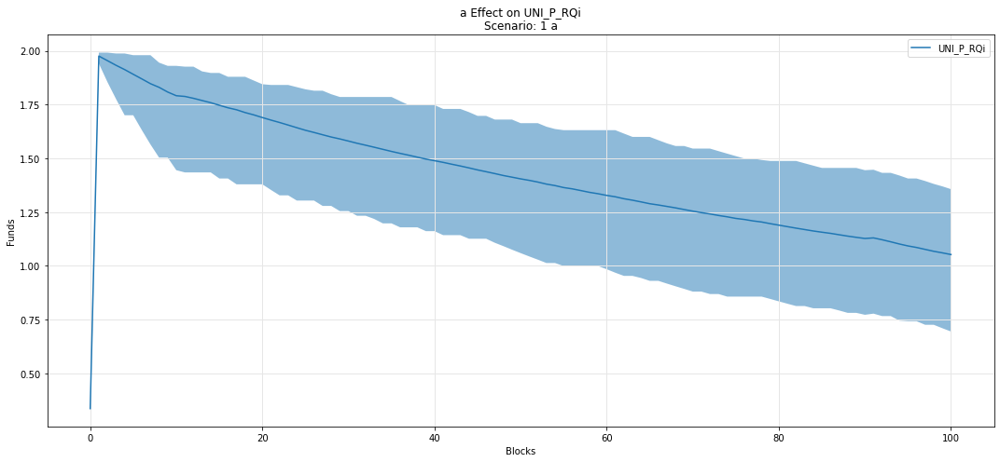

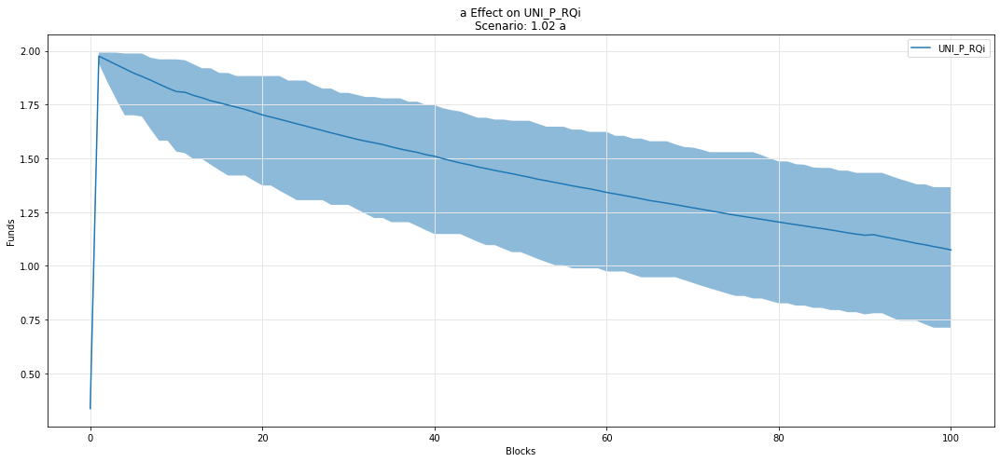

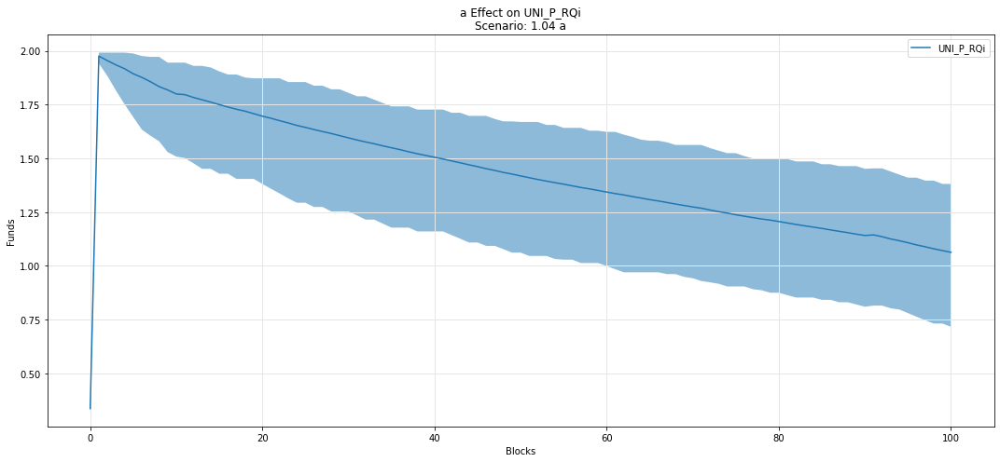

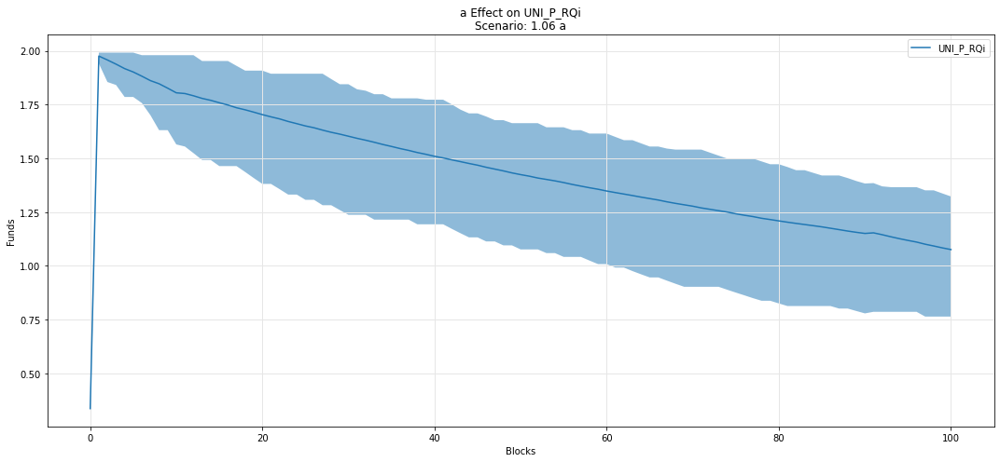

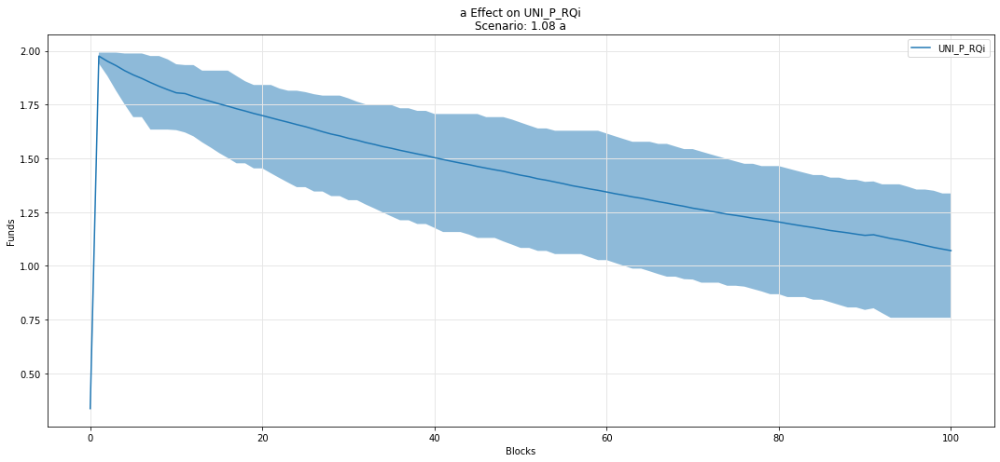

In [69]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_RQi')

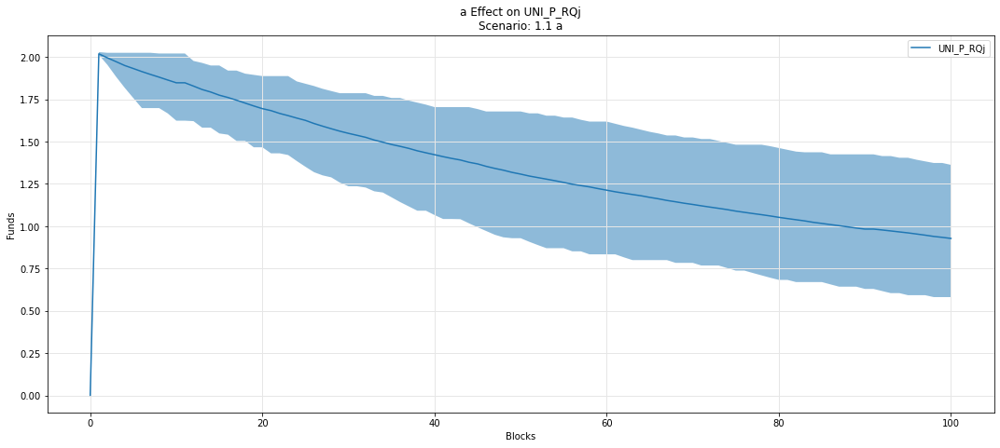

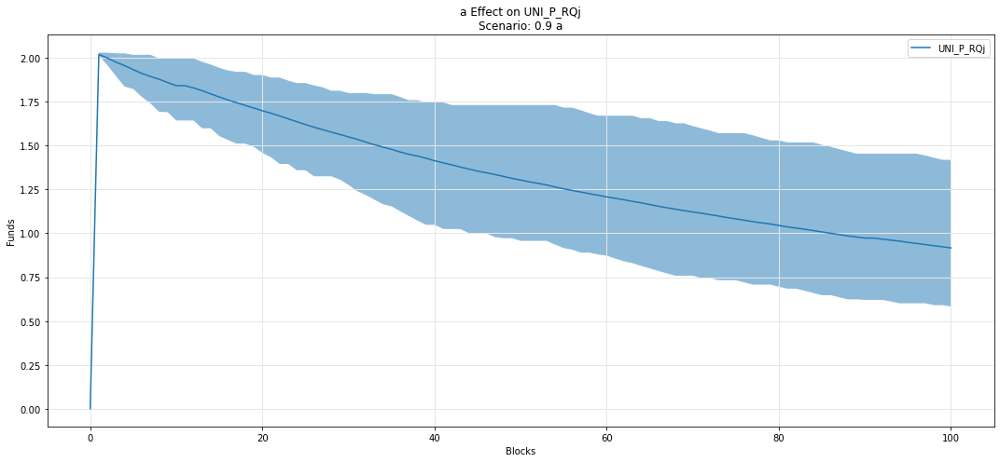

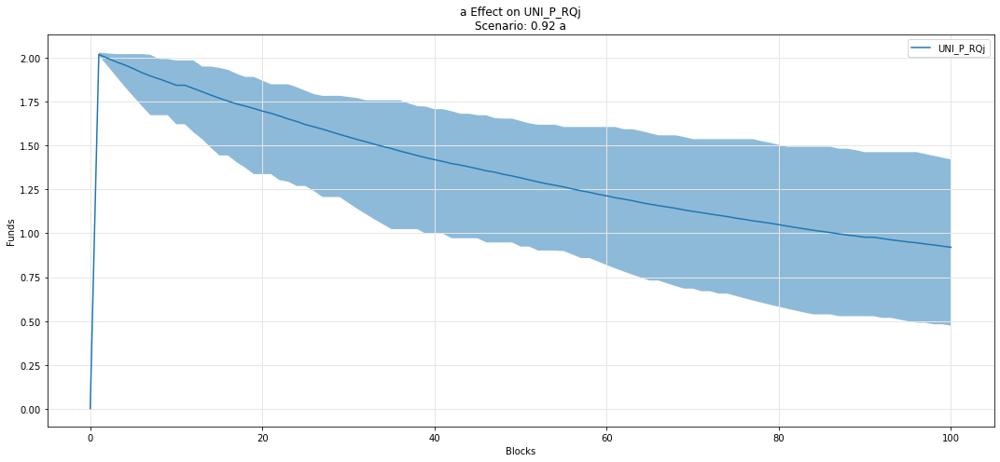

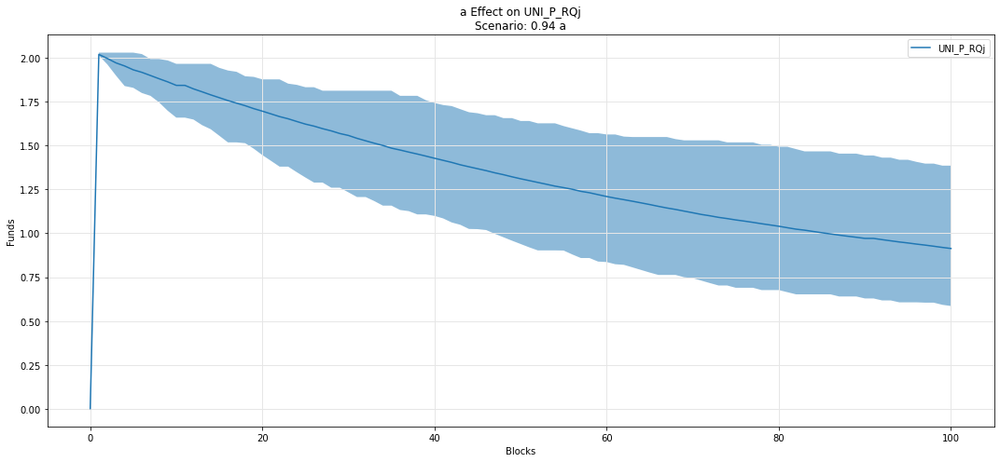

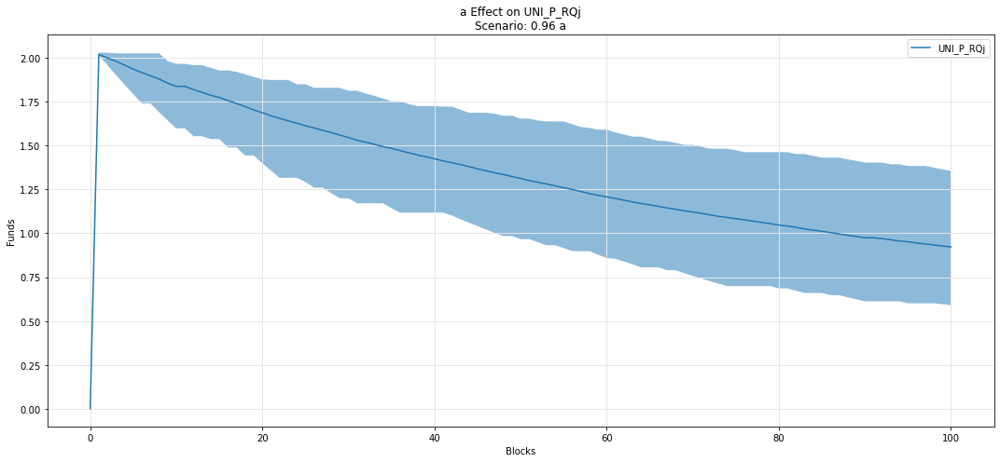

...

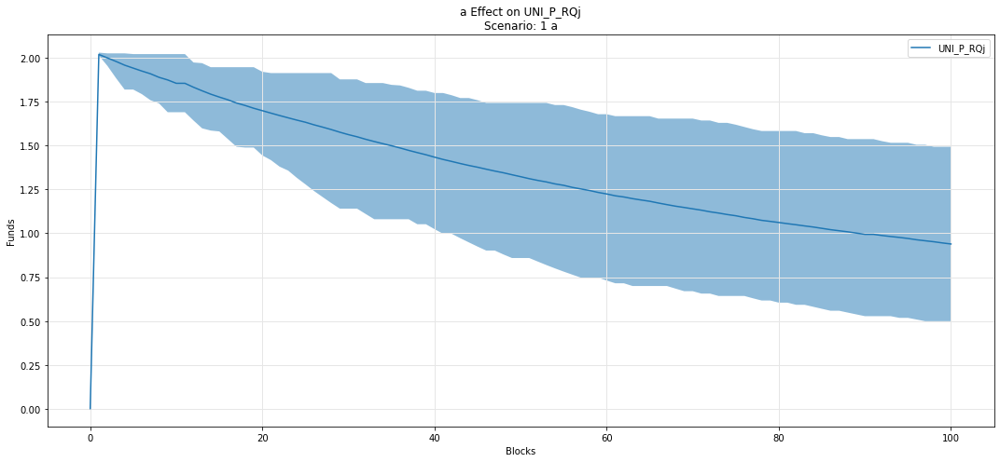

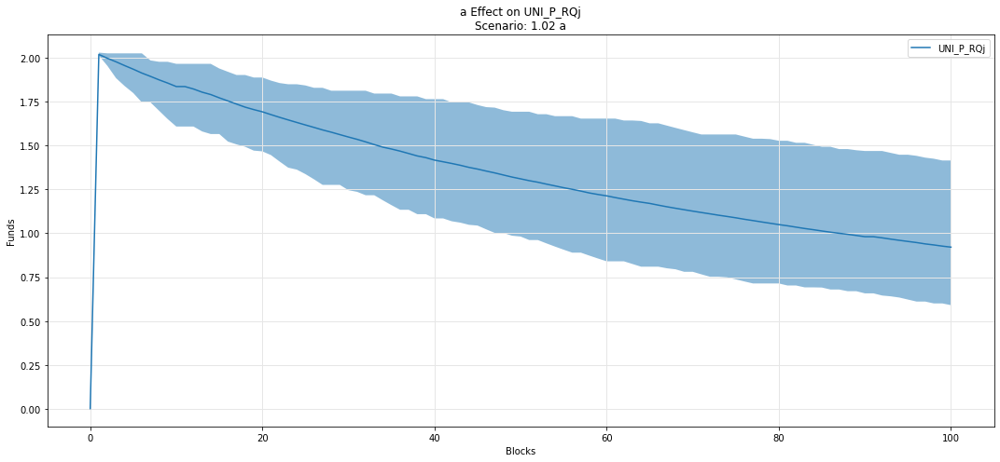

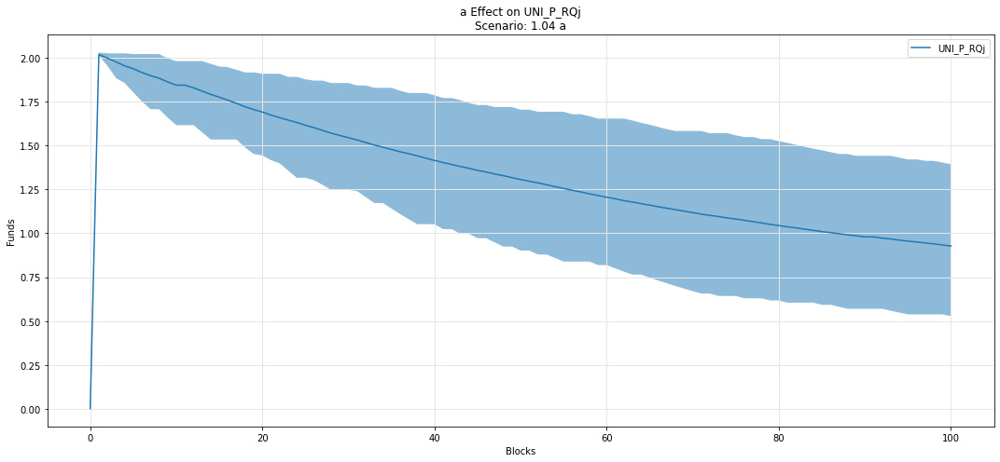

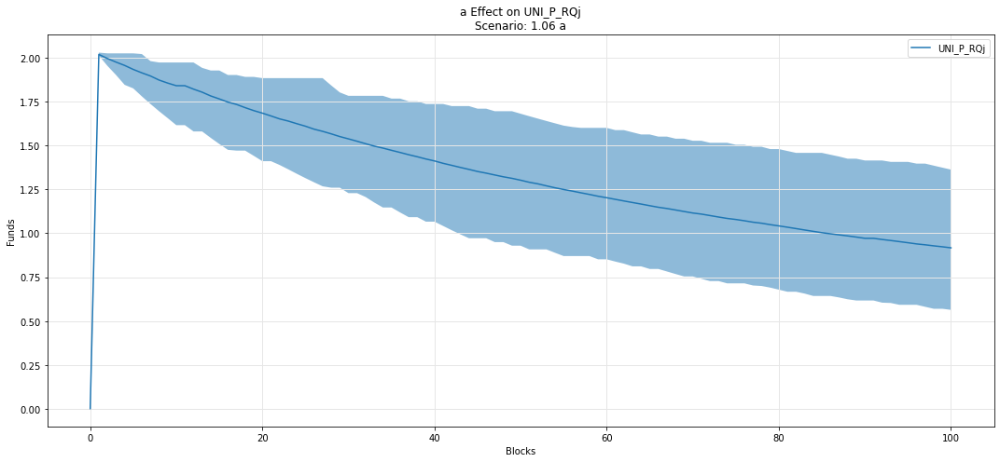

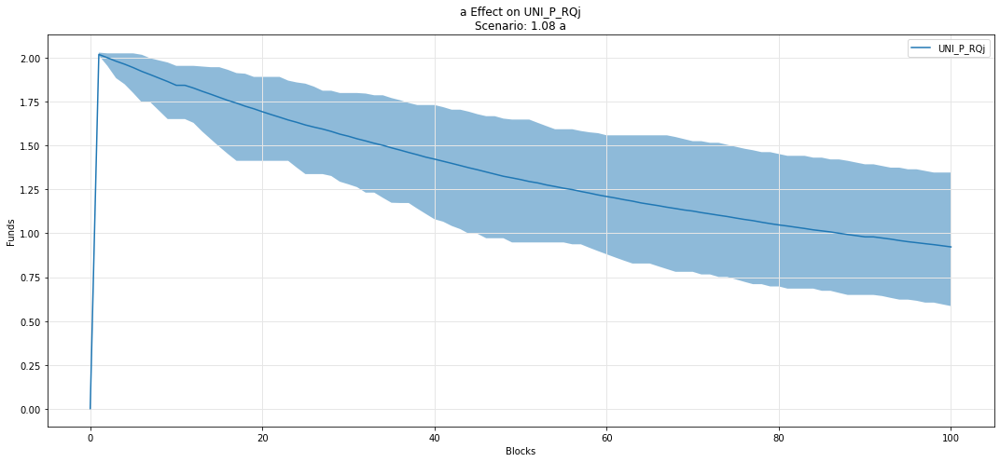

In [70]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_RQj')

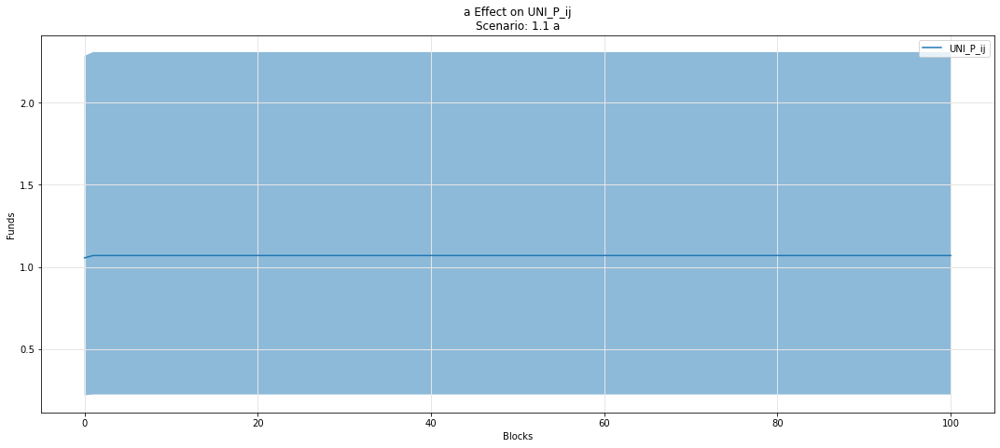

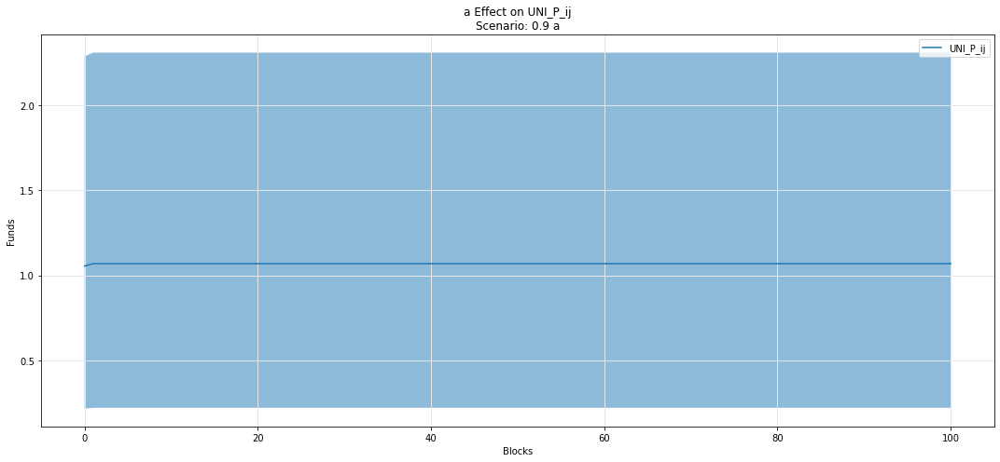

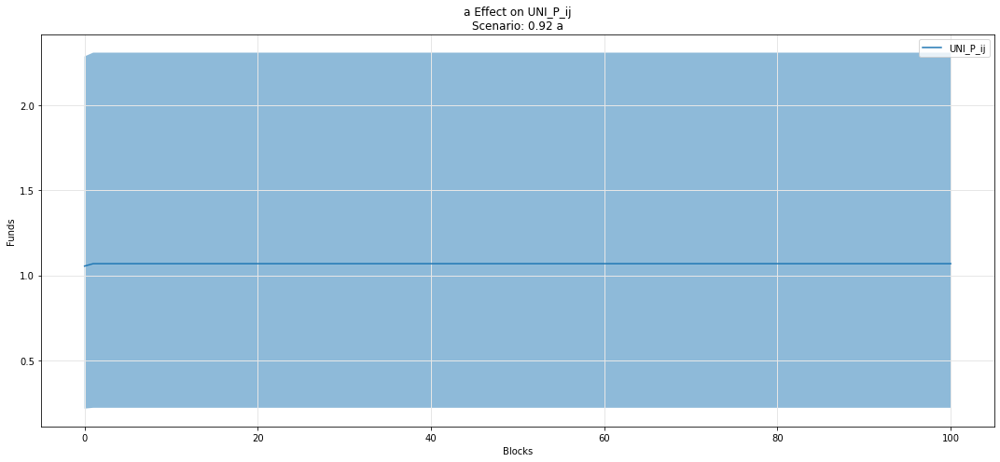

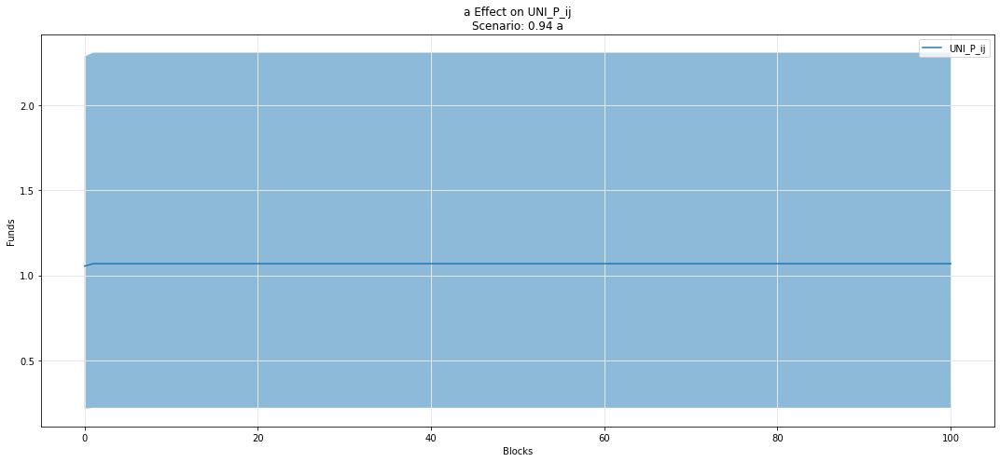

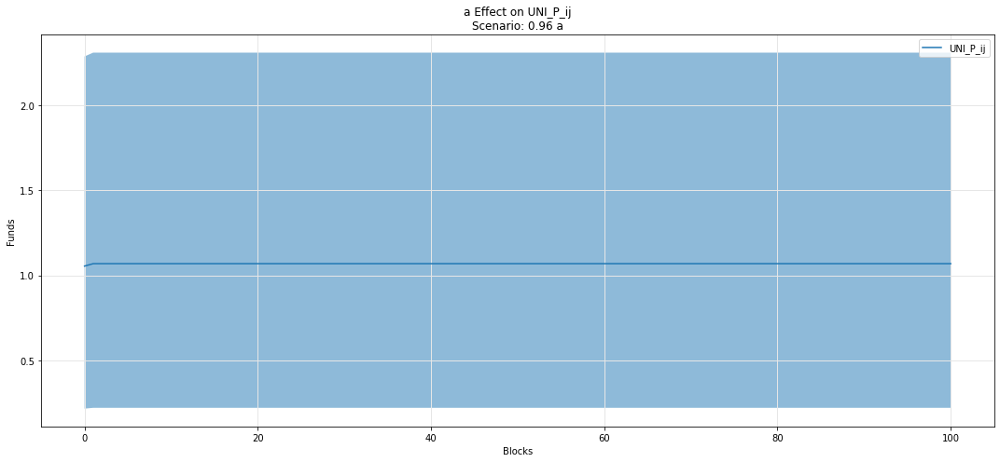

...

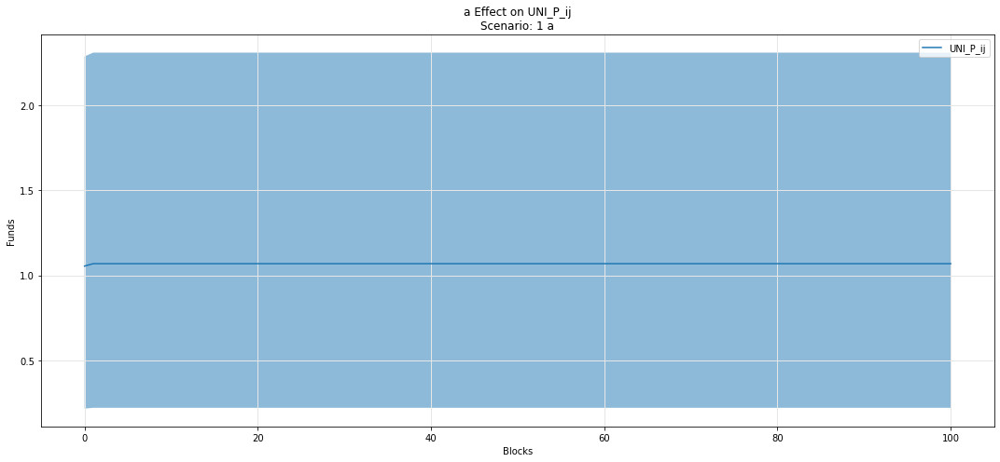

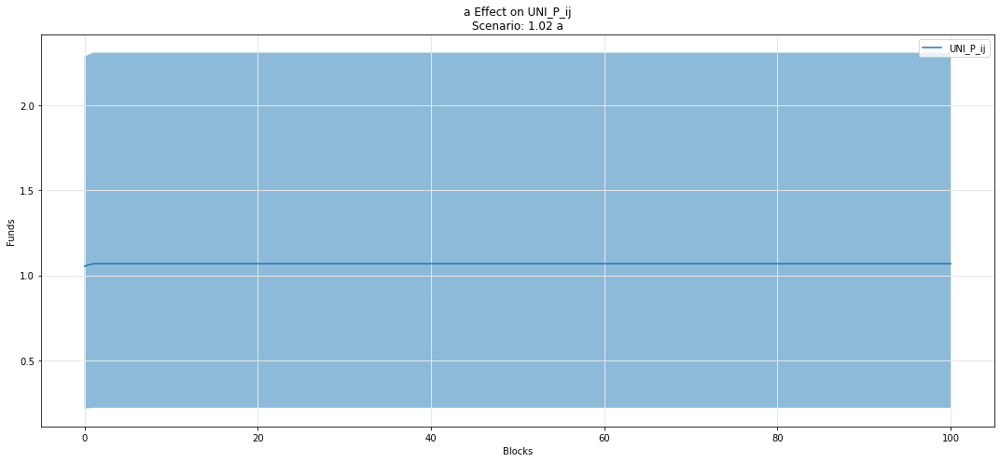

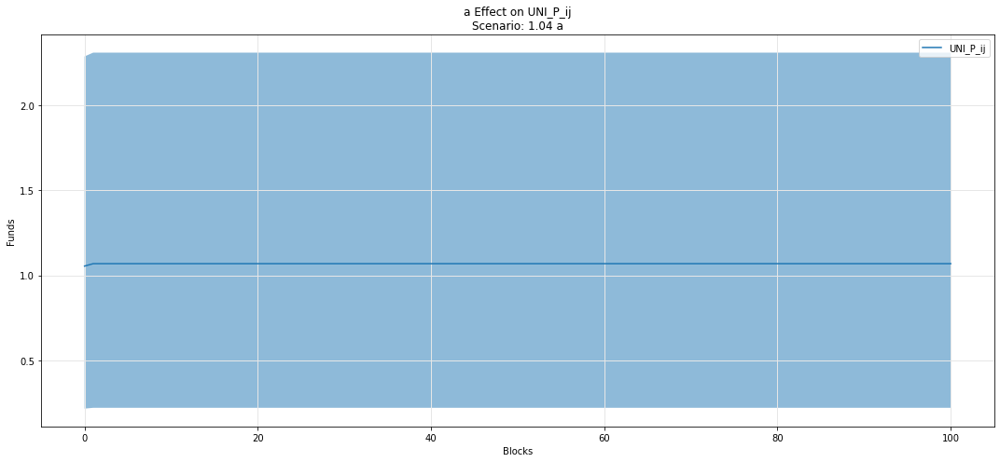

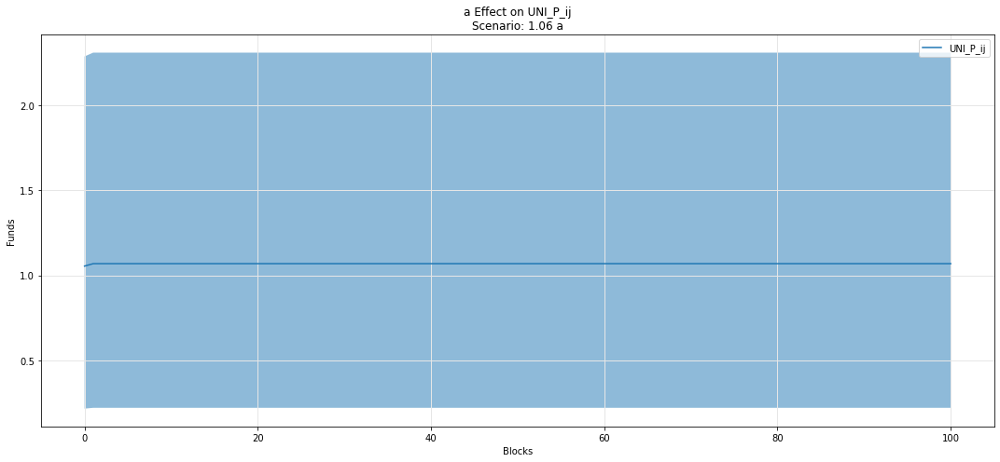

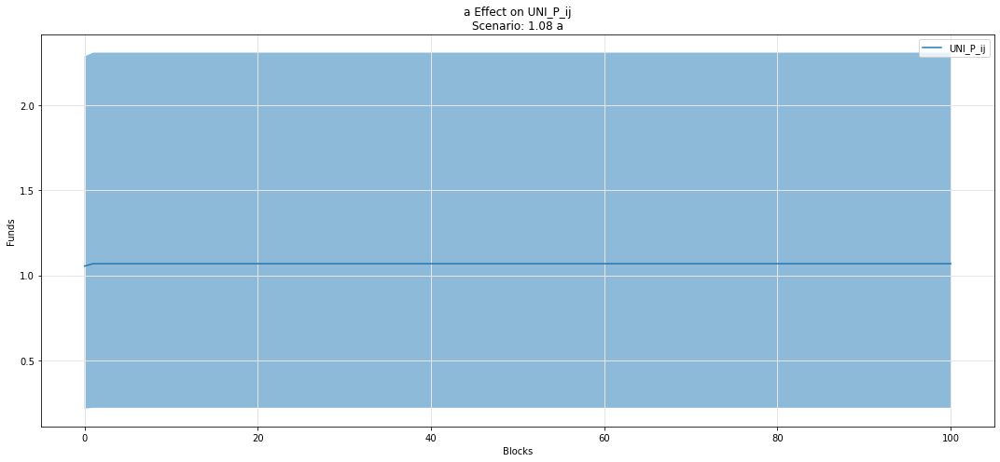

In [71]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_ij')

## Omnipool

## Asset i

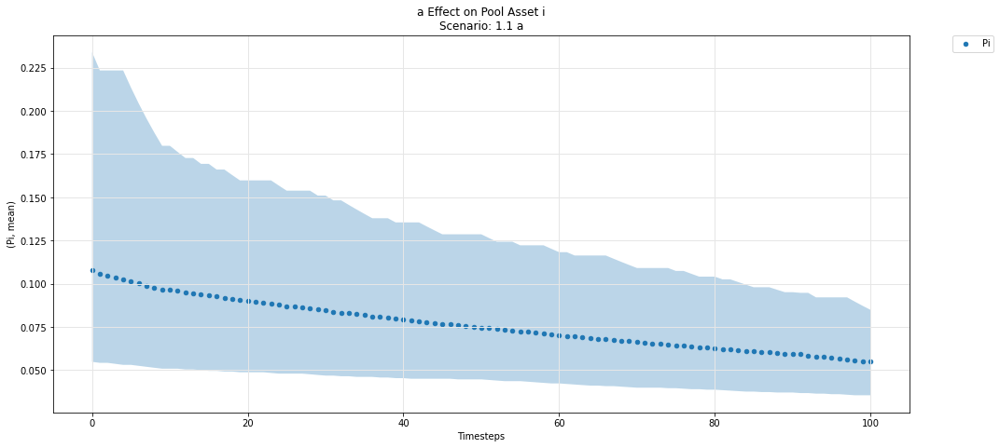

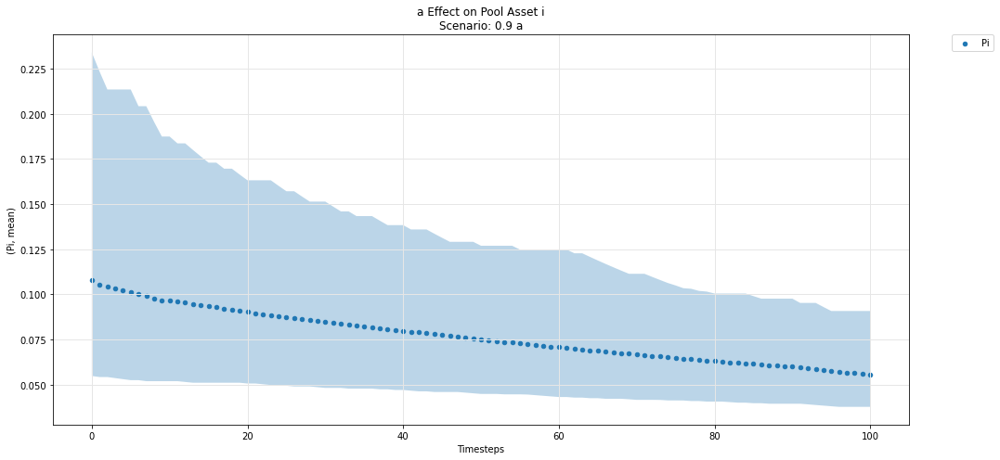

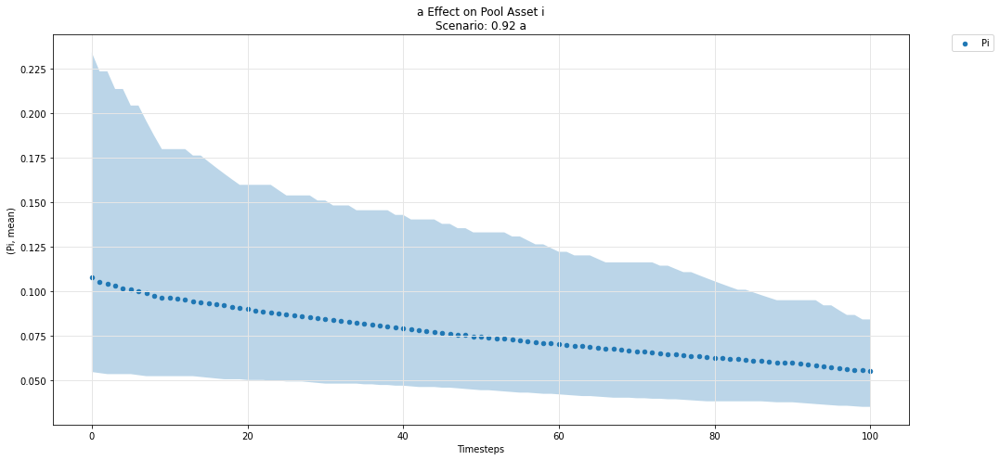

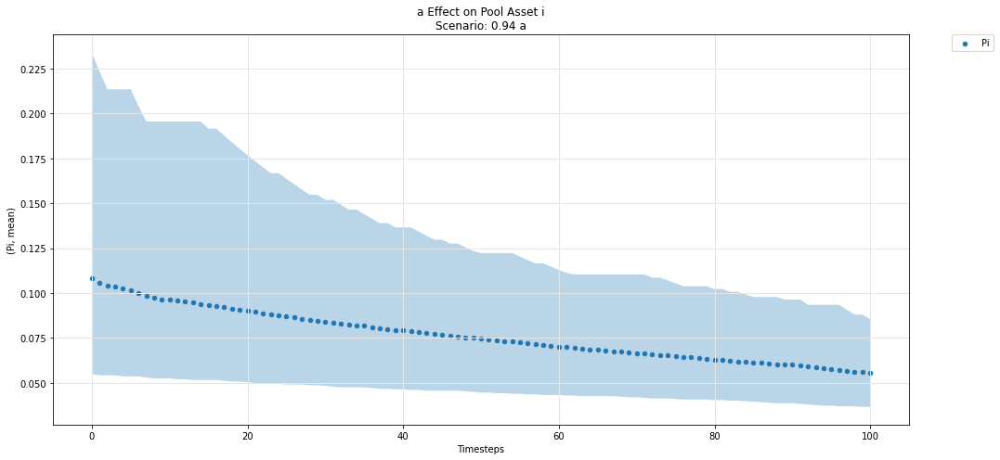

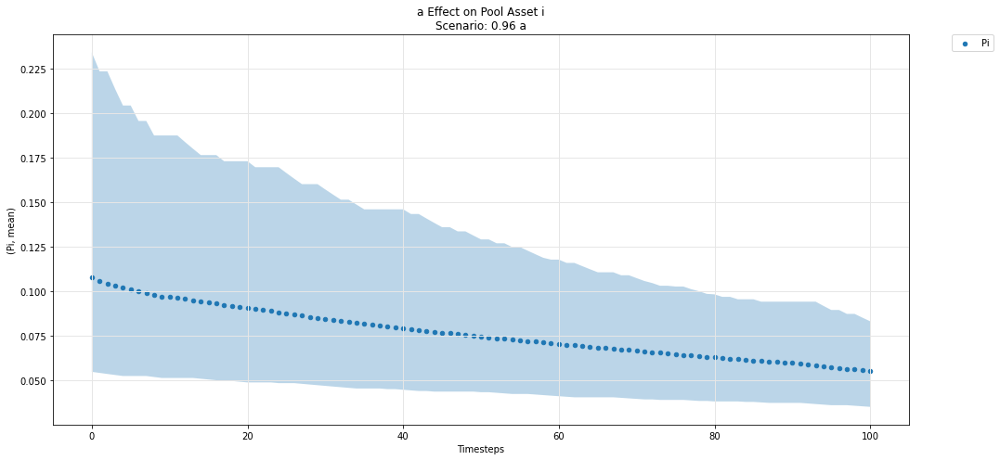

...

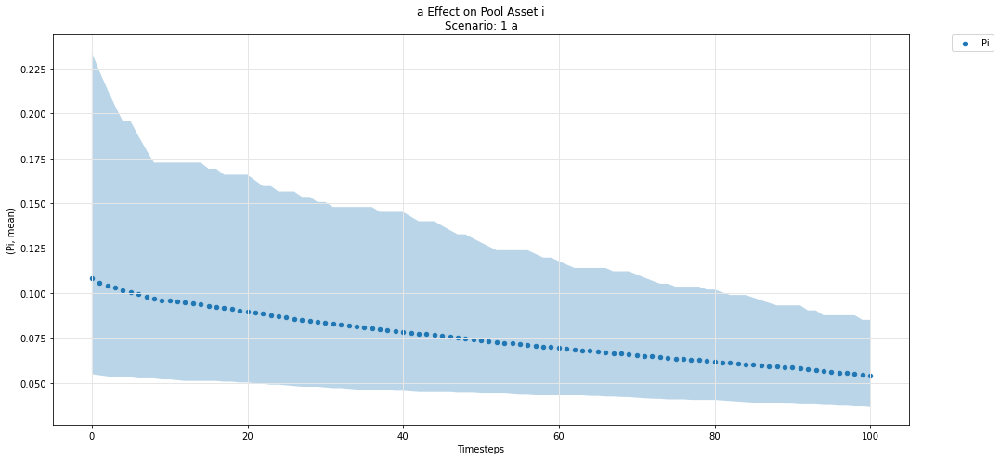

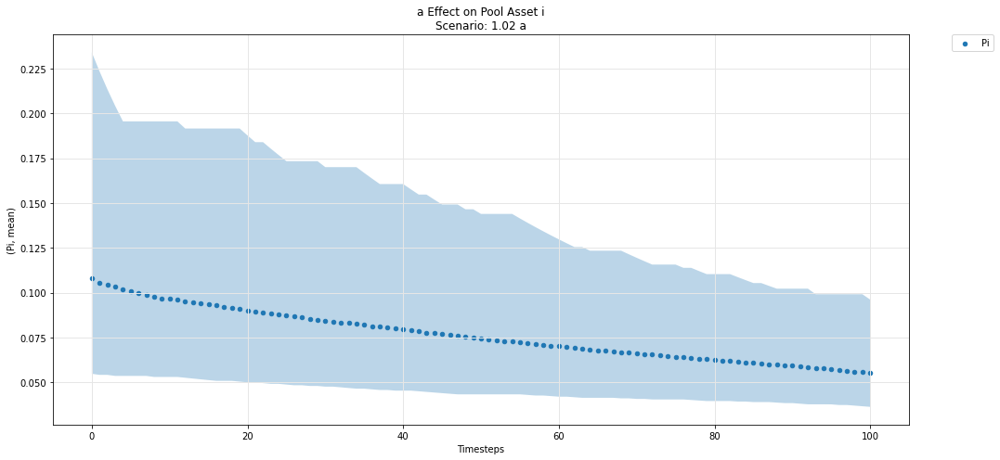

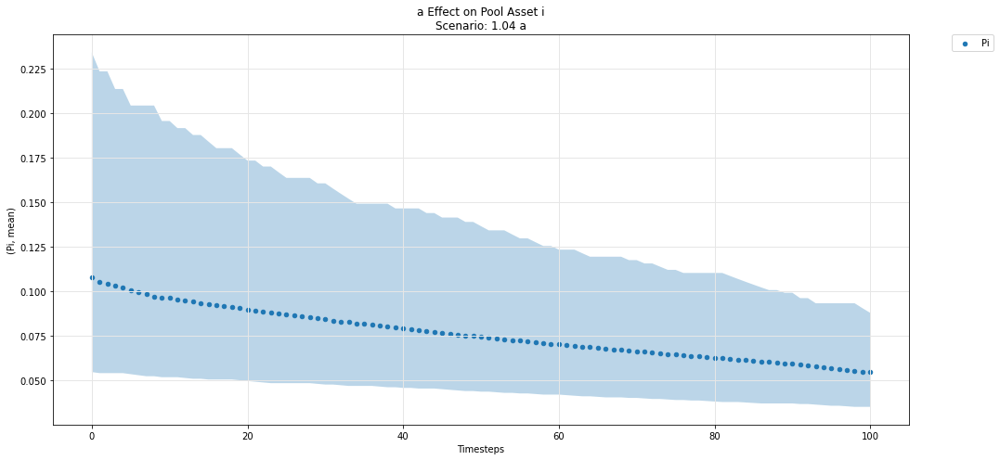

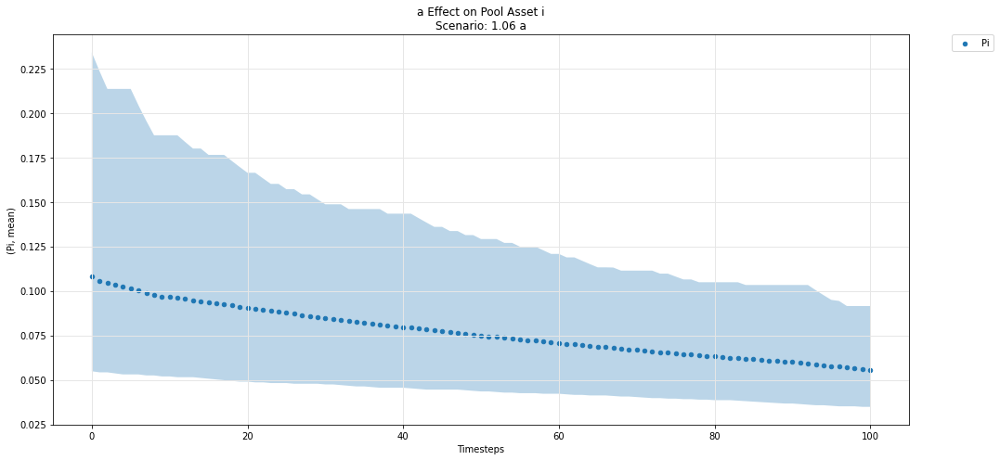

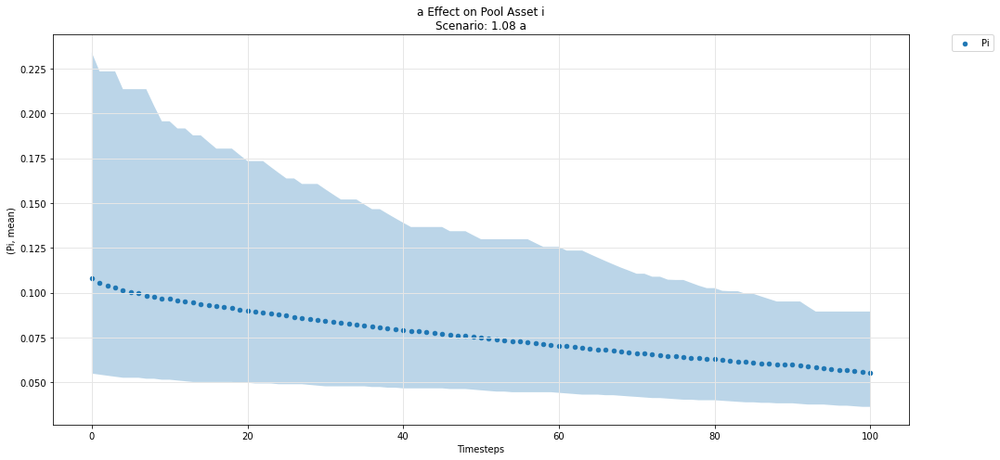

In [72]:
param_pool_simulation_plot(experiments, config_ids, 'a','i','P')

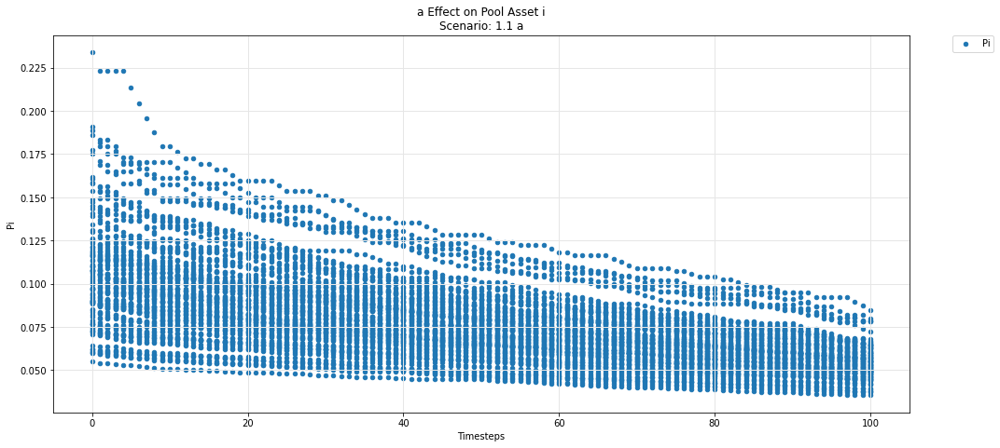

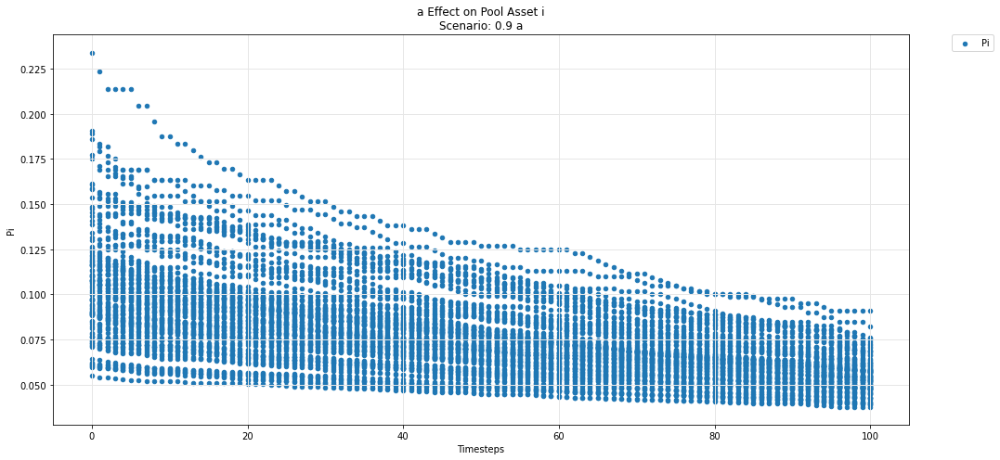

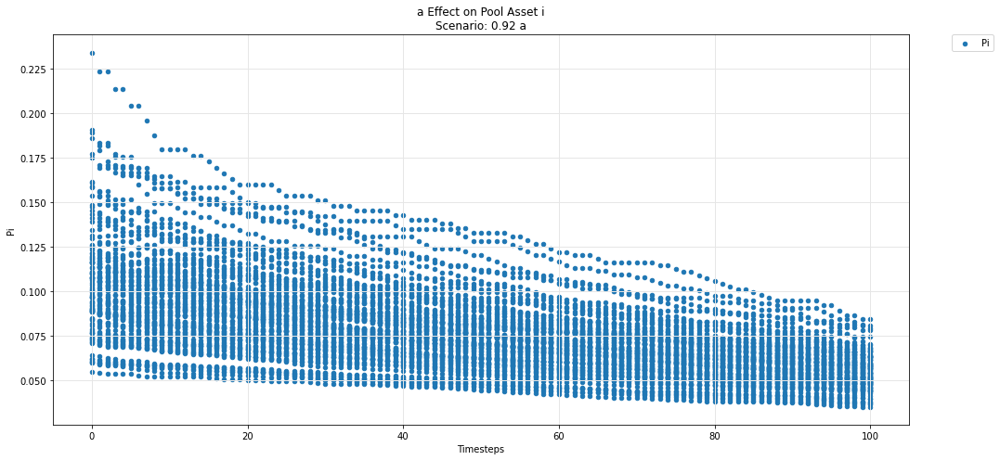

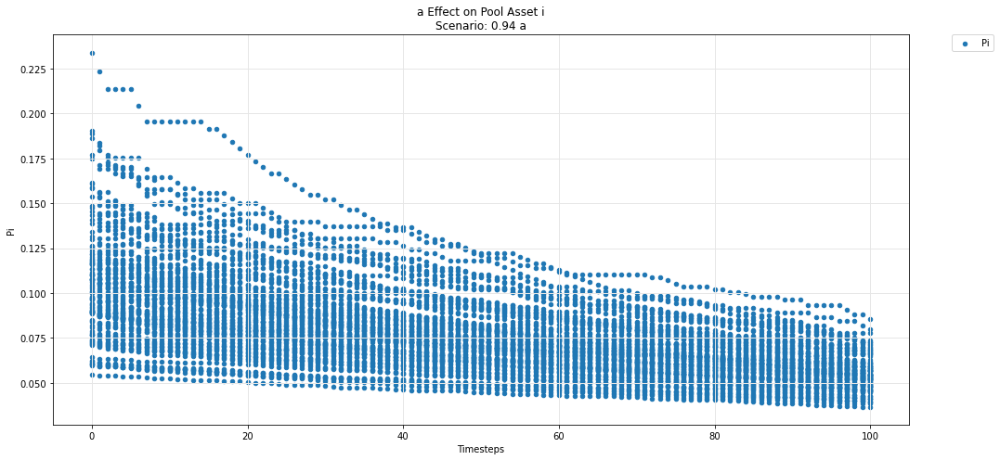

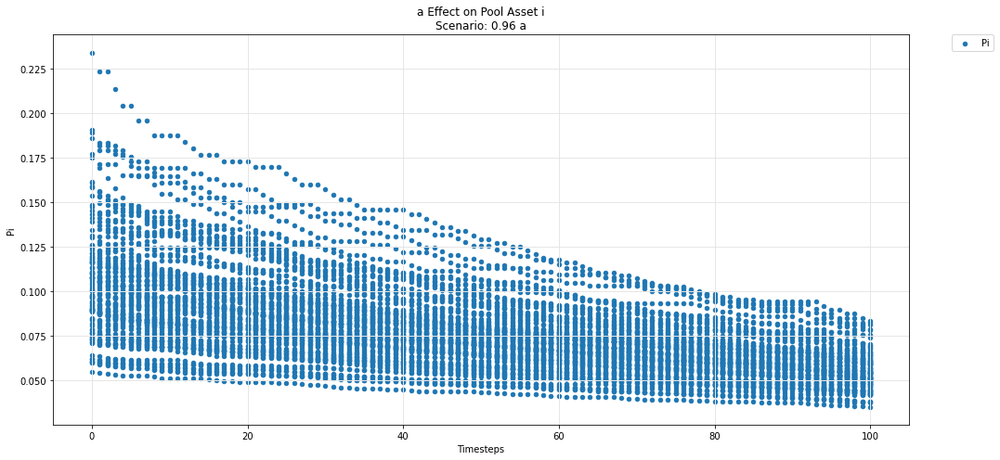

...

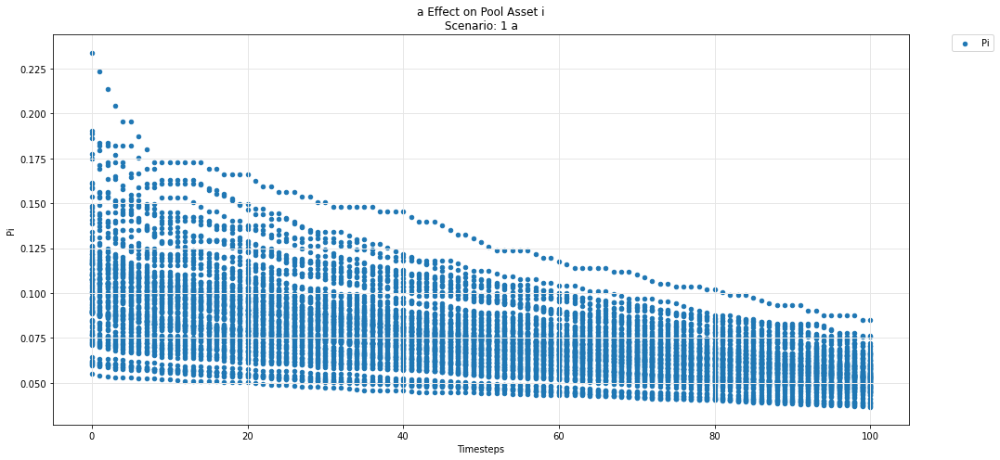

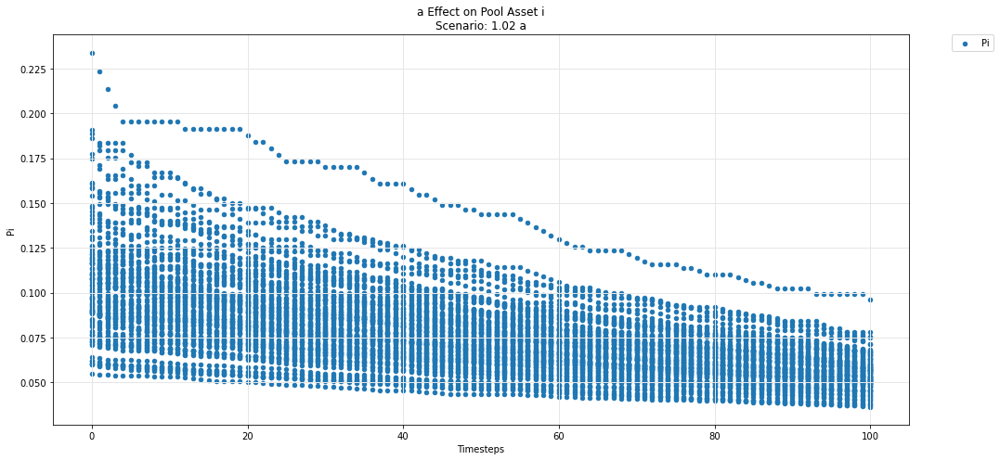

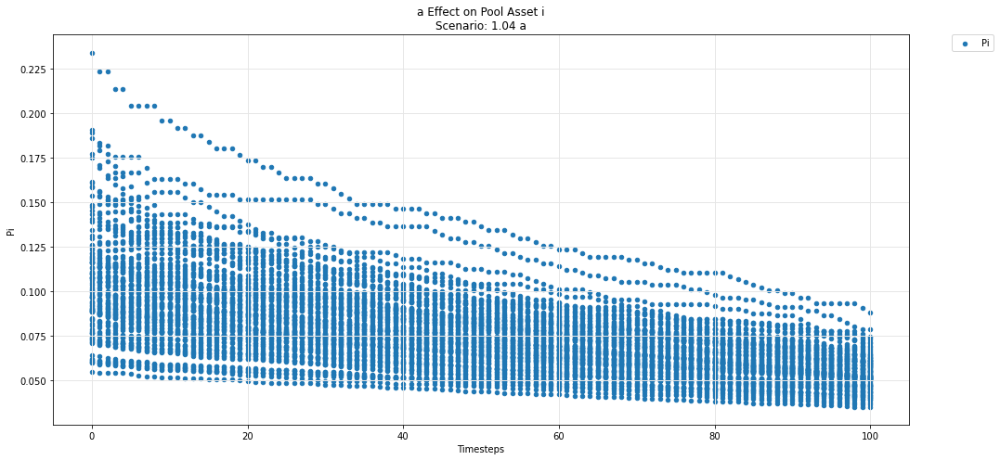

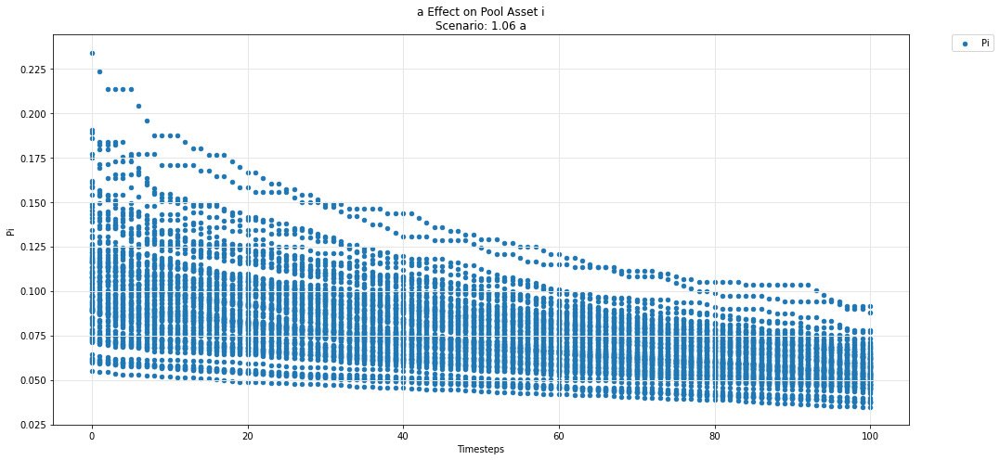

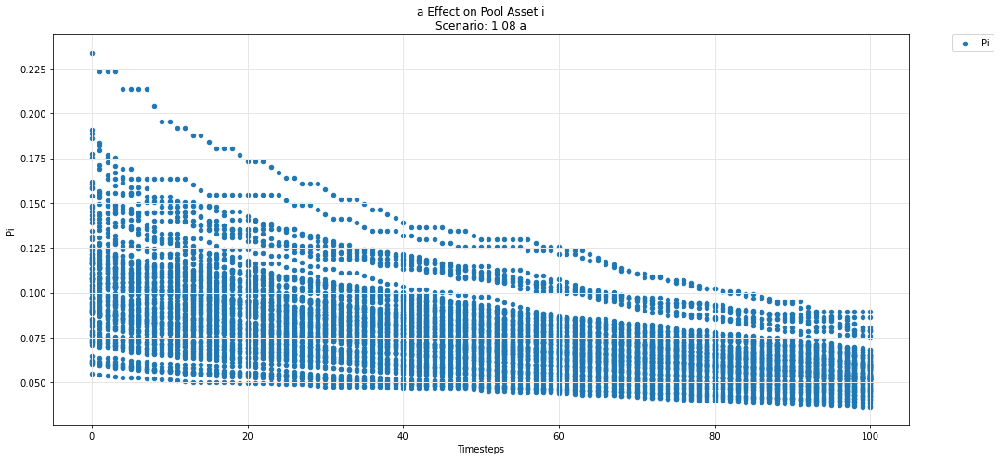

In [73]:
param_pool_plot(experiments, config_ids, 'a','i','P')

## Asset j

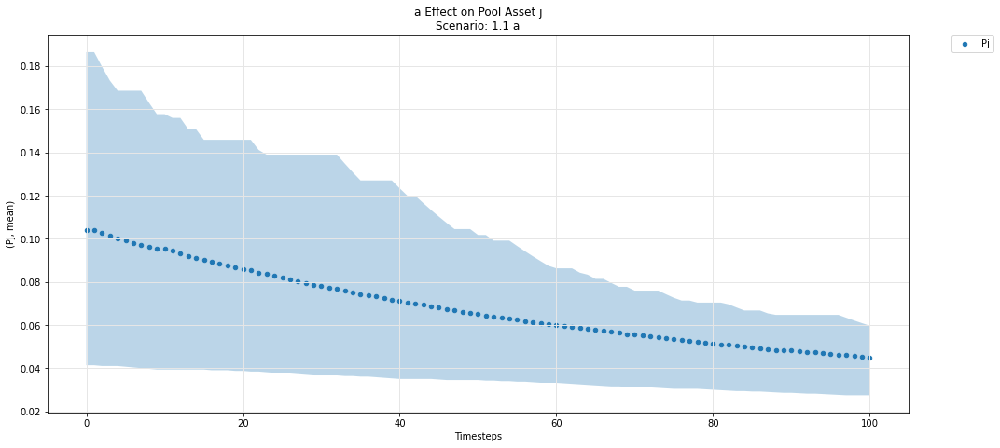

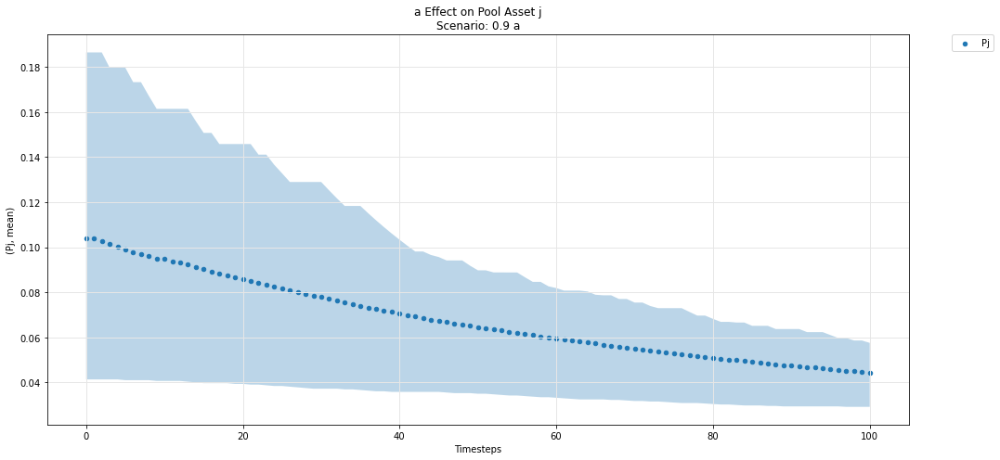

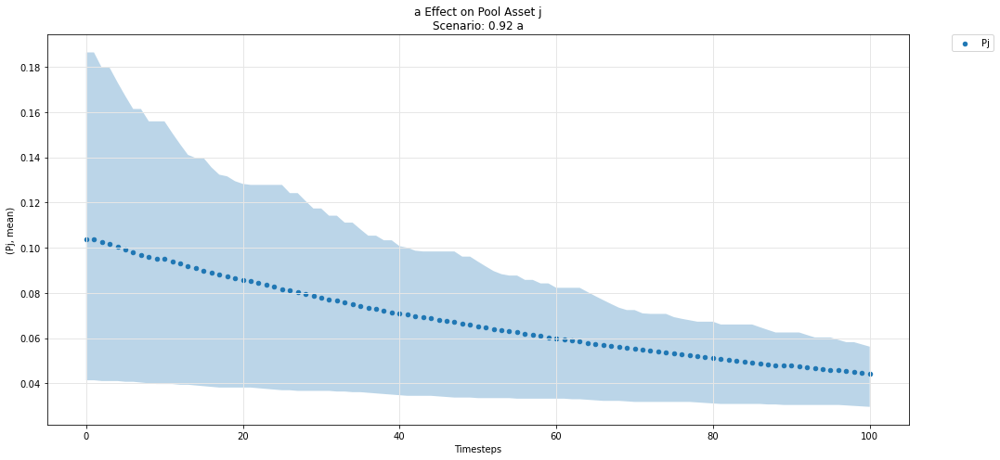

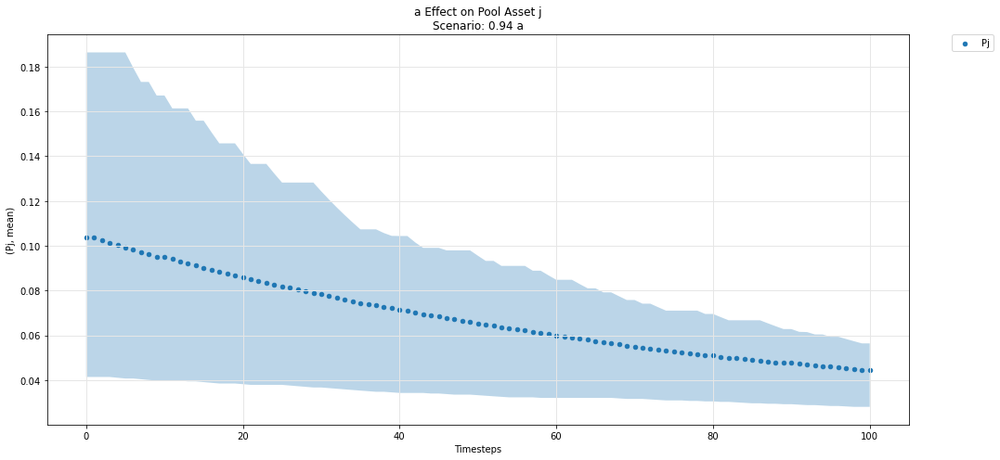

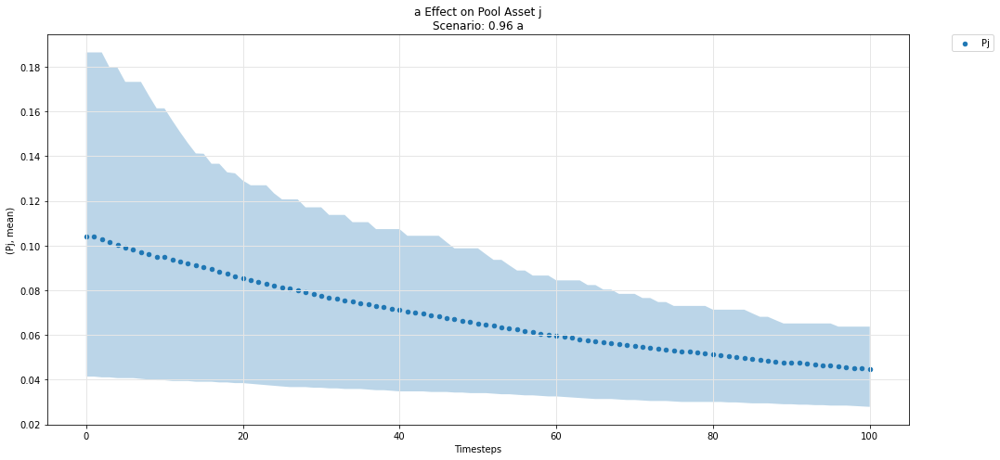

...

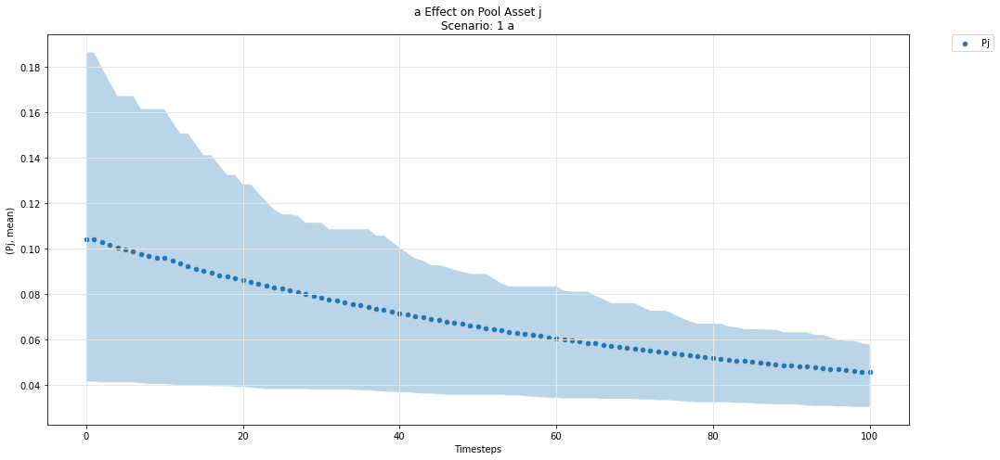

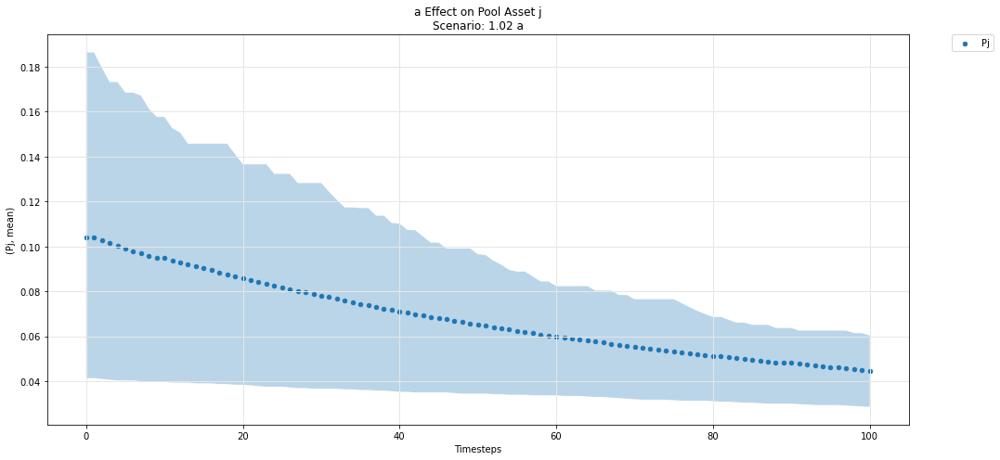

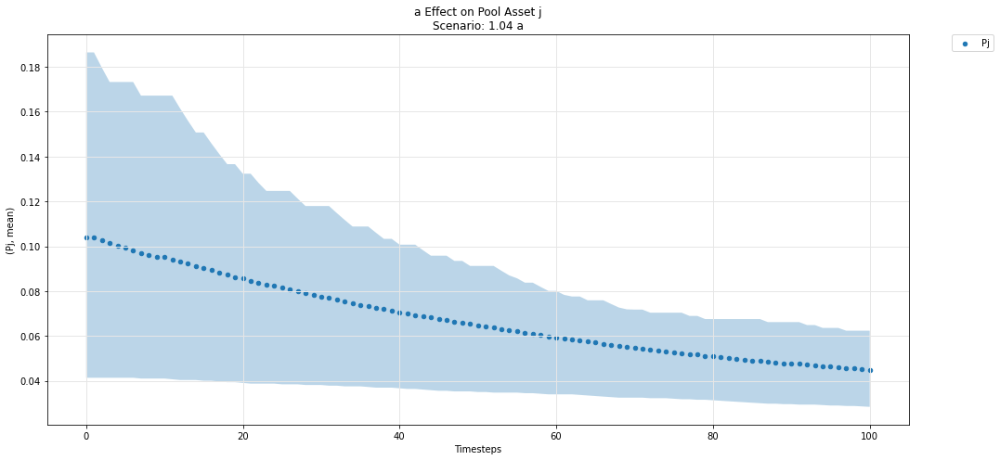

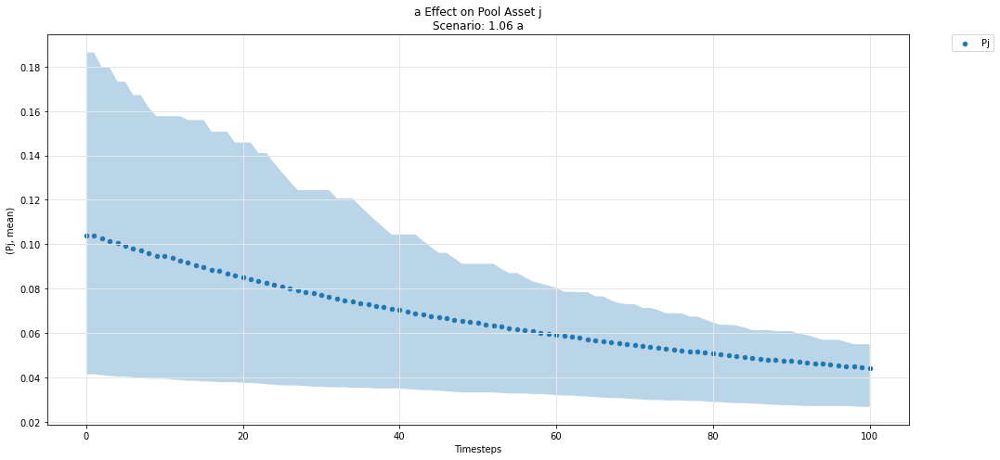

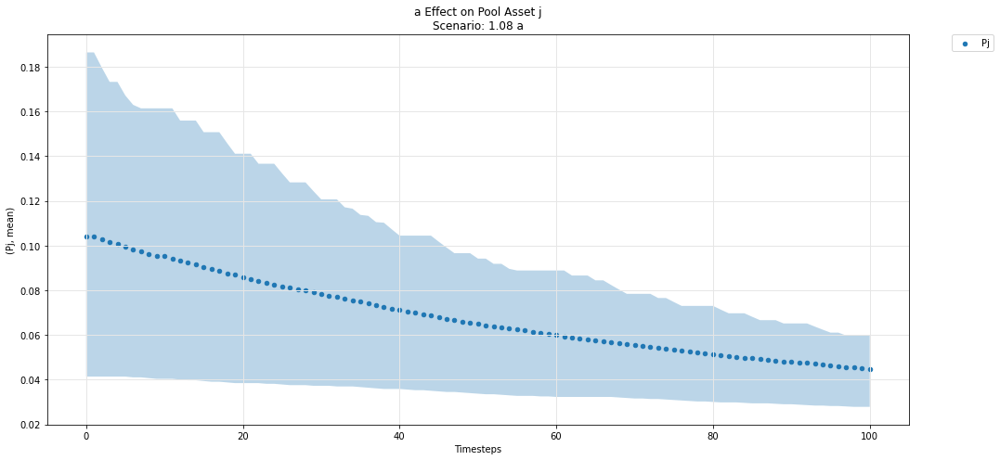

In [74]:
param_pool_simulation_plot(experiments, config_ids, 'a','j','P')

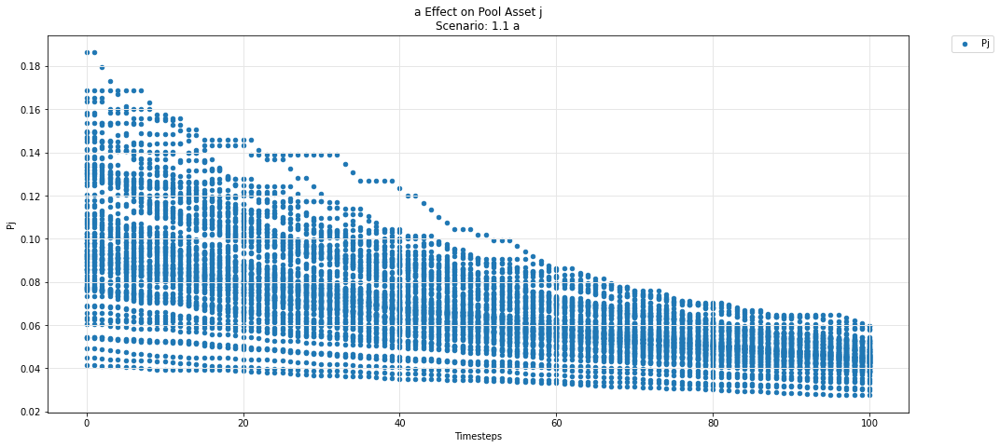

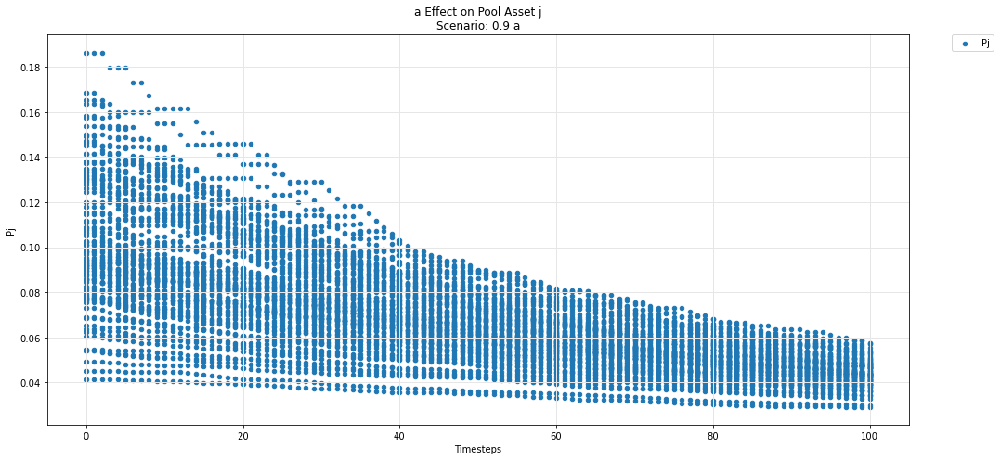

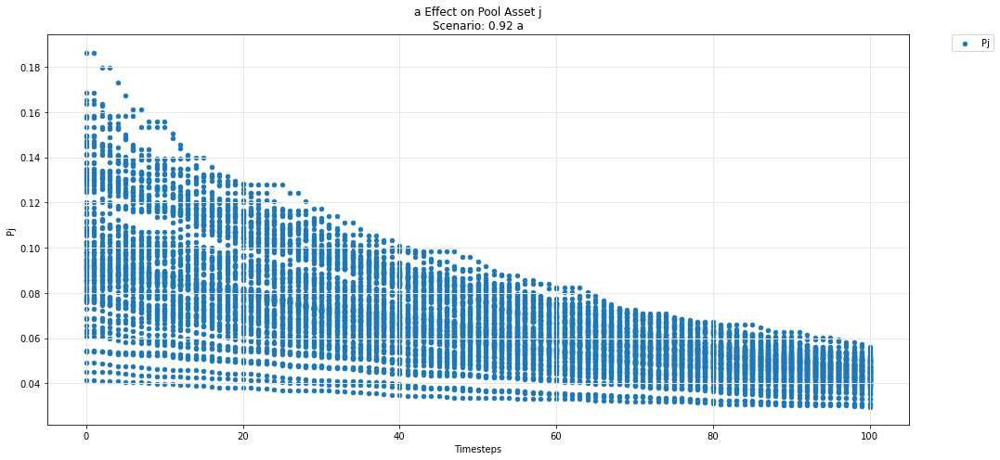

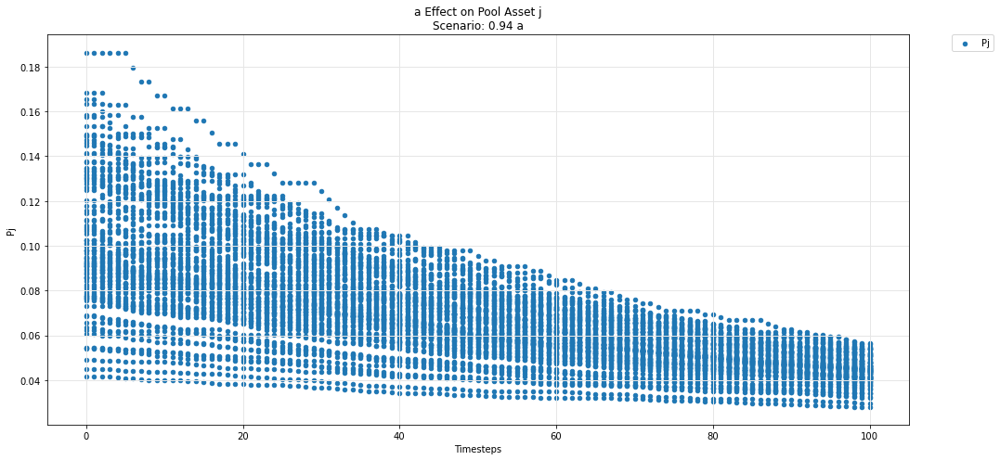

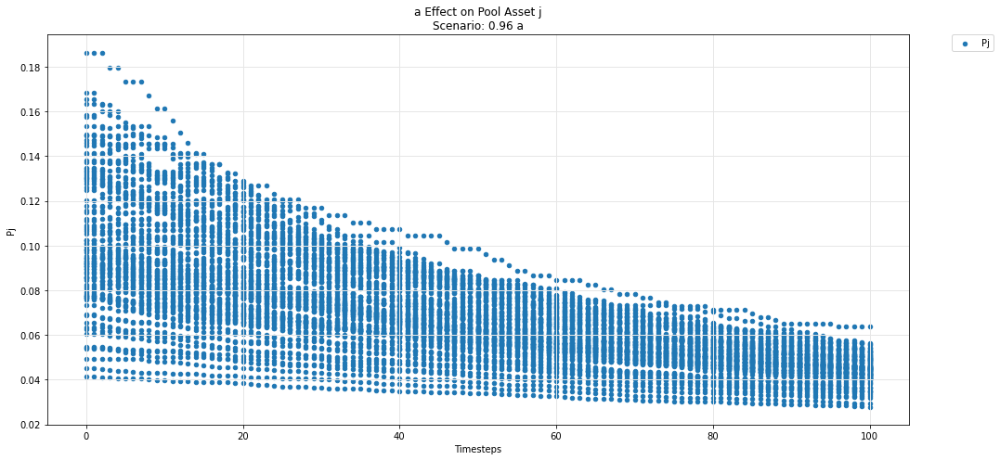

...

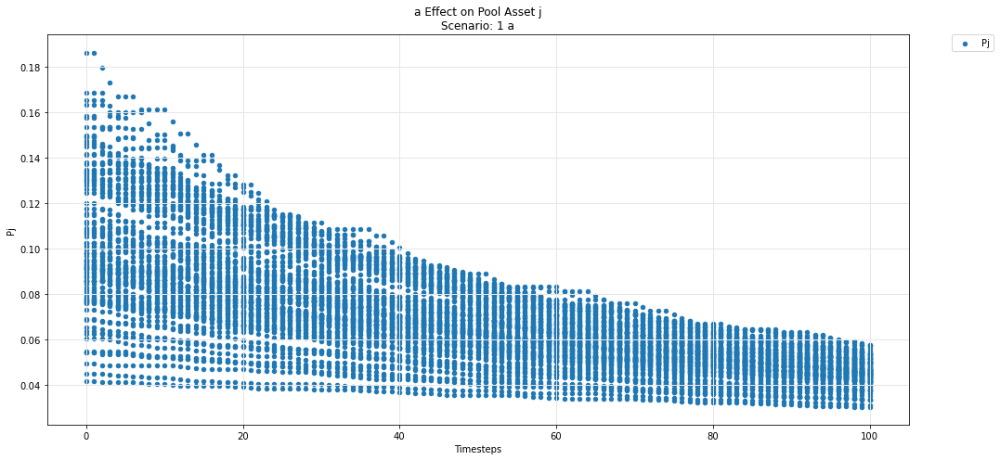

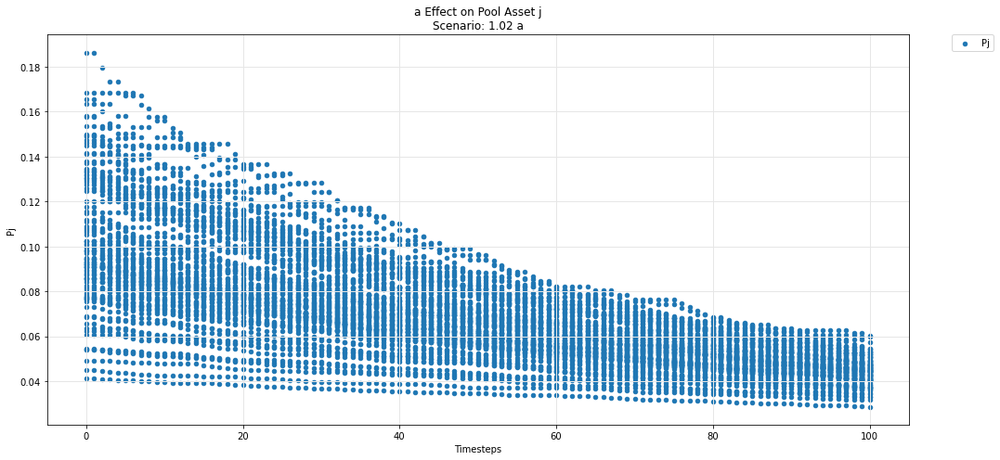

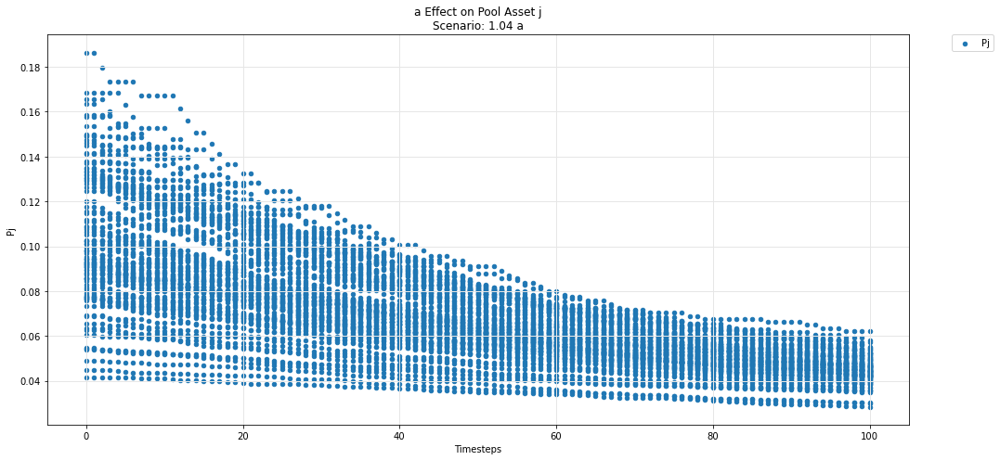

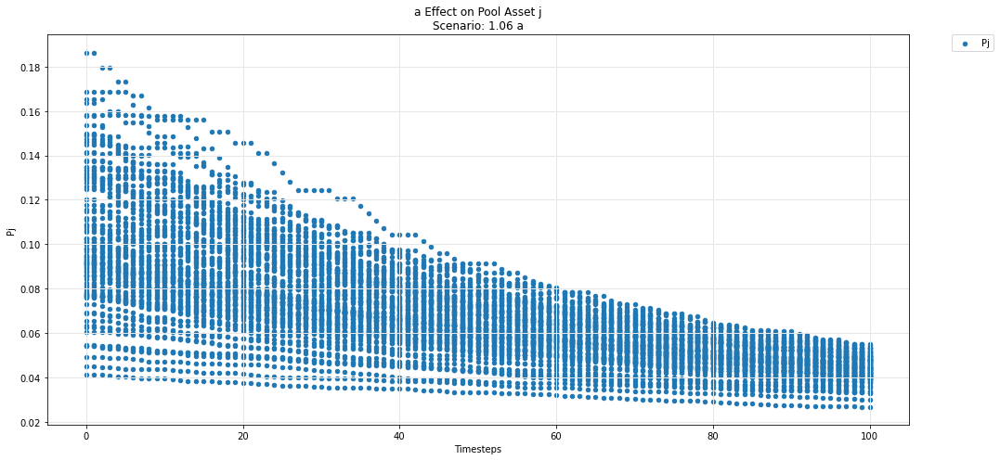

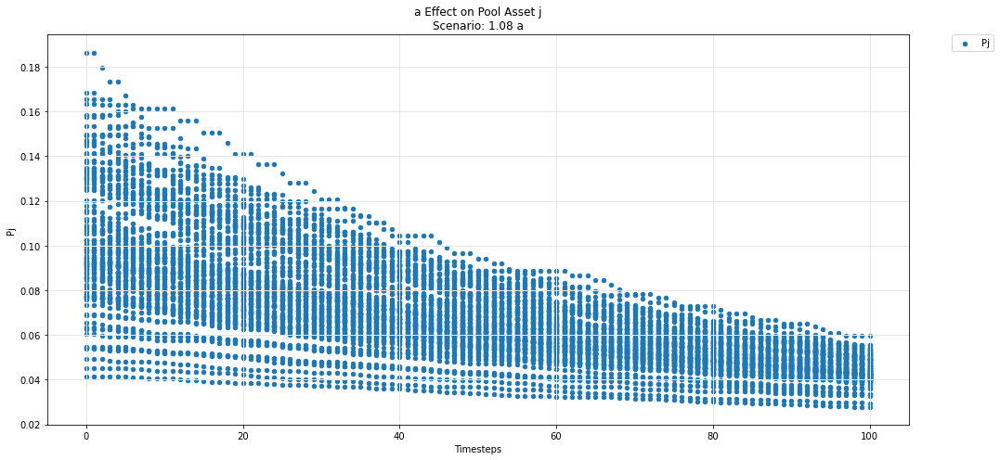

In [75]:
param_pool_plot(experiments, config_ids, 'a','j','P')

## Asset k

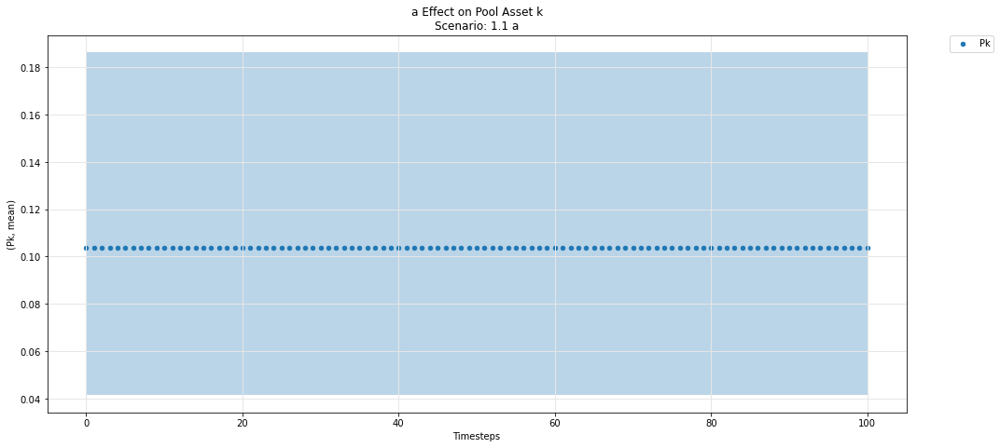

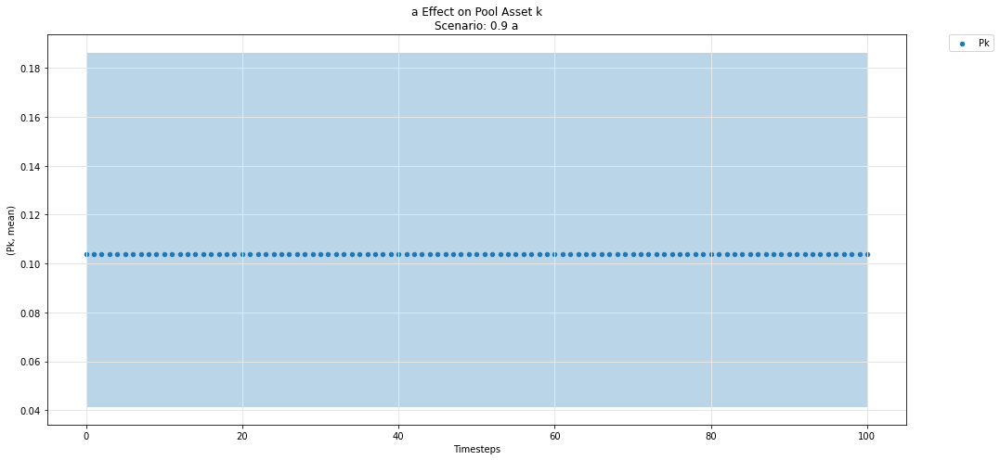

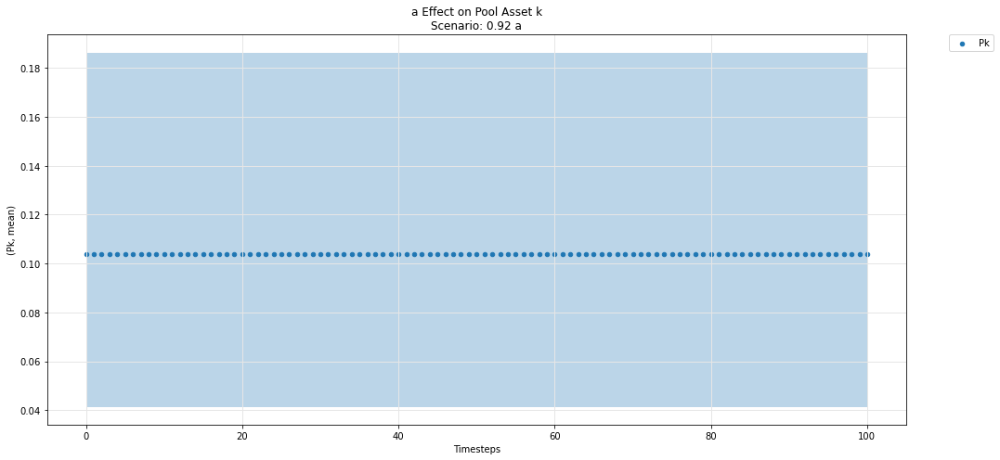

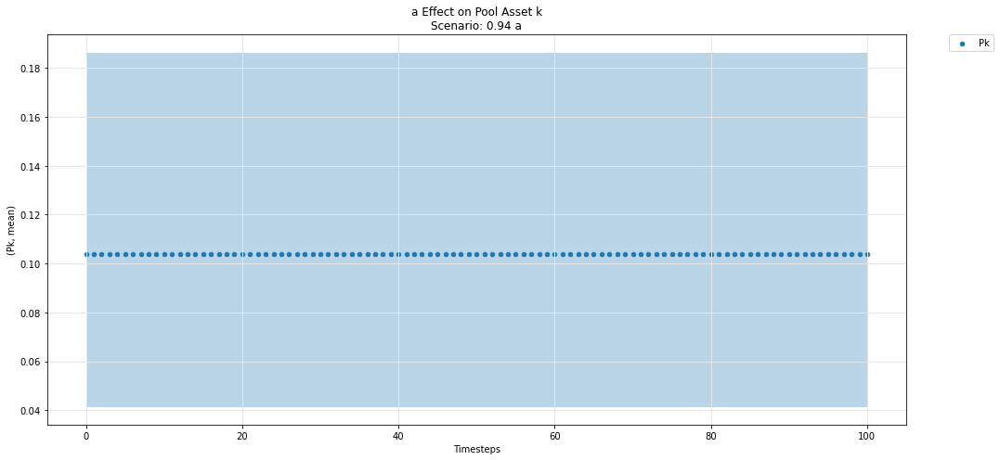

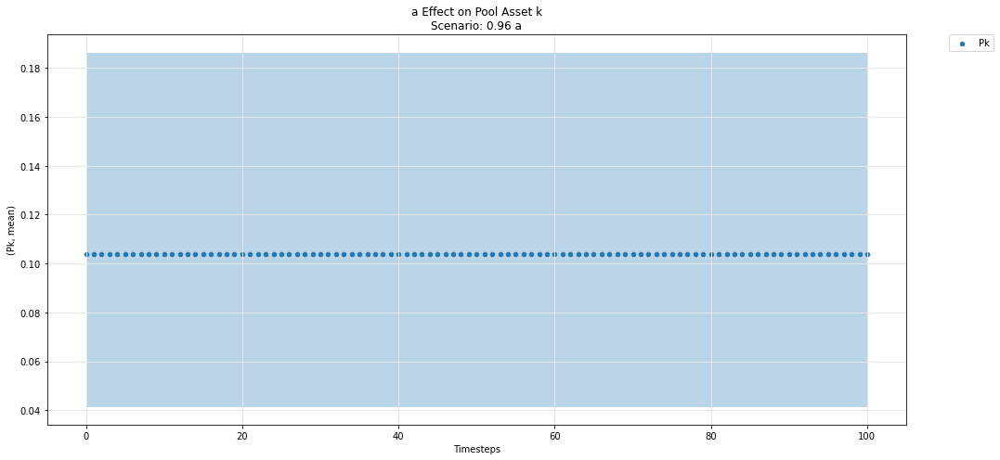

...

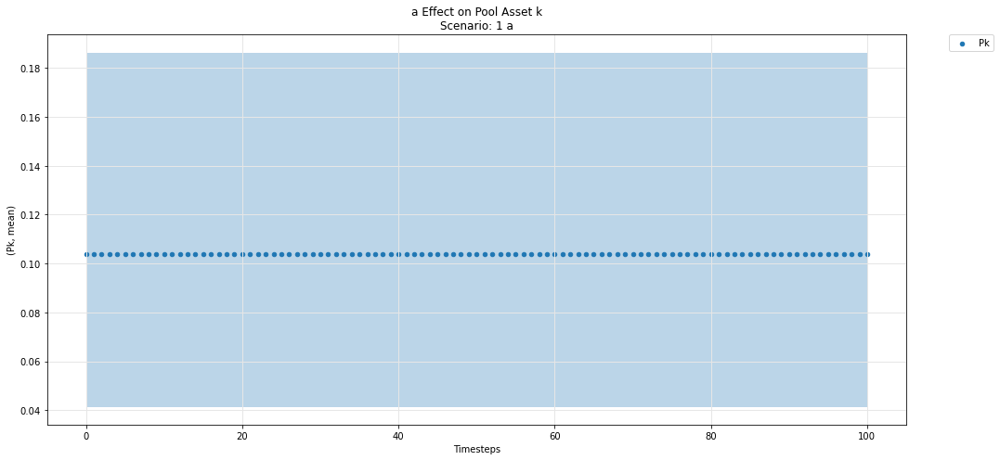

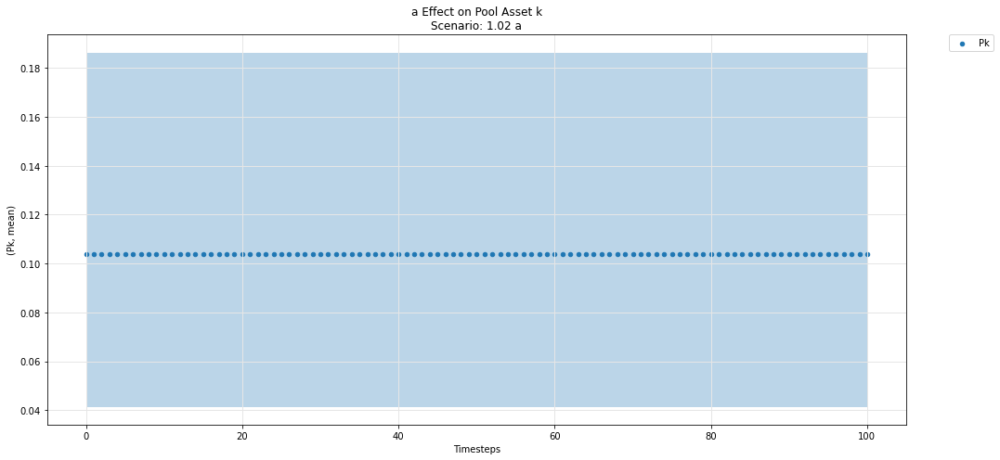

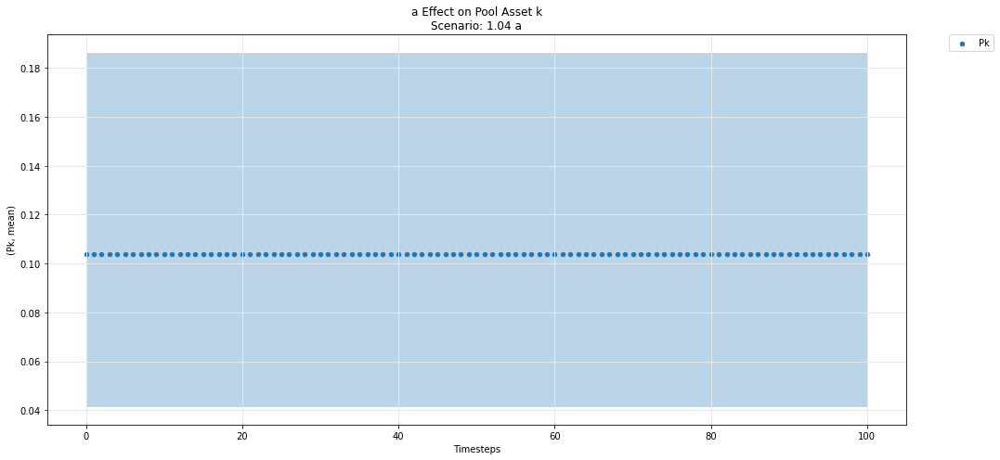

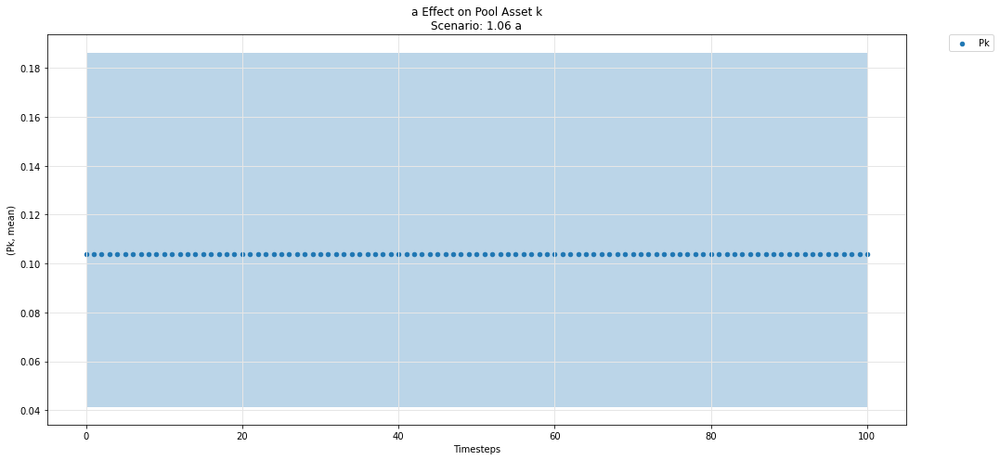

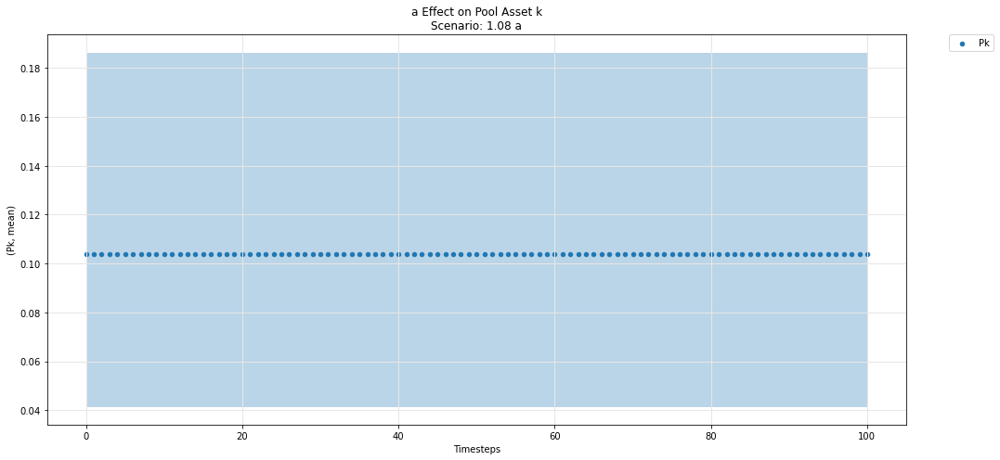

In [76]:
param_pool_simulation_plot(experiments, config_ids, 'a','k','P')

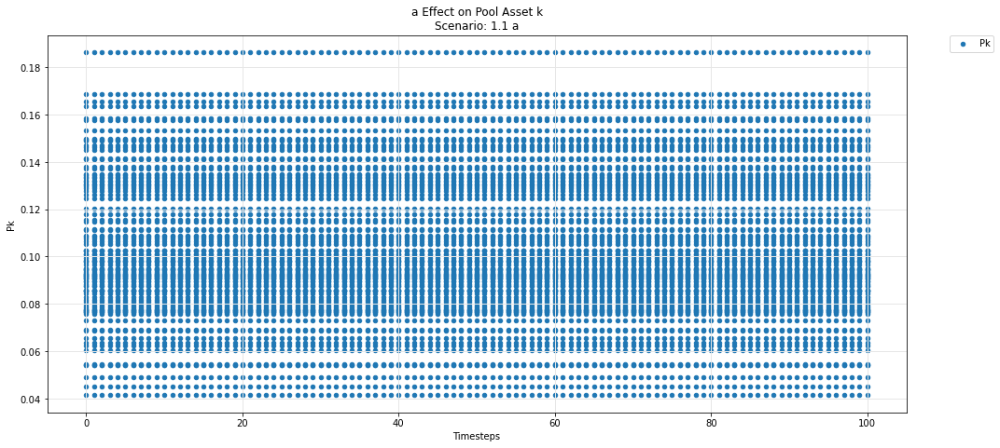

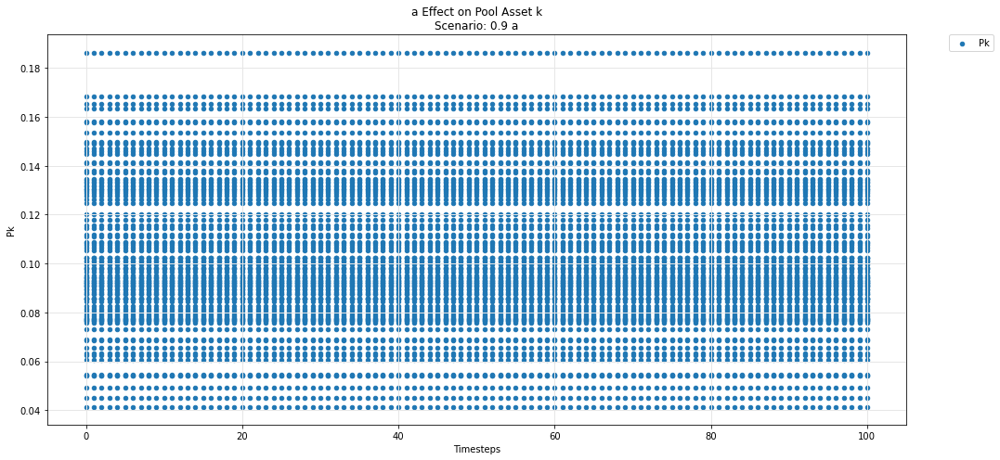

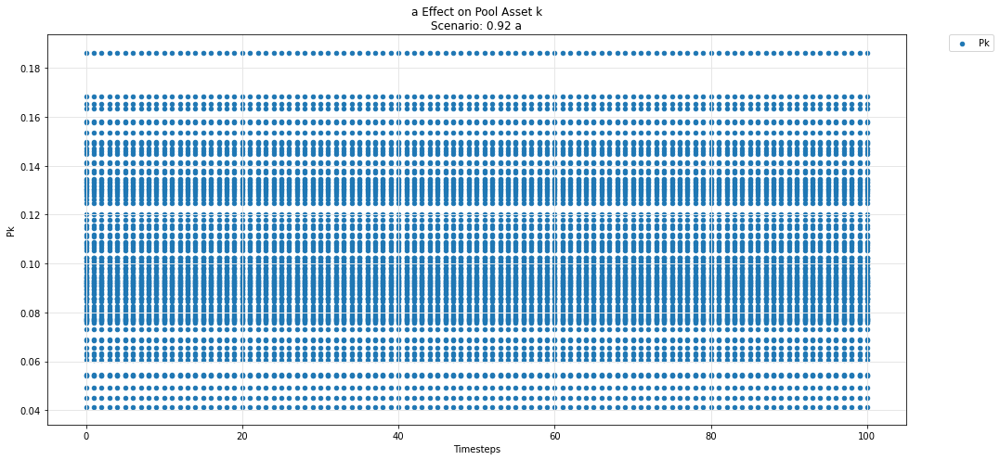

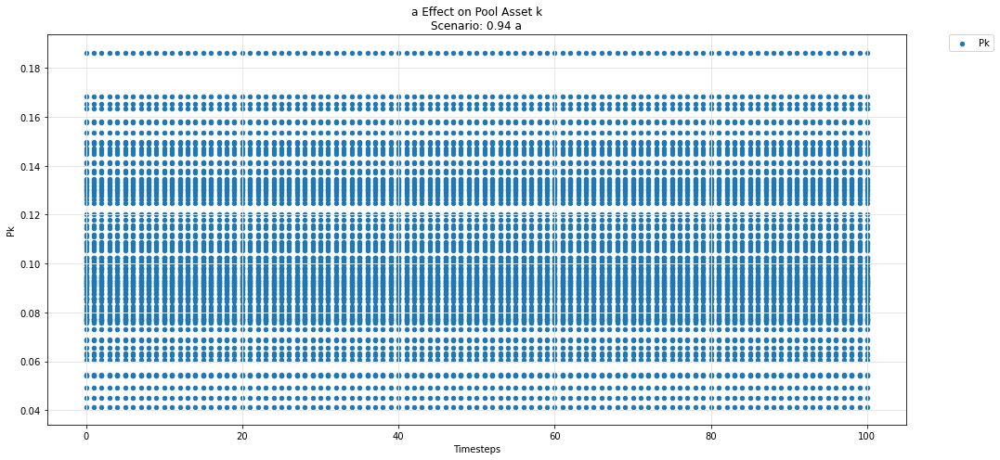

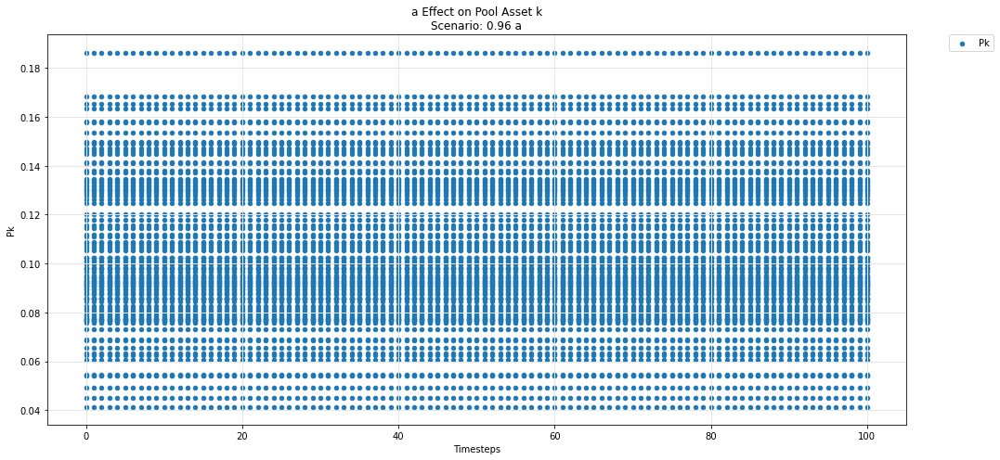

...

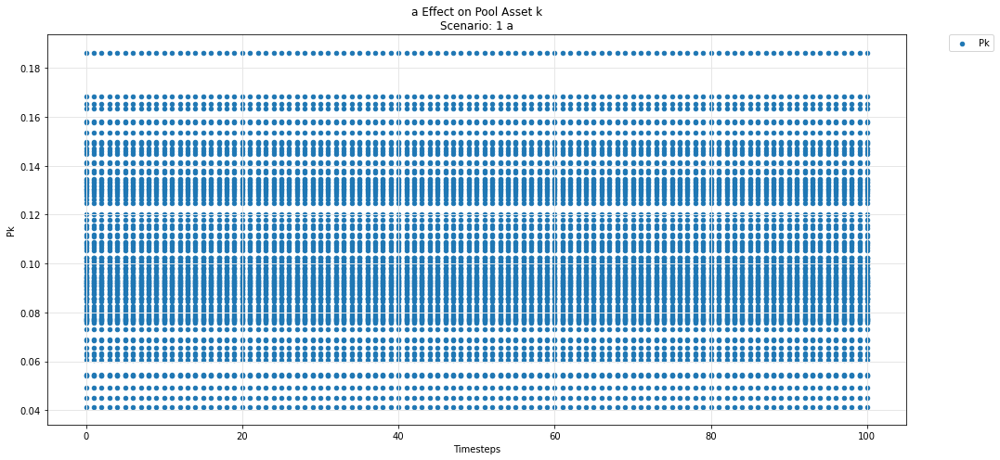

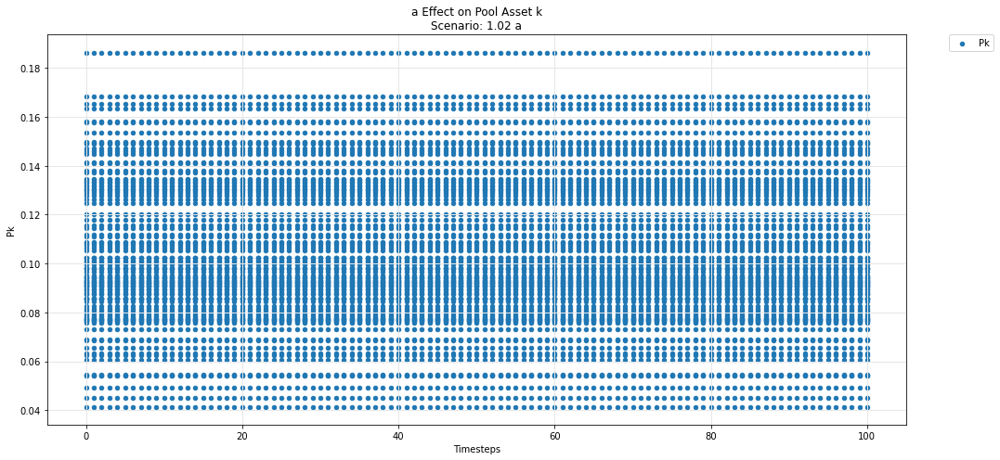

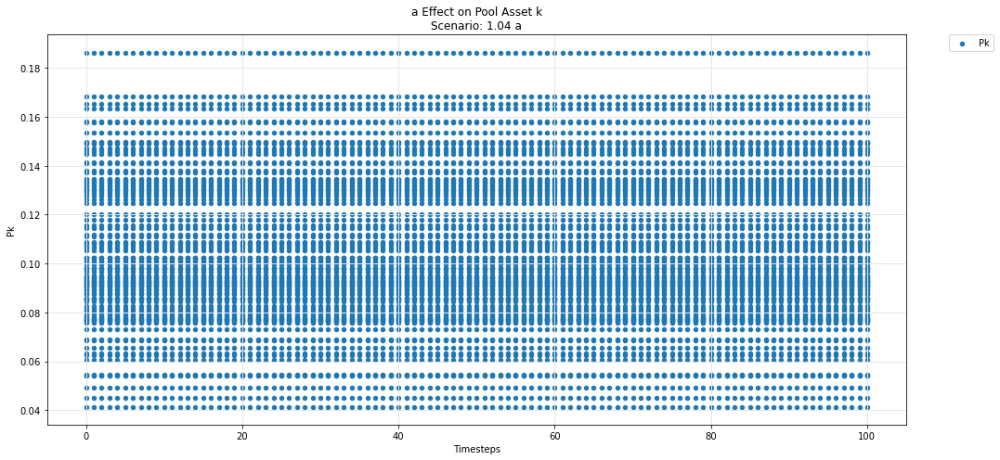

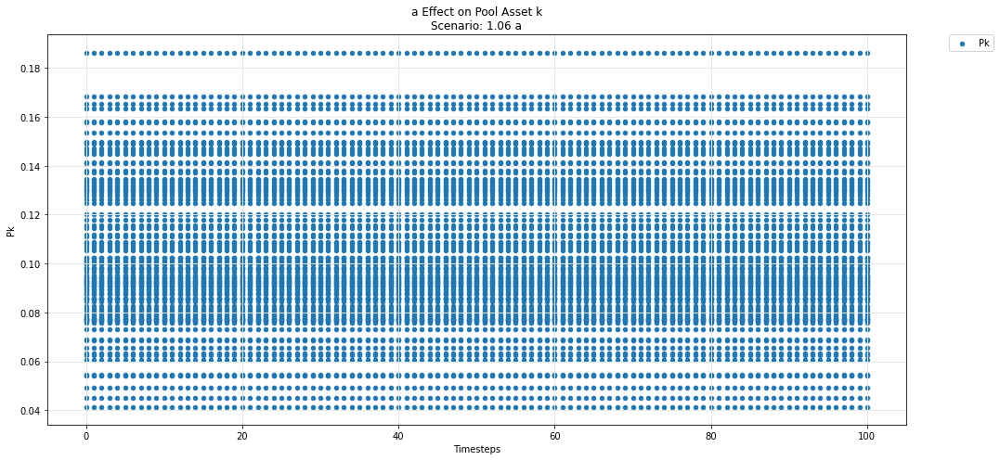

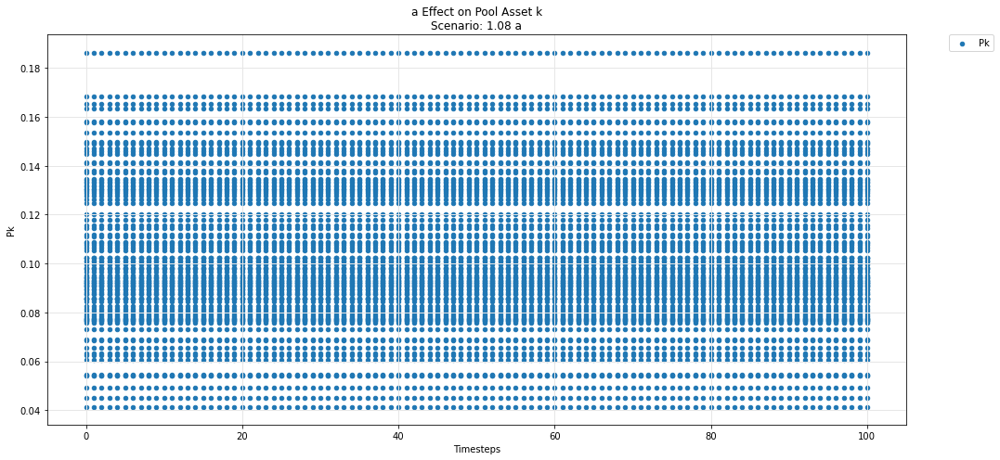

In [77]:
param_pool_plot(experiments, config_ids, 'a','k','P')